<a href="https://colab.research.google.com/github/alexcrich/Spoon-Knife/blob/main/online_fall_2024_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mounting the data and all that good stuff (need to do any time you want to edit/re-run)

In [ ]:
from google.colab import drive
import os
import pandas as pd

# Mount Google Drive
drive.mount('/content/drive')

# Access the shared folder
shared_folder_path = "/content/drive/My Drive/Levy Lab/Value updating project/online fall 2024 analysis/subject data"

# Dictionary to hold DataFrames for each participant
participant_data = {}
participants_without_data = []

# Iterate through each subject folder
for subject_folder in os.listdir(shared_folder_path):
    subject_folder_path = os.path.join(shared_folder_path, subject_folder)

    # Check if the item is a directory (subject folder)
    if os.path.isdir(subject_folder_path):
        # Construct the path to the task CSV file (e.g., 654_task.csv)
        task_file_name = f"{subject_folder}_task.csv"
        task_file_path = os.path.join(subject_folder_path, task_file_name)

        # Check if the task file exists
        if os.path.exists(task_file_path):
            # Read the task CSV file into a DataFrame
            df = pd.read_csv(task_file_path)

            # Store the DataFrame in the dictionary with the subject ID as the key
            participant_data[subject_folder] = df
            #print(f"Data loaded successfully for participant {subject_folder}.")
        else:
            participants_without_data.append(subject_folder)
            print(f"No data found for participant {subject_folder}.")

# Report the number of participants
total_participants = len(participant_data) + len(participants_without_data)
print(f"\nTotal participants processed: {total_participants}")

# Final message based on loading status
if not participants_without_data:
    print("Data loaded successfully for all participants.")
else:
    print("Some participants did not have data loaded:")
    for participant in participants_without_data:
        print(f"- {participant}")

# Optional: Print the loaded data (commented to avoid long output)
# for participant_id, df in participant_data.items():
#     print(f"Participant ID: {participant_id}")
#     print(df.head())  # Print the first few rows of the current participant's DataFrame

# Avoid scroll-in-the-scroll in the entire Notebook
from IPython.display import Javascript
def resize_colab_cell():
    display(Javascript('google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'))
get_ipython().events.register('pre_run_cell', resize_colab_cell)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).

Total participants processed: 109
Data loaded successfully for all participants.


# Within participants

**Includes:**

1.   Accuracy by Block
2.   Number of Trials in Each Block

1.   Accuracy by Trial with Probabilistic Event and Block Changes
2.   Accuracy by Trial Type (with t-test)

1.   Accuracy by Image Rating (with chi-squared)

## For one participant at a time (specify)

<IPython.core.display.Javascript object>

Data for participant 801:
        Image      Image Rating Expectation   Outcome  Response Time  \
0         lox           dislike    positive  negative            235   
1  granolabar  strongly_dislike    negative  negative            537   
2       mango              like    positive  positive            588   
3  granolabar  strongly_dislike    negative  negative            467   
4      olives     strongly_like    positive  positive            606   

   Jitter 1  Jitter 2  Correct  Correct (Theoretical)  Probabilistic event  \
0    1587.5       694    False                  False                False   
1    1494.5       733     True                   True                False   
2    1452.0       600     True                   True                False   
3    1720.5       568     True                   True                False   
4    1425.0       886     True                   True                False   

  Trial type  
0    aligned  
1    aligned  
2    aligned  
3    aligned

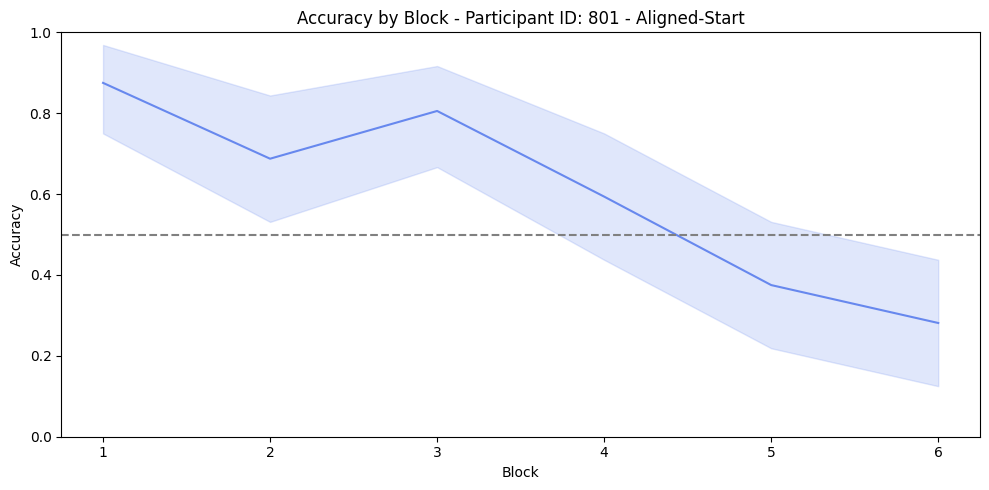

<ipython-input-3-e3079aa4fd07>:83: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


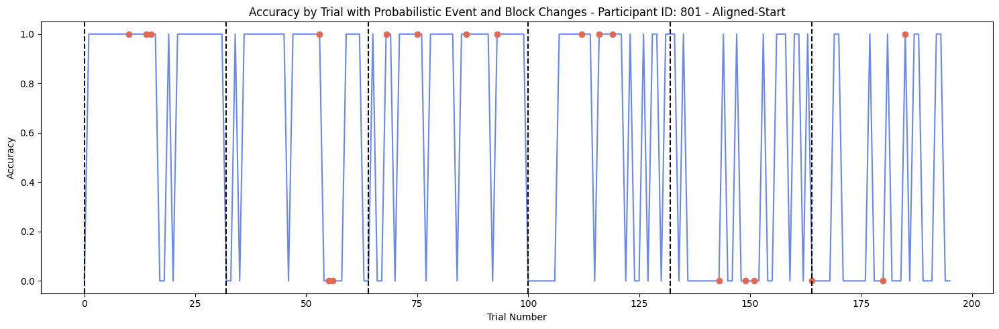

<ipython-input-3-e3079aa4fd07>:103: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-3-e3079aa4fd07>:112: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


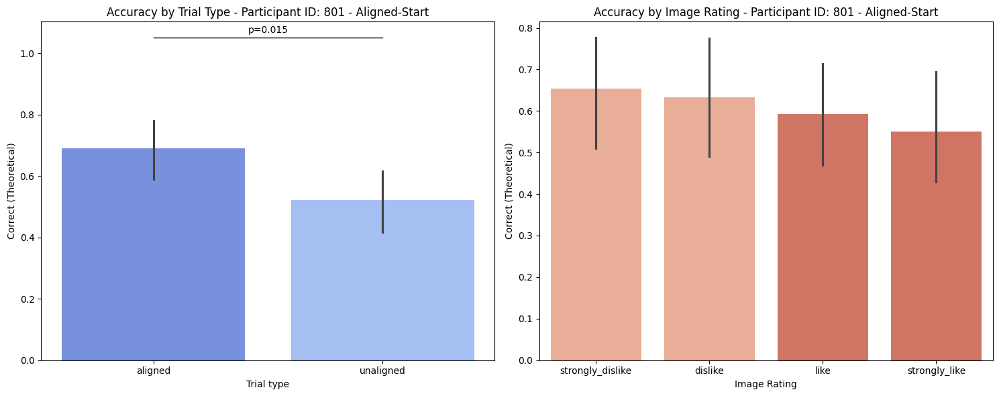

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_ind, chi2_contingency

# Accessing data for a specific participant
participant_id = '801'  # Replace with the desired participant ID
if participant_id in participant_data:
    df = participant_data[participant_id]  # Access the DataFrame for this participant
    print(f"Data for participant {participant_id}:")
    print(df.head())  # Print the first few rows of the DataFrame
else:
    print(f"No data found for participant {participant_id}.")

# Define blocks based on switches in 'Trial type'
df['Block'] = (df['Trial type'] != df['Trial type'].shift(1)).cumsum()

# Accuracy in each 'Block'
block_accuracy = df.groupby('Block')['Correct (Theoretical)'].mean()

# Accuracy per 'Trial type' (aligned and unaligned)
trial_type_accuracy = df.groupby('Trial type')['Correct (Theoretical)'].mean()
ttest_p_value_tt = ttest_ind(df[df['Trial type'] == 'aligned']['Correct (Theoretical)'],
                              df[df['Trial type'] == 'unaligned']['Correct (Theoretical)'], nan_policy='omit').pvalue

# Accuracy over the whole task
df['Block Change'] = df['Block'].ne(df['Block'].shift())
df['All Trials'] = 'All Trials'
overall_accuracy = df.groupby(['All Trials', 'Block'])['Correct (Theoretical)'].mean()

# Accuracy as a function of 'Image Rating'
df['Correct (Binary)'] = df['Correct (Theoretical)'].astype(int)

# Create a contingency table
contingency_table = pd.crosstab(df['Image Rating'], df['Correct (Binary)'])

# Perform chi-squared test
chi2, p, _, _ = chi2_contingency(contingency_table)

# Output results
print(f"Participant ID: {participant_id.split('_')[0]}")
print("\nAccuracy in each 'Block':")
print(block_accuracy)
print("\nAccuracy per 'Trial type' (aligned and unaligned):")
print(trial_type_accuracy)
print(f"t-test p-value for 'Trial type': {ttest_p_value_tt}")
print("\nAccuracy over the whole task:")
print(overall_accuracy)
print("\nAccuracy as a function of 'Image Rating':")
print(df.groupby('Image Rating')['Correct (Binary)'].mean())
print(f"Chi-squared p-value for 'Image Rating': {p:.15f}")
print("Data for Chi-squared test:")
print(contingency_table)

# Determine the starting block type
starting_block_type = 'Aligned-Start' if df['Trial type'].iloc[0] == 'aligned' else 'Unaligned-Start'

# Define the order for the first bar plot
trial_type_order = ['aligned', 'unaligned']

# Visualization

# Define custom color palette
coolwarm_palette = sns.color_palette("coolwarm", 6)  # Generate the coolwarm palette

# Accuracy by Block
plt.figure(figsize=(10, 5))
sns.lineplot(x='Block', y='Correct (Theoretical)', data=df, color=coolwarm_palette[0])  # Choose a color for the line
plt.ylabel('Accuracy')
plt.axhline(y=0.5, color='gray', linestyle='--')  # Add a dotted line at y=0.5
plt.ylim(0, 1)  # Set y-axis limits to 0-1
plt.title(f"Accuracy by Block - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")

plt.tight_layout()
plt.show()

# Accuracy by Trial with Probabilistic Event and Block Changes
plt.figure(figsize=(15, 5))
sns.lineplot(x=df.index, y='Correct (Theoretical)', data=df, color=coolwarm_palette[0])  # Choose a color for the line
for i, event in enumerate(df['Probabilistic event']):
    if event:
        plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])
for i, change in enumerate(df['Block Change']):
    if change:
        plt.axvline(x=i, linestyle='--', linewidth=1.5, color='k')
plt.title(f"Accuracy by Trial with Probabilistic Event and Block Changes - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
plt.ylabel('Accuracy')
plt.xlabel('Trial Number')
plt.tight_layout()
plt.show()

# Accuracy by Trial Type and Image Rating
fig, axs = plt.subplots(1, 2, figsize=(15, 6))
# Define custom color palette
coolwarm_palette = sns.color_palette("coolwarm")  # You can choose any palette
# Assign specific colors from the coolwarm palette
palette = {'aligned': coolwarm_palette[0], 'unaligned': coolwarm_palette[1],
           'strongly_dislike': coolwarm_palette[4], 'dislike': coolwarm_palette[4],
           'like': coolwarm_palette[5], 'strongly_like': coolwarm_palette[5]}  # Switching colors

# Accuracy by Trial Type with specified order
sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
axs[0].set_title(f"Accuracy by Trial Type - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
if ttest_p_value_tt < 0.05:
    height = max(df.groupby('Trial type')['Correct (Theoretical)'].max()) + 0.05
    axs[0].plot([0, 1], [height, height], linewidth=1, color='k')
    axs[0].text(0.5, height + 0.01, f'p={ttest_p_value_tt:.3f}', ha='center', va='bottom')

# Accuracy by Image Rating with the correct order
image_rating_order = ['strongly_dislike', 'dislike', 'like', 'strongly_like']
sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)
axs[1].set_title(f"Accuracy by Image Rating - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
if p < 0.05:
    height = max(df.groupby('Image Rating')['Correct (Theoretical)'].max()) + 0.05
    axs[1].plot([0, 1, 2, 3], [height, height, height, height], linewidth=1, color='k')
    axs[1].text(1.5, height + 0.01, f'p={p:.3f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()


###Only last 15 trials of each block

<IPython.core.display.Javascript object>

Data for participant 801:
        Image      Image Rating Expectation   Outcome  Response Time  \
0         lox           dislike    positive  negative            235   
1  granolabar  strongly_dislike    negative  negative            537   
2       mango              like    positive  positive            588   
3  granolabar  strongly_dislike    negative  negative            467   
4      olives     strongly_like    positive  positive            606   

   Jitter 1  Jitter 2  Correct  Correct (Theoretical)  Probabilistic event  \
0    1587.5       694    False                  False                False   
1    1494.5       733     True                   True                False   
2    1452.0       600     True                   True                False   
3    1720.5       568     True                   True                False   
4    1425.0       886     True                   True                False   

  Trial type  Block  Block Change  All Trials  Correct (Binary)  
0    a

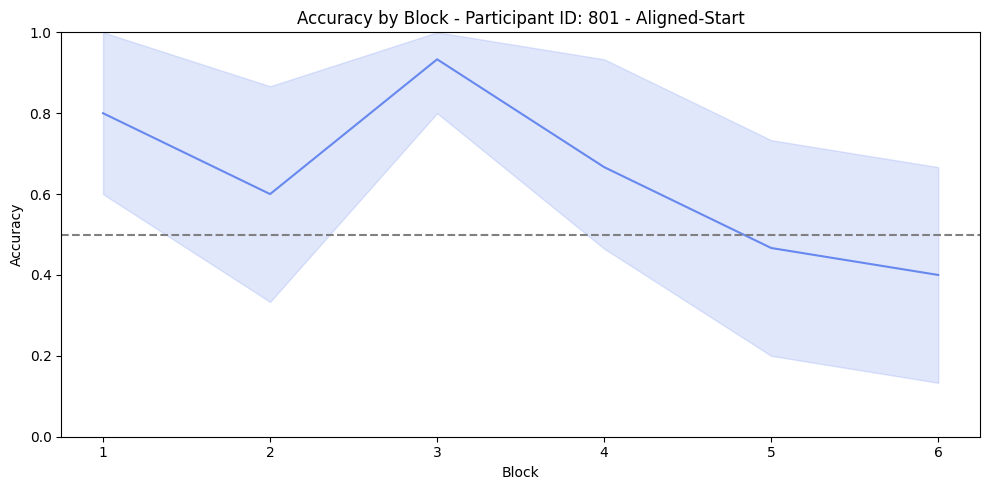

<ipython-input-4-c42ab8240b29>:80: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


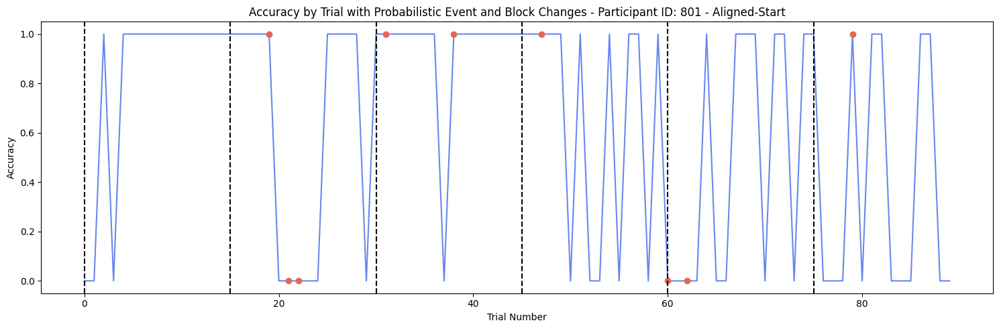

<ipython-input-4-c42ab8240b29>:100: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-4-c42ab8240b29>:109: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


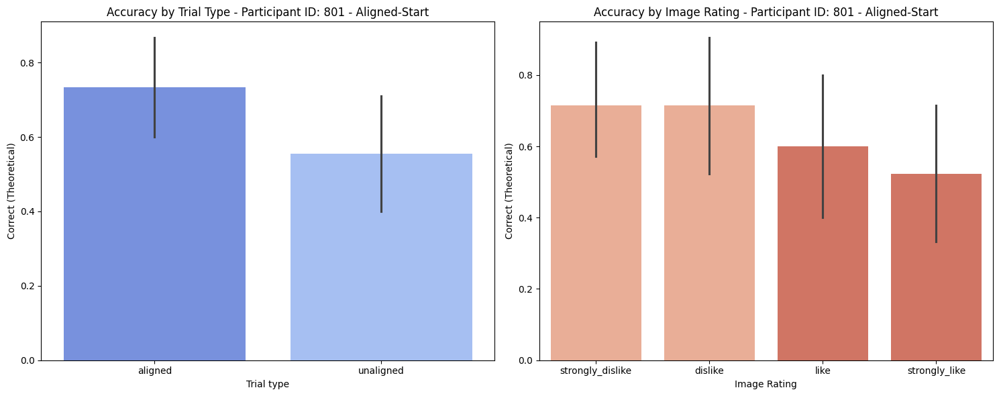

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_ind, chi2_contingency

# Accessing data for a specific participant
participant_id = '801'  # Replace with the desired participant ID
if participant_id in participant_data:
    df = participant_data[participant_id]  # Access the DataFrame for this participant
    print(f"Data for participant {participant_id}:")
    print(df.head())  # Print the first few rows of the DataFrame
else:
    print(f"No data found for participant {participant_id}.")


# Define blocks based on switches in 'Trial type'
df['Block'] = (df['Trial type'] != df['Trial type'].shift(1)).cumsum()

# Keep only the last 15 trials of each block
df = df.groupby('Block').tail(15).reset_index(drop=True)

# Accuracy per 'Trial type' (aligned and unaligned)
trial_type_accuracy = df.groupby('Trial type')['Correct (Theoretical)'].mean()
ttest_p_value_tt = ttest_ind(df[df['Trial type'] == 'aligned']['Correct (Theoretical)'],
                            df[df['Trial type'] == 'unaligned']['Correct (Theoretical)'], nan_policy='omit').pvalue

# Accuracy over the whole task
df['Block Change'] = df['Block'].ne(df['Block'].shift())
df['All Trials'] = 'All Trials'
overall_accuracy = df.groupby(['All Trials', 'Block'])['Correct (Theoretical)'].mean()

# Accuracy as a function of 'Image Rating'
# Convert 'Correct (Theoretical)' to binary (1 for True, 0 for False)
df['Correct (Binary)'] = df['Correct (Theoretical)'].astype(int)

# Create a contingency table
contingency_table = pd.crosstab(df['Image Rating'], df['Correct (Binary)'])

# Perform chi-squared test
chi2, p, _, _ = chi2_contingency(contingency_table)

# Output results
print(f"Participant ID: {participant_id.split('_')[0]}")
print("\nAccuracy in each 'Block':")
print(df.groupby('Block')['Correct (Theoretical)'].mean())
print("\nAccuracy per 'Trial type' (aligned and unaligned):")
print(trial_type_accuracy)
print(f"t-test p-value for 'Trial type': {ttest_p_value_tt}")
print("\nAccuracy over the whole task:")
print(overall_accuracy)
print("\nAccuracy as a function of 'Image Rating':")
print(df.groupby('Image Rating')['Correct (Binary)'].mean())
print(f"Chi-squared p-value for 'Image Rating': {p:.15f}")
print("Data for Chi-squared test:")
print(contingency_table)


# Visualization

# Define custom color palette
coolwarm_palette = sns.color_palette("coolwarm", 6)  # Generate the coolwarm palette

# Accuracy by Block
plt.figure(figsize=(10, 5))
sns.lineplot(x='Block', y='Correct (Theoretical)', data=df, color=coolwarm_palette[0])  # Choose a color for the line
plt.ylabel('Accuracy')
plt.axhline(y=0.5, color='gray', linestyle='--')  # Add a dotted line at y=0.5
plt.ylim(0, 1)  # Set y-axis limits to 0-1
plt.title(f"Accuracy by Block - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")

plt.tight_layout()
plt.show()

# Accuracy by Trial with Probabilistic Event and Block Changes
plt.figure(figsize=(15, 5))
sns.lineplot(x=df.index, y='Correct (Theoretical)', data=df, color=coolwarm_palette[0])  # Choose a color for the line
for i, event in enumerate(df['Probabilistic event']):
    if event:
        plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])
for i, change in enumerate(df['Block Change']):
    if change:
        plt.axvline(x=i, linestyle='--', linewidth=1.5, color='k')
plt.title(f"Accuracy by Trial with Probabilistic Event and Block Changes - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
plt.ylabel('Accuracy')
plt.xlabel('Trial Number')
plt.tight_layout()
plt.show()

# Accuracy by Trial Type and Image Rating
fig, axs = plt.subplots(1, 2, figsize=(15, 6))
# Define custom color palette
coolwarm_palette = sns.color_palette("coolwarm")  # You can choose any palette
# Assign specific colors from the coolwarm palette
palette = {'aligned': coolwarm_palette[0], 'unaligned': coolwarm_palette[1],
          'strongly_dislike': coolwarm_palette[4], 'dislike': coolwarm_palette[4],
          'like': coolwarm_palette[5], 'strongly_like': coolwarm_palette[5]}  # Switching colors

# Accuracy by Trial Type with specified order
sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
axs[0].set_title(f"Accuracy by Trial Type - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
if ttest_p_value_tt < 0.05:
    height = max(df.groupby('Trial type')['Correct (Theoretical)'].max()) + 0.05
    axs[0].plot([0, 1], [height, height], linewidth=1, color='k')
    axs[0].text(0.5, height + 0.01, f'p={ttest_p_value_tt:.3f}', ha='center', va='bottom')

# Accuracy by Image Rating with the correct order
image_rating_order = ['strongly_dislike', 'dislike', 'like', 'strongly_like']
sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)
axs[1].set_title(f"Accuracy by Image Rating - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
if p < 0.05:
    height = max(df.groupby('Image Rating')['Correct (Theoretical)'].max()) + 0.05
    axs[1].plot([0, 1, 2, 3], [height, height, height, height], linewidth=1, color='k')
    axs[1].text(1.5, height + 0.01, f'p={p:.3f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()


## For all participants one by one

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Data for participant 671:
Participant ID: 671

Accuracy in each 'Block':
Block
1    0.500000
2    0.468750
3    0.312500
4    0.583333
5    0.500000
6    0.416667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.490385
unaligned    0.442308
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.4894619455035413

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.500000
            2        0.468750
            3        0.312500
            4        0.583333
            5        0.500000
            6        0.416667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.365385
like                0.442308
strongly_dislike    0.596154
strongly_like       0.461538
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.123022738805681
Data for Chi-squared test:
Correct (Binary)   0 

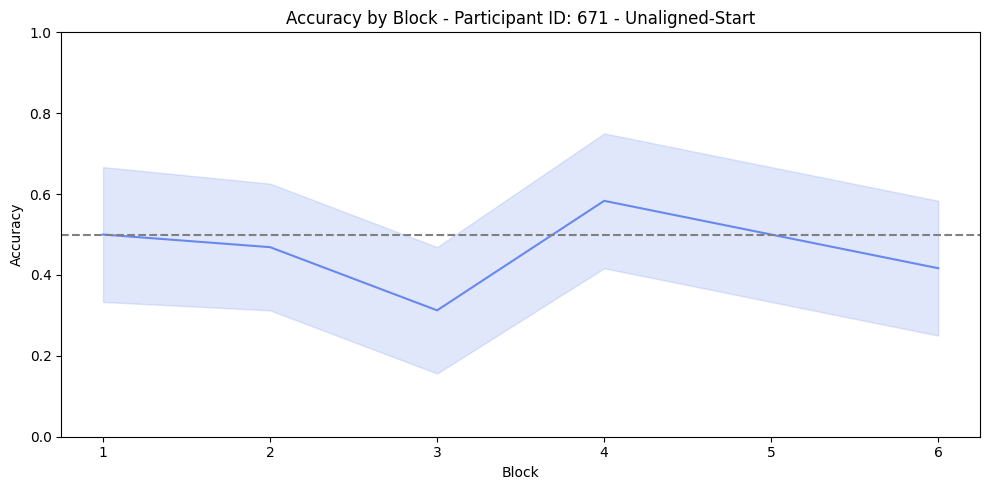

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


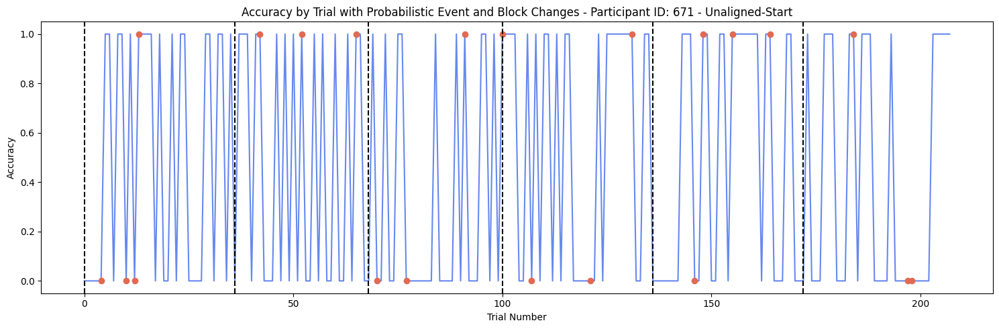

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


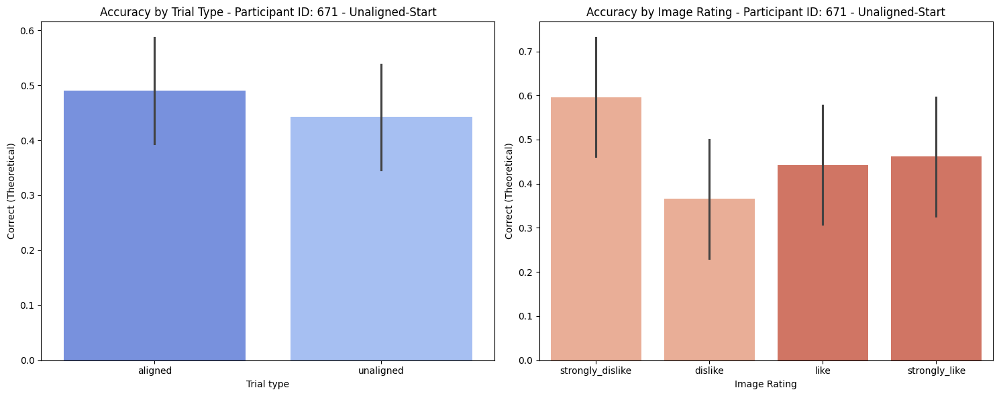

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.048).


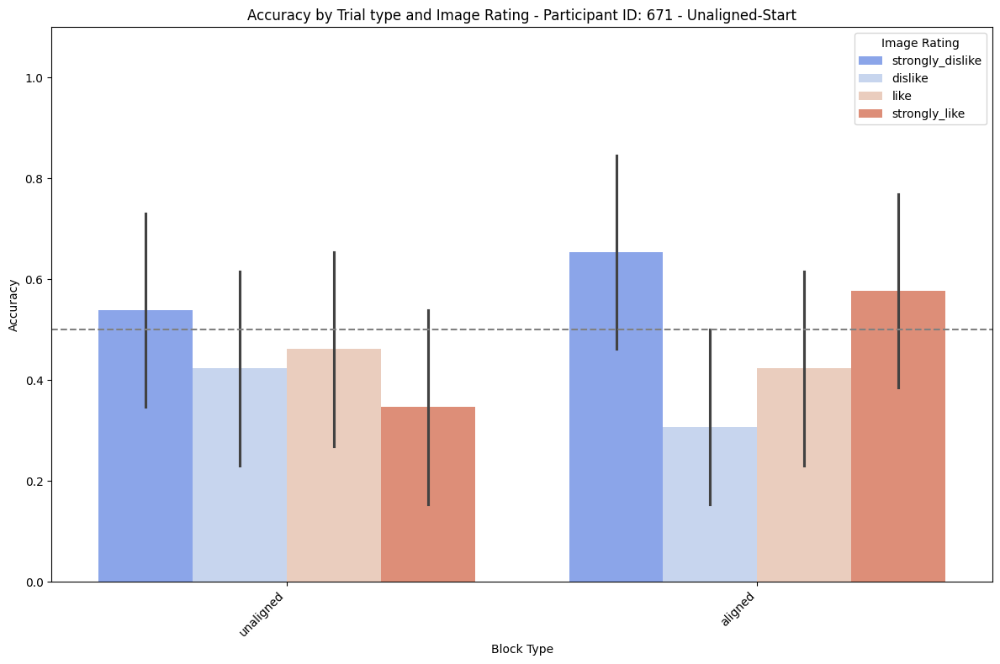

Data for participant 676:
Participant ID: 676

Accuracy in each 'Block':
Block
1    0.406250
2    0.750000
3    0.781250
4    0.781250
5    0.333333
6    0.722222
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.75
unaligned    0.50
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.00018925598083923003

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.406250
            2        0.750000
            3        0.781250
            4        0.781250
            5        0.333333
            6        0.722222
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.627451
like                0.725490
strongly_dislike    0.568627
strongly_like       0.588235
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.363609942403886
Data for Chi-squared test:
Correct (Binary)   0   1


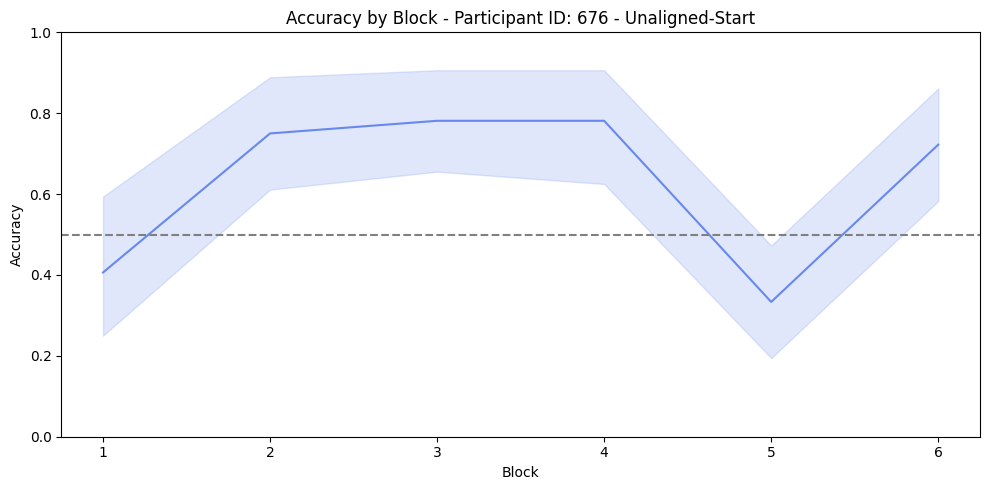

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


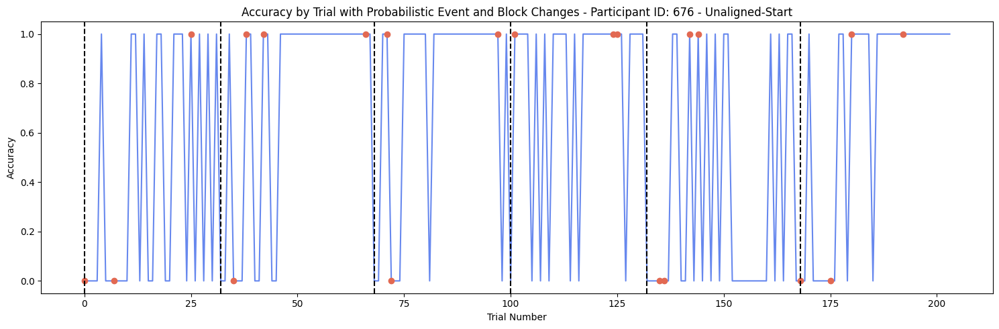

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


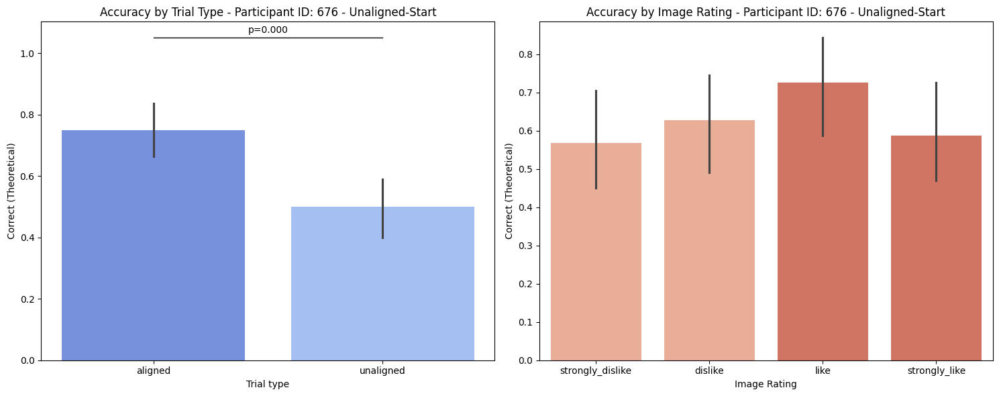

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.048).


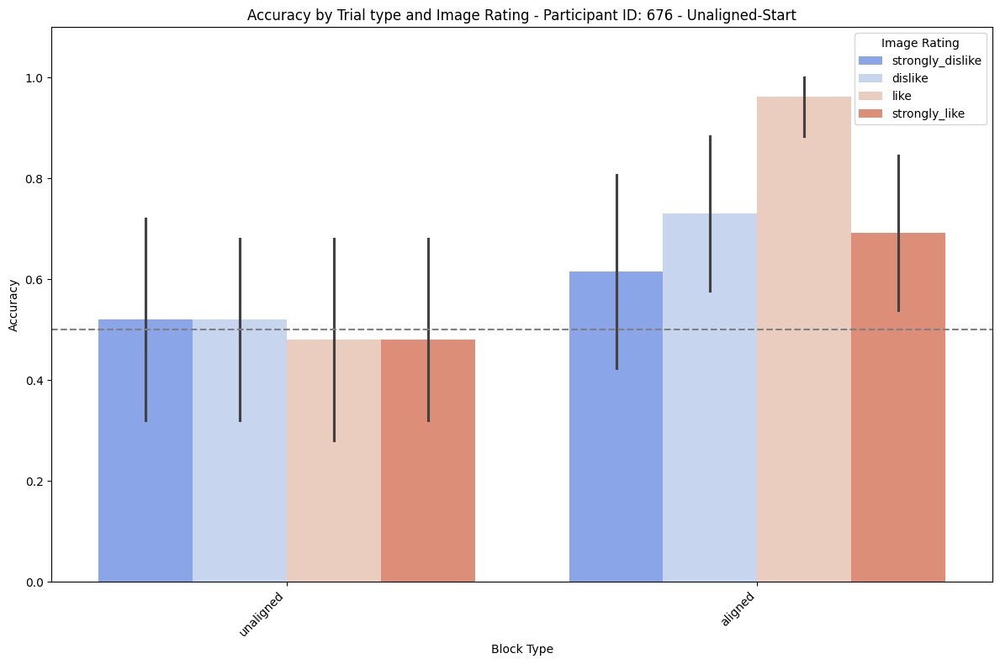

Data for participant 686:
Participant ID: 686

Accuracy in each 'Block':
Block
1    0.687500
2    0.694444
3    0.694444
4    0.861111
5    0.656250
6    0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.788462
unaligned    0.680000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0799091116536973

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.687500
            2        0.694444
            3        0.694444
            4        0.861111
            5        0.656250
            6        0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.764706
like                0.745098
strongly_dislike    0.764706
strongly_like       0.666667
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.634137812566605
Data for Chi-squared test:
Correct (Binary)   0 

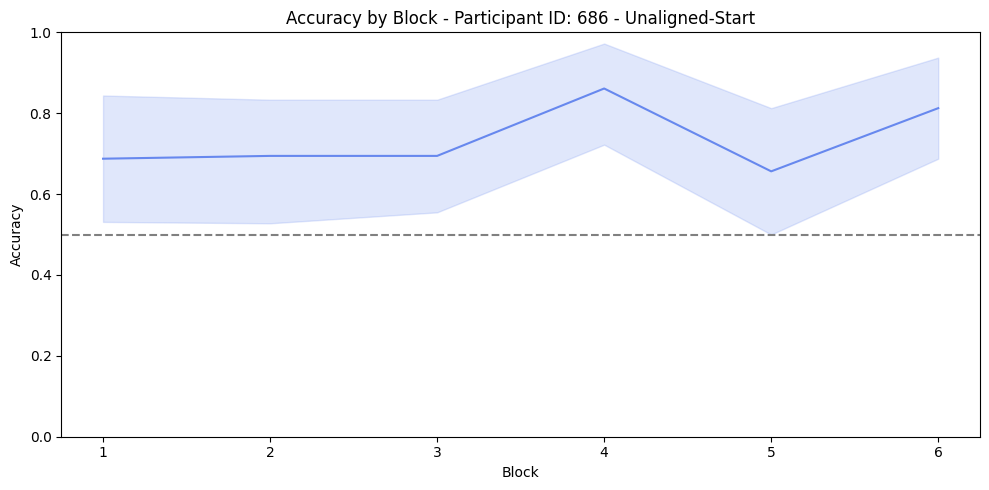

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


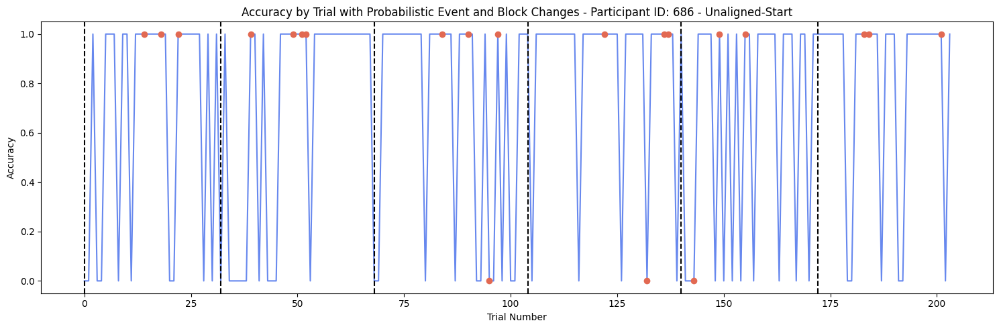

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


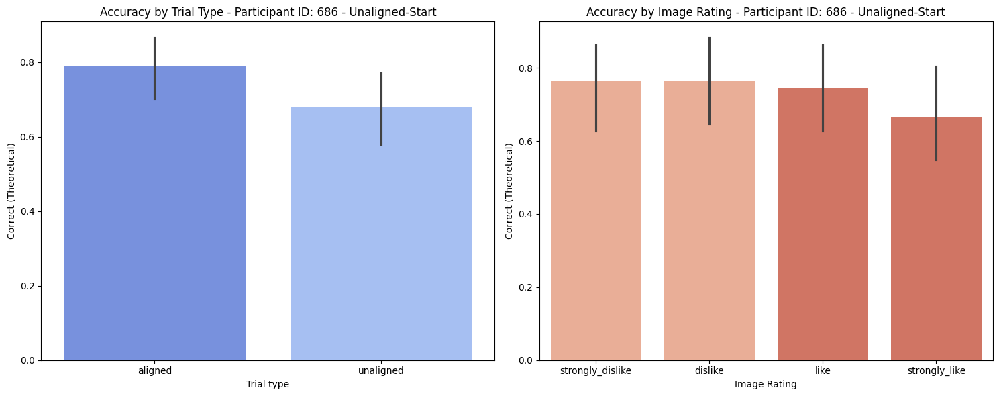

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).


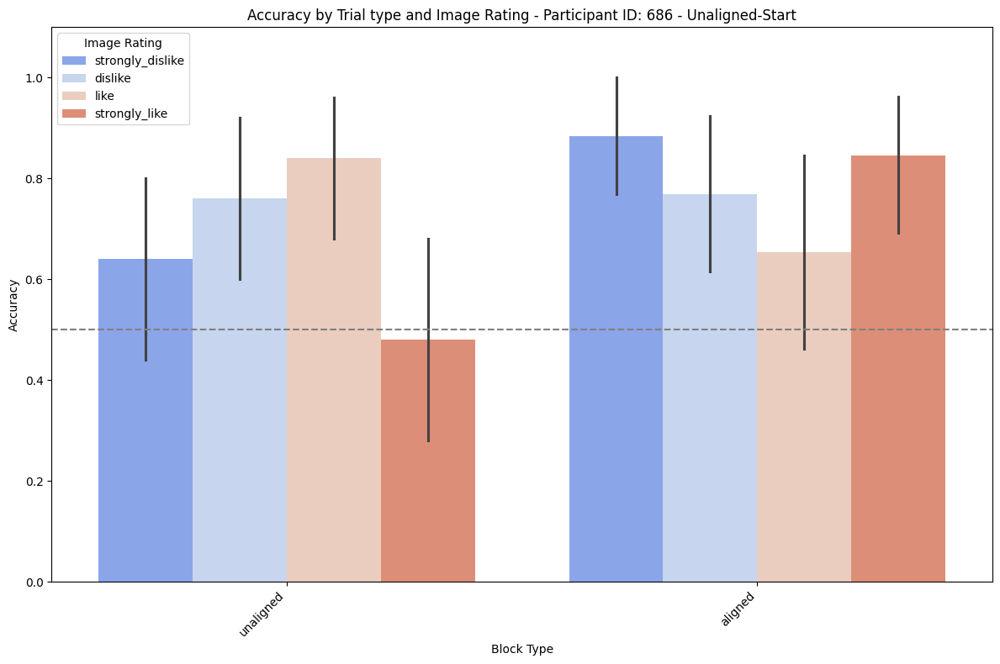

Data for participant 668:
Participant ID: 668

Accuracy in each 'Block':
Block
1    0.472222
2    0.437500
3    0.416667
4    0.472222
5    0.562500
6    0.444444
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.451923
unaligned    0.480769
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.6784753001845399

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.472222
            2        0.437500
            3        0.416667
            4        0.472222
            5        0.562500
            6        0.444444
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.442308
like                0.538462
strongly_dislike    0.423077
strongly_like       0.461538
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.658615093479500
Data for Chi-squared test:
Correct (Binary)   0 

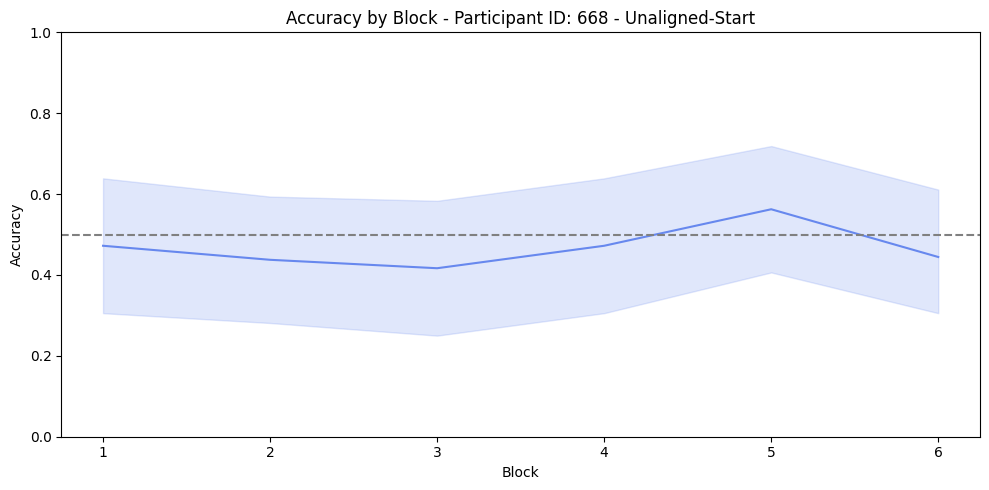

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


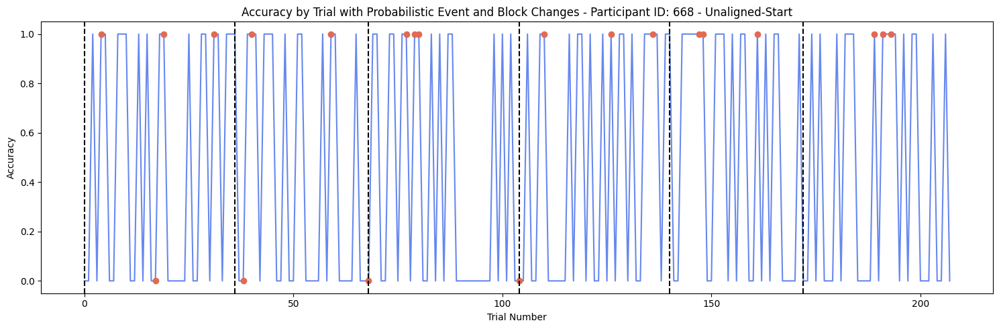

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


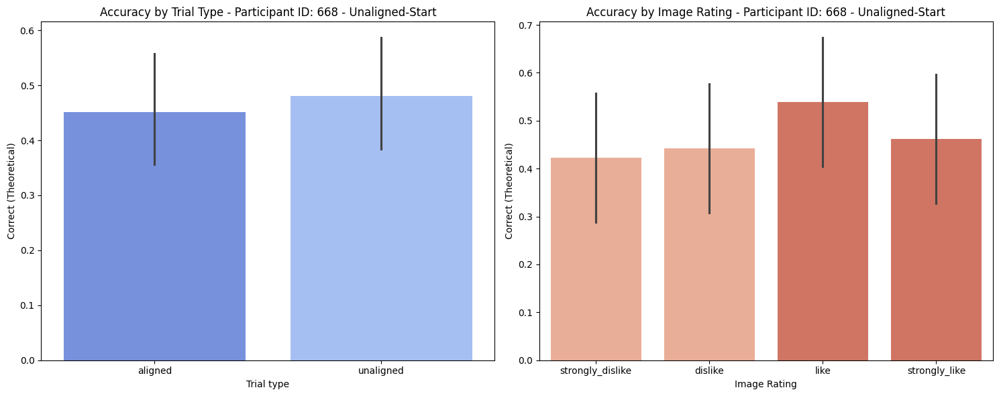

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


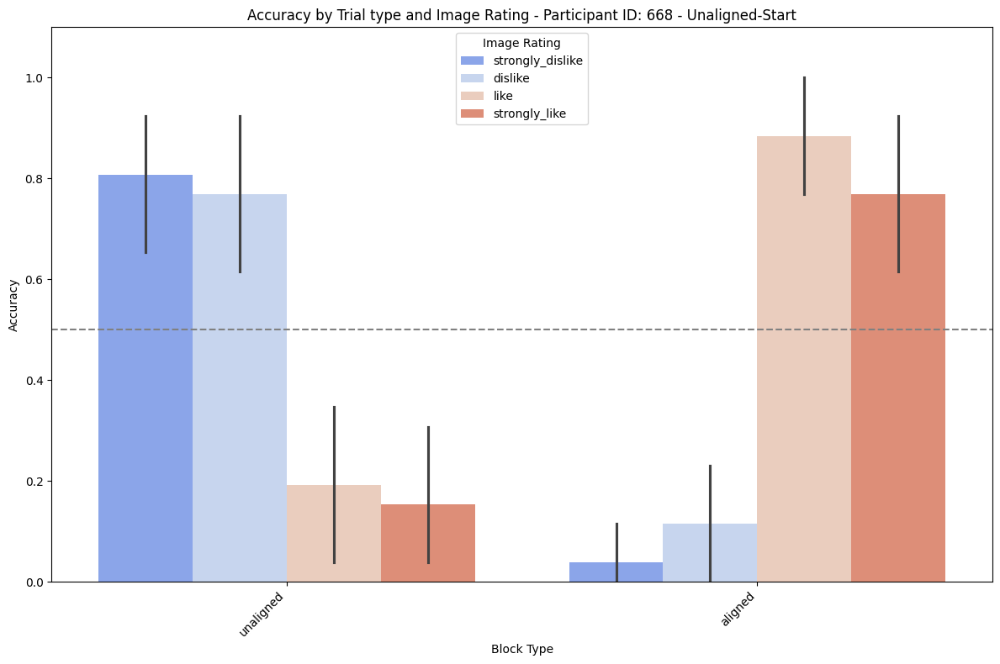

Data for participant 675:
Participant ID: 675

Accuracy in each 'Block':
Block
1    0.861111
2    0.805556
3    0.472222
4    0.406250
5    0.444444
6    0.472222
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.567308
unaligned    0.592593
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.7108078635548298

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.861111
            2        0.805556
            3        0.472222
            4        0.406250
            5        0.444444
            6        0.472222
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.603774
like                0.452830
strongly_dislike    0.641509
strongly_like       0.622642
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.182272652649485
Data for Chi-squared test:
Correct (Binary)   0 

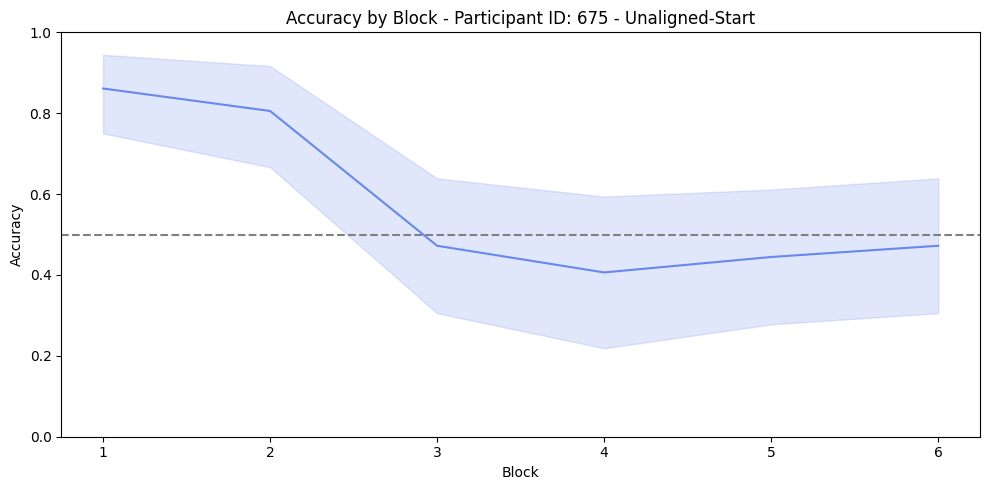

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


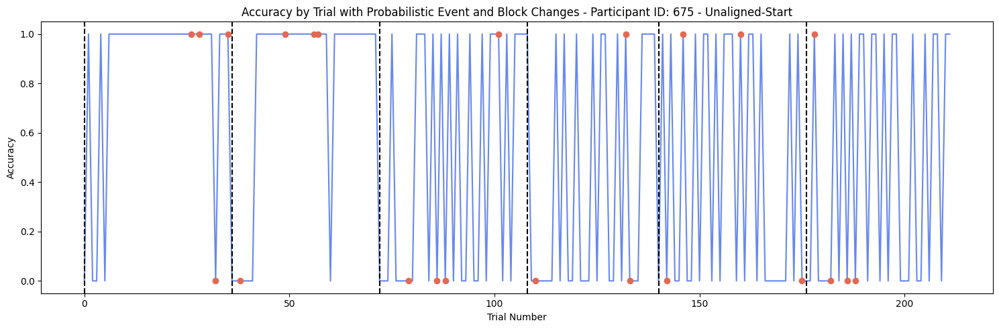

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


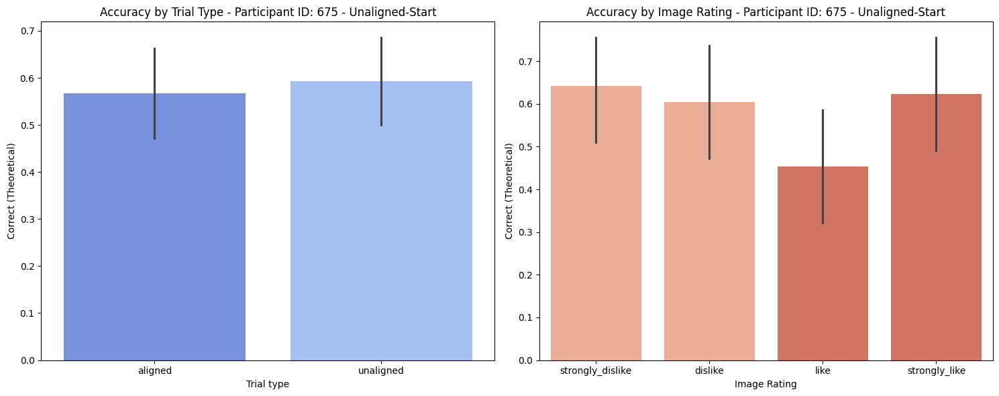

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).


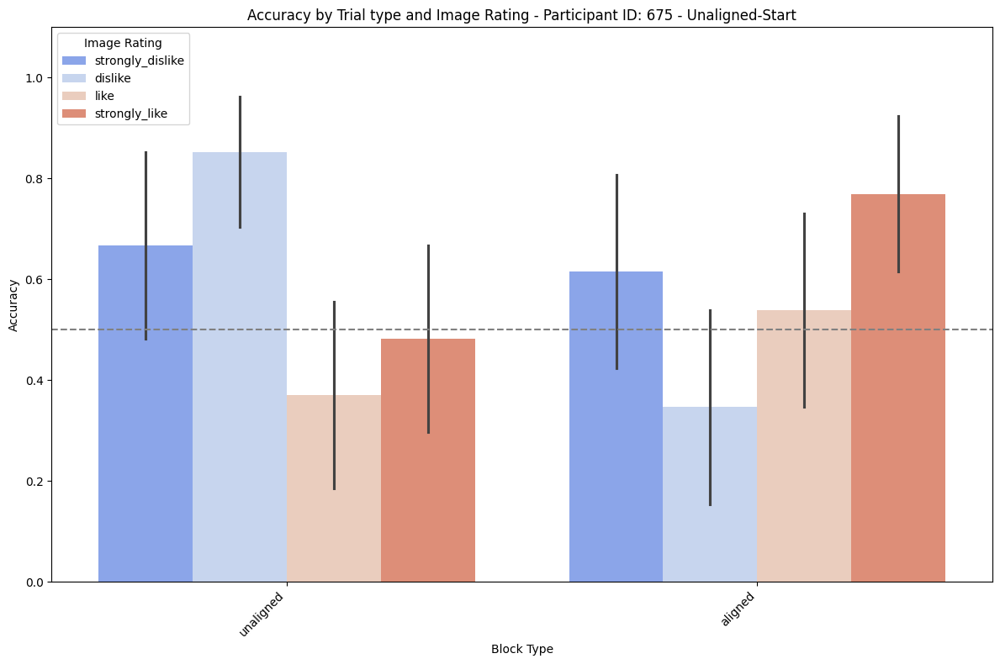

Data for participant 685:
Participant ID: 685

Accuracy in each 'Block':
Block
1    0.562500
2    0.444444
3    0.416667
4    0.562500
5    0.406250
6    0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.60
unaligned    0.46
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0476090246452467

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.562500
            2        0.444444
            3        0.416667
            4        0.562500
            5        0.406250
            6        0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.70
like                0.44
strongly_dislike    0.54
strongly_like       0.44
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.028340248952443
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating        

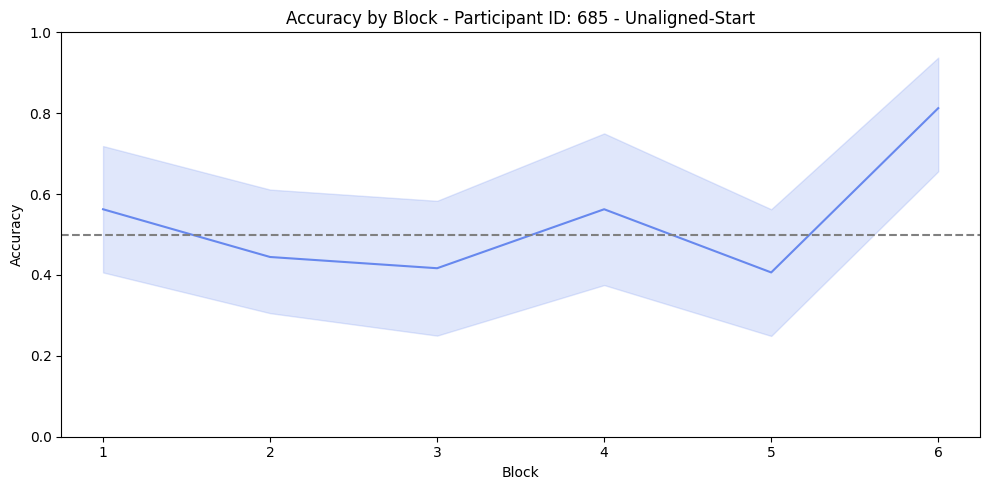

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


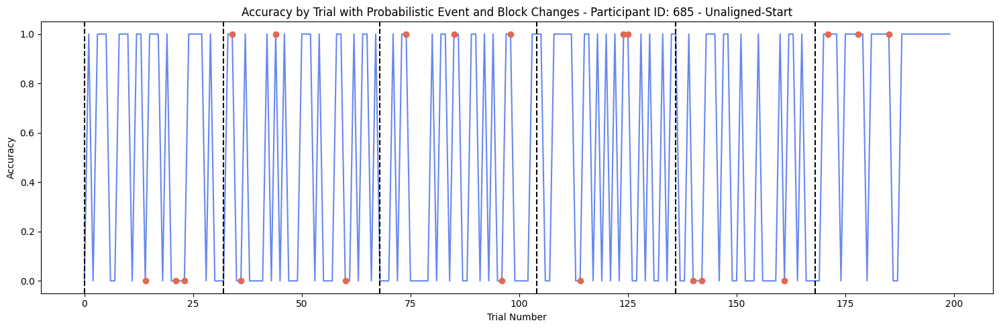

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


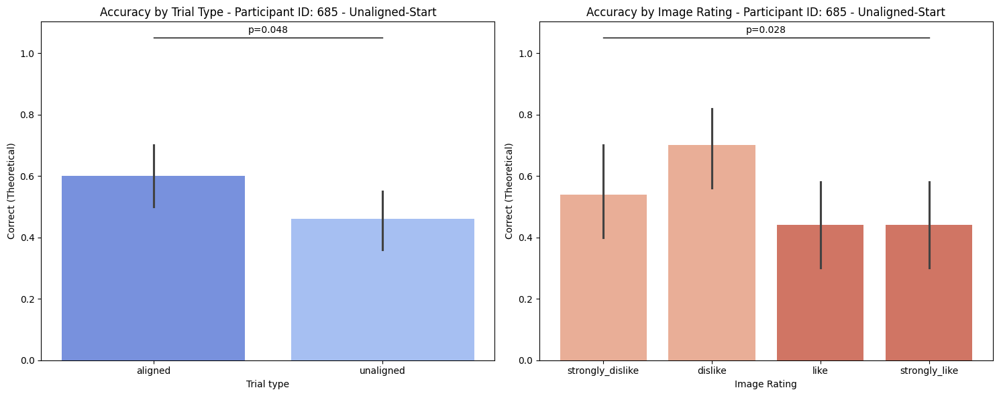

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.006).


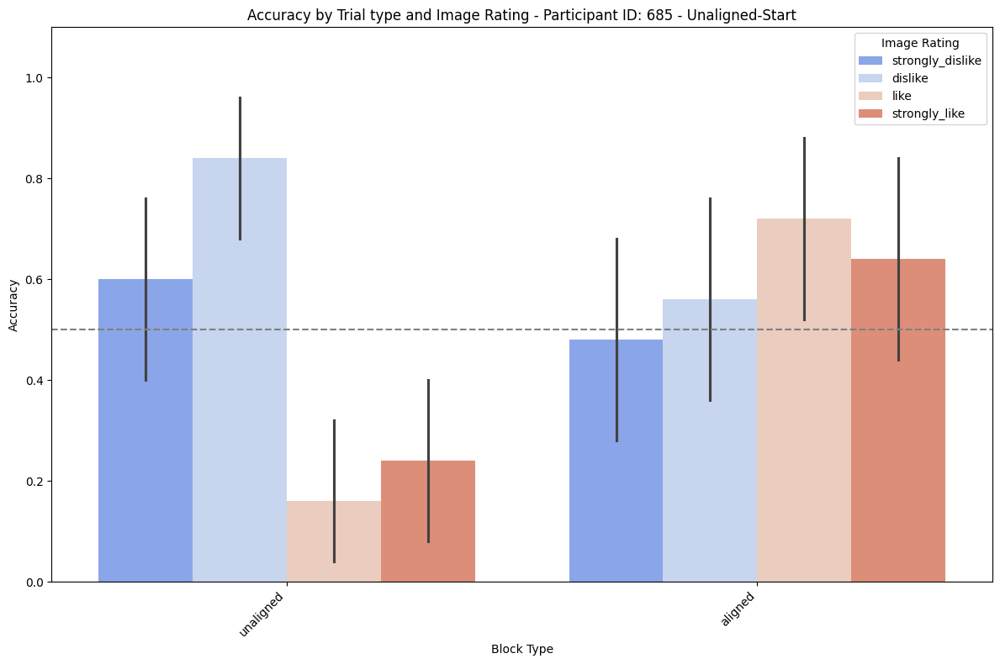

Data for participant 682:
Participant ID: 682

Accuracy in each 'Block':
Block
1    0.906250
2    0.333333
3    0.583333
4    0.194444
5    0.750000
6    0.166667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.231481
unaligned    0.740385
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 2.201521759068596e-15

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.906250
            2        0.333333
            3        0.583333
            4        0.194444
            5        0.750000
            6        0.166667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.528302
like                0.433962
strongly_dislike    0.509434
strongly_like       0.452830
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.732734059754354
Data for Chi-squared test:
Correct (Binary)  

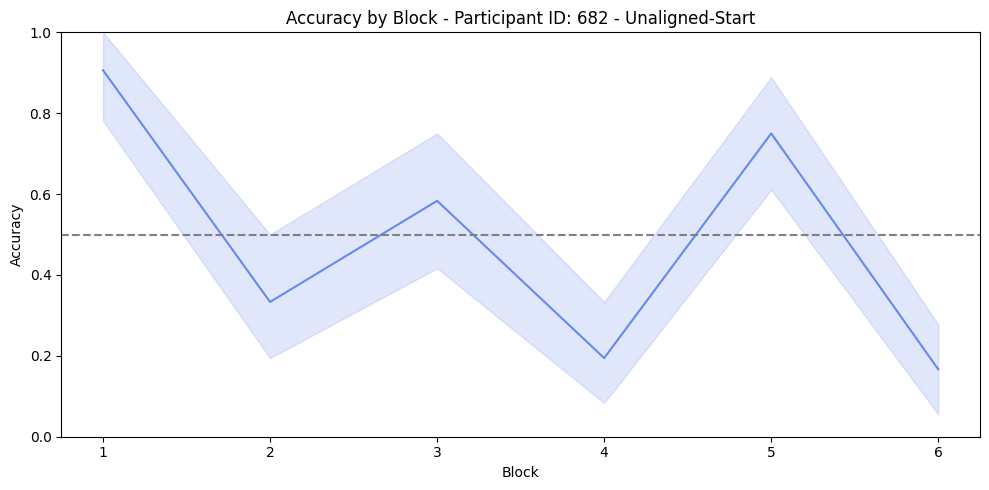

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


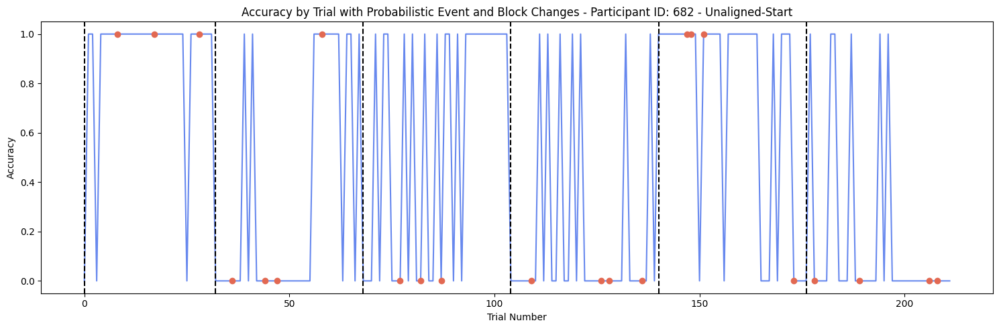

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


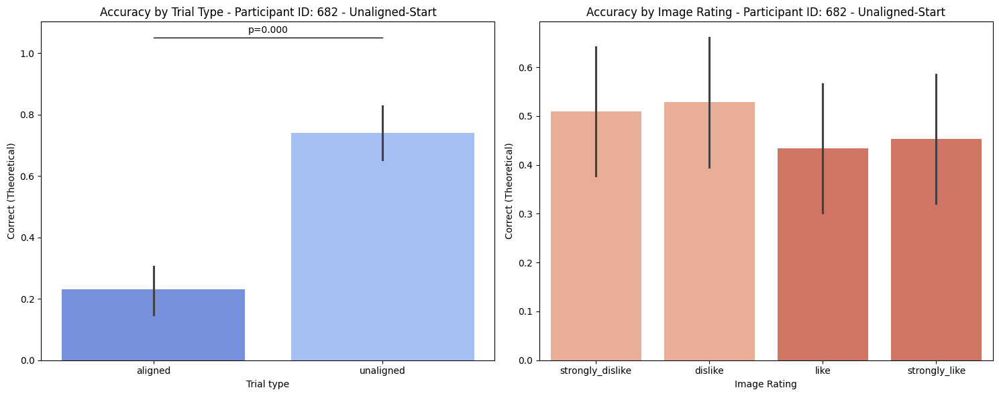

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.015).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.048).


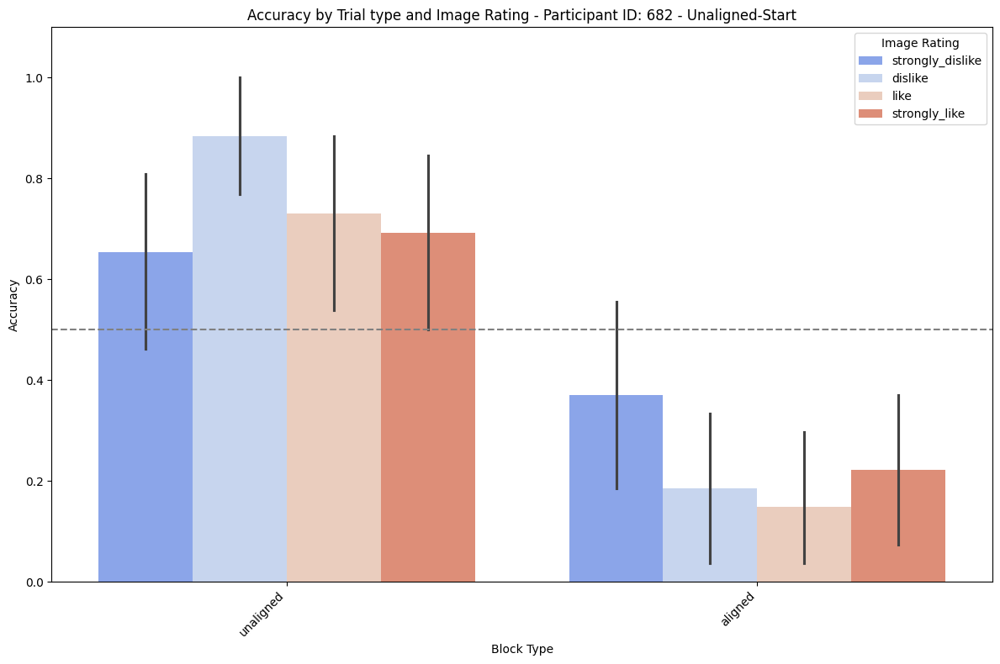

Data for participant 684:
Participant ID: 684

Accuracy in each 'Block':
Block
1    0.437500
2    0.531250
3    0.312500
4    0.666667
5    0.750000
6    0.361111
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.519231
unaligned    0.500000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.787066284580852

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.437500
            2        0.531250
            3        0.312500
            4        0.666667
            5        0.750000
            6        0.361111
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.56
like                0.58
strongly_dislike    0.48
strongly_like       0.42
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.350252073795245
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating 

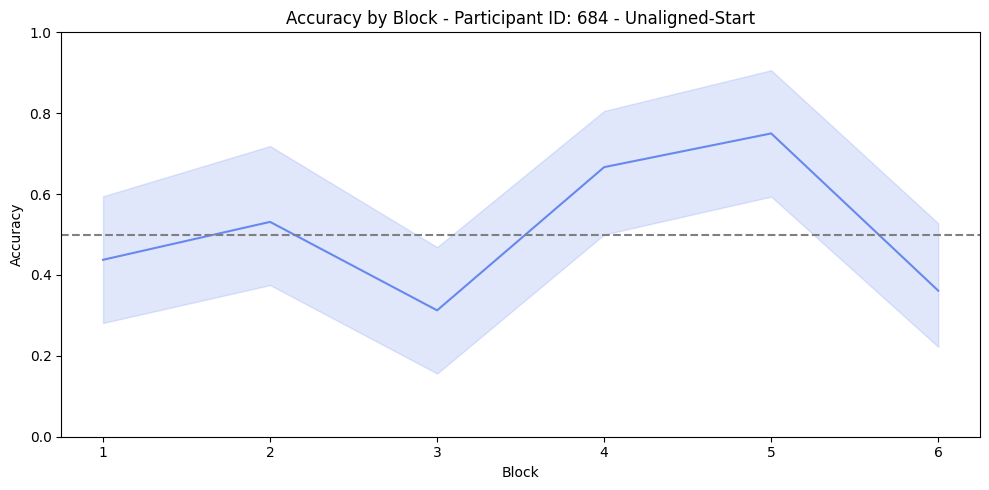

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


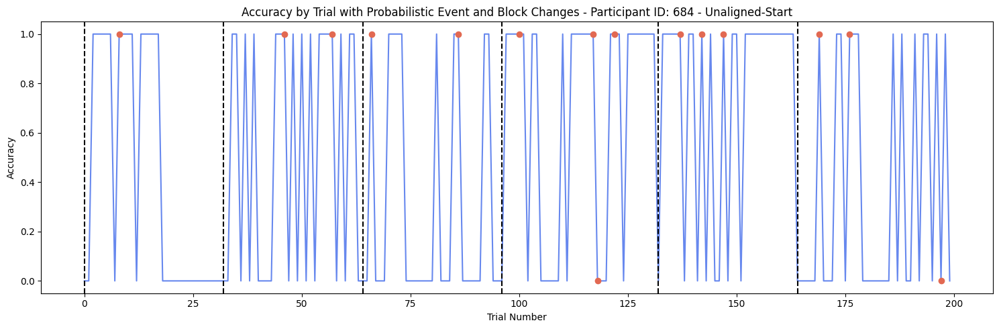

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


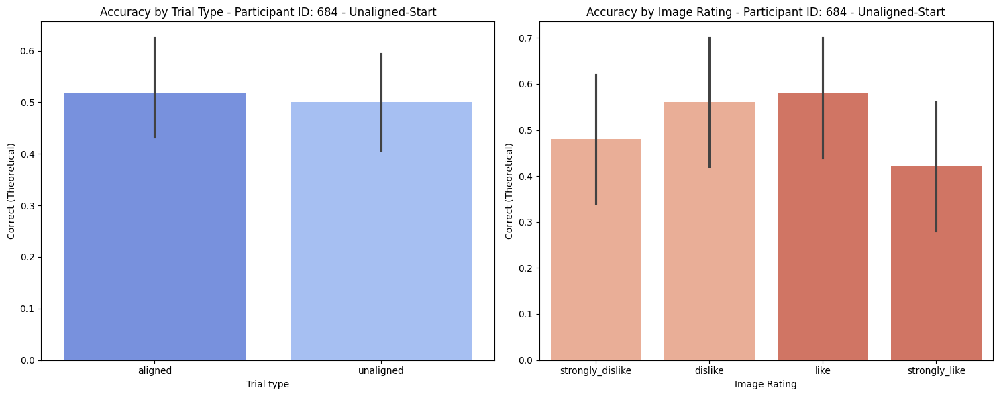

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.038).


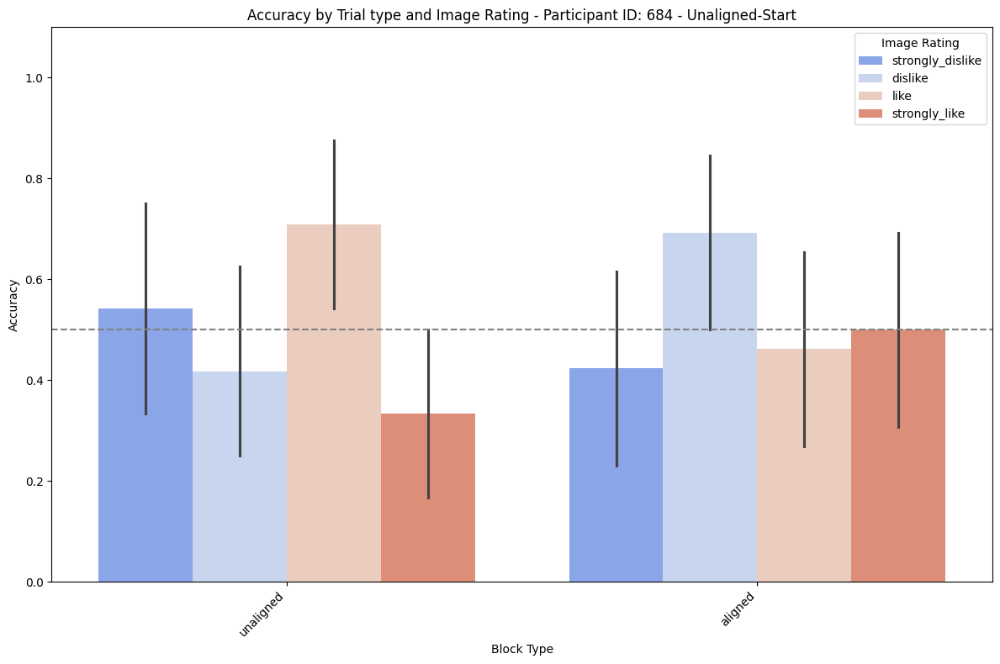

Data for participant 672:
Participant ID: 672

Accuracy in each 'Block':
Block
1    0.527778
2    0.416667
3    0.281250
4    0.500000
5    0.562500
6    0.375000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.432692
unaligned    0.460000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.6966047469838375

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.527778
            2        0.416667
            3        0.281250
            4        0.500000
            5        0.562500
            6        0.375000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.431373
like                0.372549
strongly_dislike    0.470588
strongly_like       0.509804
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.547328671633865
Data for Chi-squared test:
Correct (Binary)   0 

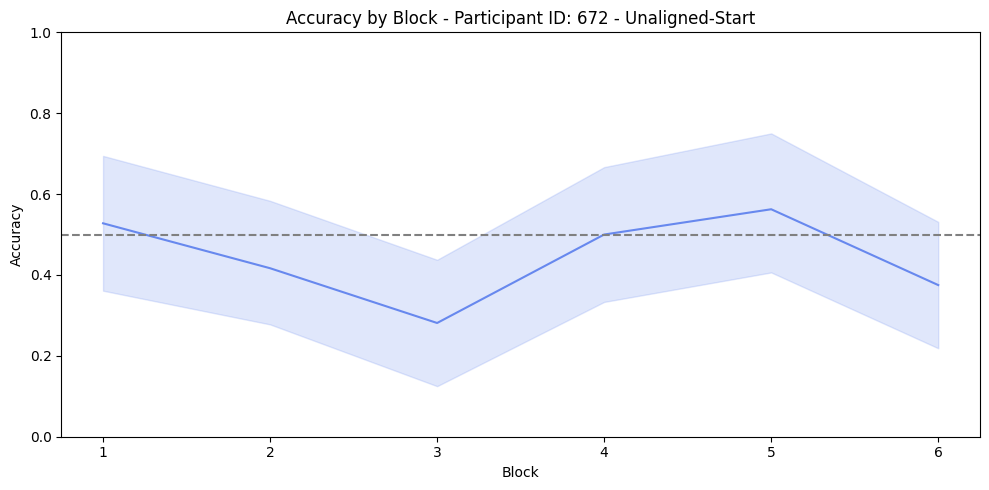

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


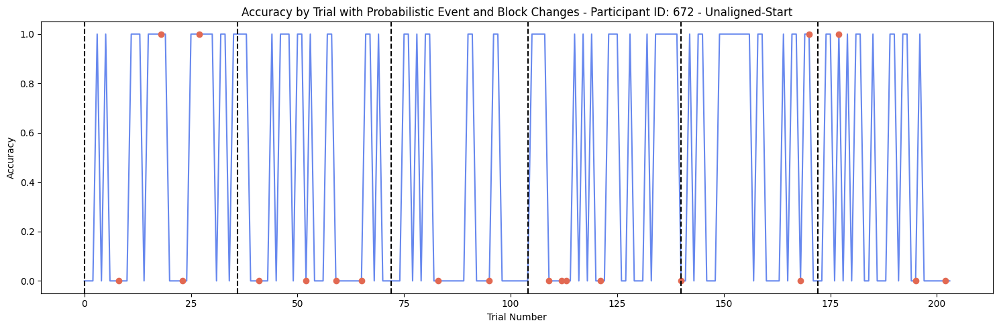

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


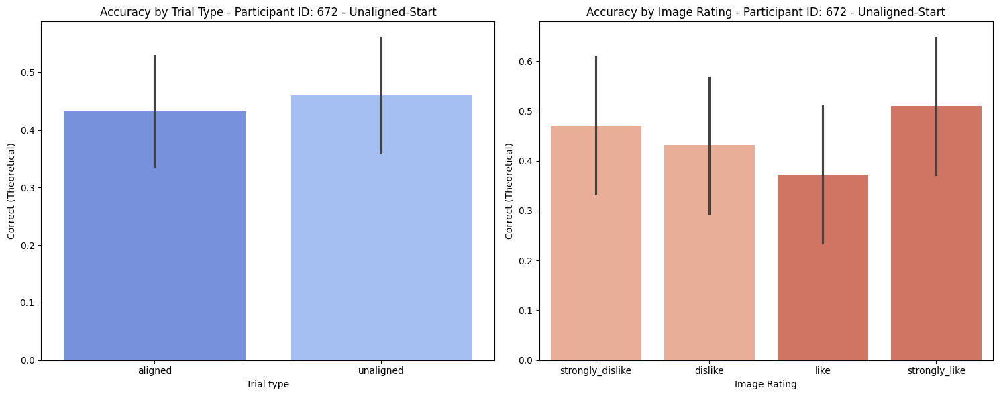

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.048).


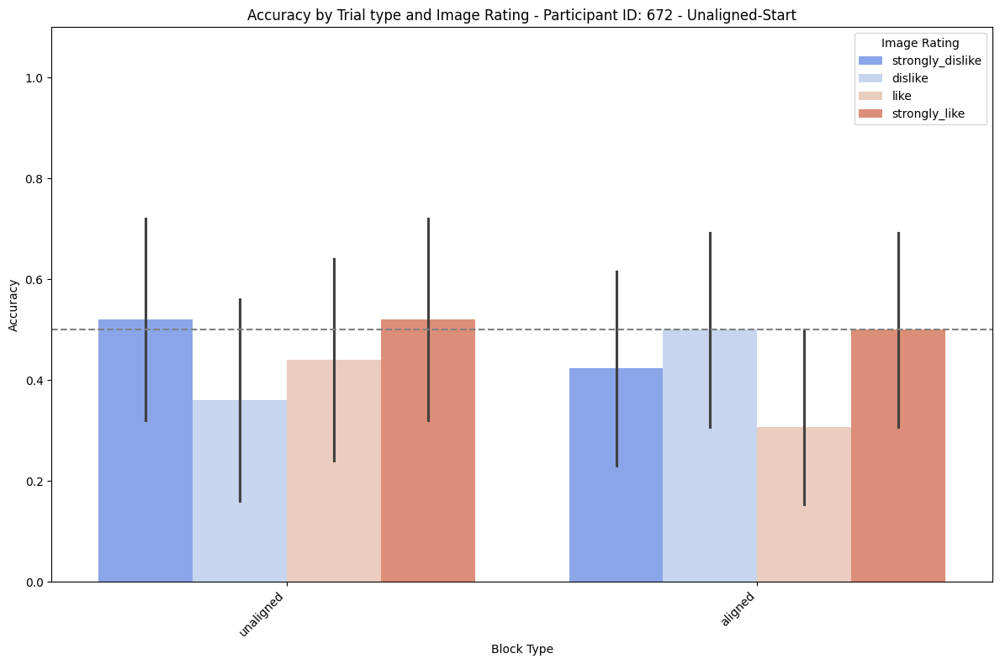

Data for participant 681:
Participant ID: 681

Accuracy in each 'Block':
Block
1    0.593750
2    0.805556
3    0.722222
4    0.687500
5    0.656250
6    0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.75
unaligned    0.66
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.15999478932189504

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.593750
            2        0.805556
            3        0.722222
            4        0.687500
            5        0.656250
            6        0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.725490
like                0.705882
strongly_dislike    0.725490
strongly_like       0.666667
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.904019039962367
Data for Chi-squared test:
Correct (Binary)   0   1
Ima

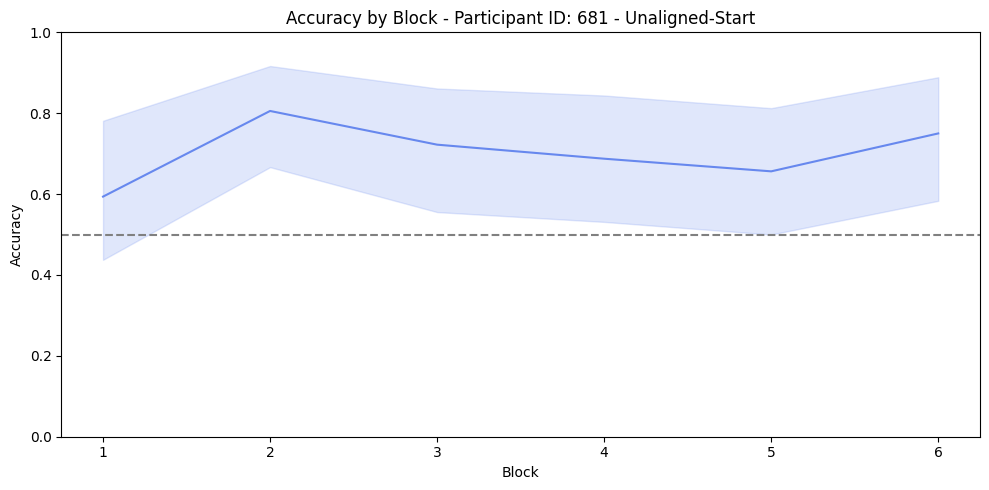

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


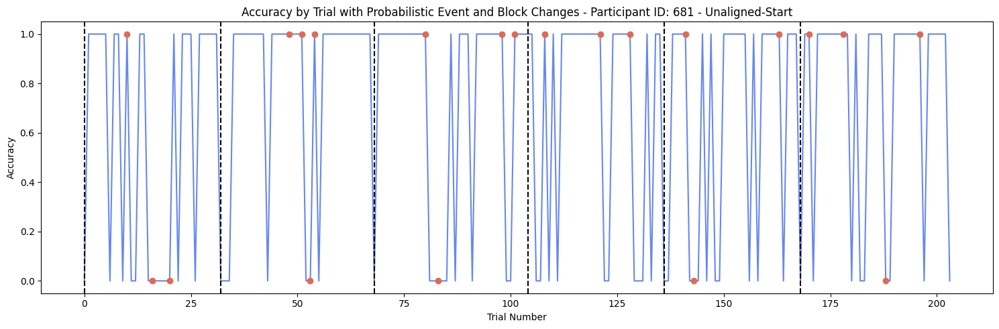

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


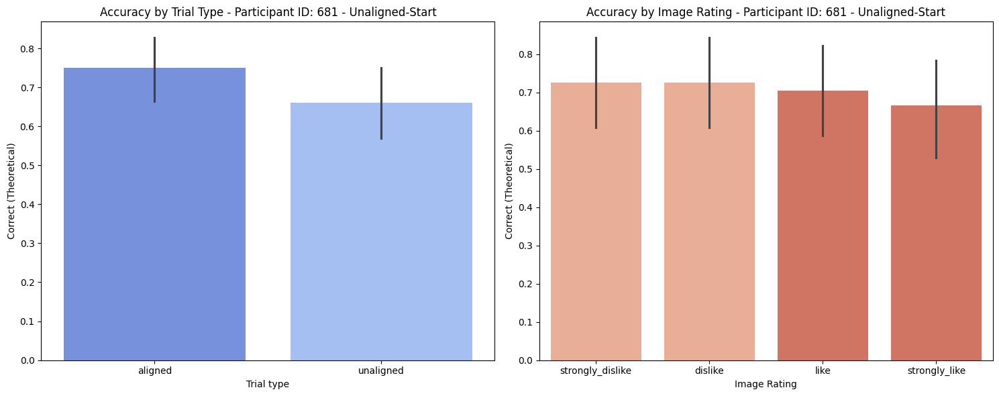

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.006).


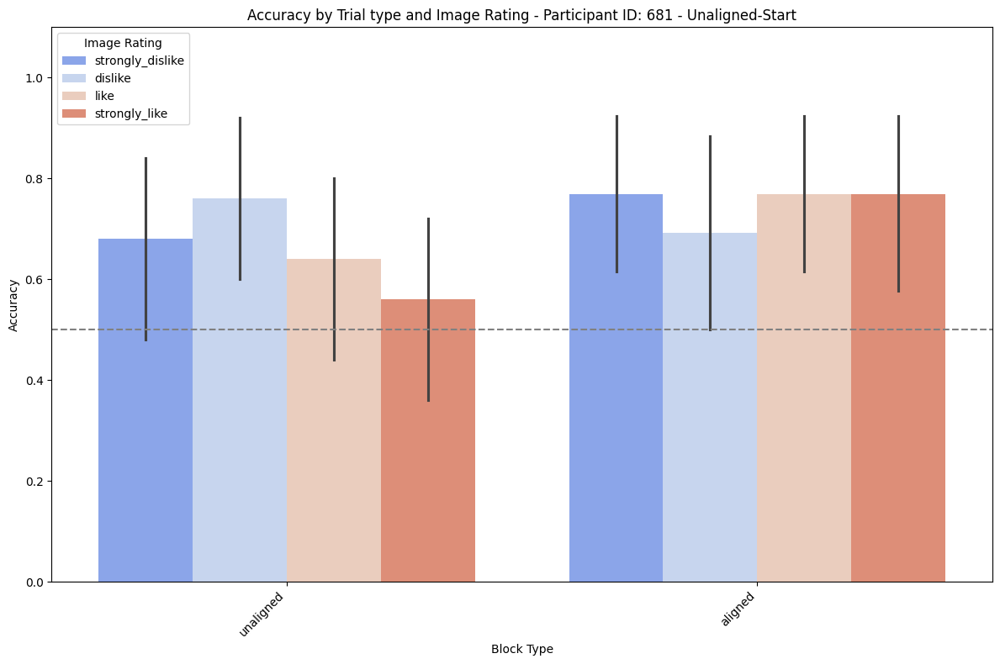

Data for participant 700:
Participant ID: 700

Accuracy in each 'Block':
Block
1    0.812500
2    0.666667
3    0.437500
4    0.305556
5    0.375000
6    0.250000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.413462
unaligned    0.541667
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0702917706238089

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.812500
            2        0.666667
            3        0.437500
            4        0.305556
            5        0.375000
            6        0.250000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.48
like                0.44
strongly_dislike    0.48
strongly_like       0.50
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.944148561777948
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating

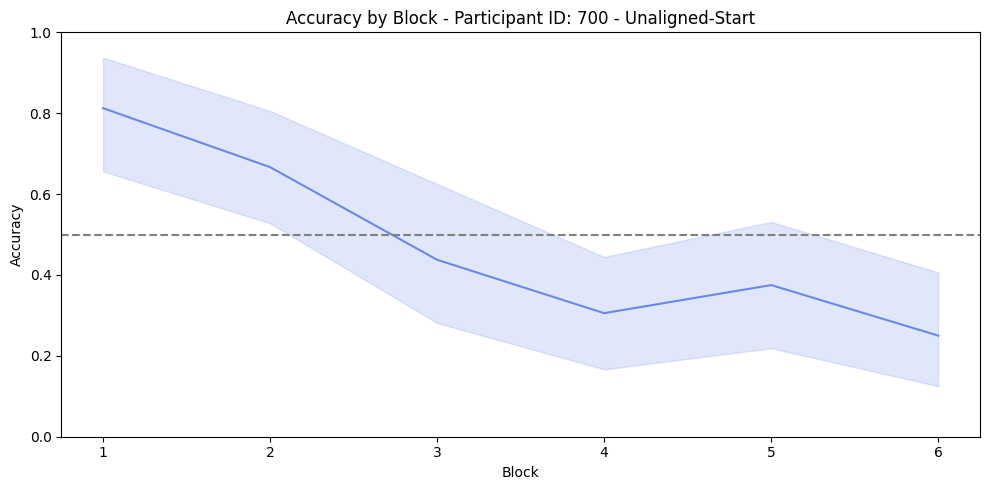

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


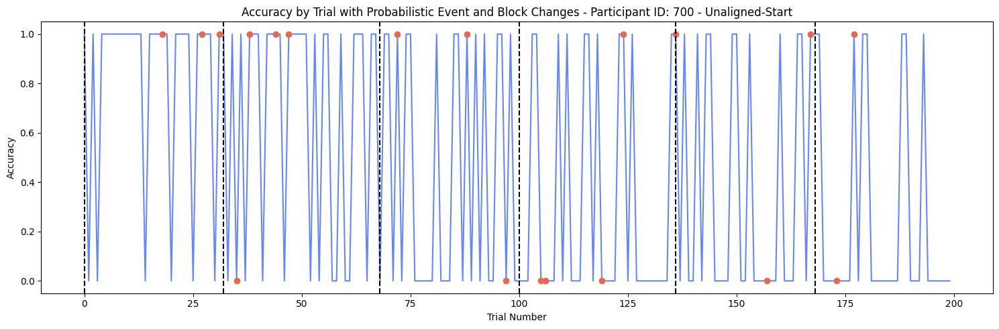

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


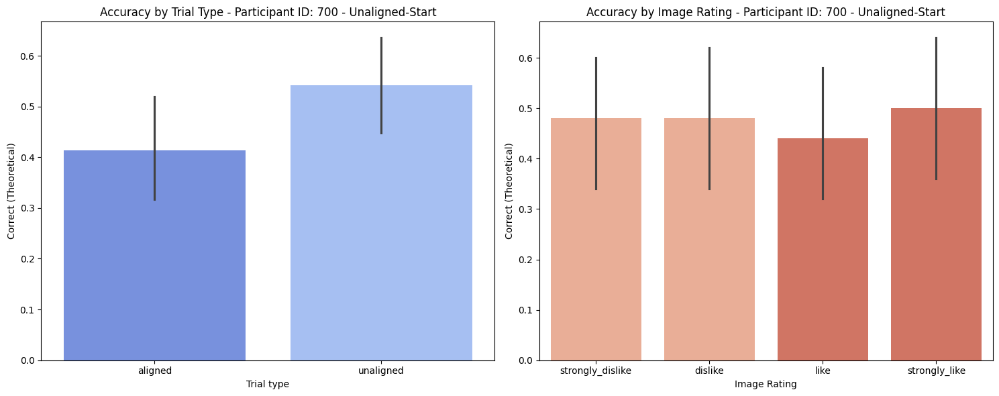

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.048).


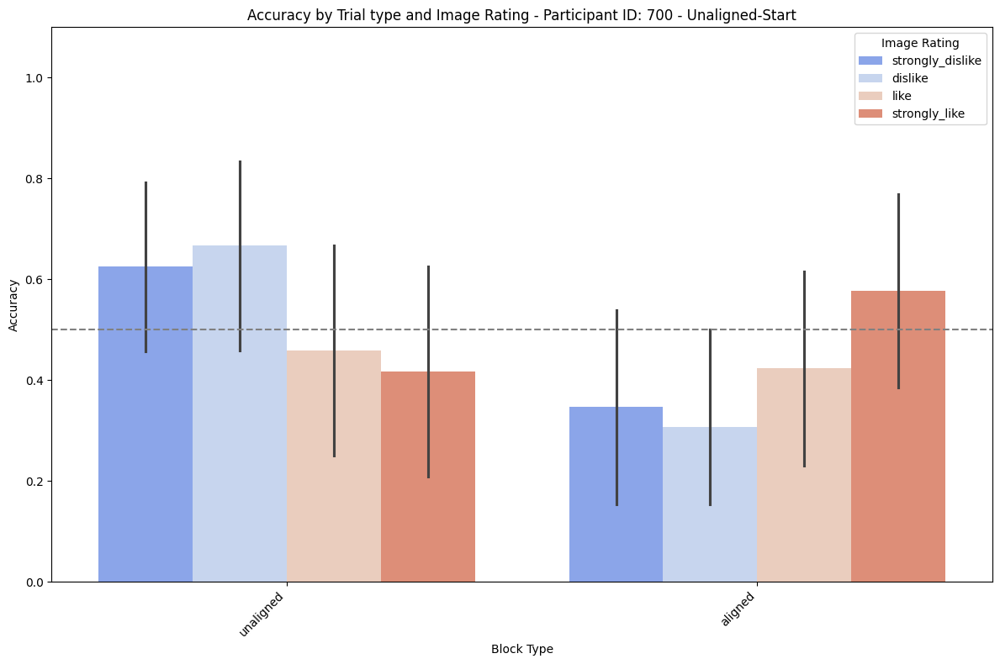

Data for participant 702:
Participant ID: 702

Accuracy in each 'Block':
Block
1    0.638889
2    0.468750
3    0.500000
4    0.555556
5    0.687500
6    0.444444
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.490385
unaligned    0.605769
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.09543529098988937

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.638889
            2        0.468750
            3        0.500000
            4        0.555556
            5        0.687500
            6        0.444444
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.538462
like                0.500000
strongly_dislike    0.576923
strongly_like       0.576923
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.836499990132951
Data for Chi-squared test:
Correct (Binary)   0

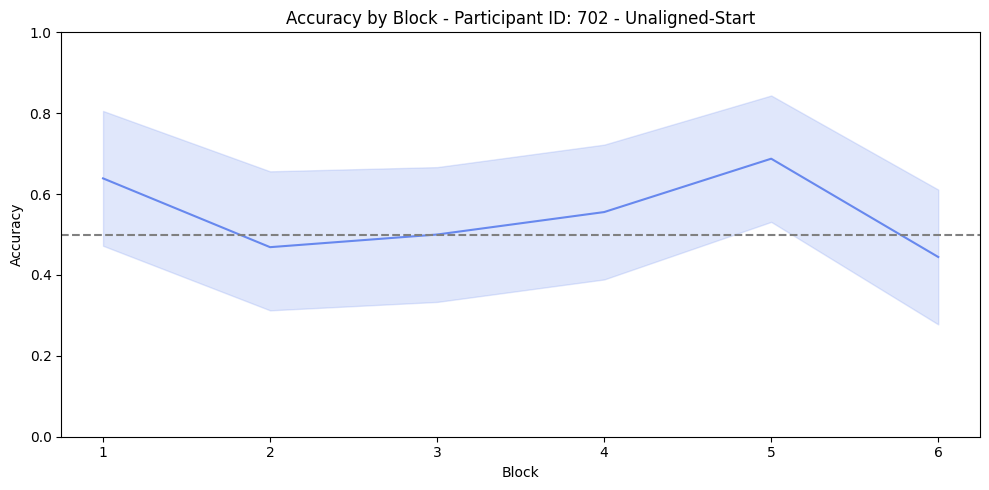

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


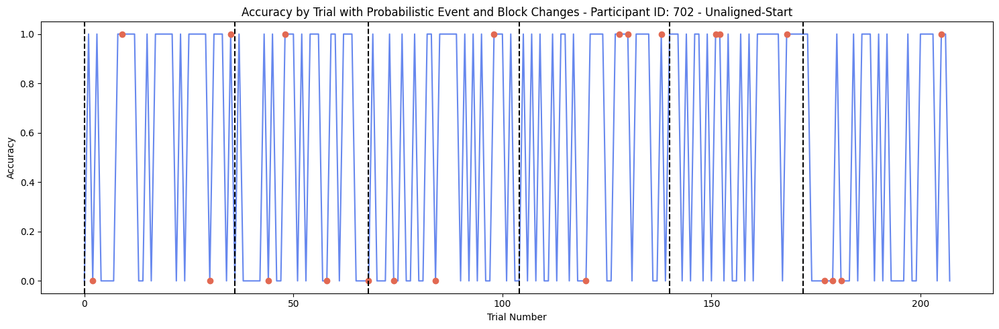

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


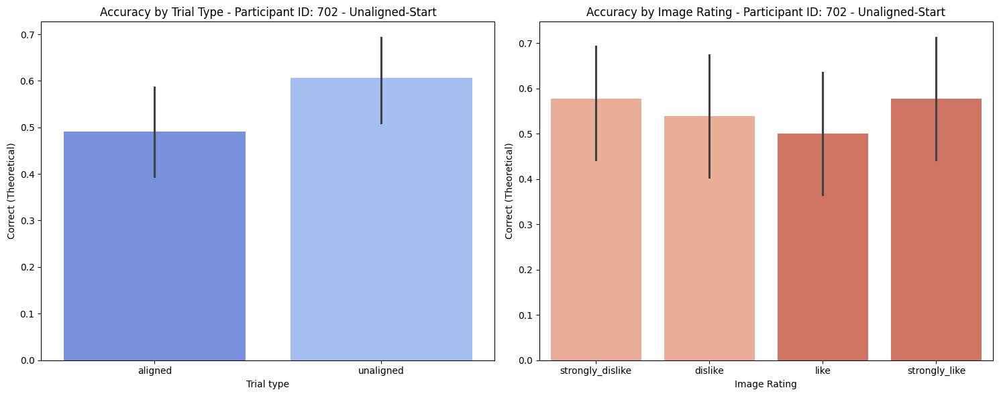

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.048).


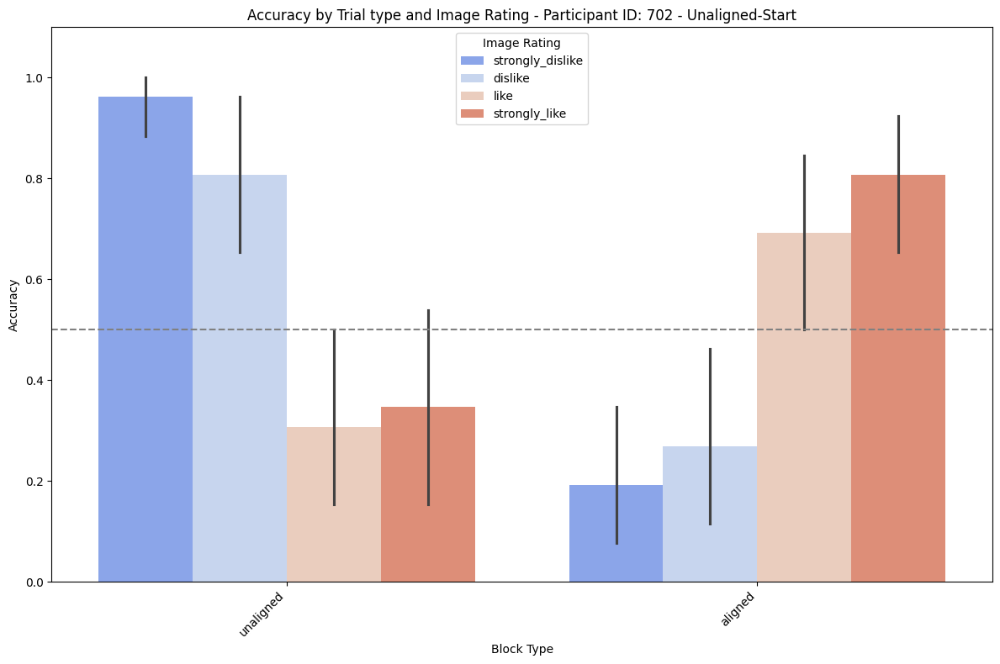

Data for participant 690:
Participant ID: 690

Accuracy in each 'Block':
Block
1    0.861111
2    0.611111
3    0.593750
4    0.656250
5    0.583333
6    0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.586538
unaligned    0.682692
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.15133594068332806

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.861111
            2        0.611111
            3        0.593750
            4        0.656250
            5        0.583333
            6        0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.692308
like                0.673077
strongly_dislike    0.480769
strongly_like       0.692308
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.067796060215102
Data for Chi-squared test:
Correct (Binary)   0

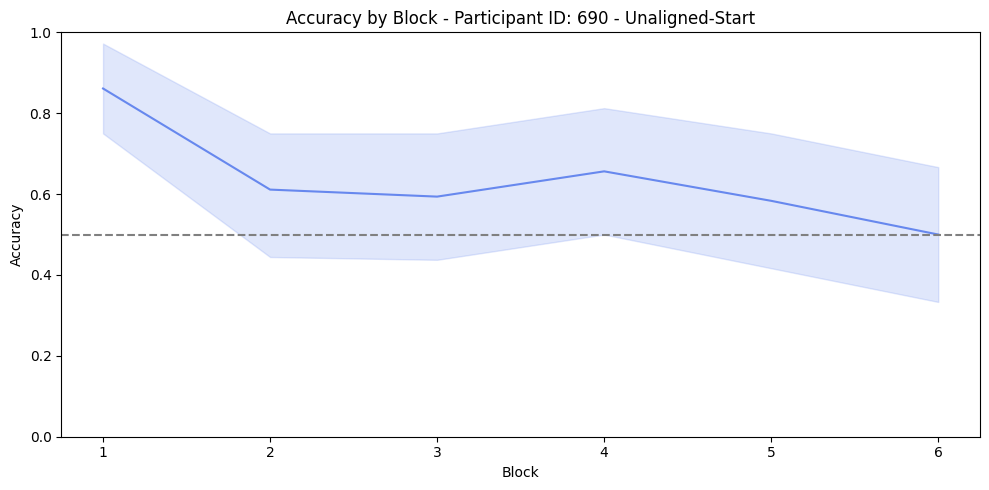

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


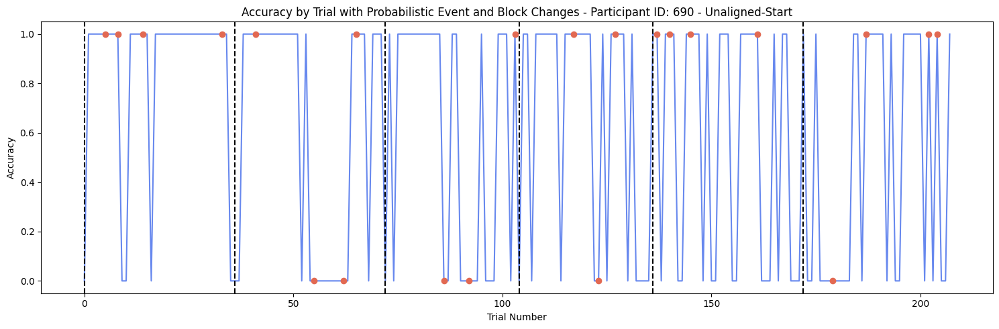

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


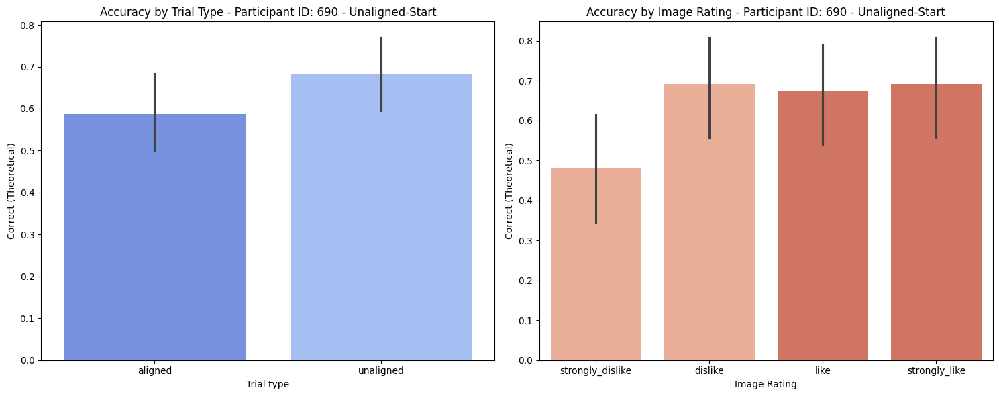

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.015).


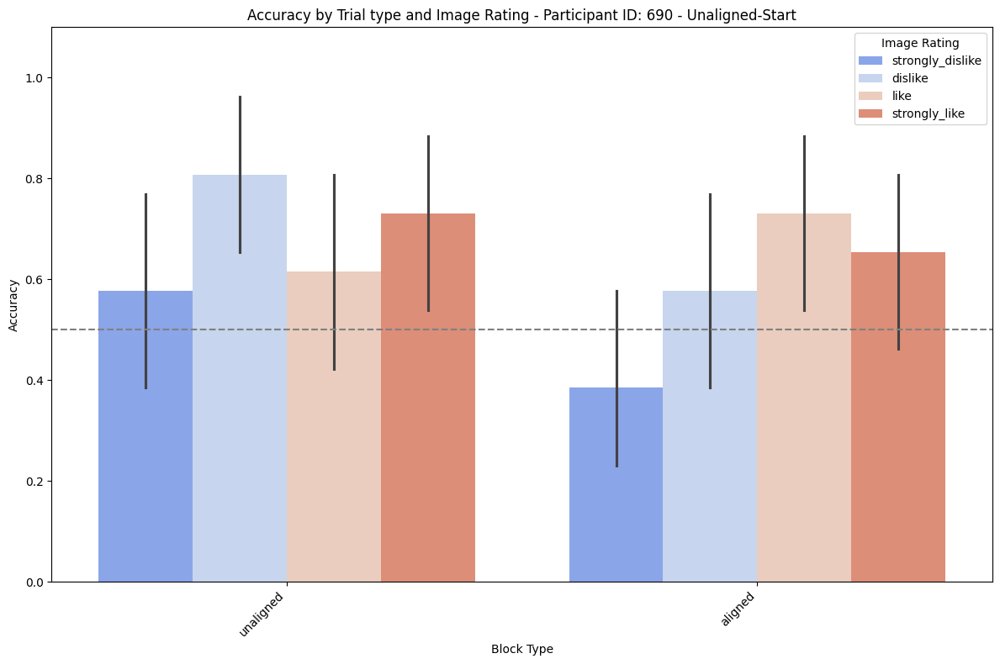

Data for participant 687:
Participant ID: 687

Accuracy in each 'Block':
Block
1    0.687500
2    0.531250
3    0.593750
4    0.472222
5    0.437500
6    0.562500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.520000
unaligned    0.572917
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.45955050719046453

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.687500
            2        0.531250
            3        0.593750
            4        0.472222
            5        0.437500
            6        0.562500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.571429
like                0.469388
strongly_dislike    0.551020
strongly_like       0.591837
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.635093378694273
Data for Chi-squared test:
Correct (Binary)   0

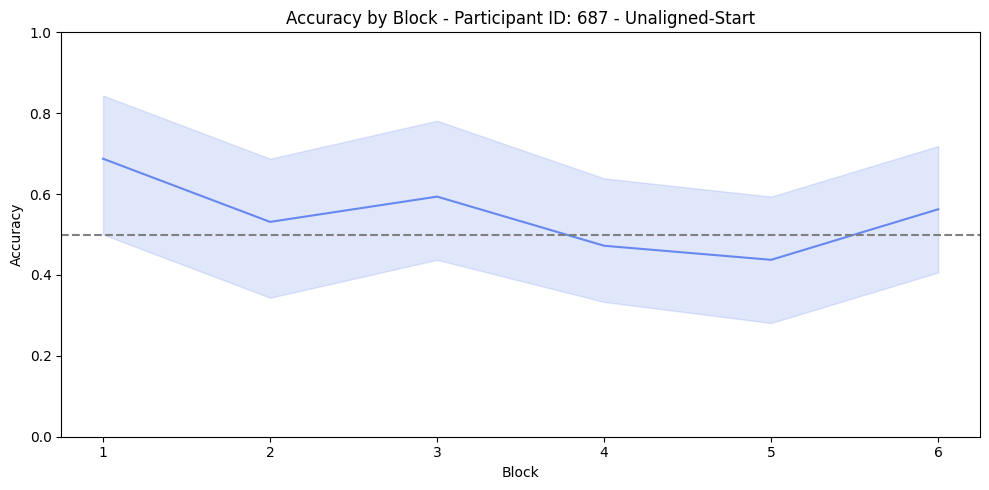

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


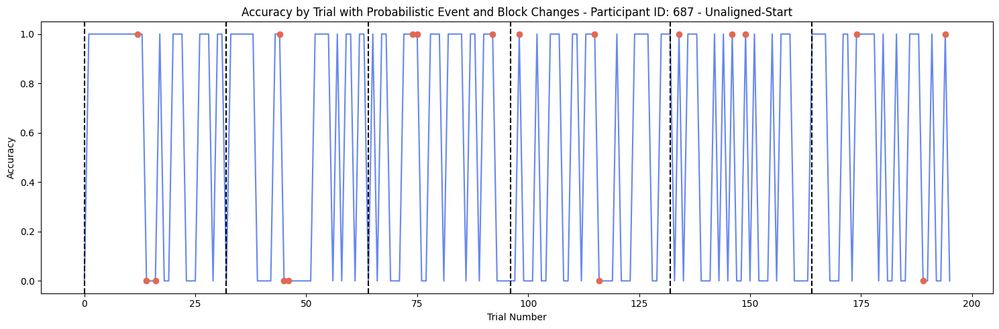

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


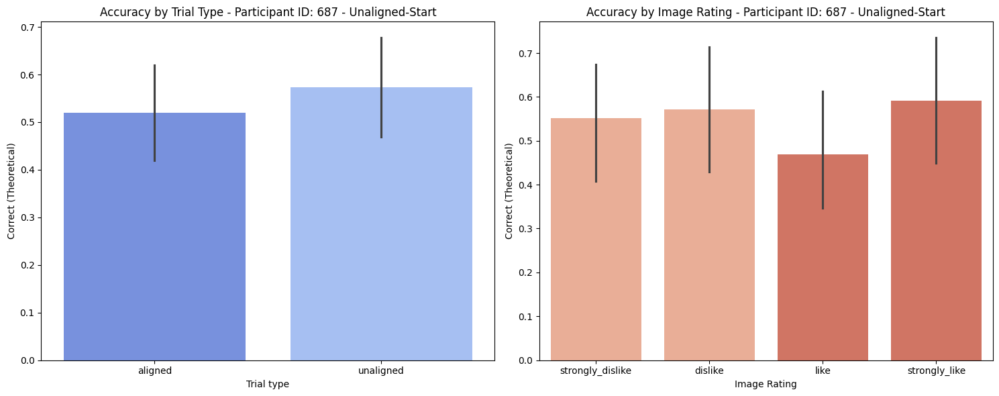

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.038).


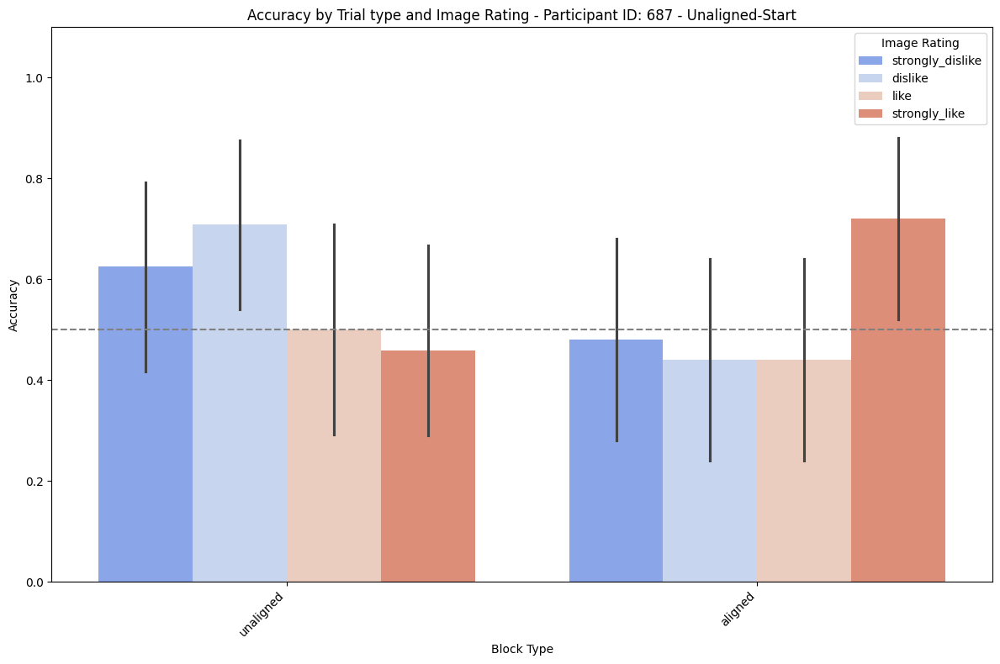

Data for participant 695:
Participant ID: 695

Accuracy in each 'Block':
Block
1    0.916667
2    0.843750
3    0.750000
4    0.777778
5    0.861111
6    0.656250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.760000
unaligned    0.842593
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.1359563506844527

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.916667
            2        0.843750
            3        0.750000
            4        0.777778
            5        0.861111
            6        0.656250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.788462
like                0.826923
strongly_dislike    0.807692
strongly_like       0.788462
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.953480746954426
Data for Chi-squared test:
Correct (Binary)   0 

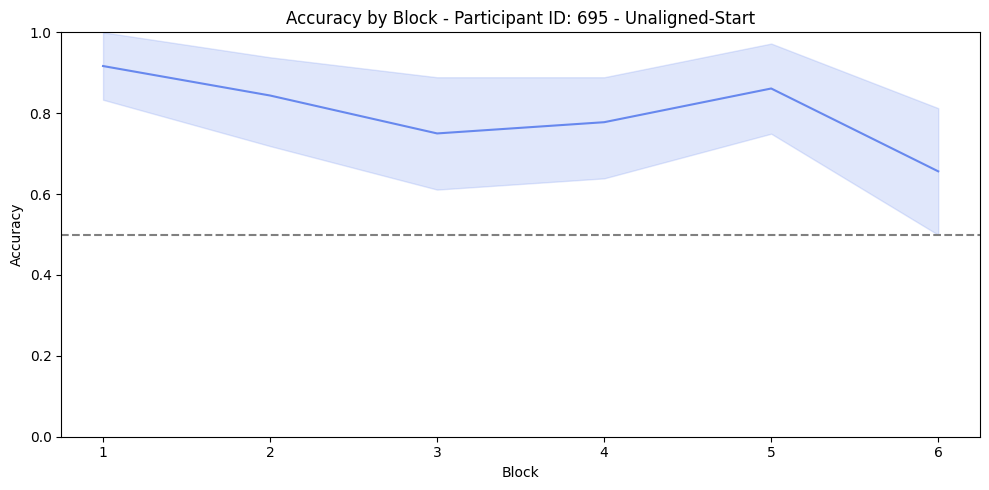

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


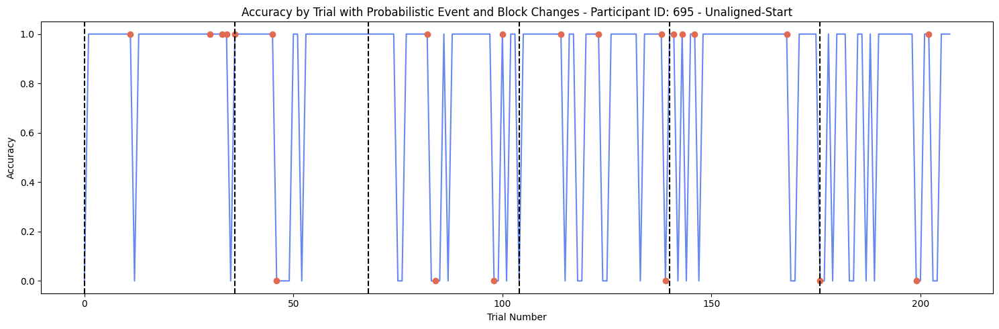

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


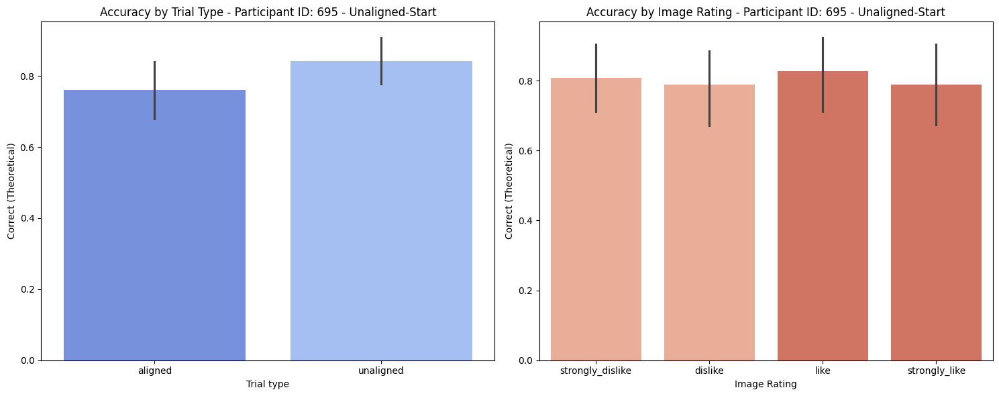

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.009).


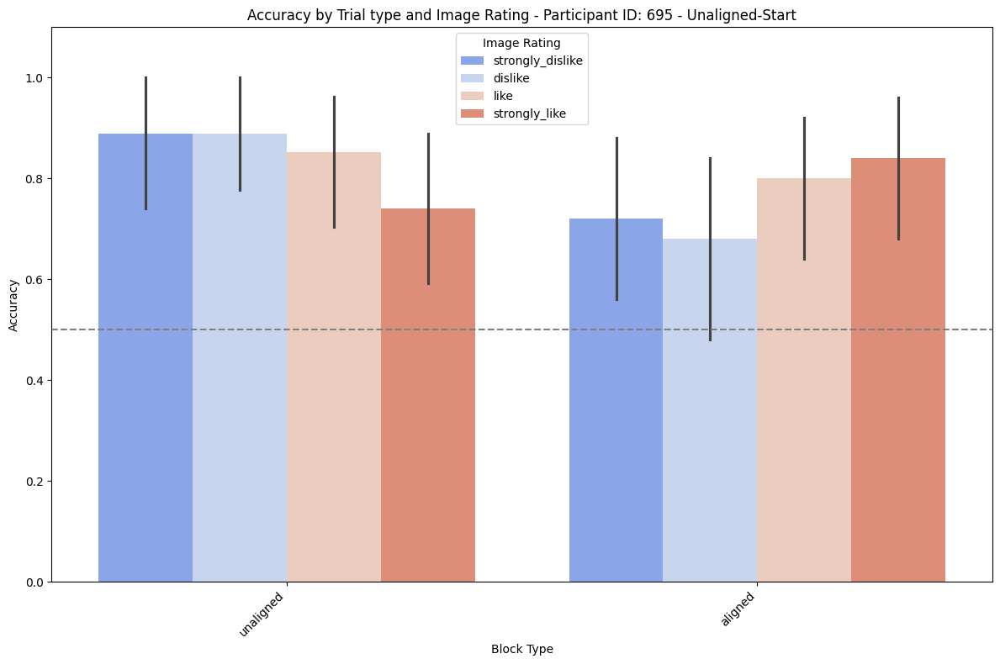

Data for participant 692:
Participant ID: 692

Accuracy in each 'Block':
Block
1    0.531250
2    0.781250
3    0.861111
4    0.805556
5    0.906250
6    0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.83
unaligned    0.77
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.29119705071060703

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.531250
            2        0.781250
            3        0.861111
            4        0.805556
            5        0.906250
            6        0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.78
like                0.82
strongly_dislike    0.76
strongly_like       0.84
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.741038888816529
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating       

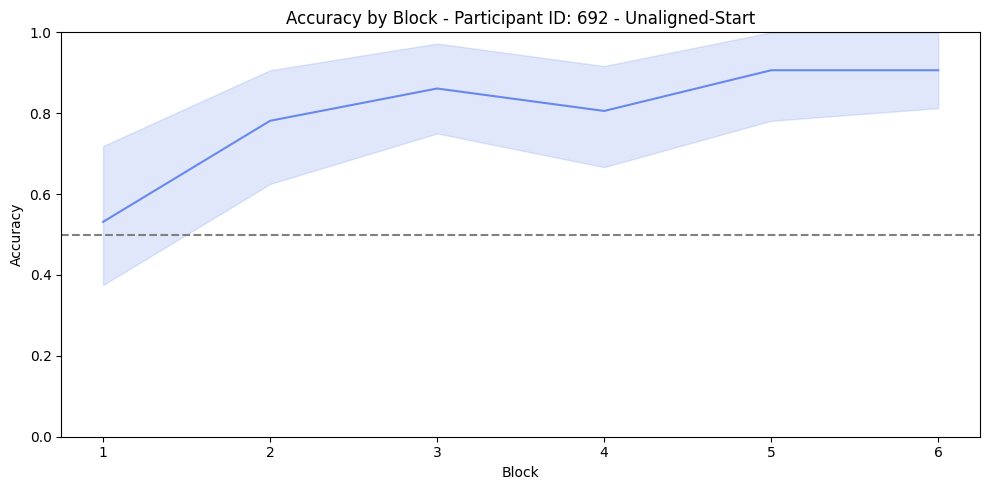

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


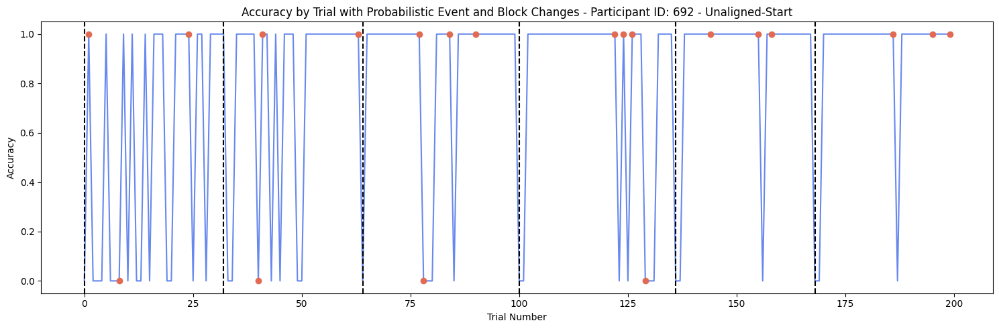

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


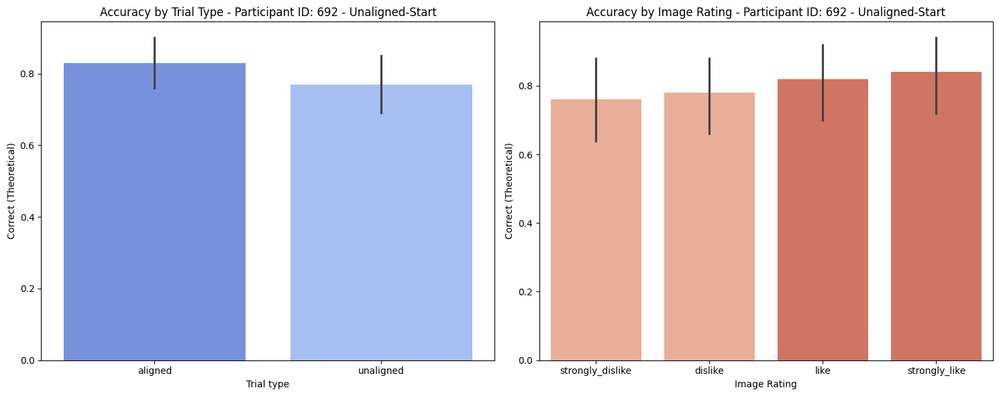

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


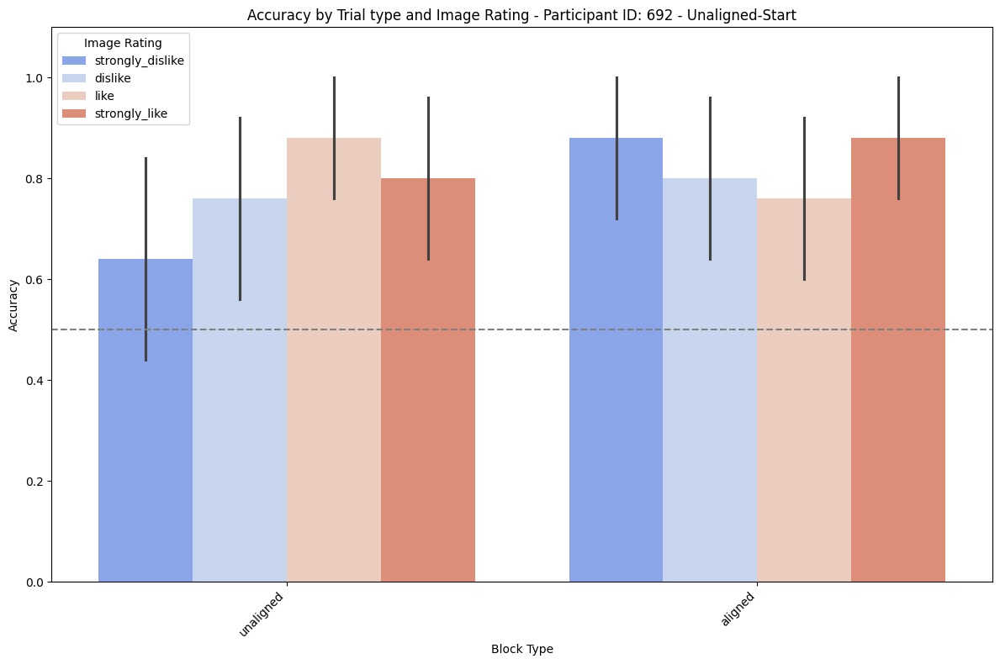

Data for participant 694:
Participant ID: 694

Accuracy in each 'Block':
Block
1    0.500000
2    0.500000
3    0.388889
4    0.388889
5    0.444444
6    0.593750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.490000
unaligned    0.444444
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.5128585638096326

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.500000
            2        0.500000
            3        0.388889
            4        0.388889
            5        0.444444
            6        0.593750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.557692
like                0.384615
strongly_dislike    0.538462
strongly_like       0.384615
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.131542580338976
Data for Chi-squared test:
Correct (Binary)   0 

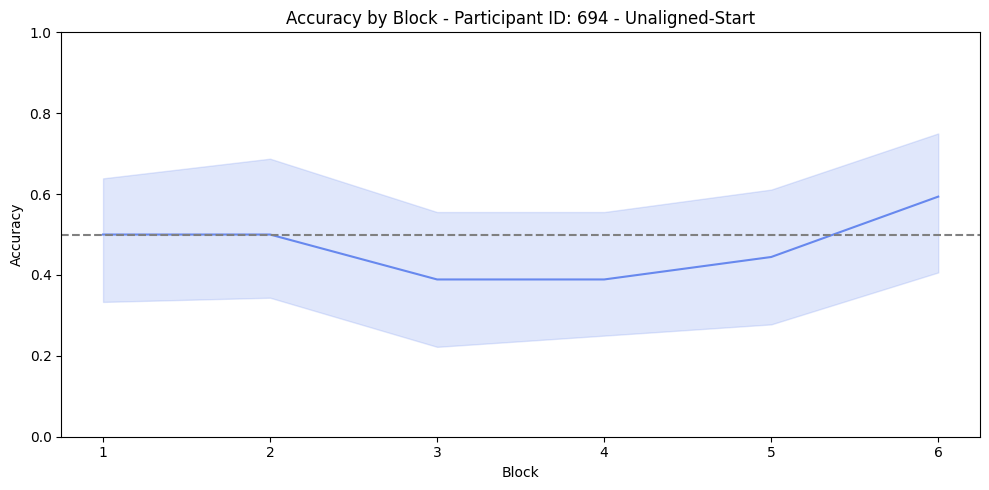

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


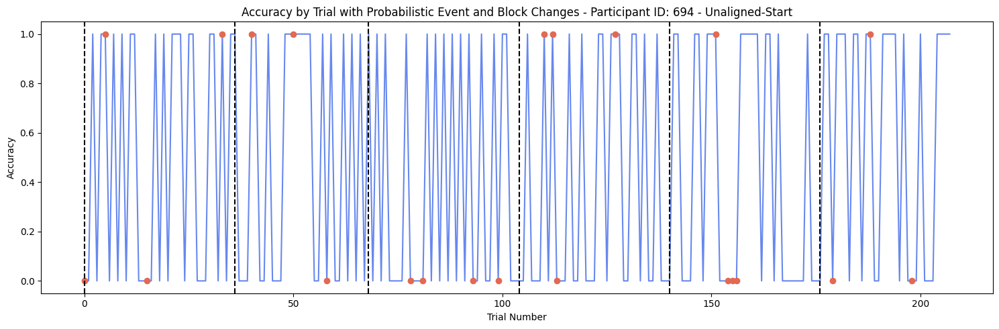

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


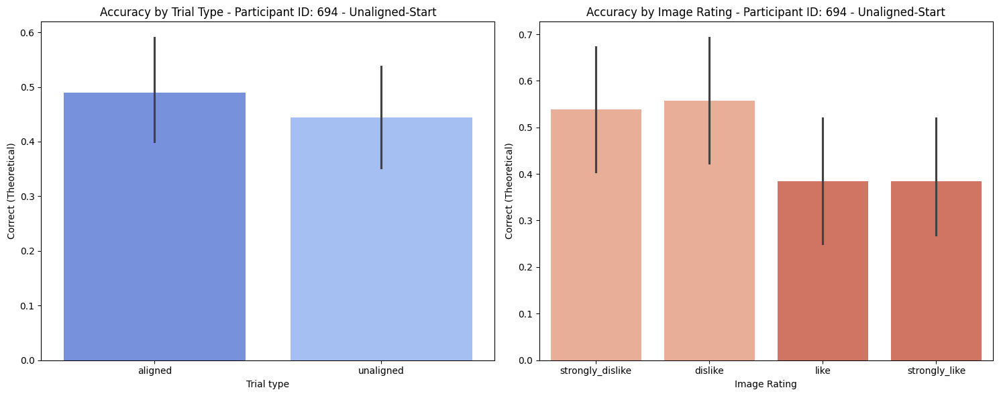

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.031).


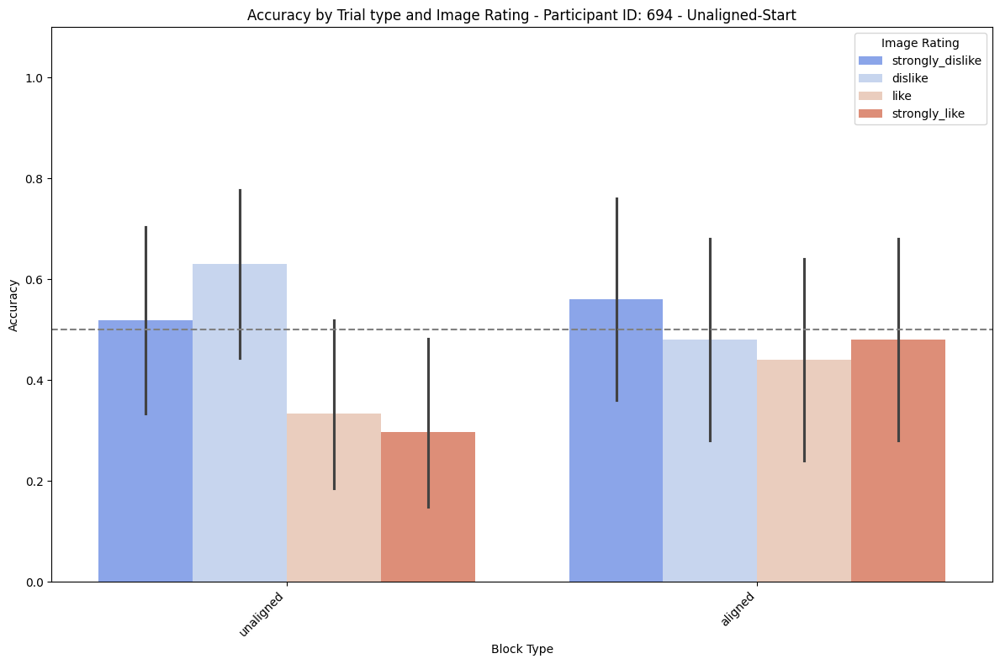

Data for participant 691:
Participant ID: 691

Accuracy in each 'Block':
Block
1    0.583333
2    0.527778
3    0.500000
4    0.333333
5    0.500000
6    0.406250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.423077
unaligned    0.530000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.1275842241965583

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.583333
            2        0.527778
            3        0.500000
            4        0.333333
            5        0.500000
            6        0.406250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.529412
like                0.509804
strongly_dislike    0.450980
strongly_like       0.411765
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.617416305378577
Data for Chi-squared test:
Correct (Binary)   0 

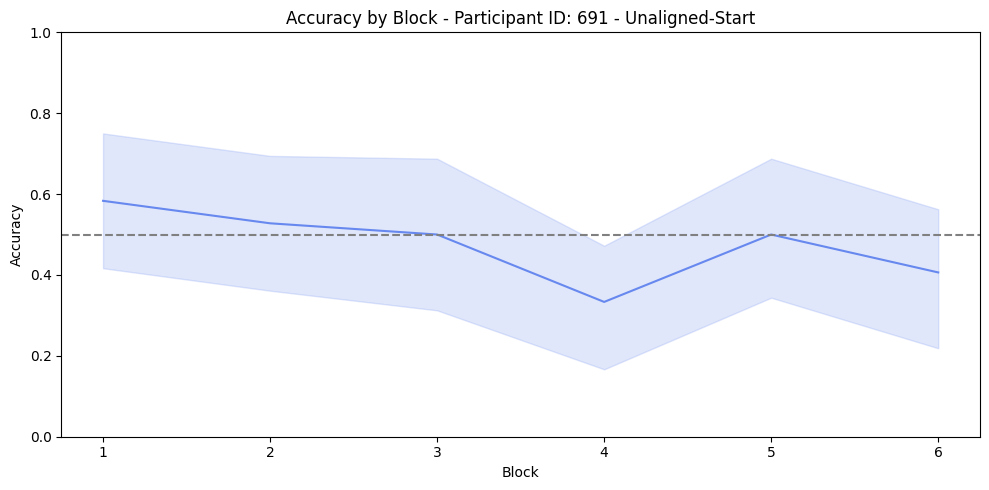

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


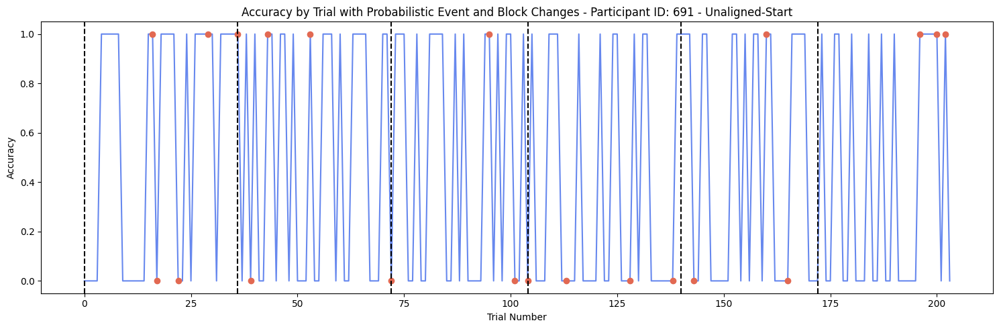

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


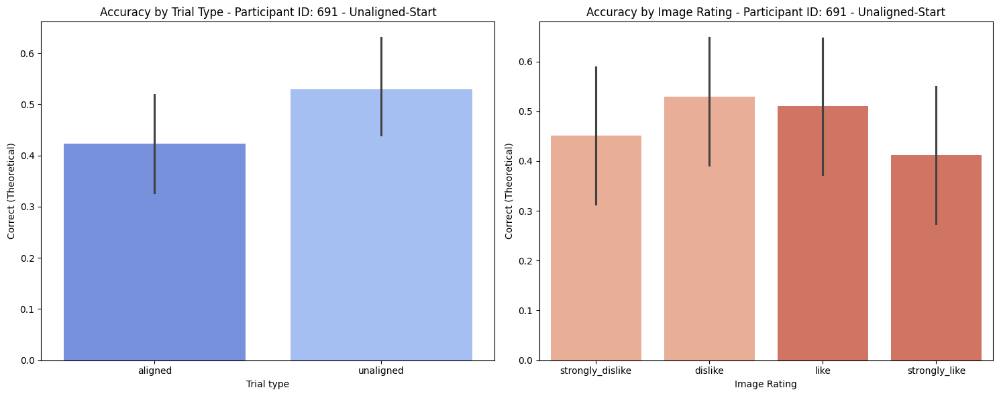

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).


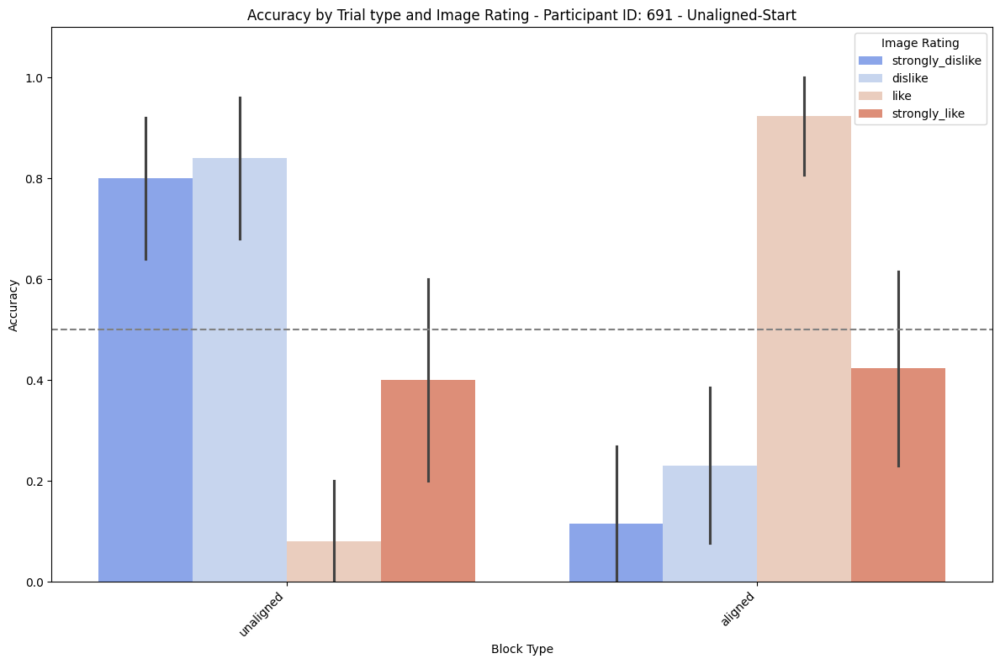

Data for participant 689:
Participant ID: 689

Accuracy in each 'Block':
Block
1    0.416667
2    0.906250
3    0.833333
4    0.888889
5    0.562500
6    0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.850000
unaligned    0.605769
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 7.514823562330718e-05

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.416667
            2        0.906250
            3        0.833333
            4        0.888889
            5        0.562500
            6        0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.705882
like                0.745098
strongly_dislike    0.745098
strongly_like       0.705882
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.941515666593847
Data for Chi-squared test:
Correct (Binary)  

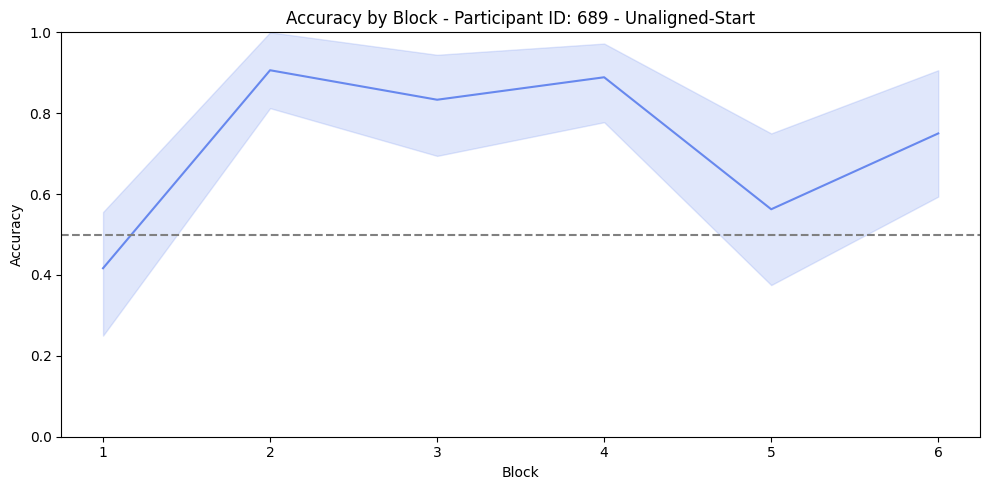

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


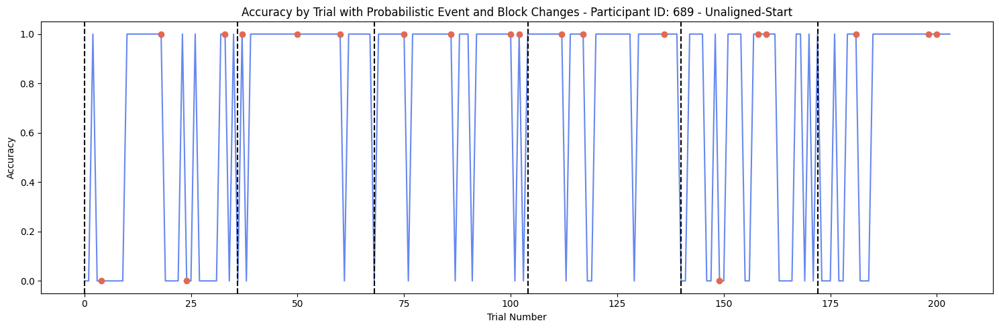

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


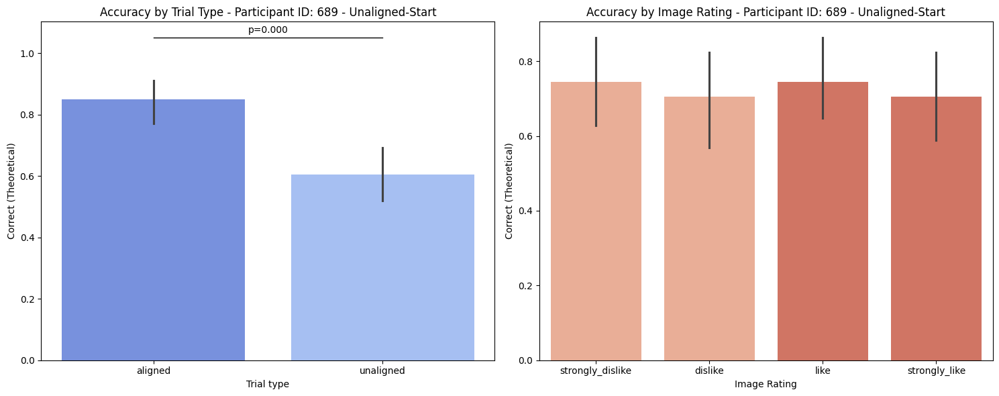

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.048).


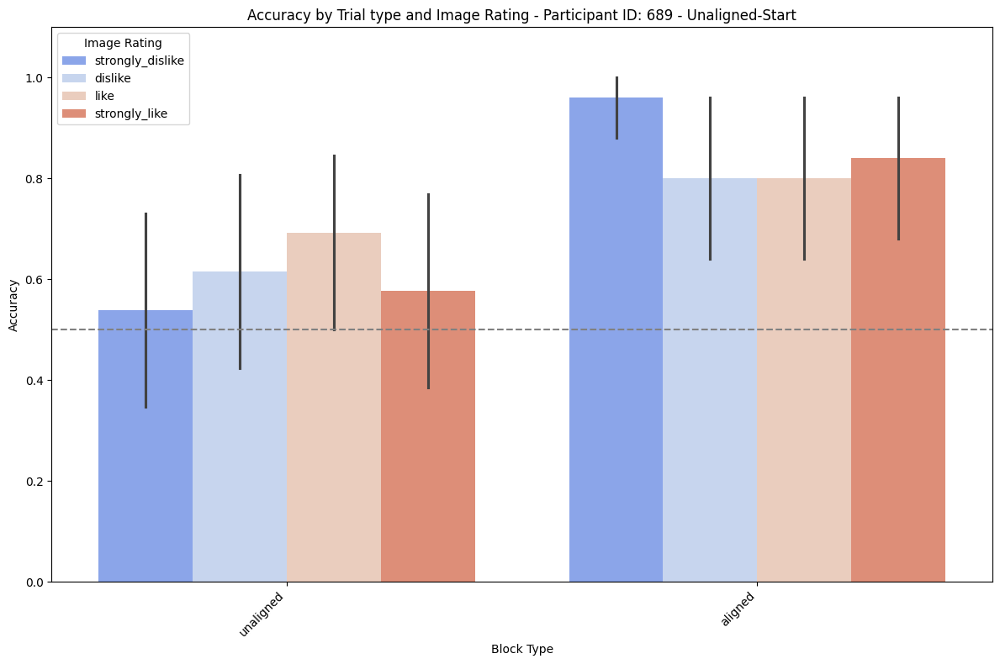

Data for participant 720:
Participant ID: 720

Accuracy in each 'Block':
Block
1    0.375000
2    0.437500
3    0.388889
4    0.361111
5    0.472222
6    0.468750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.420000
unaligned    0.413462
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.9250189374835012

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.375000
            2        0.437500
            3        0.388889
            4        0.361111
            5        0.472222
            6        0.468750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.392157
like                0.411765
strongly_dislike    0.411765
strongly_like       0.450980
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.943692064070008
Data for Chi-squared test:
Correct (Binary)   0 

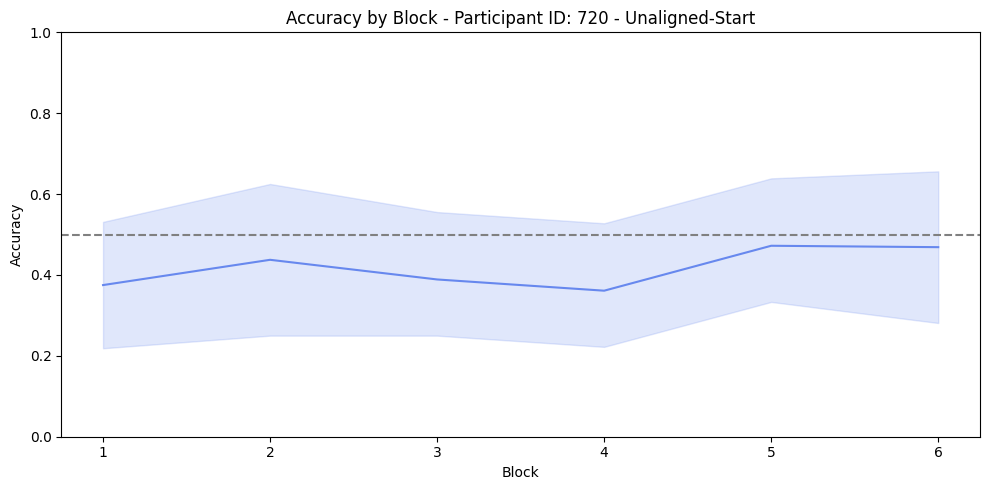

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


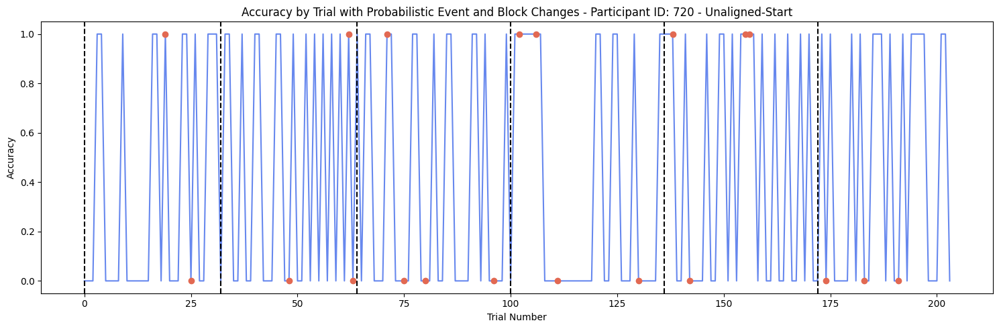

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


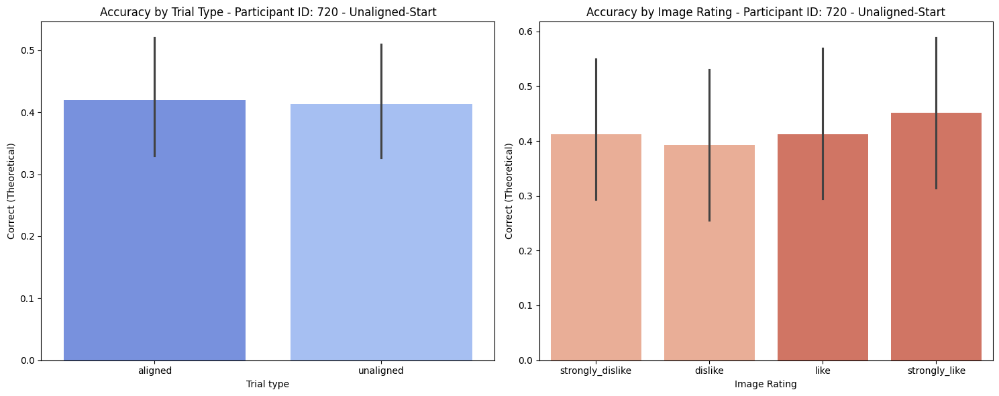

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.048).


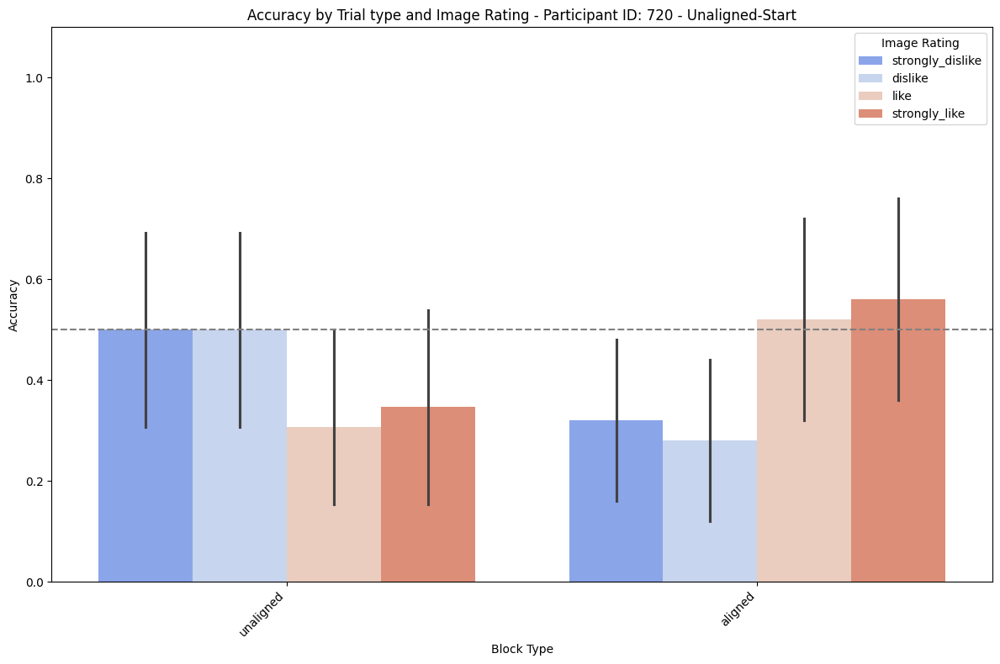

Data for participant 721:
Participant ID: 721

Accuracy in each 'Block':
Block
1    0.694444
2    0.722222
3    0.562500
4    0.656250
5    0.437500
6    0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.711538
unaligned    0.570000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.03513612425053753

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.694444
            2        0.722222
            3        0.562500
            4        0.656250
            5        0.437500
            6        0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.745098
like                0.686275
strongly_dislike    0.588235
strongly_like       0.549020
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.147611996388447
Data for Chi-squared test:
Correct (Binary)   0

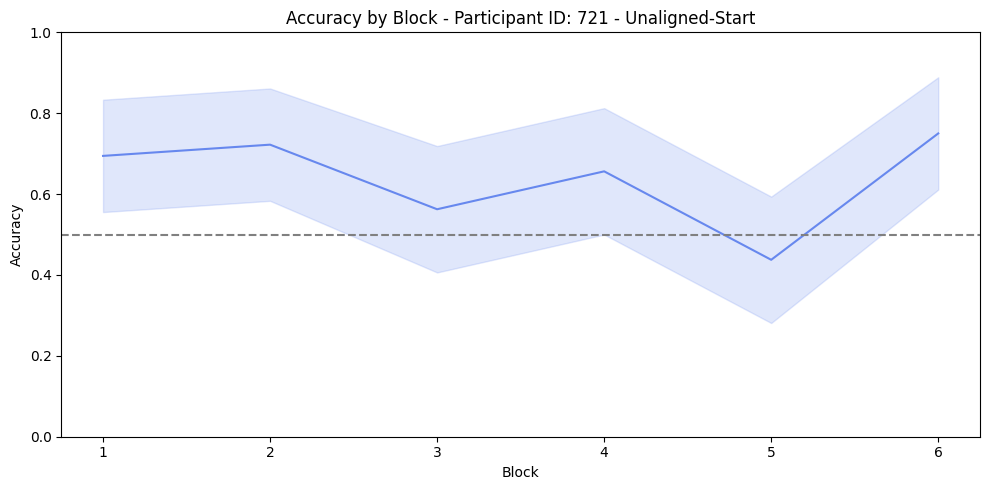

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


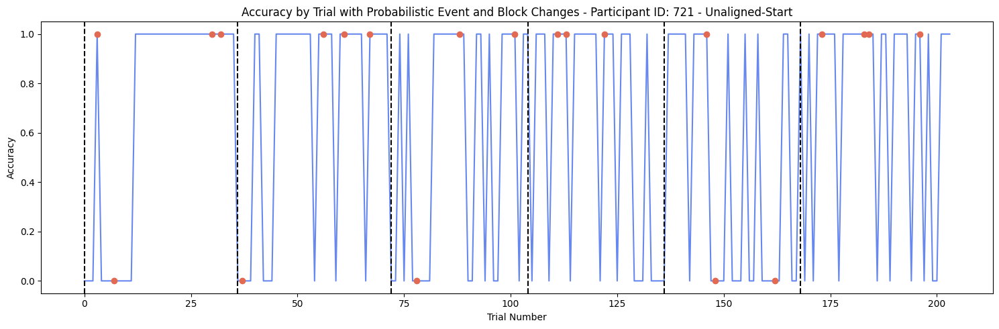

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


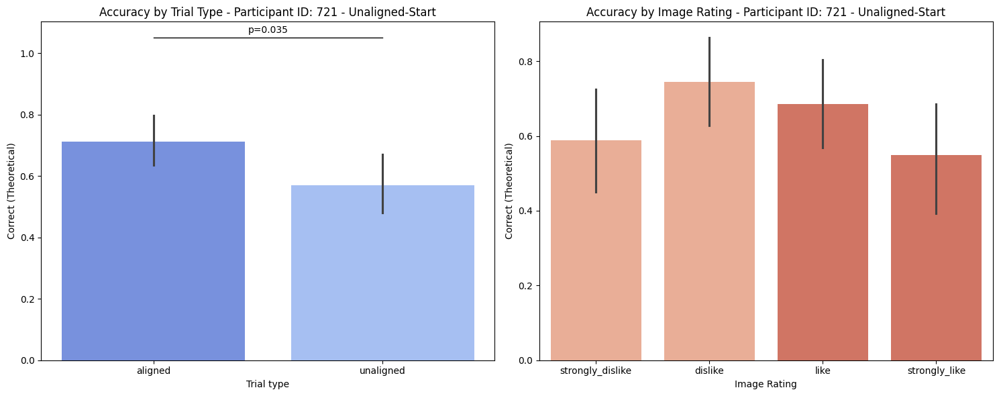

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.015).


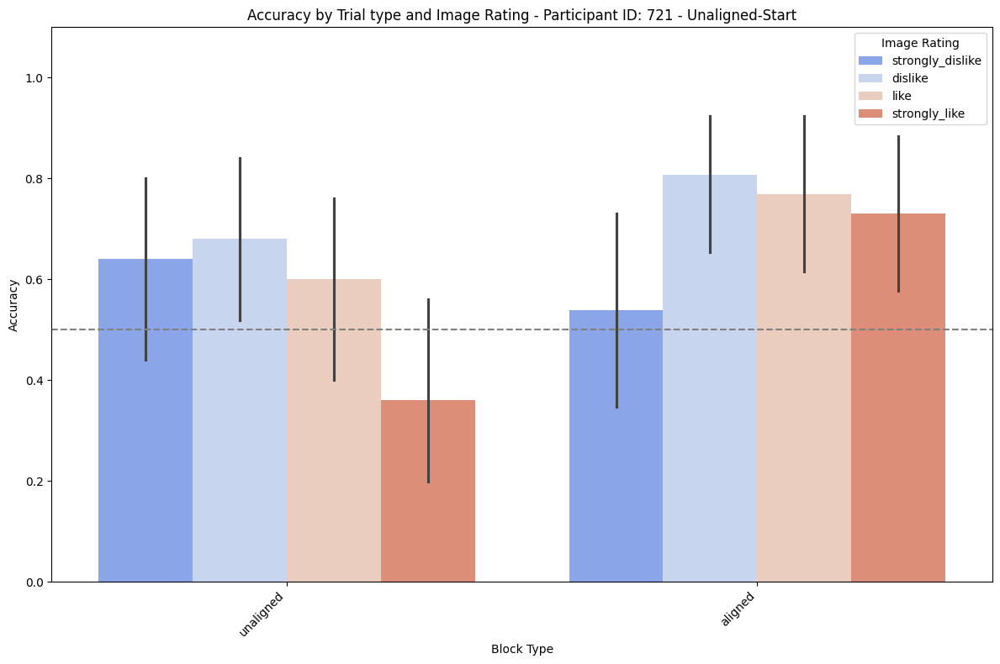

Data for participant 709:
Participant ID: 709

Accuracy in each 'Block':
Block
1    0.611111
2    0.861111
3    0.843750
4    0.888889
5    0.888889
6    0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.875000
unaligned    0.778846
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.06737219379800308

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.611111
            2        0.861111
            3        0.843750
            4        0.888889
            5        0.888889
            6        0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.826923
like                0.903846
strongly_dislike    0.769231
strongly_like       0.807692
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.321600921433479
Data for Chi-squared test:
Correct (Binary)   0

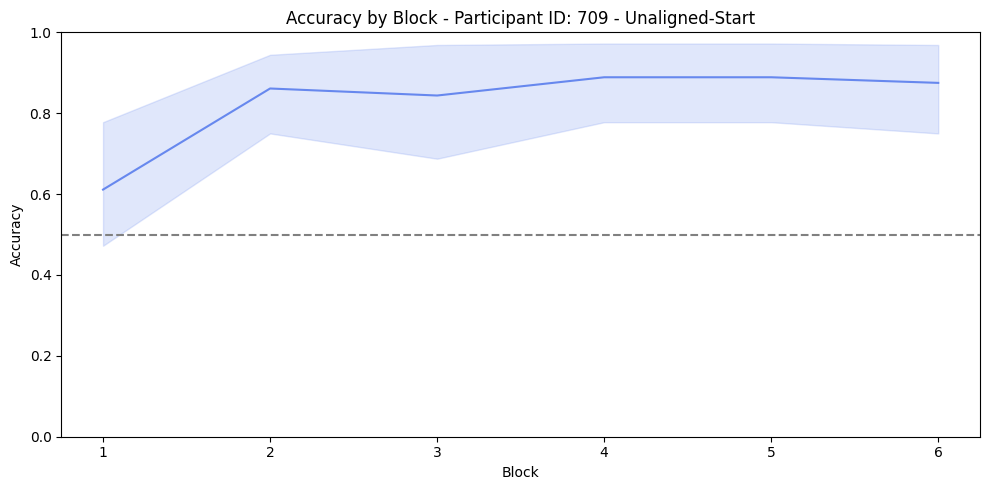

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


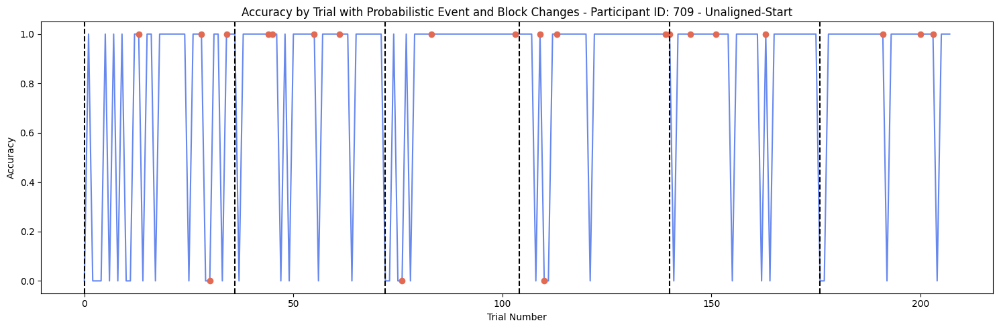

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


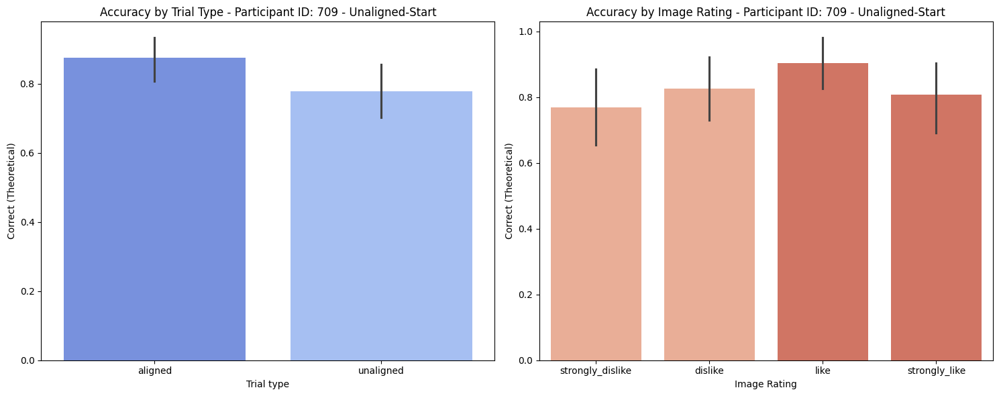

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


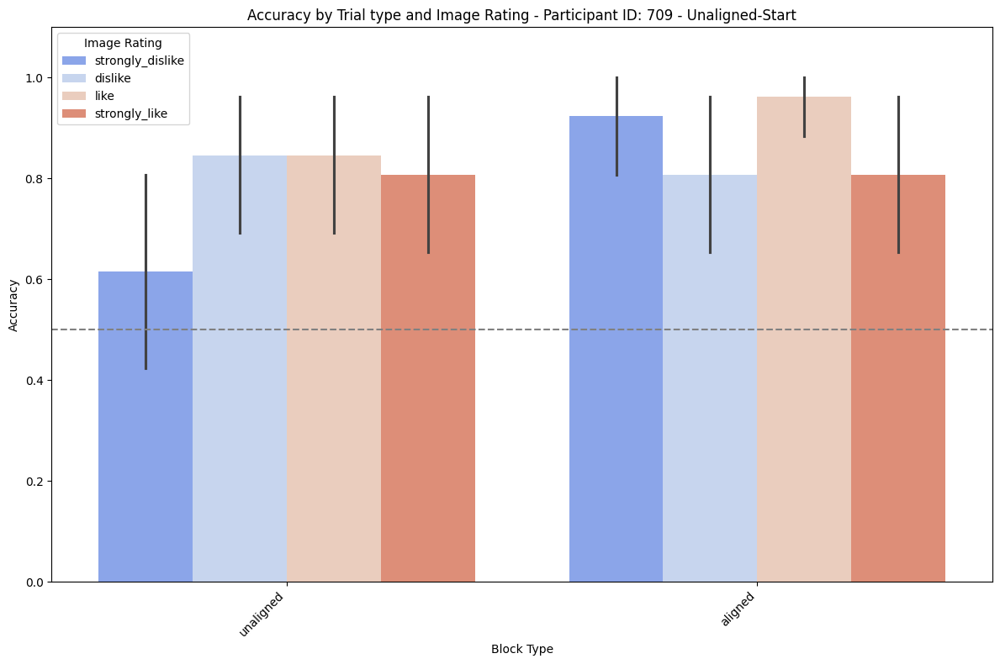

Data for participant 724:
Participant ID: 724

Accuracy in each 'Block':
Block
1    0.888889
2    0.722222
3    0.694444
4    0.875000
5    0.718750
6    0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.820000
unaligned    0.769231
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.37246220458476653

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.888889
            2        0.722222
            3        0.694444
            4        0.875000
            5        0.718750
            6        0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.784314
like                0.882353
strongly_dislike    0.764706
strongly_like       0.745098
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.323632670636924
Data for Chi-squared test:
Correct (Binary)   0

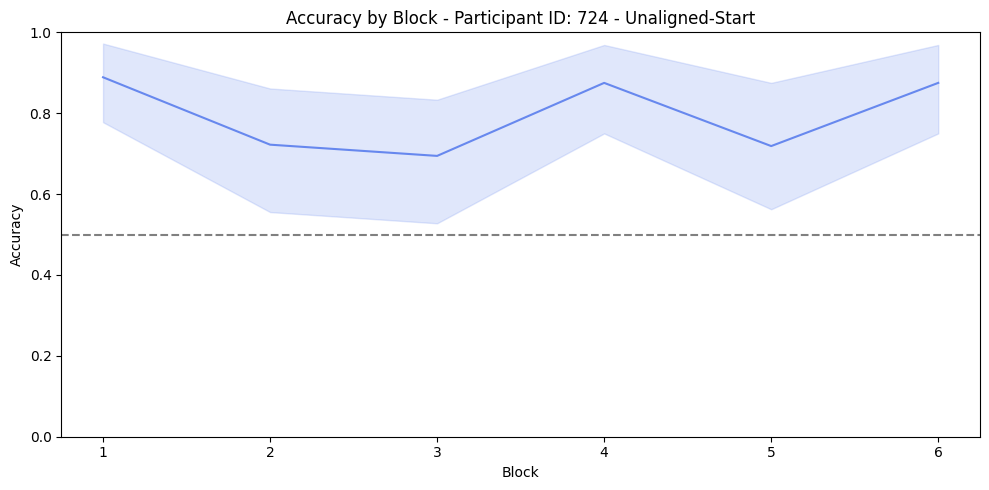

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


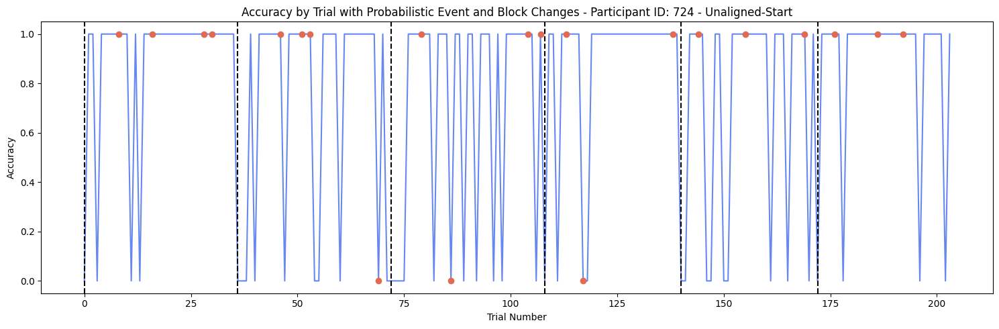

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


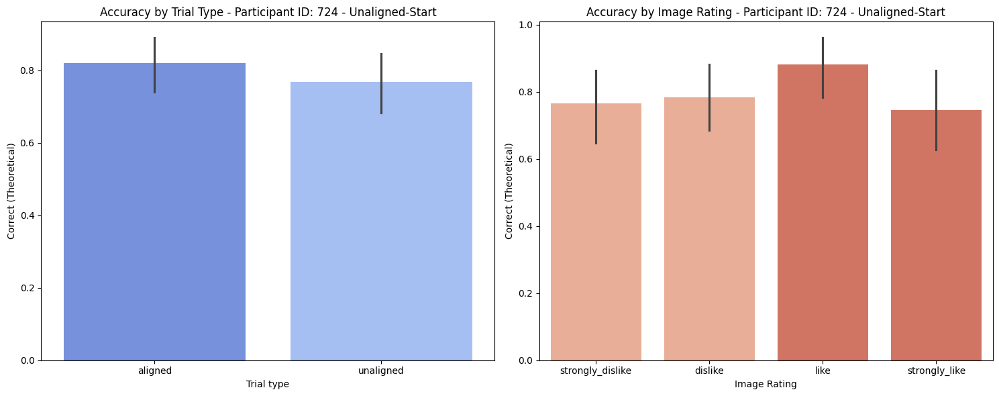

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.015).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.048).


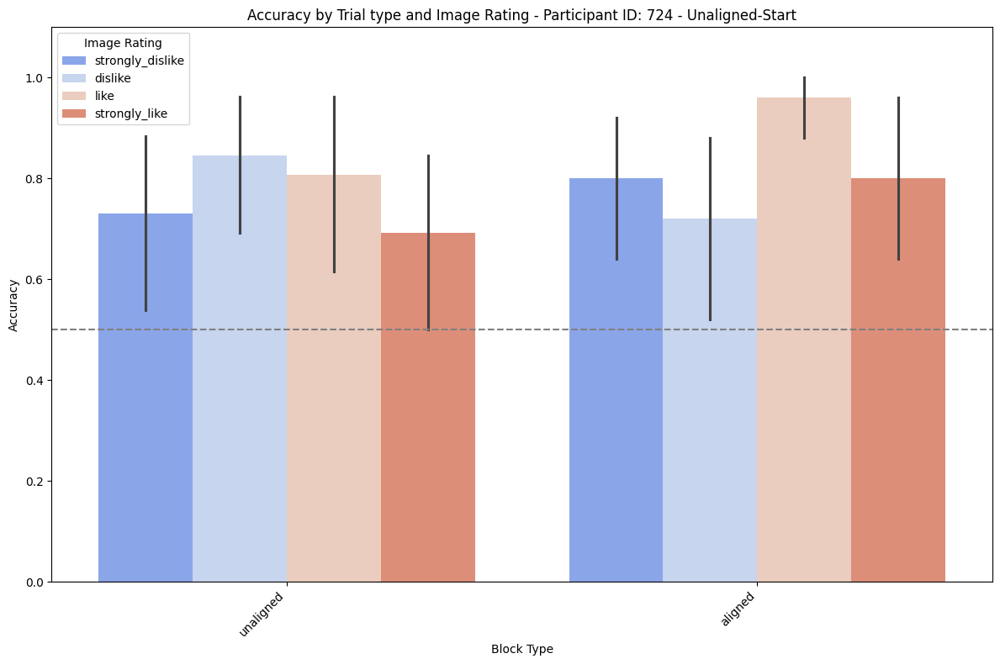

Data for participant 706:
Participant ID: 706

Accuracy in each 'Block':
Block
1    0.906250
2    0.281250
3    0.777778
4    0.750000
5    0.781250
6    0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.64
unaligned    0.82
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.003990727526132245

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.906250
            2        0.281250
            3        0.777778
            4        0.750000
            5        0.781250
            6        0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.68
like                0.74
strongly_dislike    0.82
strongly_like       0.68
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.340941798009436
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating      

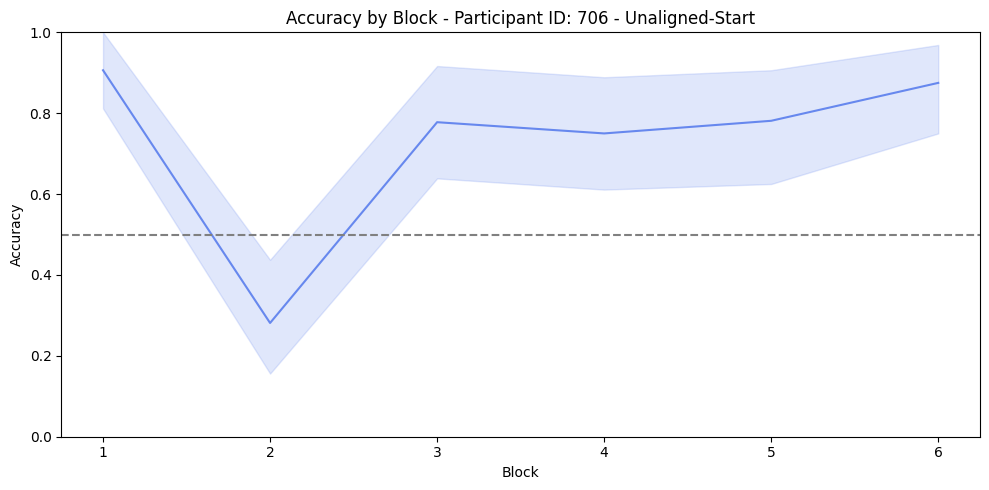

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


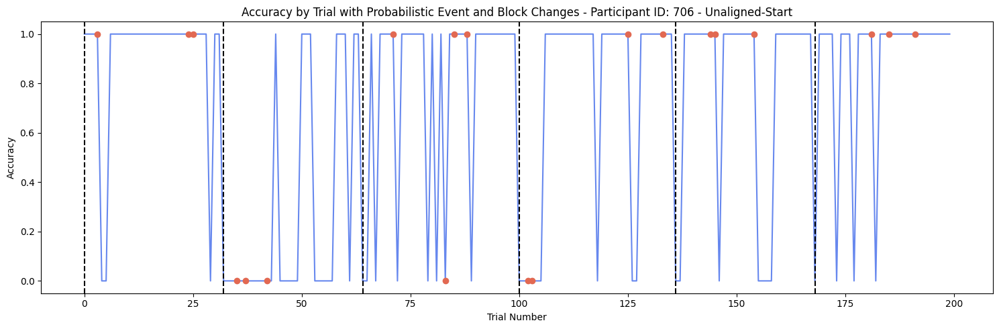

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


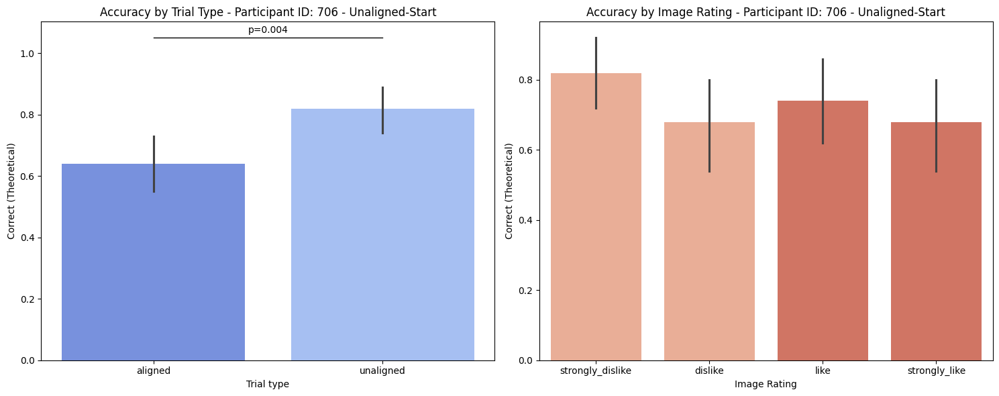

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).


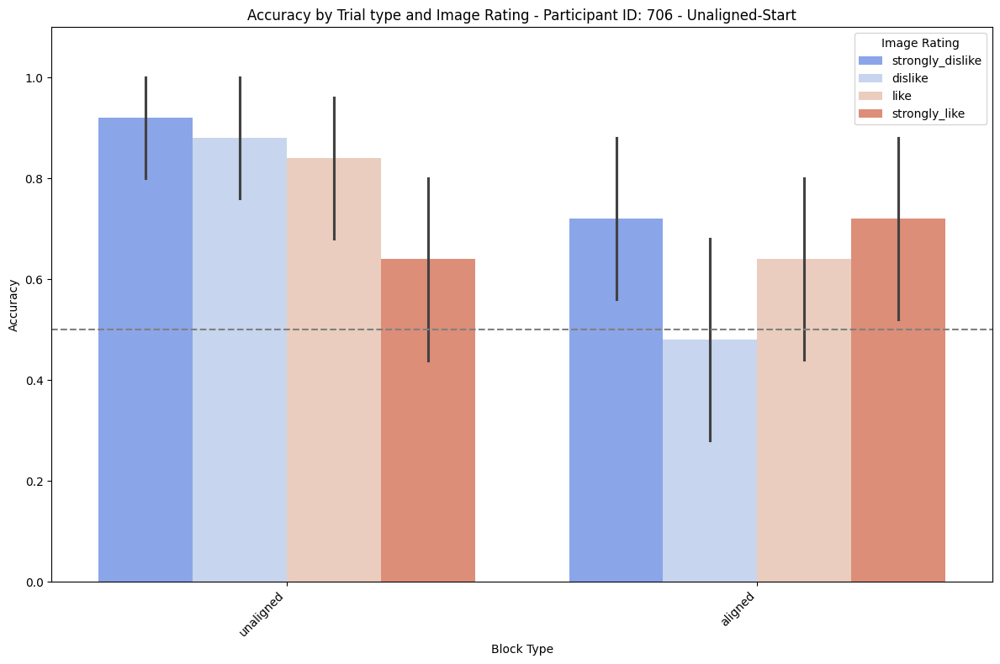

Data for participant 718:
Participant ID: 718

Accuracy in each 'Block':
Block
1    0.687500
2    0.468750
3    0.472222
4    0.593750
5    0.437500
6    0.468750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.510417
unaligned    0.530000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.7851533318186334

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.687500
            2        0.468750
            3        0.472222
            4        0.593750
            5        0.437500
            6        0.468750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.530612
like                0.530612
strongly_dislike    0.489796
strongly_like       0.530612
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.969963664310002
Data for Chi-squared test:
Correct (Binary)   0 

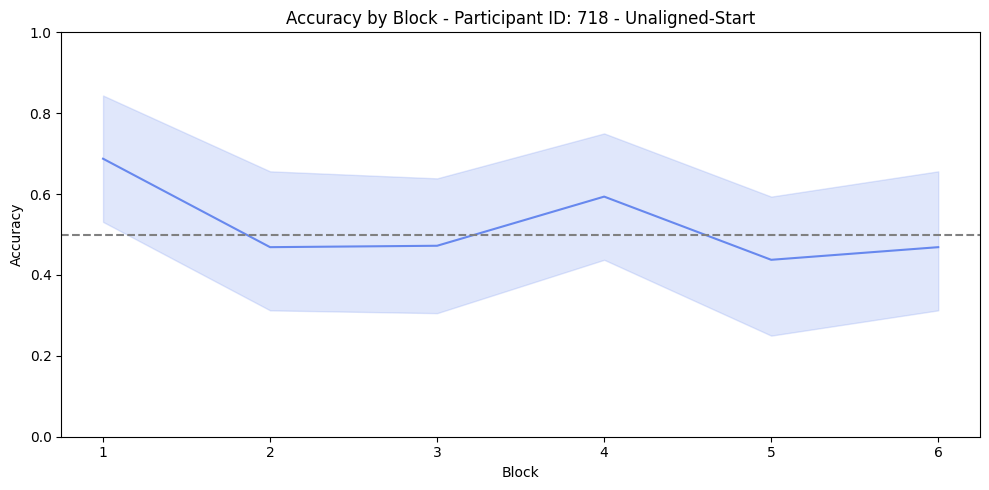

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


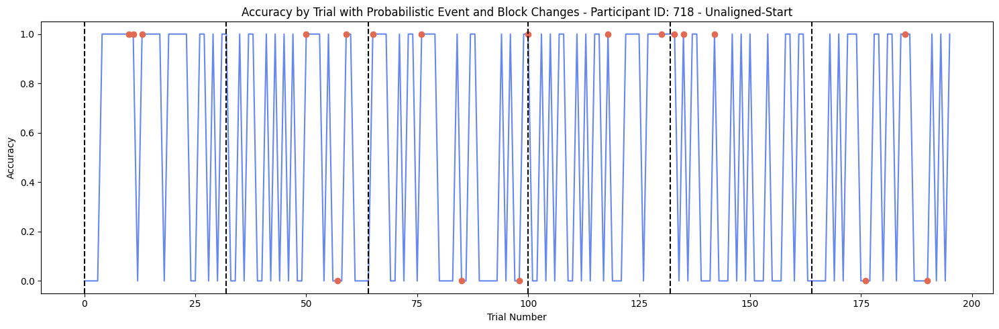

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


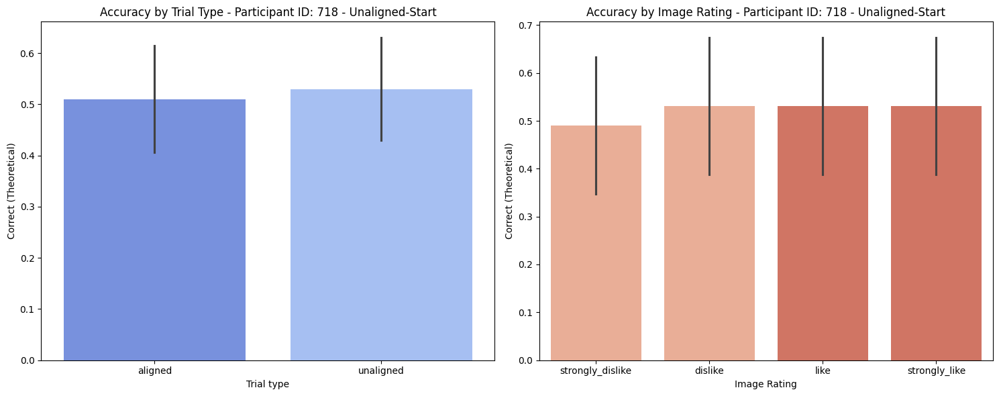

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.038).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.011).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.006).


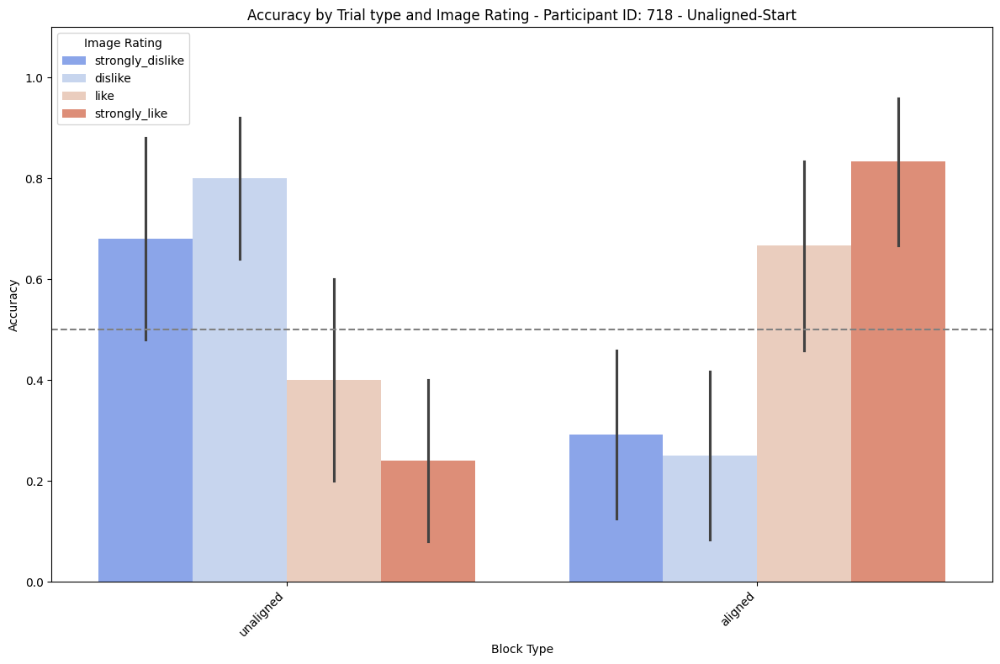

Data for participant 716:
Participant ID: 716

Accuracy in each 'Block':
Block
1    0.281250
2    0.527778
3    0.500000
4    0.468750
5    0.593750
6    0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.528846
unaligned    0.460000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.3279272022037141

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.281250
            2        0.527778
            3        0.500000
            4        0.468750
            5        0.593750
            6        0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.568627
like                0.588235
strongly_dislike    0.372549
strongly_like       0.450980
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.096446566376720
Data for Chi-squared test:
Correct (Binary)   0 

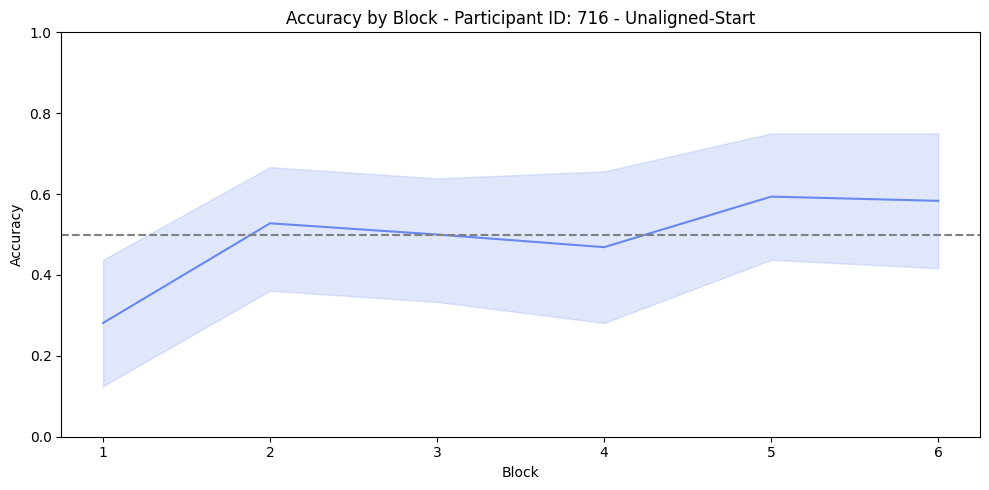

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


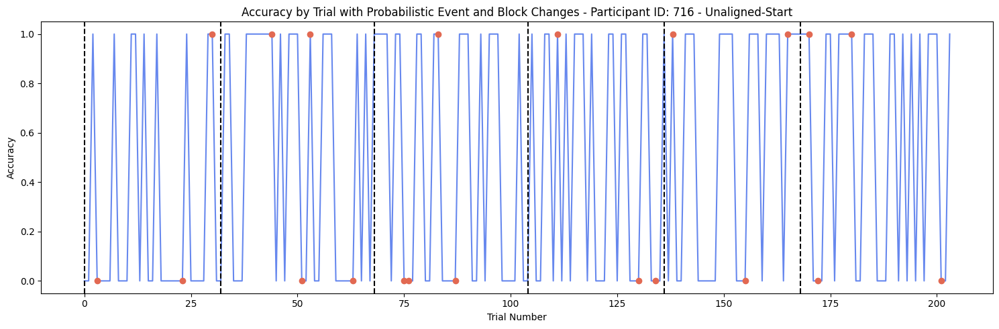

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


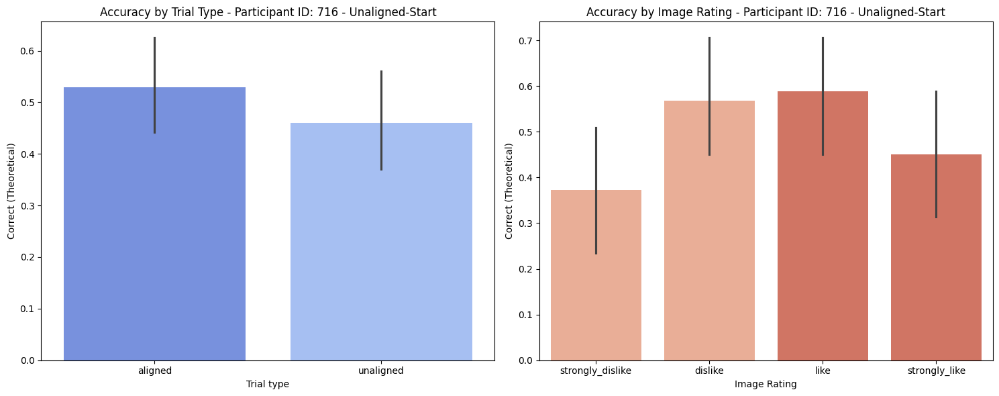

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.006).


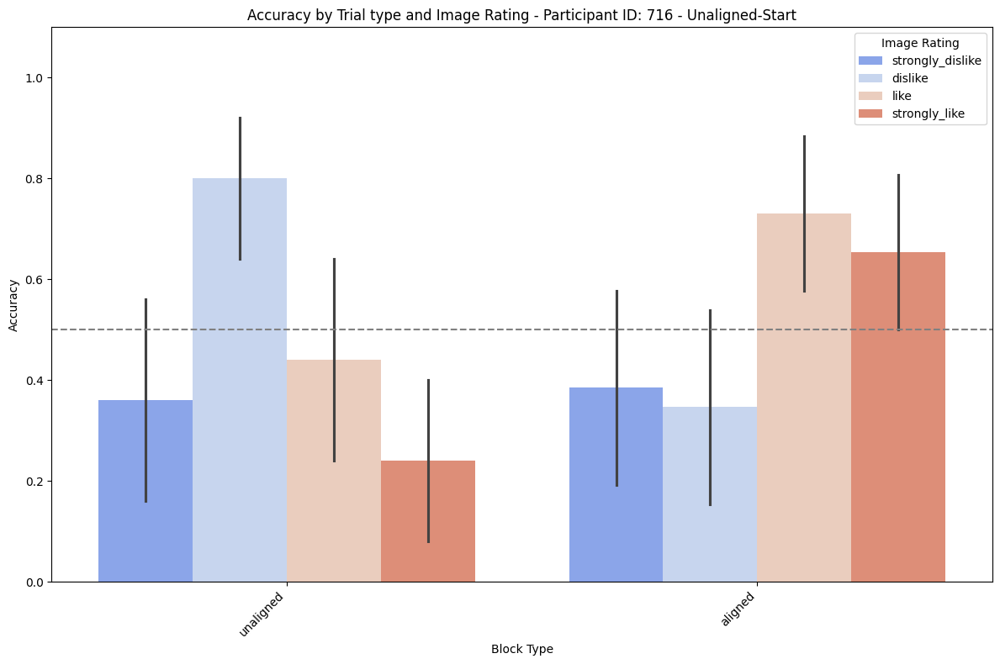

Data for participant 717:
Participant ID: 717

Accuracy in each 'Block':
Block
1    0.593750
2    0.611111
3    0.343750
4    0.750000
5    0.250000
6    0.388889
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.576923
unaligned    0.390000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0074133538024579735

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.593750
            2        0.611111
            3        0.343750
            4        0.750000
            5        0.250000
            6        0.388889
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.509804
like                0.411765
strongly_dislike    0.529412
strongly_like       0.490196
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.652863849765706
Data for Chi-squared test:
Correct (Binary)  

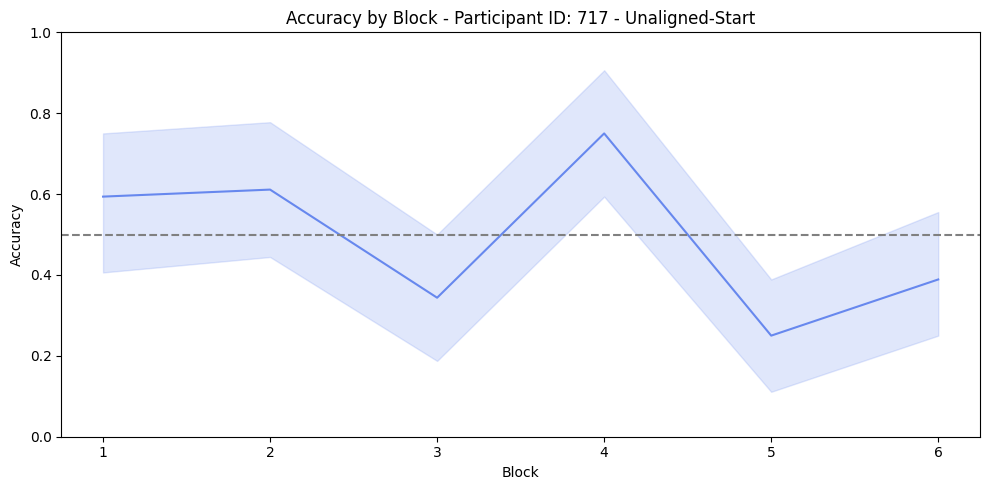

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


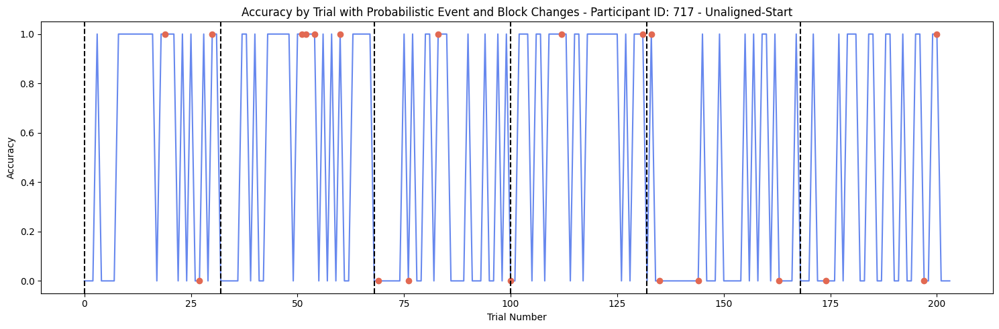

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


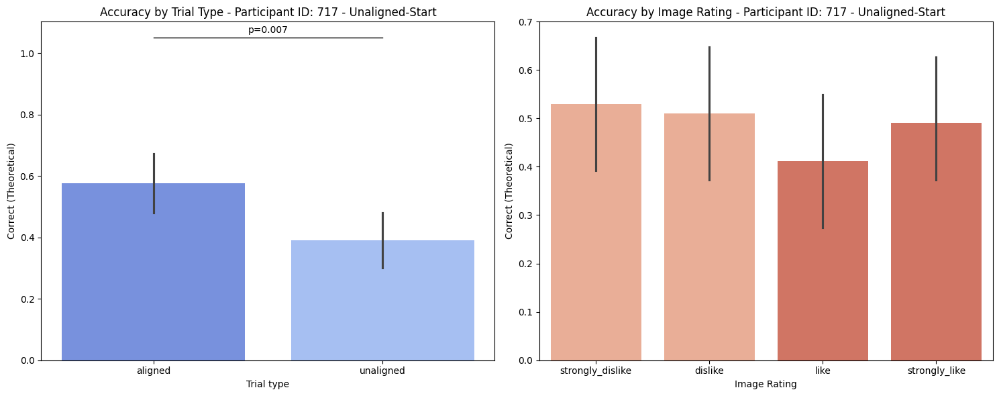

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.024).


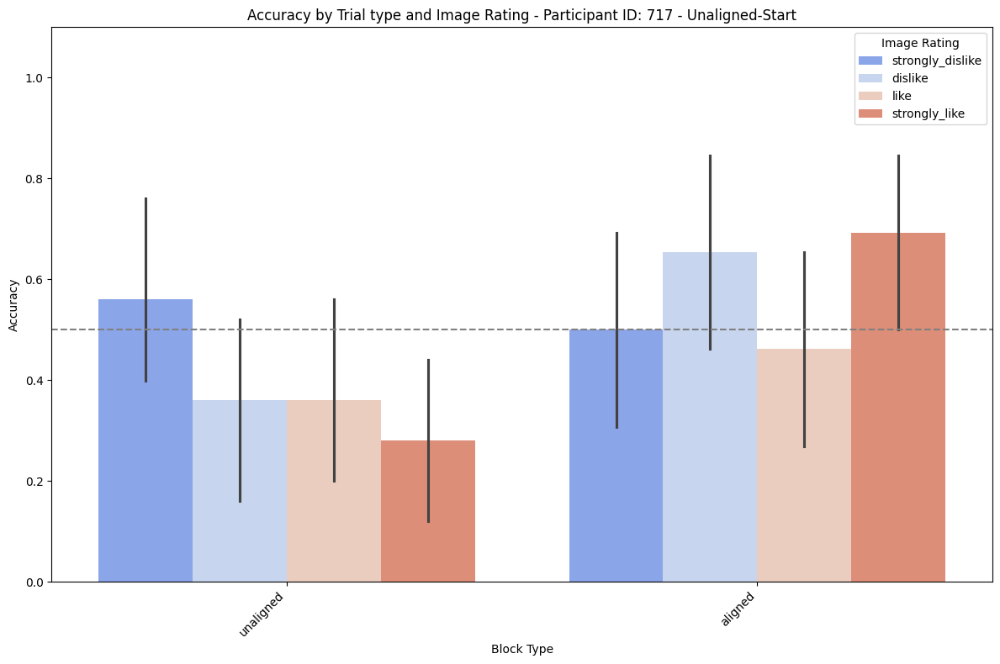

Data for participant 719:
Participant ID: 719

Accuracy in each 'Block':
Block
1    0.750000
2    0.750000
3    0.666667
4    0.722222
5    0.343750
6    0.343750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.615385
unaligned    0.596154
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.7778751384874271

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.750000
            2        0.750000
            3        0.666667
            4        0.722222
            5        0.343750
            6        0.343750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.653846
like                0.596154
strongly_dislike    0.596154
strongly_like       0.576923
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.867370308998214
Data for Chi-squared test:
Correct (Binary)   0 

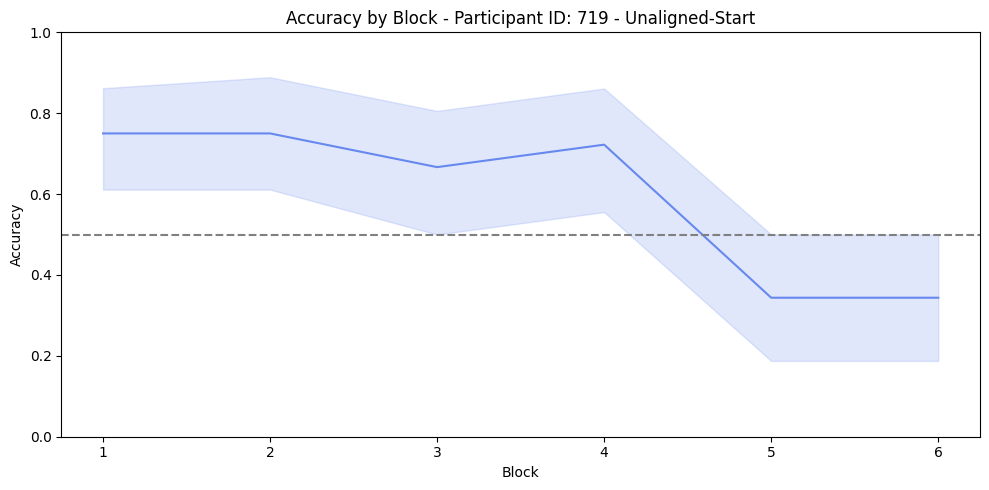

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


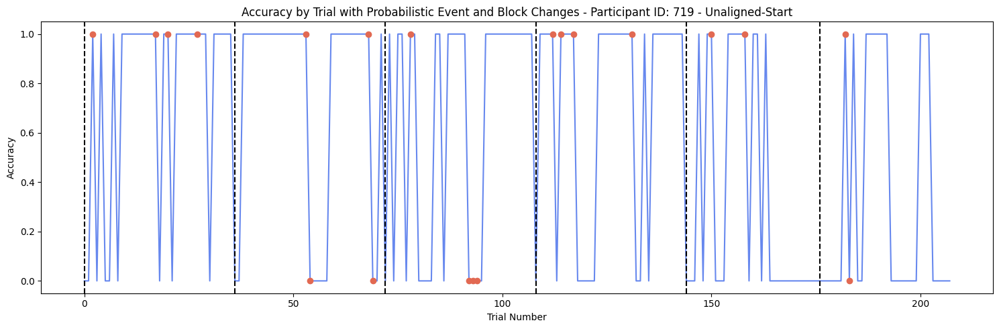

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


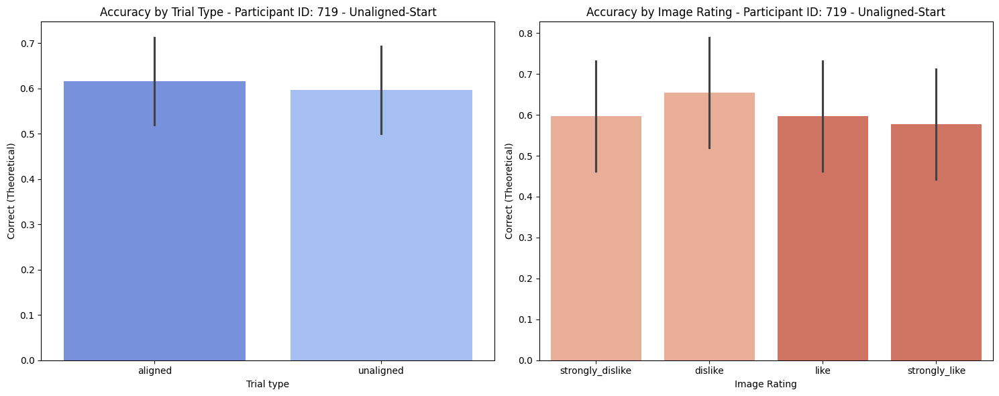

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.048).


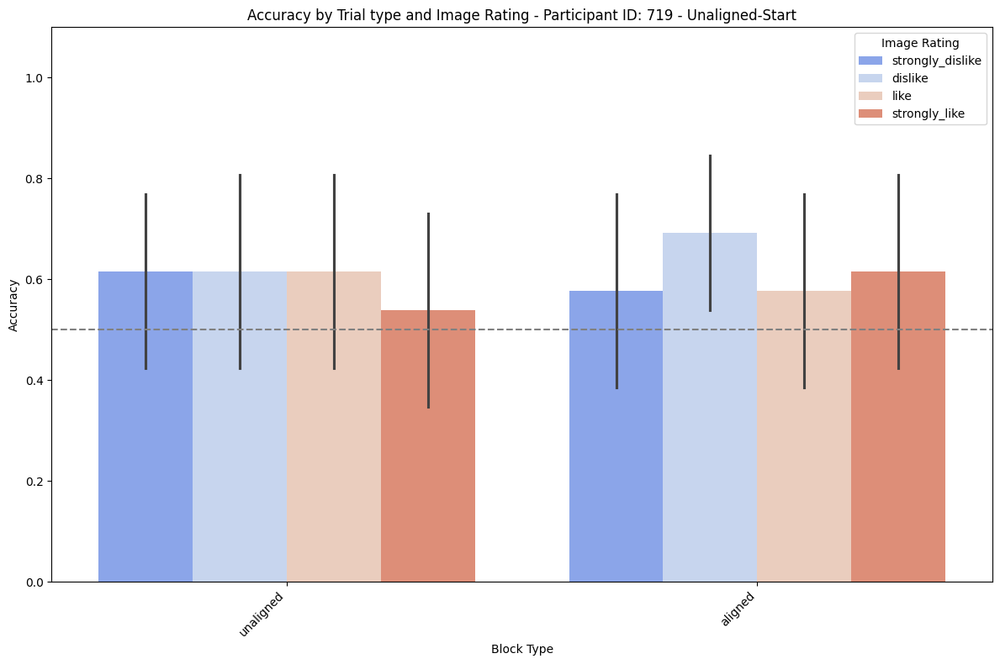

Data for participant 728:
Participant ID: 728

Accuracy in each 'Block':
Block
1    0.638889
2    0.805556
3    0.833333
4    0.833333
5    0.781250
6    0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.846154
unaligned    0.750000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.08488142696365046

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.638889
            2        0.805556
            3        0.833333
            4        0.833333
            5        0.781250
            6        0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.807692
like                0.750000
strongly_dislike    0.769231
strongly_like       0.865385
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.474203377918858
Data for Chi-squared test:
Correct (Binary)   0

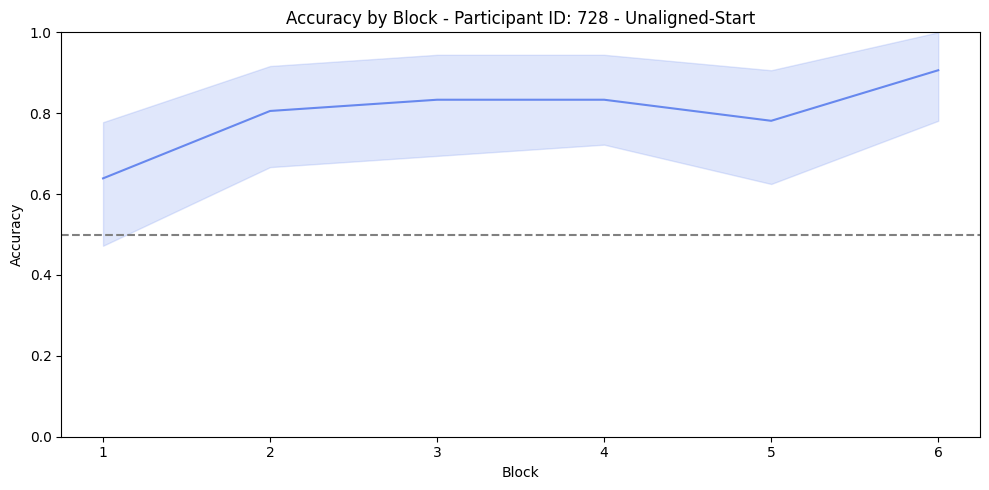

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


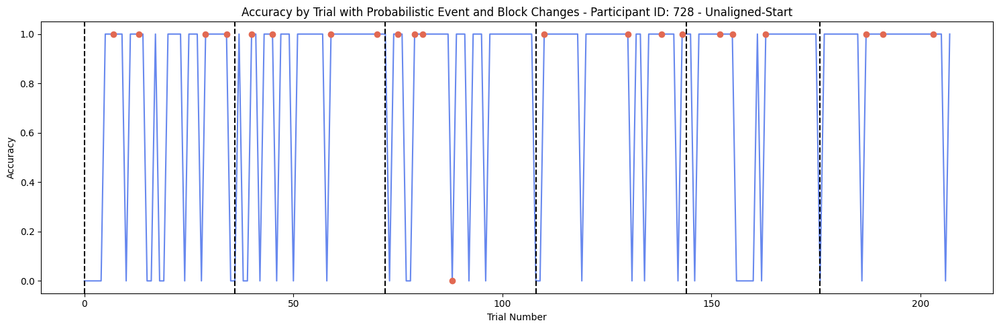

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


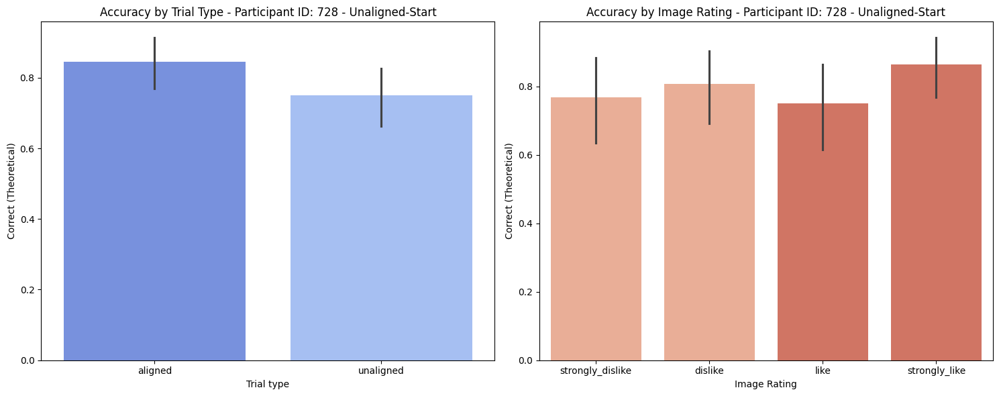

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.015).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


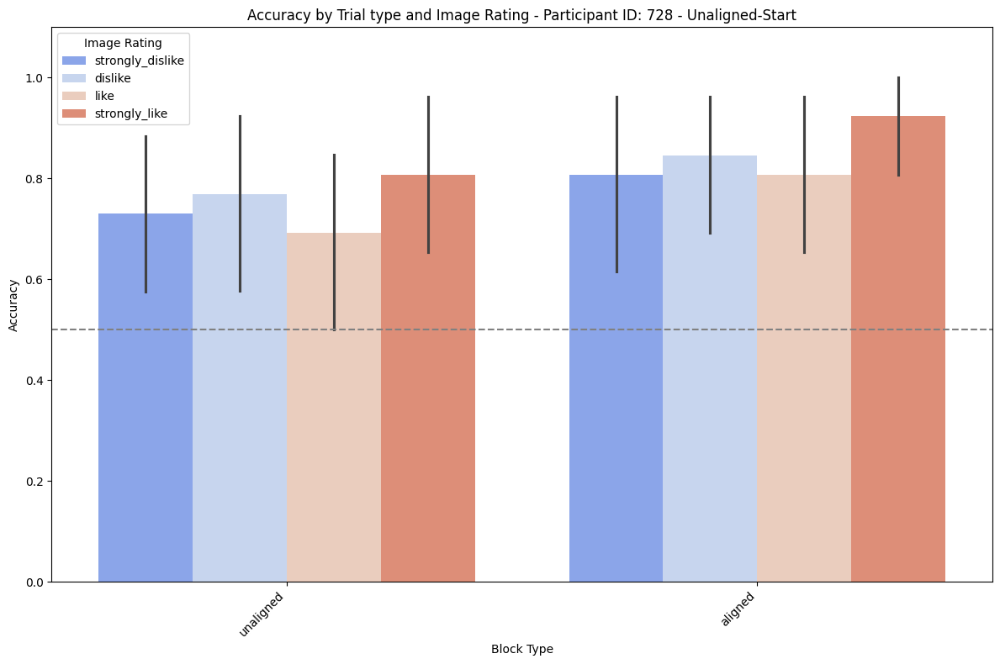

Data for participant 739:
Participant ID: 739

Accuracy in each 'Block':
Block
1    0.781250
2    0.406250
3    0.722222
4    0.888889
5    0.937500
6    0.687500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.67
unaligned    0.81
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.023993691322835877

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.781250
            2        0.406250
            3        0.722222
            4        0.888889
            5        0.937500
            6        0.687500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.76
like                0.74
strongly_dislike    0.64
strongly_like       0.82
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.224567743588164
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating      

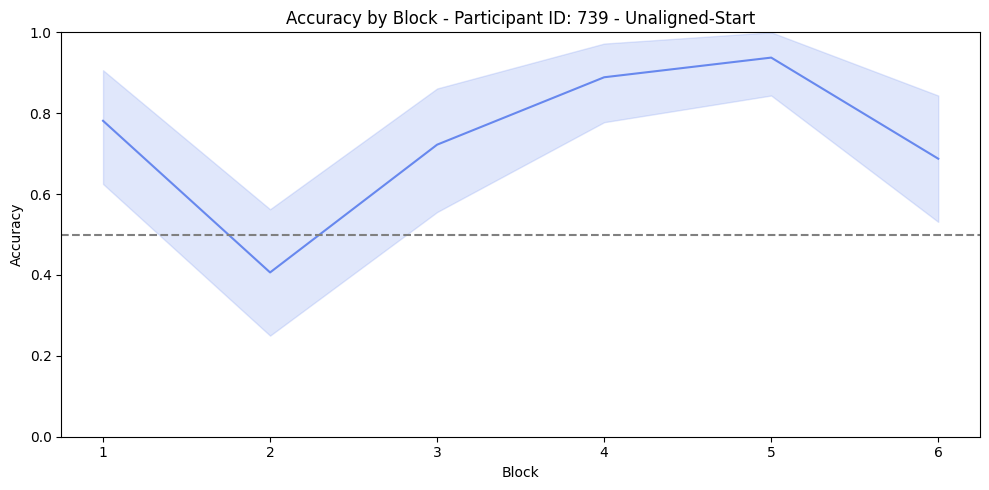

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


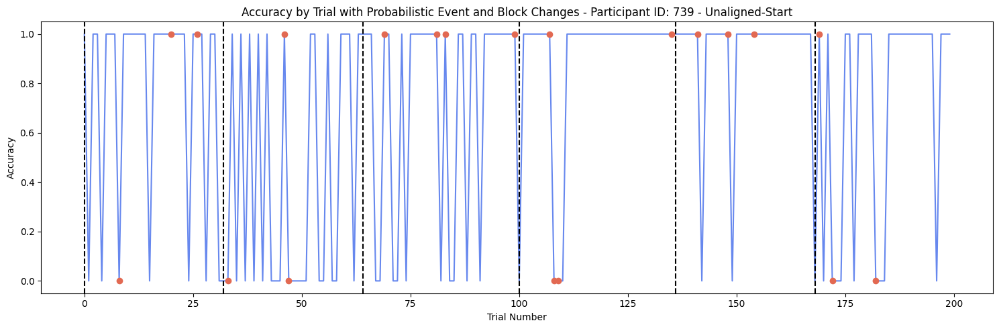

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


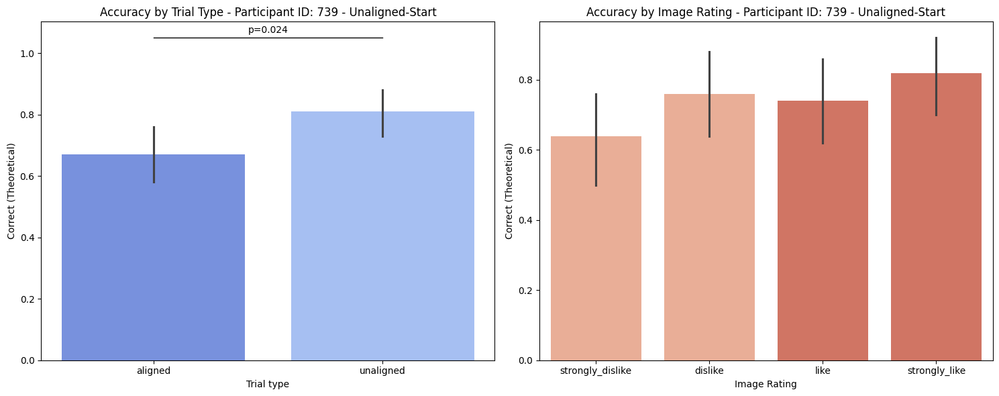

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


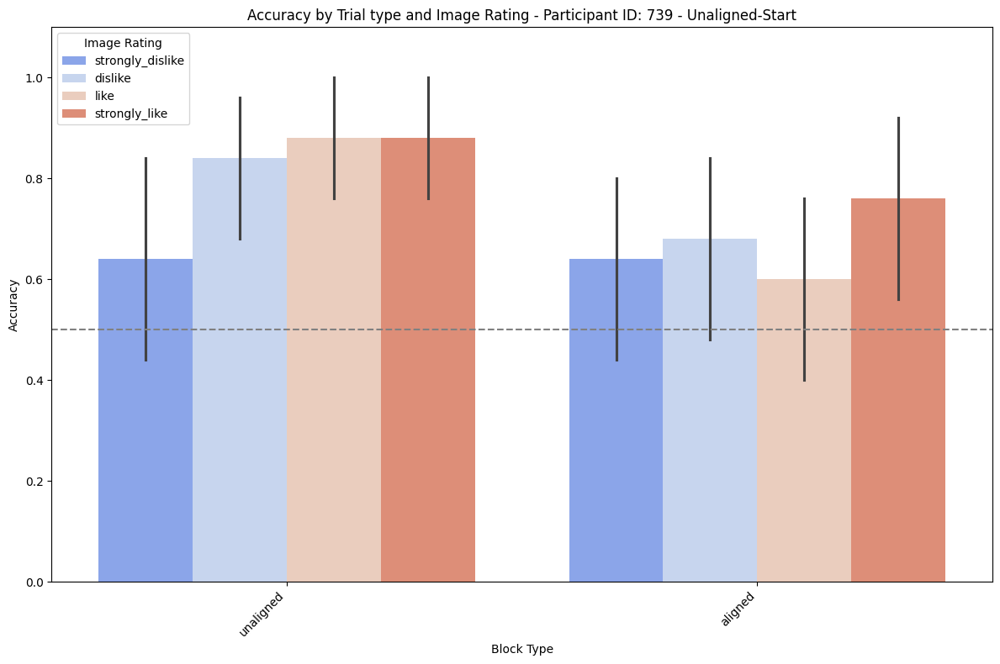

Data for participant 733:
Participant ID: 733

Accuracy in each 'Block':
Block
1    0.555556
2    0.437500
3    0.500000
4    0.472222
5    0.527778
6    0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.450000
unaligned    0.528846
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.26229873913592927

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.555556
            2        0.437500
            3        0.500000
            4        0.472222
            5        0.527778
            6        0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.509804
like                0.450980
strongly_dislike    0.529412
strongly_like       0.470588
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.853143180465661
Data for Chi-squared test:
Correct (Binary)   0

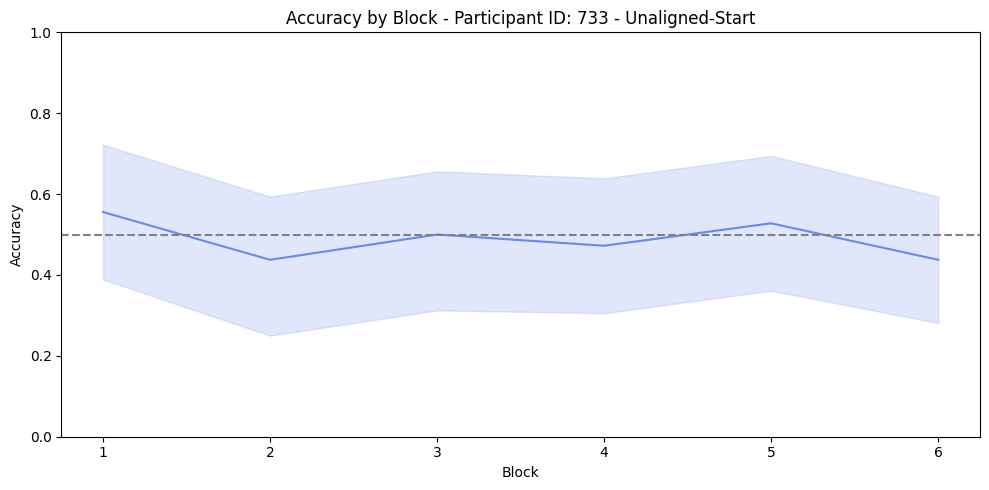

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


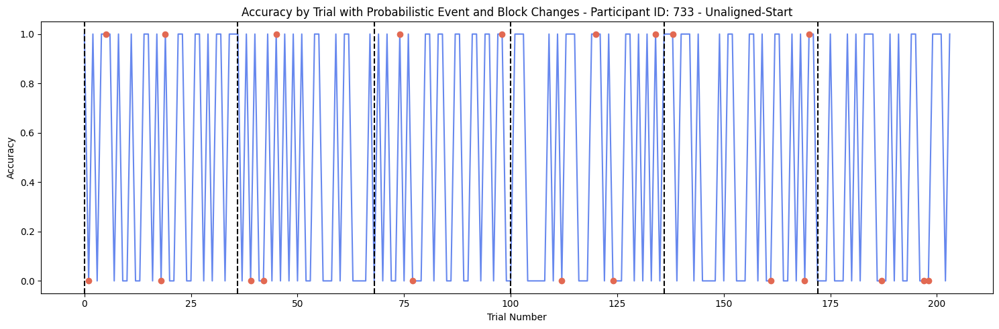

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


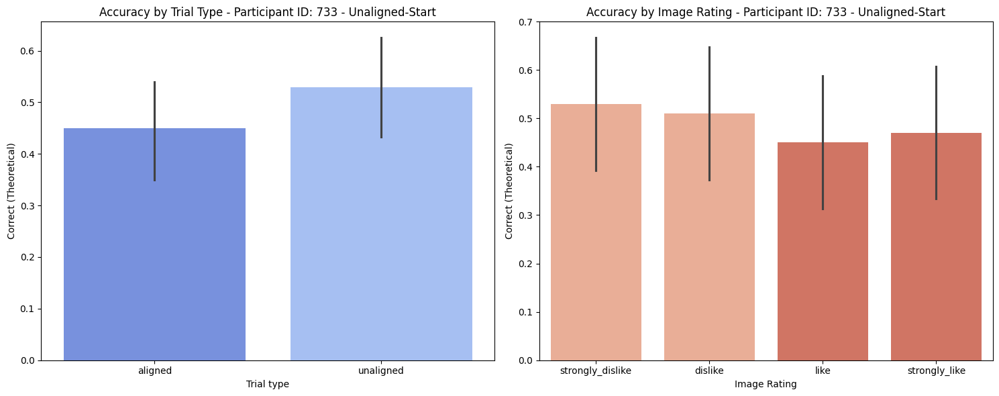

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.004).


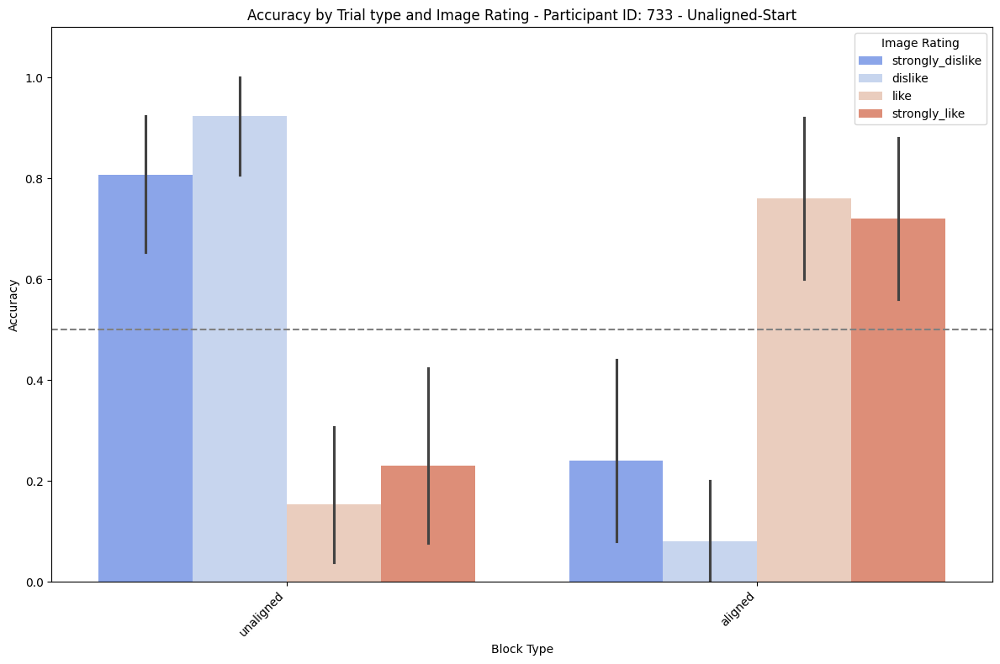

Data for participant 734:
Participant ID: 734

Accuracy in each 'Block':
Block
1    0.593750
2    0.656250
3    0.583333
4    0.437500
5    0.531250
6    0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.510417
unaligned    0.570000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.4053086640906002

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.593750
            2        0.656250
            3        0.583333
            4        0.437500
            5        0.531250
            6        0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.551020
like                0.469388
strongly_dislike    0.591837
strongly_like       0.551020
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.668167587600917
Data for Chi-squared test:
Correct (Binary)   0 

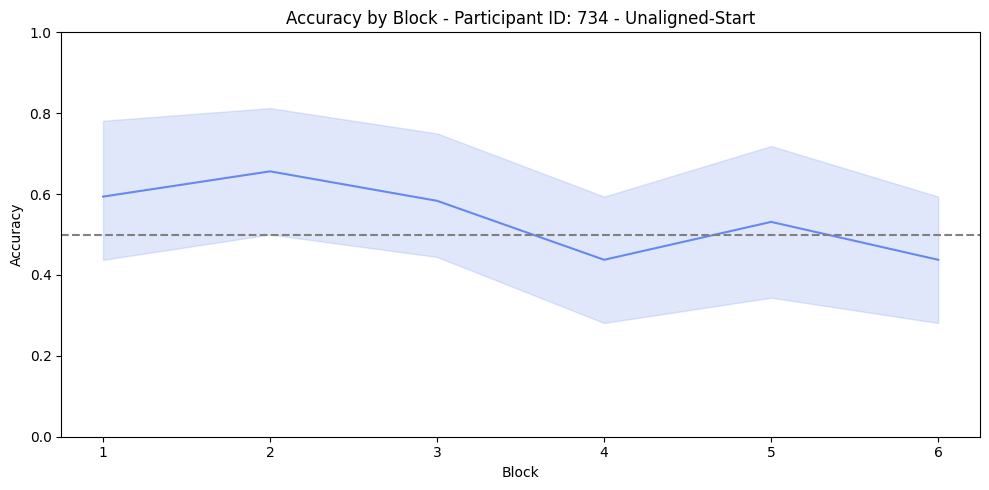

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


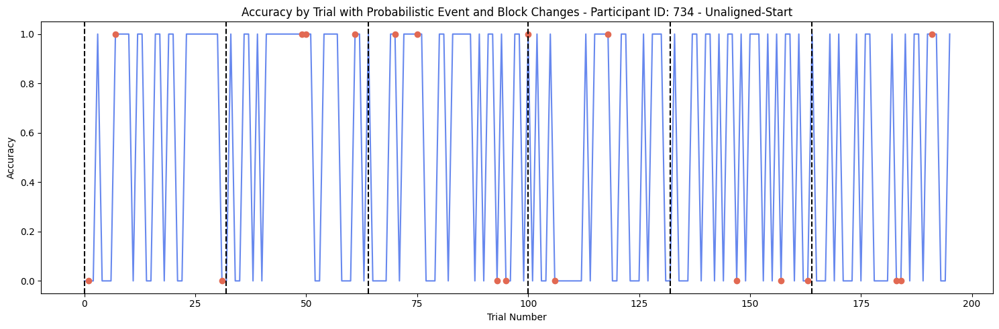

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


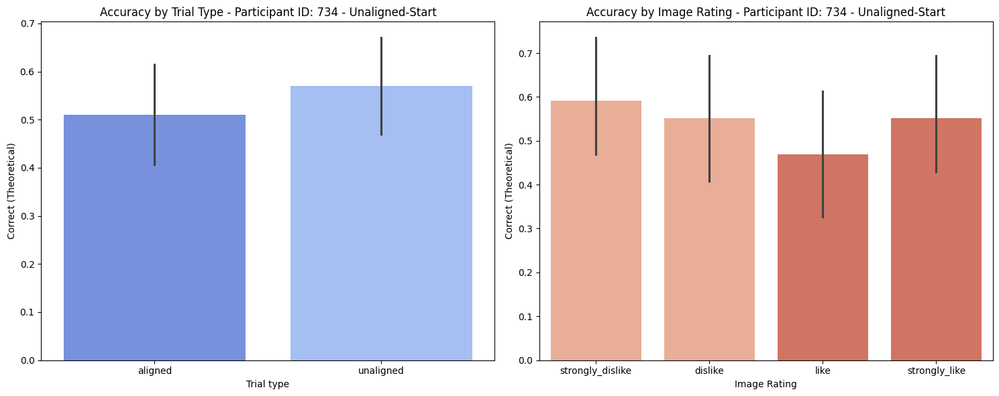

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.024).


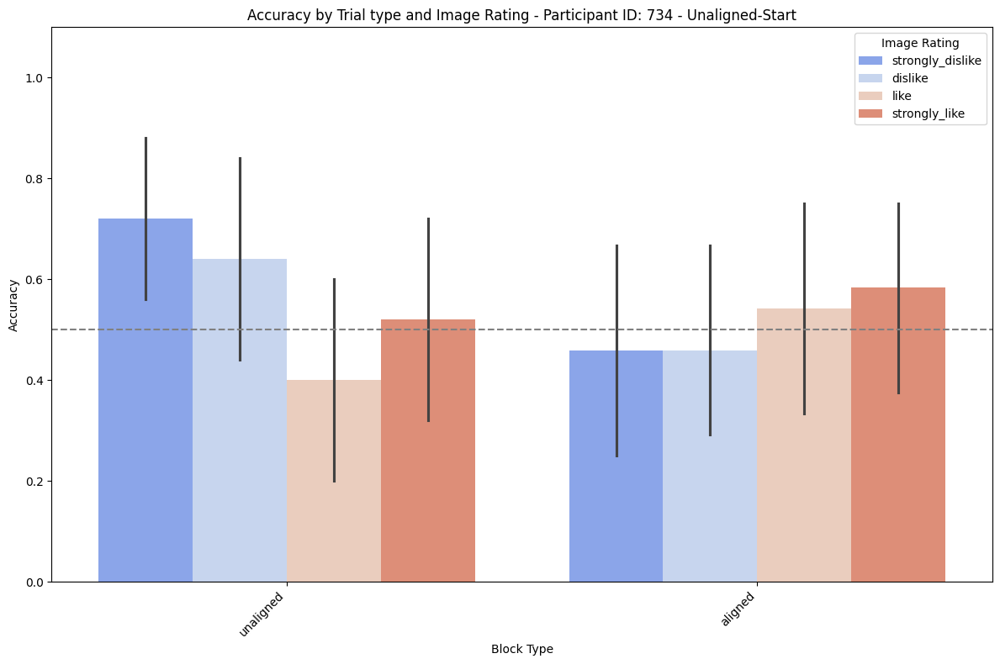

Data for participant 727:
Participant ID: 727

Accuracy in each 'Block':
Block
1    0.343750
2    0.468750
3    0.562500
4    0.187500
5    0.500000
6    0.472222
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.38
unaligned    0.47
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.19985969158645822

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.343750
            2        0.468750
            3        0.562500
            4        0.187500
            5        0.500000
            6        0.472222
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.48
like                0.28
strongly_dislike    0.42
strongly_like       0.52
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.079517810645955
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating       

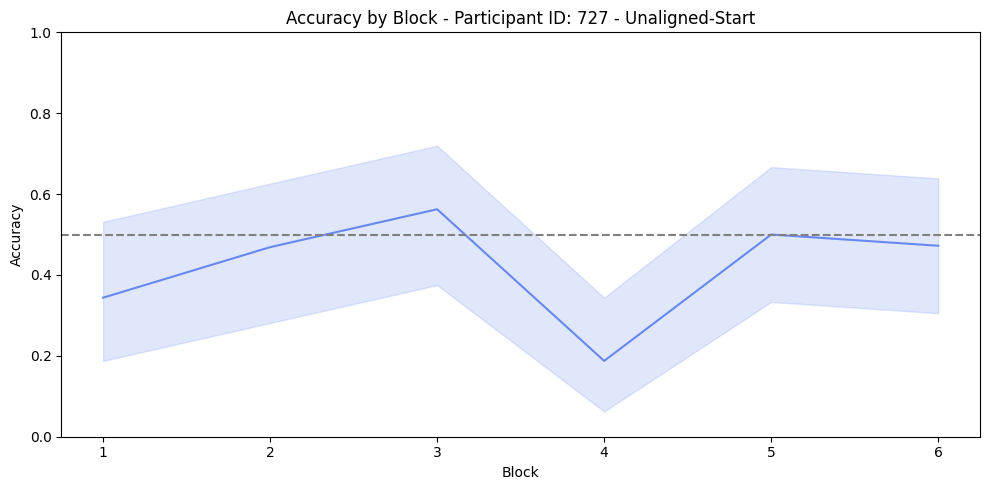

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


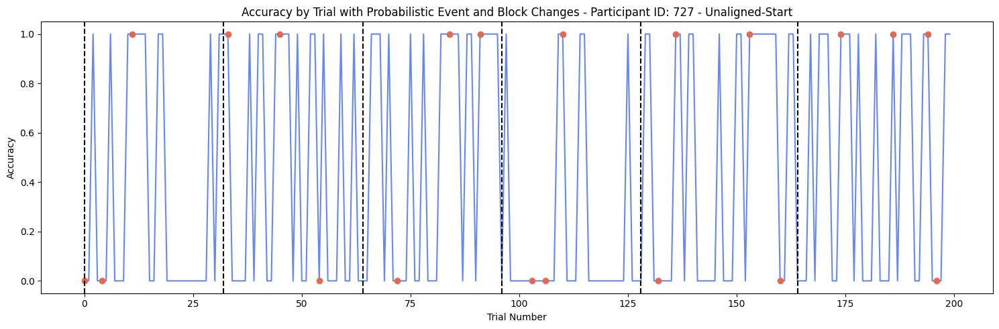

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


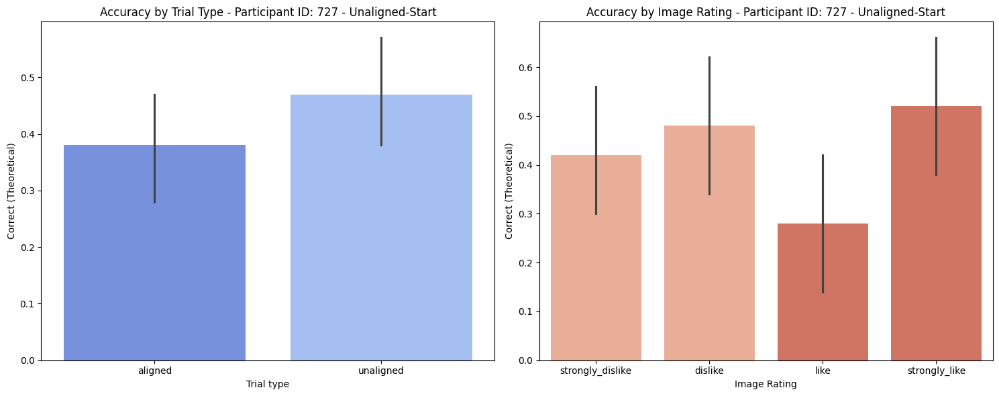

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).


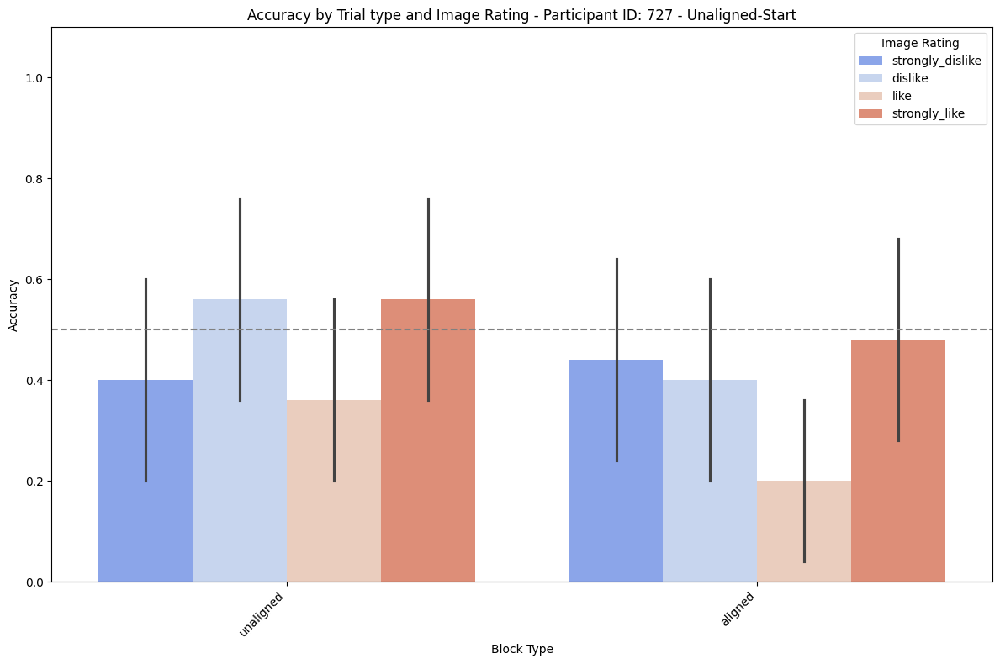

Data for participant 730:
Participant ID: 730

Accuracy in each 'Block':
Block
1    0.718750
2    0.833333
3    0.500000
4    0.833333
5    0.805556
6    0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.846154
unaligned    0.680000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0050032508413205045

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.718750
            2        0.833333
            3        0.500000
            4        0.833333
            5        0.805556
            6        0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.745098
like                0.784314
strongly_dislike    0.725490
strongly_like       0.803922
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.779550581173390
Data for Chi-squared test:
Correct (Binary)  

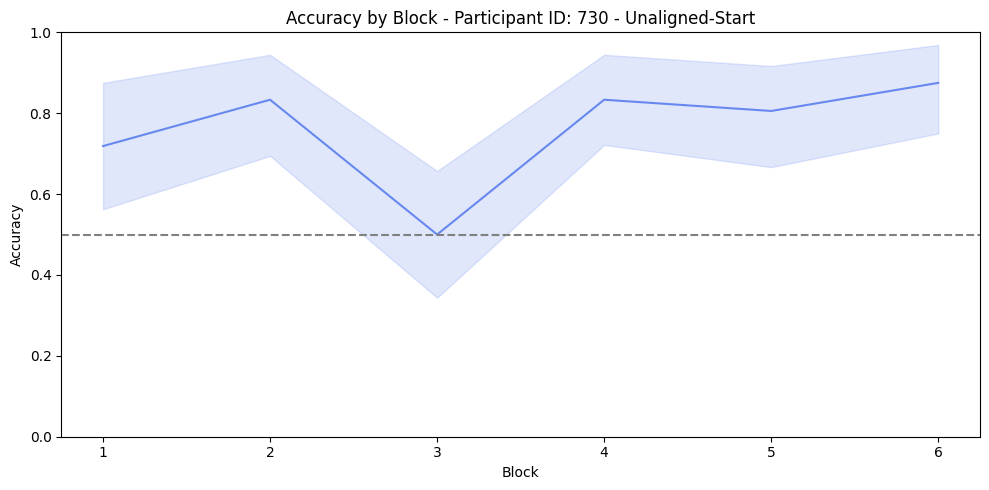

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


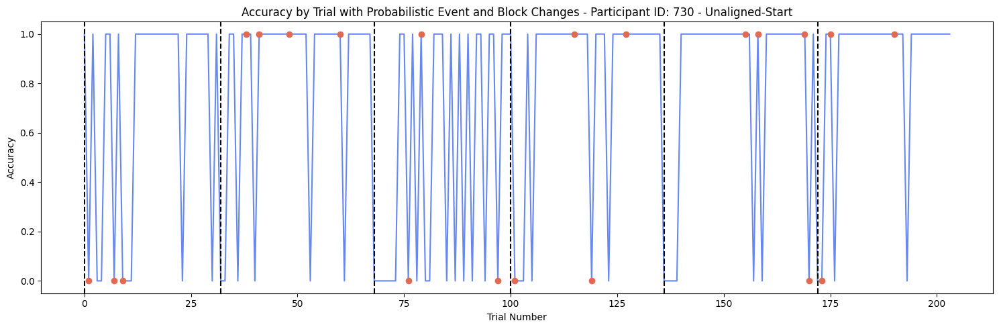

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


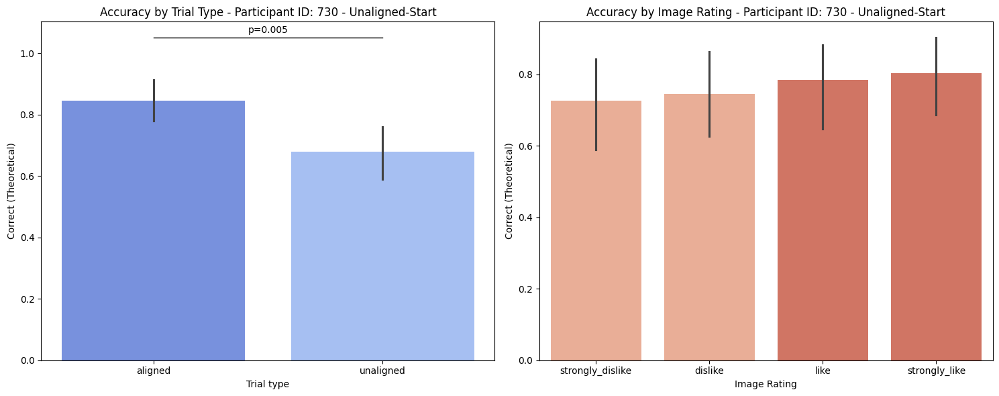

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


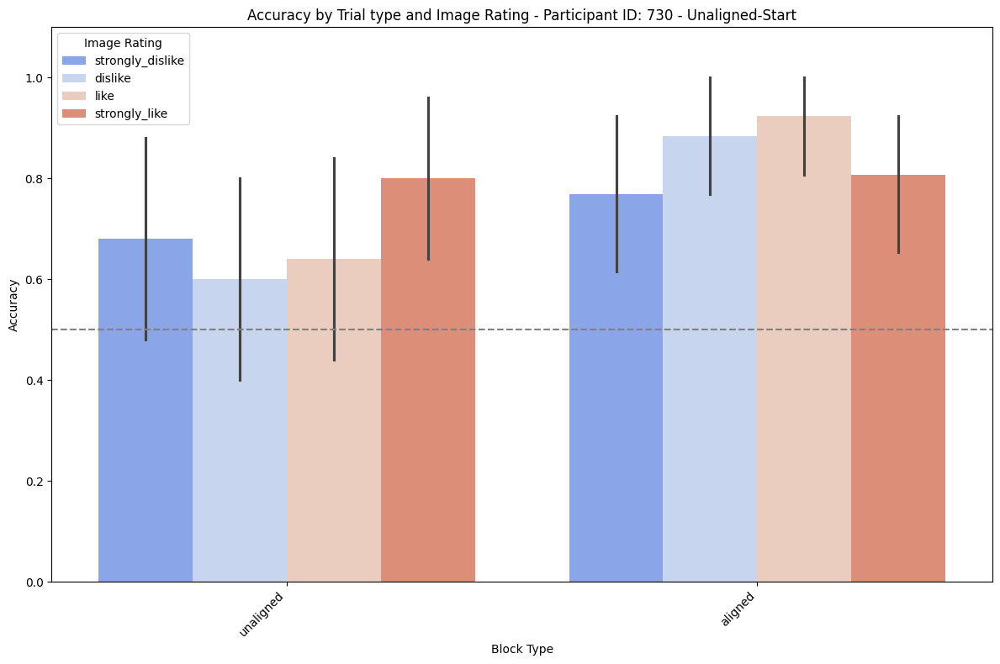

Data for participant 732:
Participant ID: 732

Accuracy in each 'Block':
Block
1    0.611111
2    0.638889
3    0.468750
4    0.555556
5    0.500000
6    0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.583333
unaligned    0.528846
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.4270708753071413

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.611111
            2        0.638889
            3        0.468750
            4        0.555556
            5        0.500000
            6        0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.584906
like                0.622642
strongly_dislike    0.509434
strongly_like       0.509434
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.559191188121259
Data for Chi-squared test:
Correct (Binary)   0 

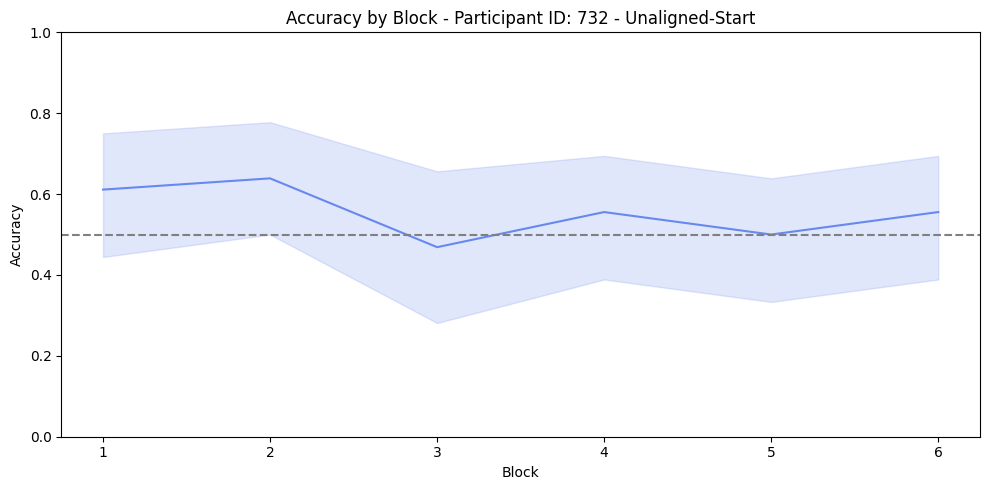

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


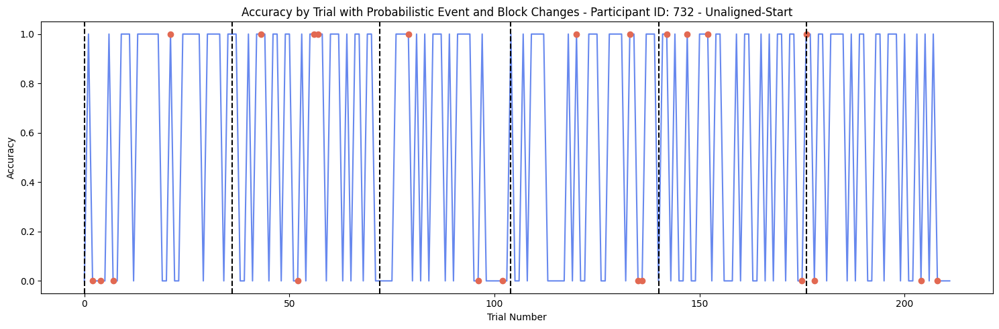

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


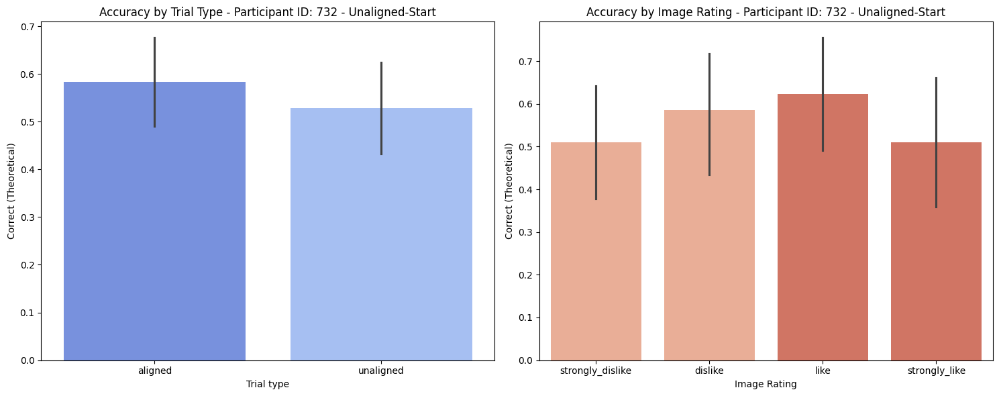

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.031).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.015).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.004).


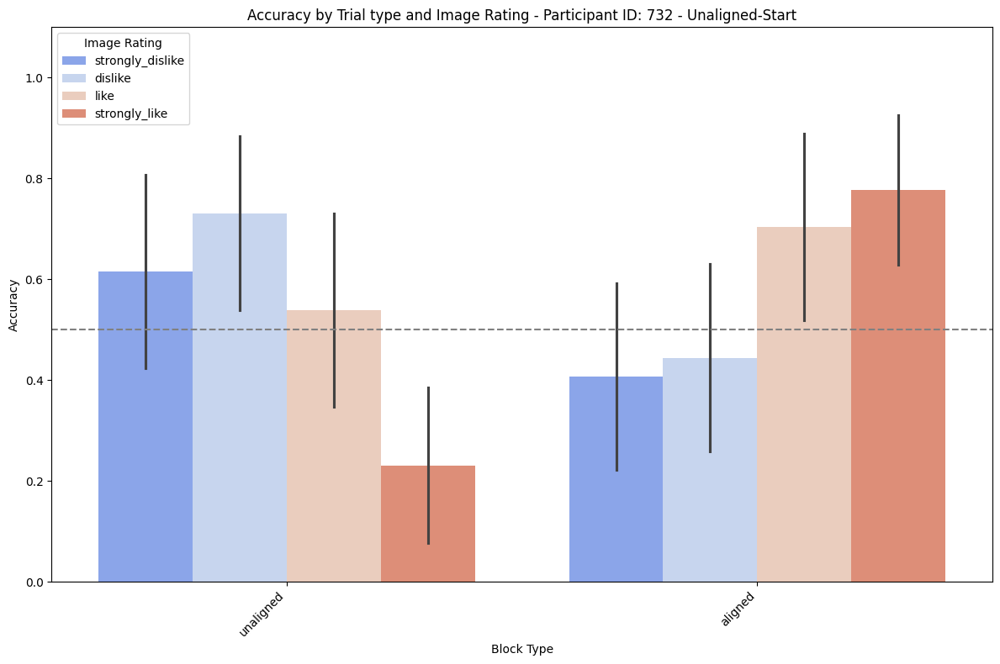

Data for participant 738:
Participant ID: 738

Accuracy in each 'Block':
Block
1    0.812500
2    0.694444
3    0.656250
4    0.750000
5    0.843750
6    0.888889
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.777778
unaligned    0.770833
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.9062738484167504

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.812500
            2        0.694444
            3        0.656250
            4        0.750000
            5        0.843750
            6        0.888889
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.666667
like                0.686275
strongly_dislike    0.843137
strongly_like       0.901961
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.008143314857232
Data for Chi-squared test:
Correct (Binary)   0 

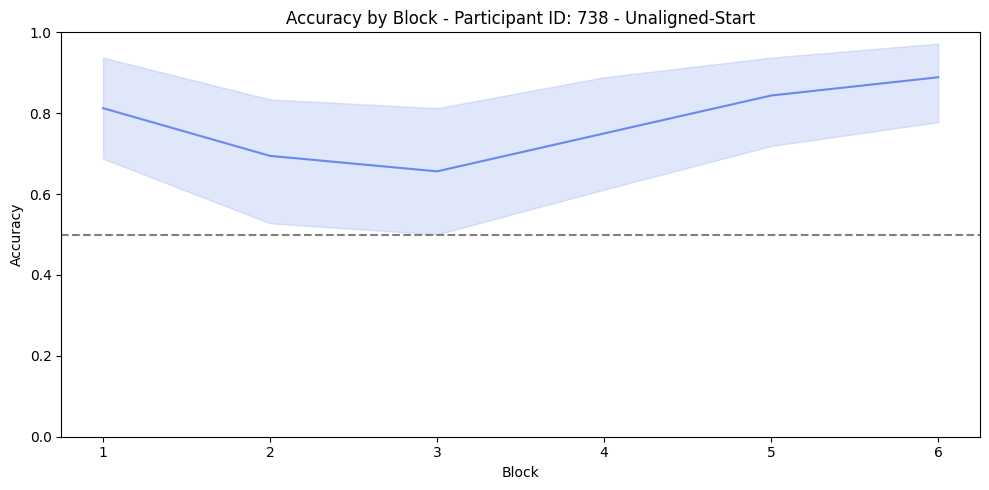

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


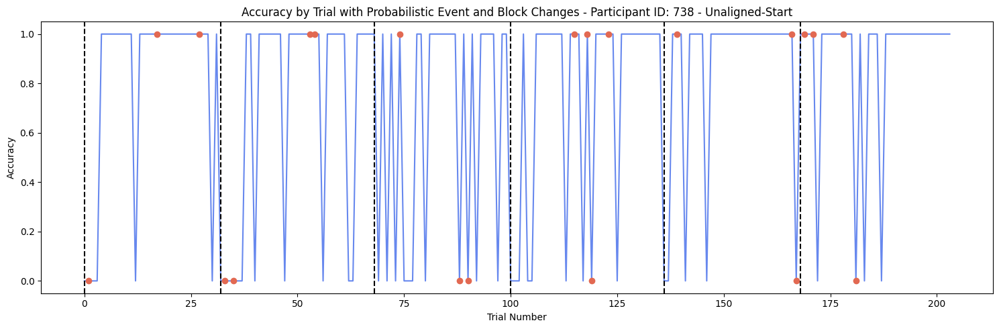

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


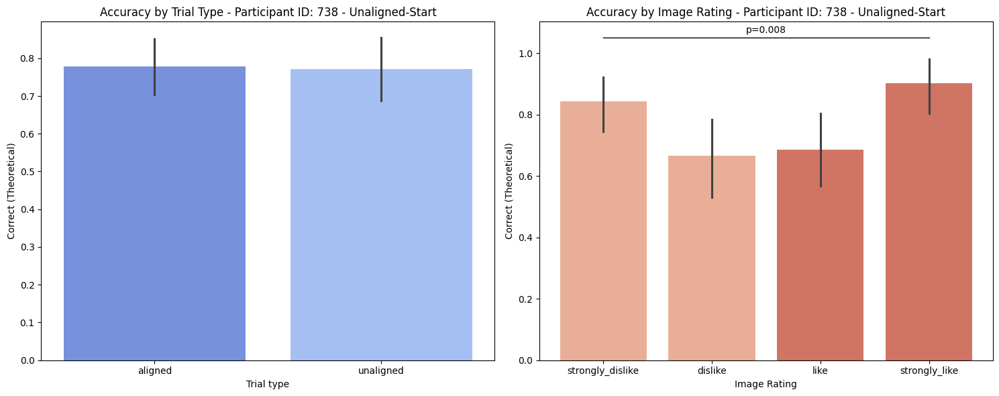

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.002).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


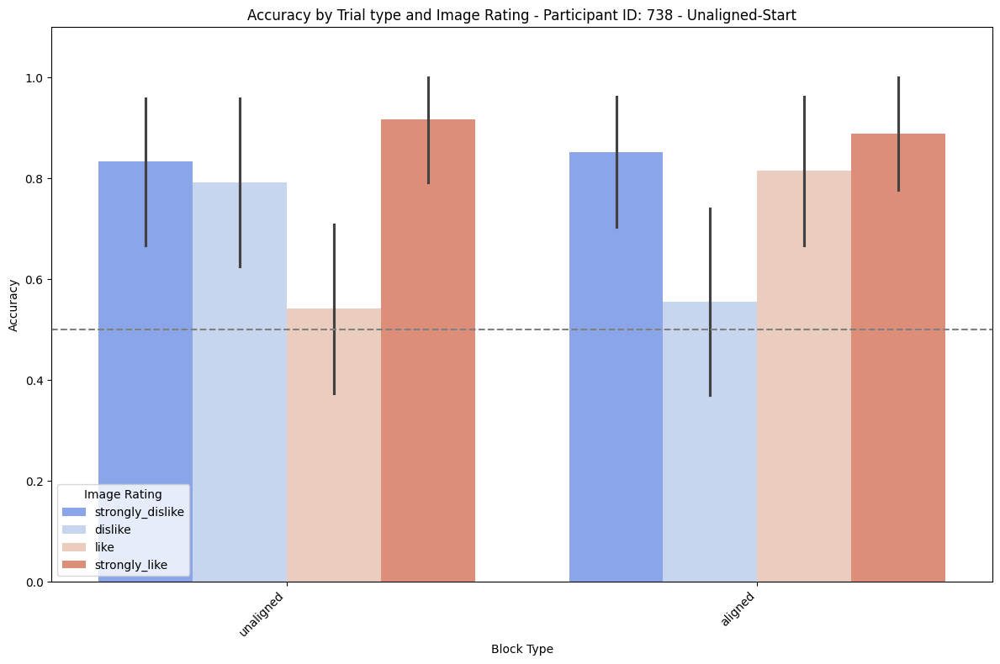

Data for participant 737:
Participant ID: 737

Accuracy in each 'Block':
Block
1    0.28125
2    0.50000
3    0.46875
4    0.28125
5    0.50000
6    0.59375
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.460000
unaligned    0.416667
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.5435059447618578

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.28125
            2        0.50000
            3        0.46875
            4        0.28125
            5        0.50000
            6        0.59375
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.510204
like                0.346939
strongly_dislike    0.387755
strongly_like       0.510204
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.238008364319783
Data for Chi-squared test:
Correct (Binary)   0   1
Image Ra

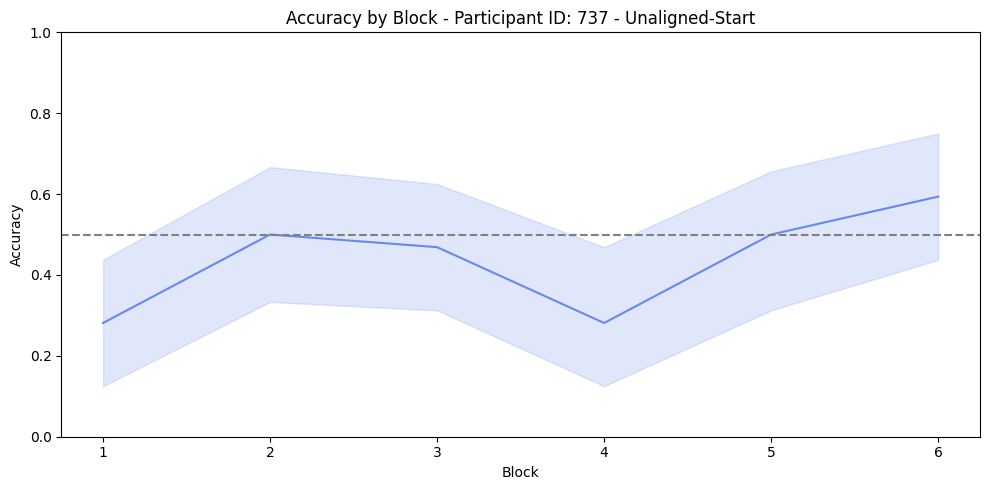

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


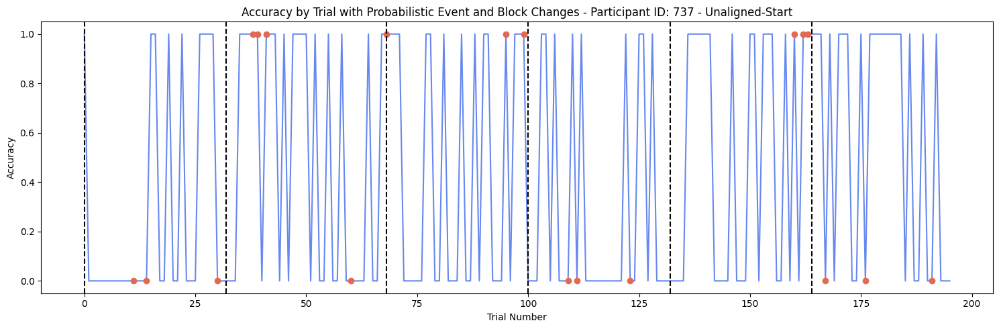

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


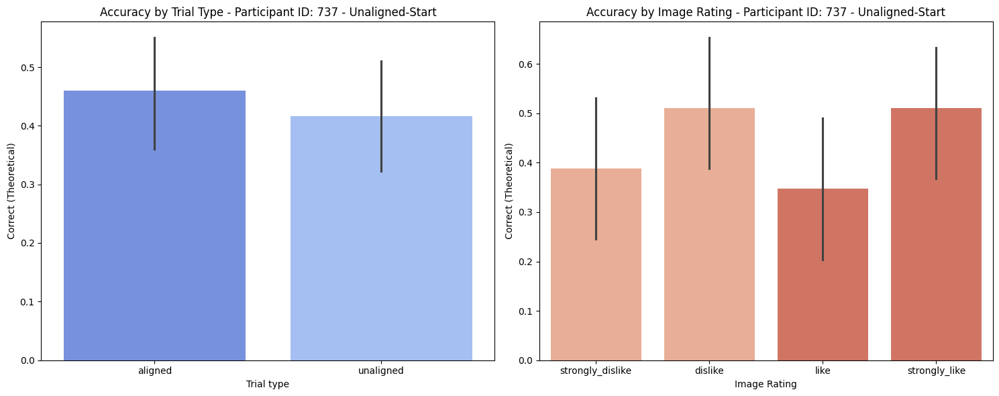

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.011).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.011).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.002).


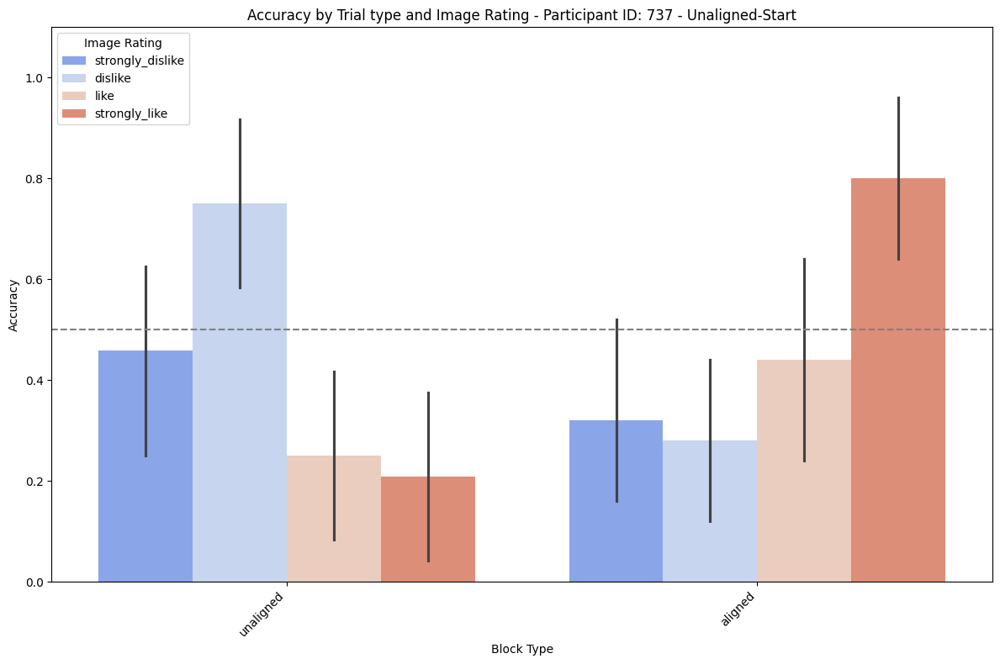

Data for participant 726:
Participant ID: 726

Accuracy in each 'Block':
Block
1    0.833333
2    0.722222
3    0.843750
4    0.812500
5    0.777778
6    0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.780000
unaligned    0.817308
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.5086108103234518

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.833333
            2        0.722222
            3        0.843750
            4        0.812500
            5        0.777778
            6        0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.803922
like                0.823529
strongly_dislike    0.784314
strongly_like       0.784314
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.953165084245058
Data for Chi-squared test:
Correct (Binary)   0 

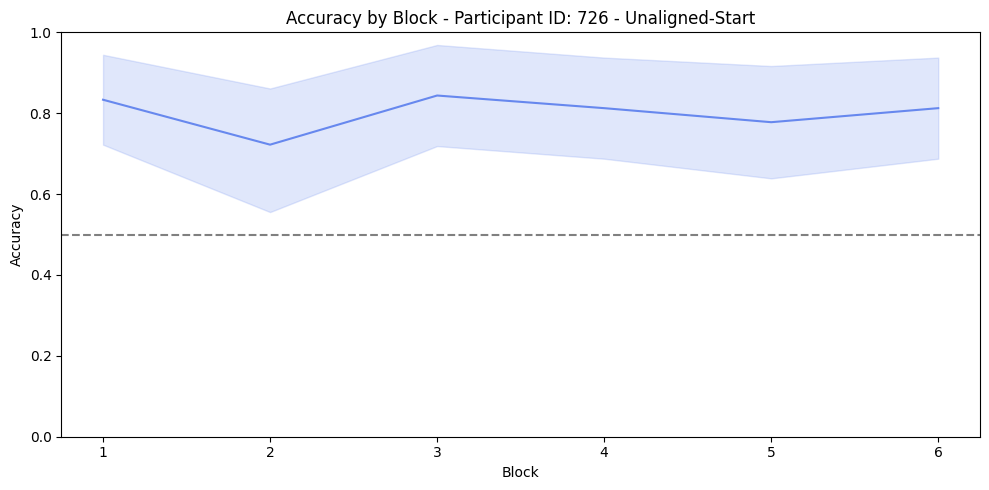

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


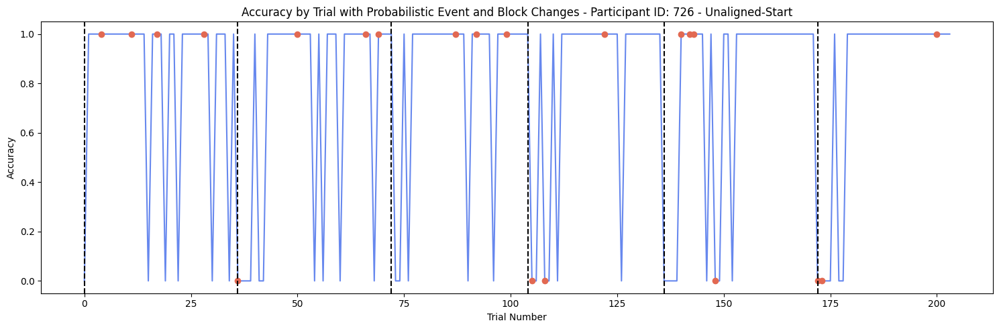

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


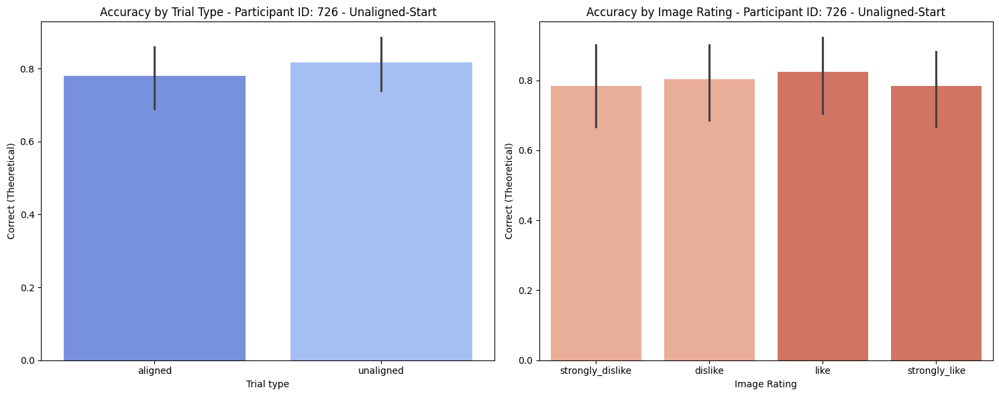

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


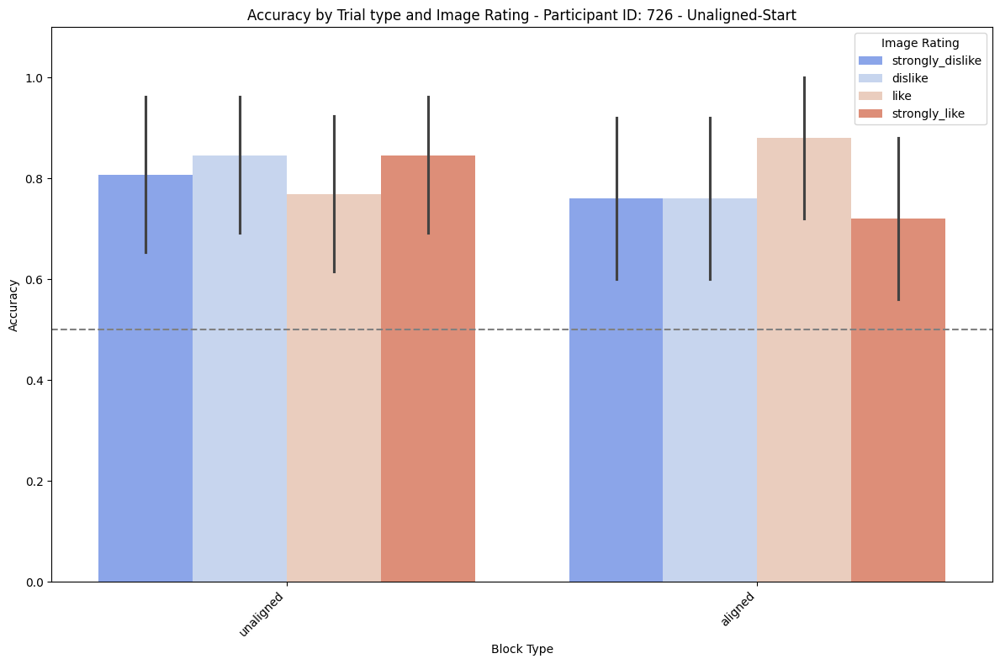

Data for participant 744:
Participant ID: 744

Accuracy in each 'Block':
Block
1    0.968750
2    0.722222
3    0.750000
4    0.937500
5    0.875000
6    0.916667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.864583
unaligned    0.855769
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.8584430268039558

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.968750
            2        0.722222
            3        0.750000
            4        0.937500
            5        0.875000
            6        0.916667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.86
like                0.88
strongly_dislike    0.84
strongly_like       0.86
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.953857966628330
Data for Chi-squared test:
Correct (Binary)  0   1
Image Rating 

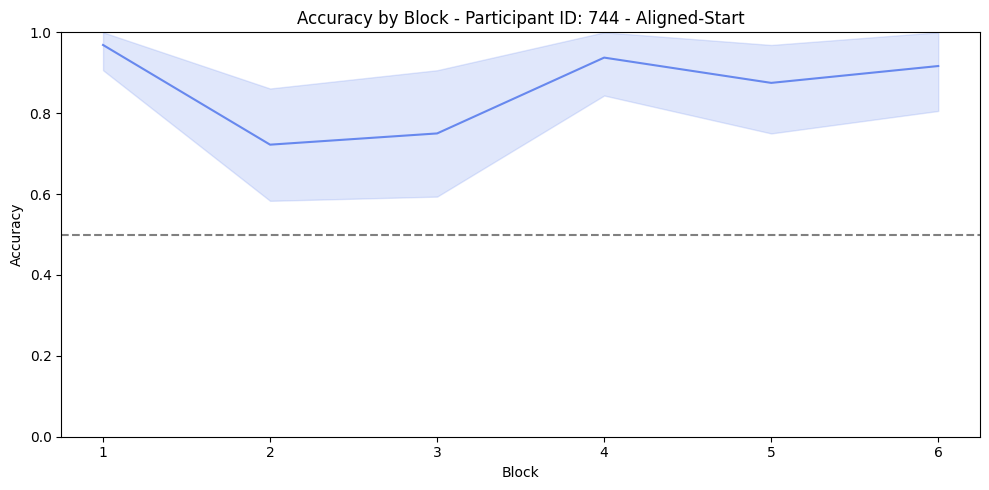

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


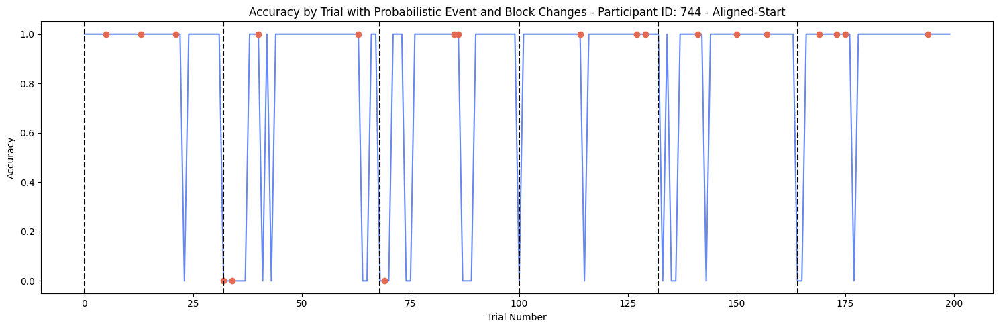

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


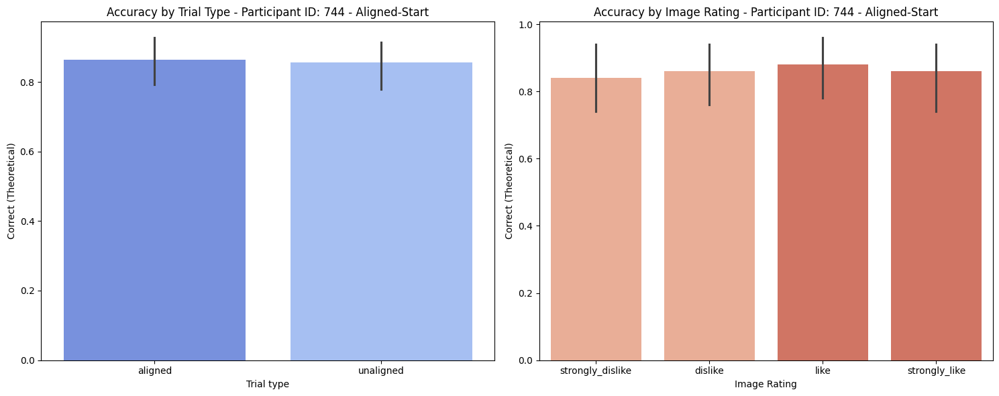

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


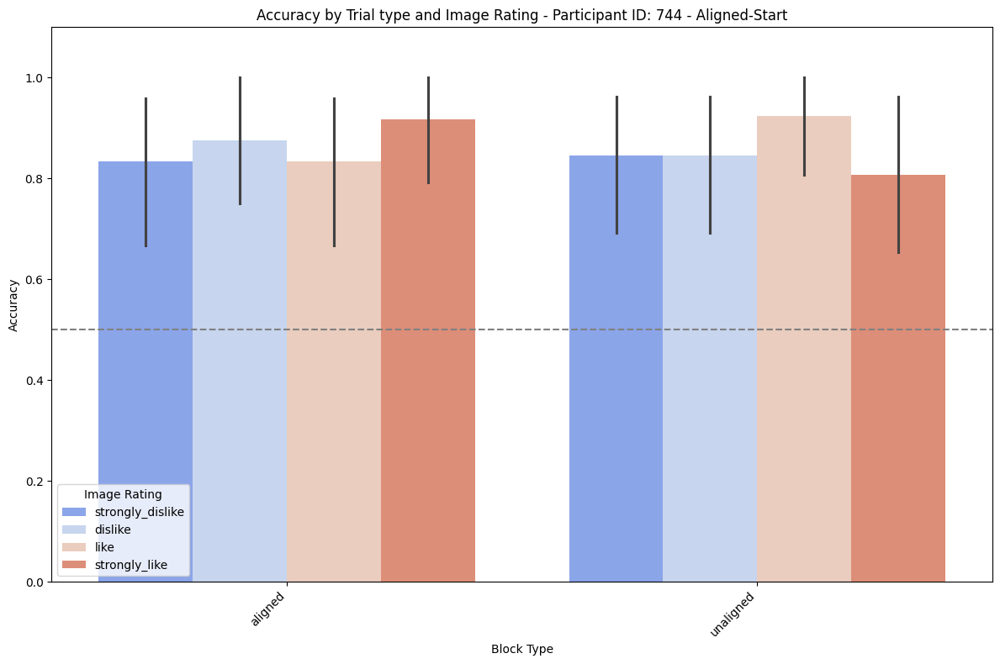

Data for participant 751:
Participant ID: 751

Accuracy in each 'Block':
Block
1    1.000000
2    0.777778
3    0.843750
4    0.562500
5    0.750000
6    0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.865385
unaligned    0.700000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0039404333979334875

Accuracy over the whole task:
All Trials  Block
All Trials  1        1.000000
            2        0.777778
            3        0.843750
            4        0.562500
            5        0.750000
            6        0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.764706
like                0.764706
strongly_dislike    0.764706
strongly_like       0.843137
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.707667067844730
Data for Chi-squared test:
Correct (Binary)  

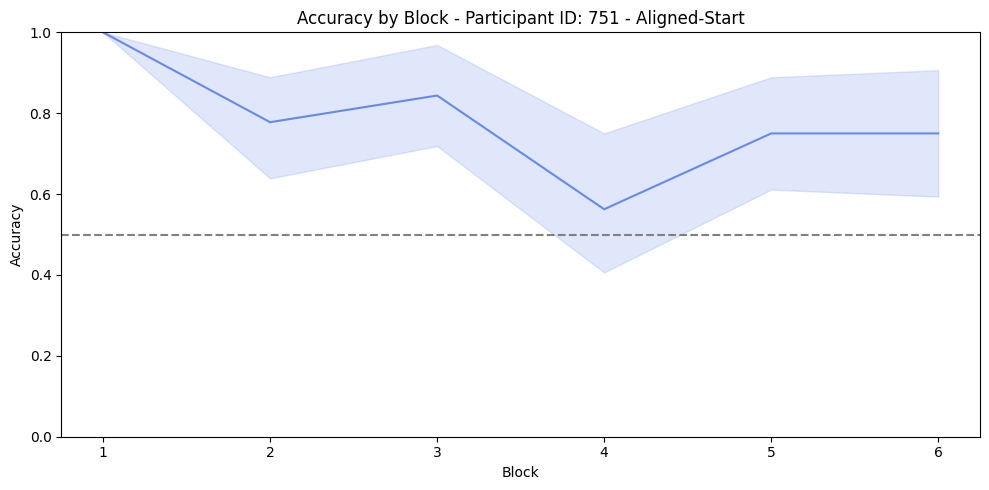

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


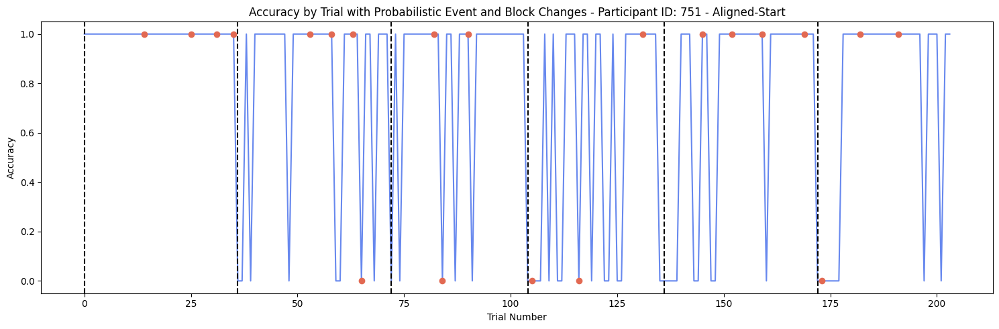

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


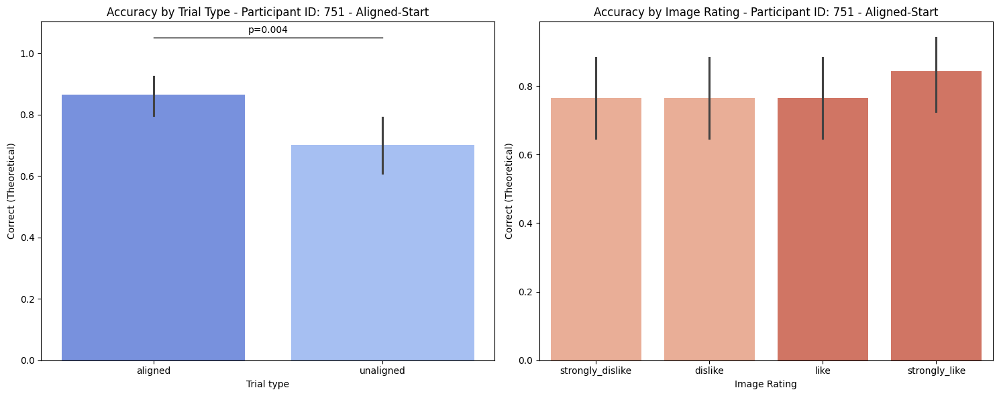

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.006).


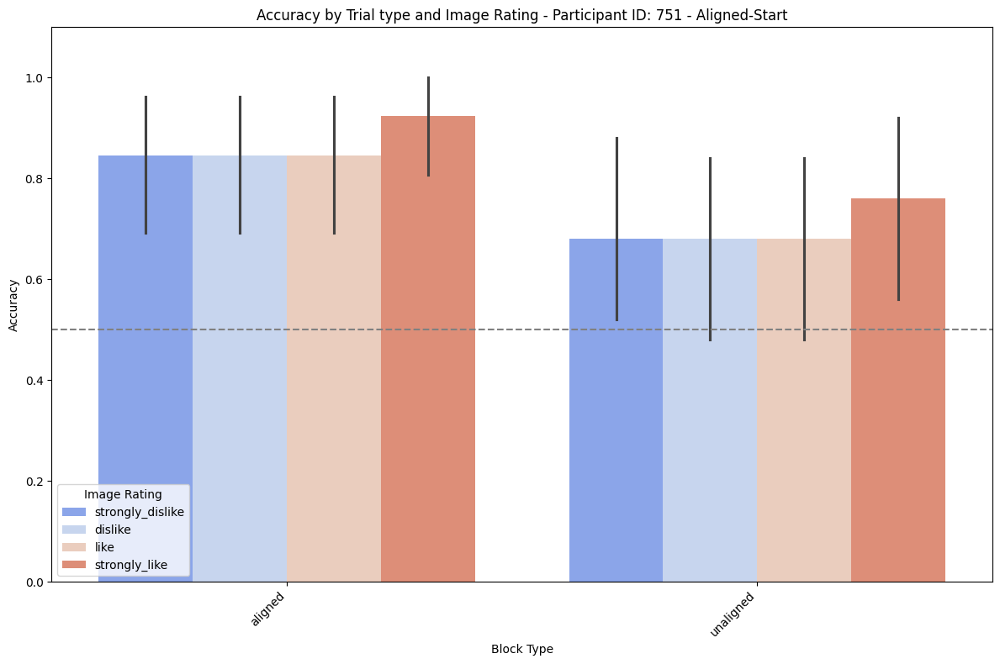

Data for participant 752:
Participant ID: 752

Accuracy in each 'Block':
Block
1    0.781250
2    0.388889
3    0.888889
4    0.388889
5    0.750000
6    0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.807692
unaligned    0.425926
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 3.4181760682618445e-09

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.781250
            2        0.388889
            3        0.888889
            4        0.388889
            5        0.750000
            6        0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.622642
like                0.547170
strongly_dislike    0.679245
strongly_like       0.603774
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.574746428979884
Data for Chi-squared test:
Correct (Binary) 

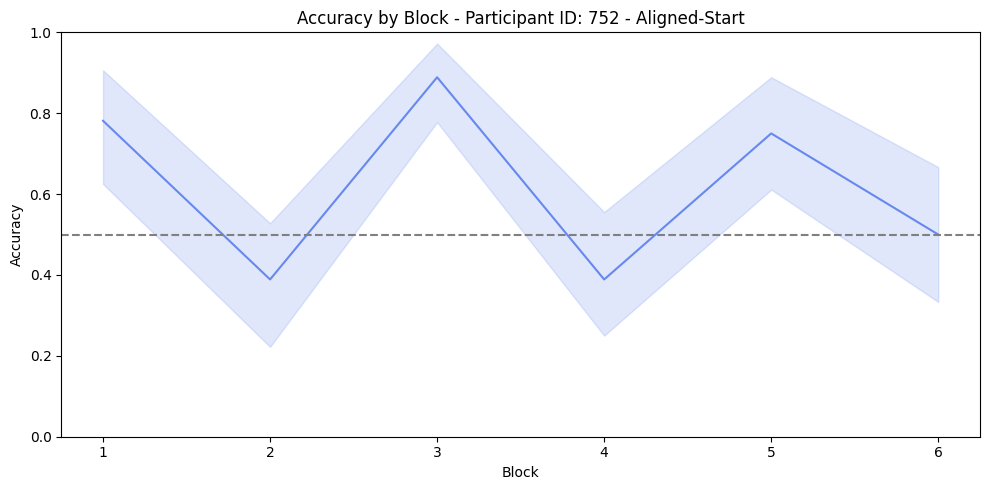

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


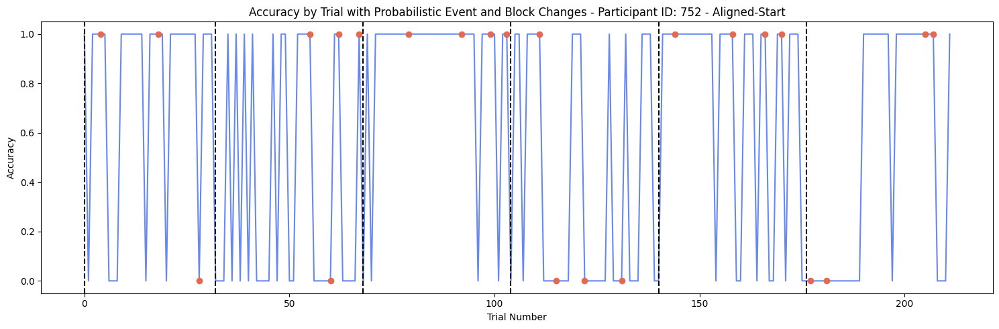

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


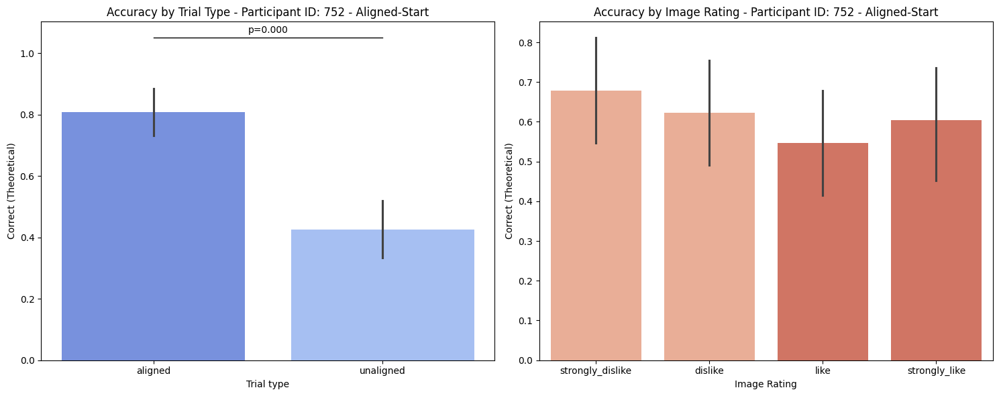

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.009).


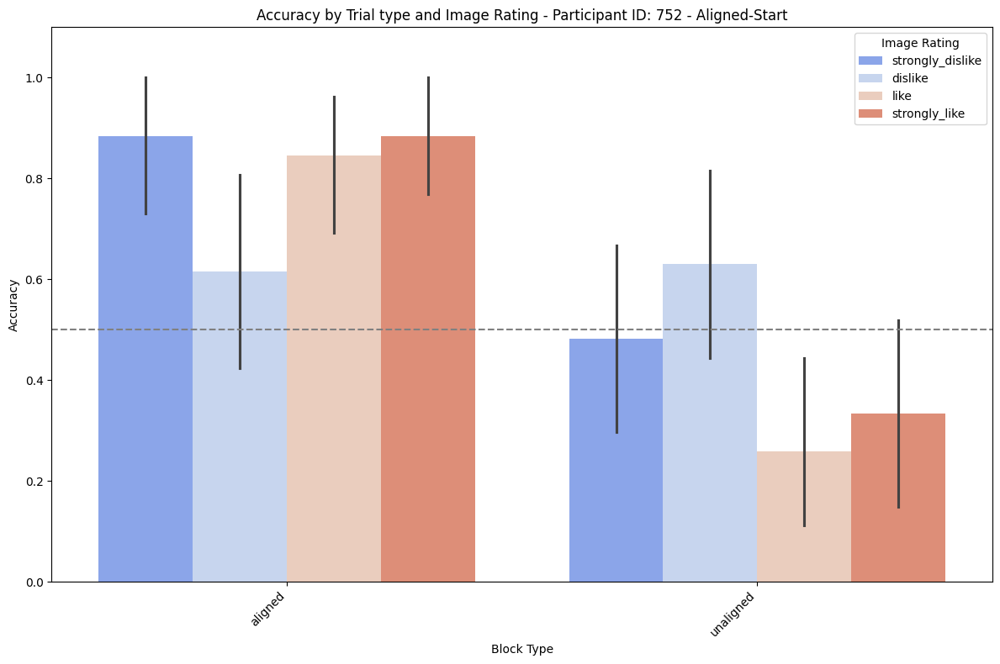

Data for participant 743:
Participant ID: 743

Accuracy in each 'Block':
Block
1    0.937500
2    0.718750
3    0.906250
4    0.843750
5    0.833333
6    0.937500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.890000
unaligned    0.833333
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.25208939616044435

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.937500
            2        0.718750
            3        0.906250
            4        0.843750
            5        0.833333
            6        0.937500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.836735
like                0.877551
strongly_dislike    0.897959
strongly_like       0.836735
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.762670006929719
Data for Chi-squared test:
Correct (Binary)  0 

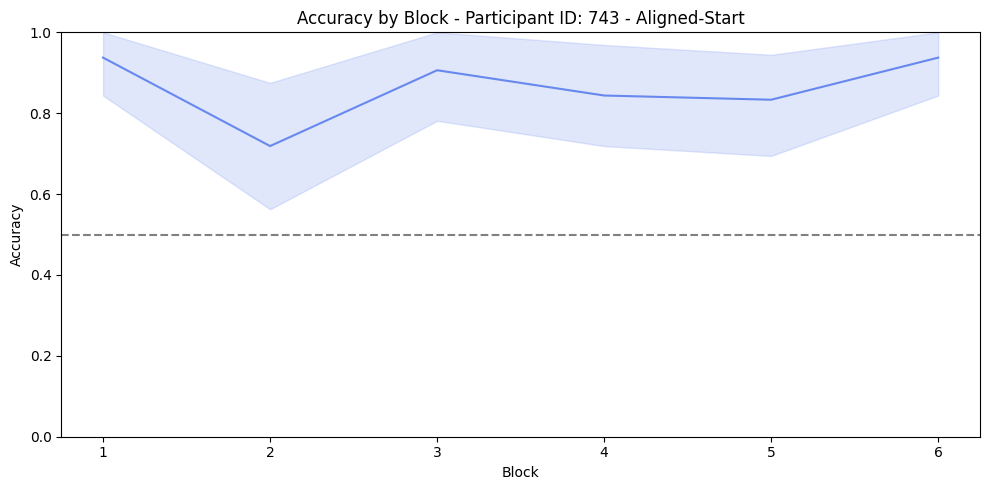

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


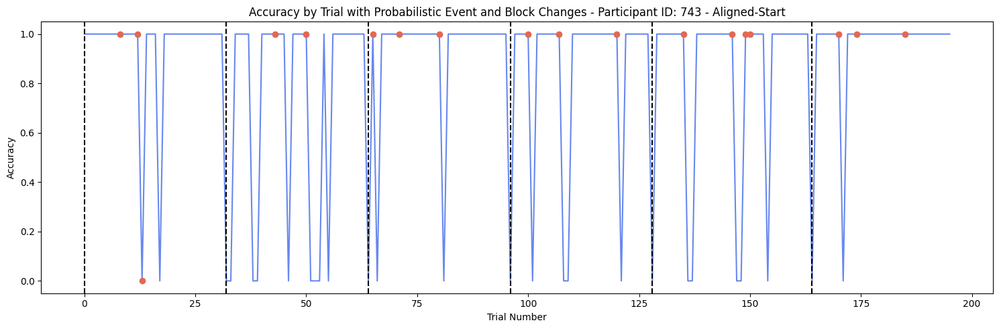

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


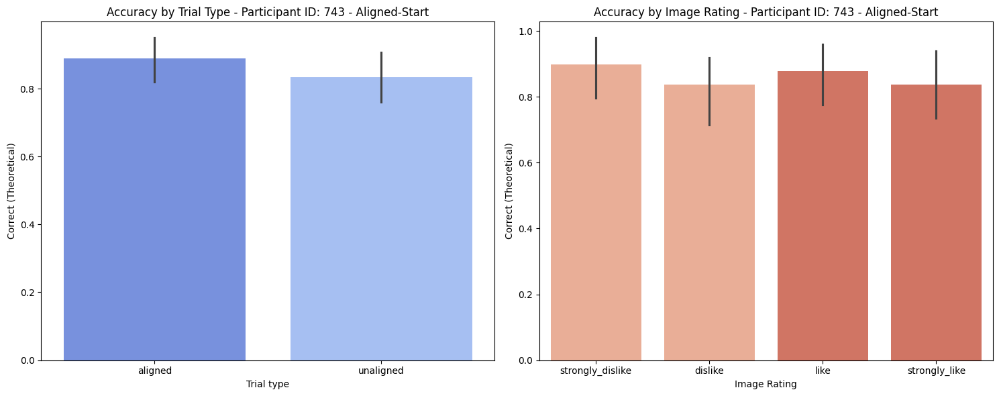

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.002).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.011).


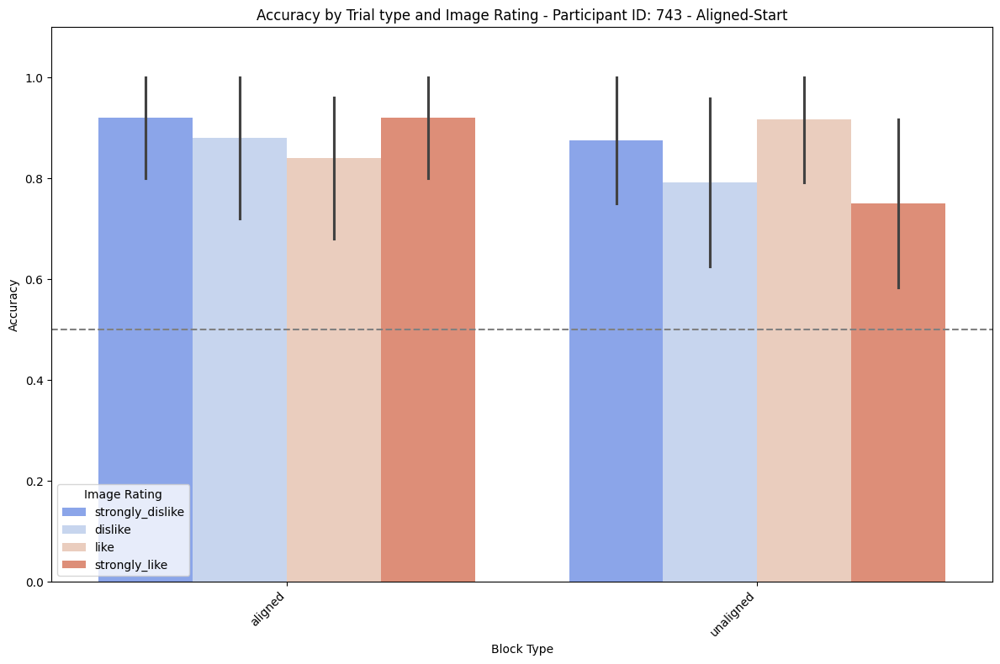

Data for participant 748:
Participant ID: 748

Accuracy in each 'Block':
Block
1    0.718750
2    0.687500
3    0.375000
4    0.625000
5    0.500000
6    0.611111
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.53125
unaligned    0.64000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.12345265559096902

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.718750
            2        0.687500
            3        0.375000
            4        0.625000
            5        0.500000
            6        0.611111
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.591837
like                0.612245
strongly_dislike    0.612245
strongly_like       0.530612
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.824274800376850
Data for Chi-squared test:
Correct (Binary)   0  

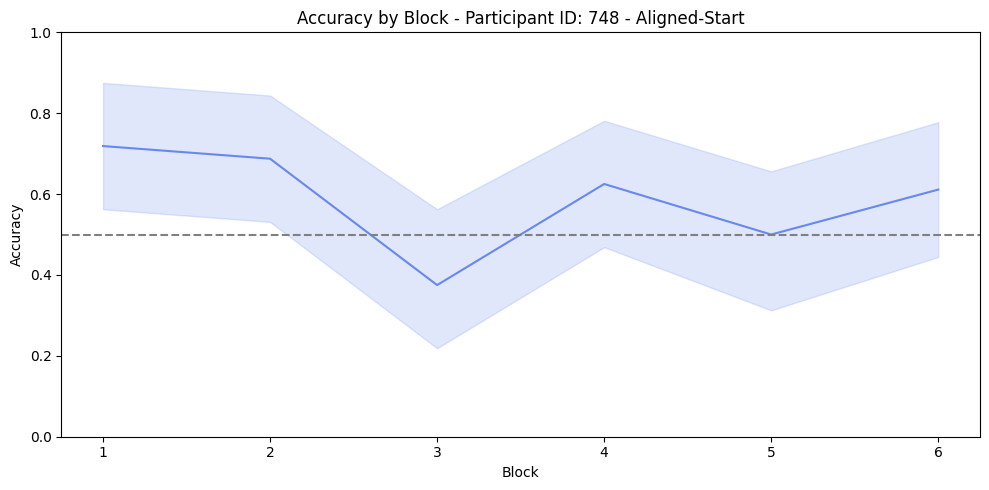

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


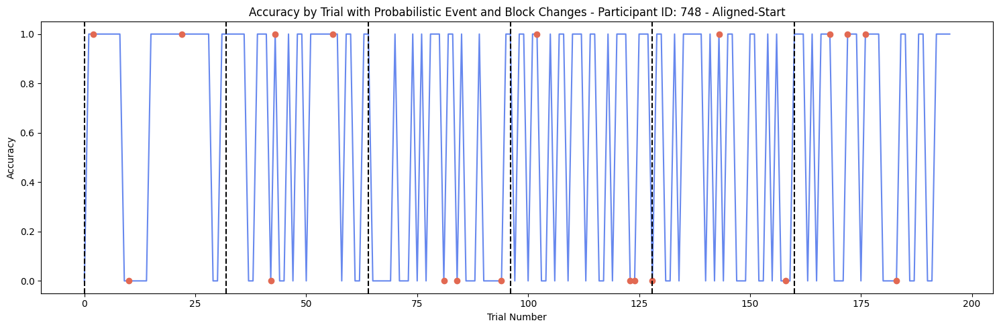

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


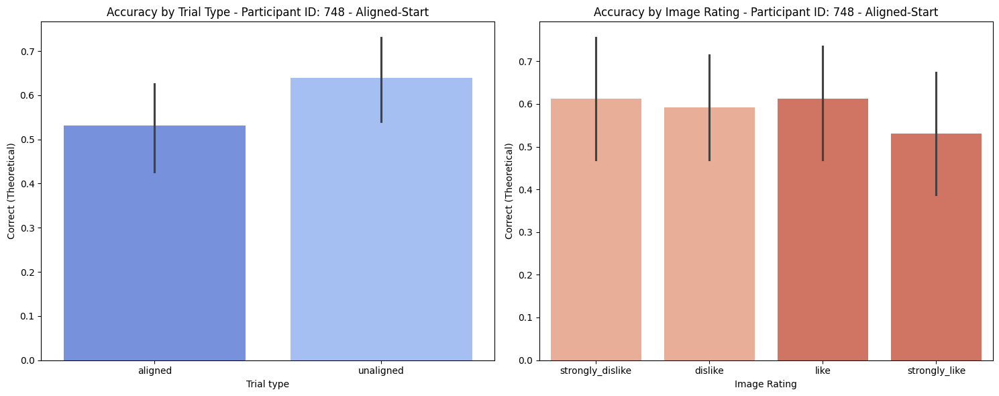

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.011).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).


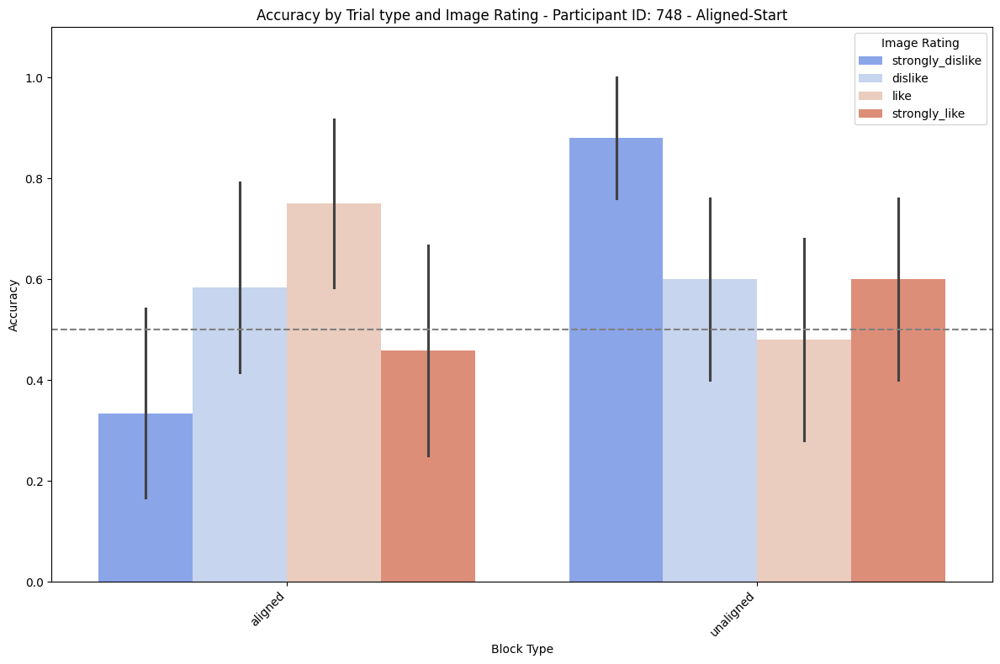

Data for participant 742:
Participant ID: 742

Accuracy in each 'Block':
Block
1    1.000000
2    0.138889
3    0.937500
4    0.125000
5    0.750000
6    0.222222
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.890000
unaligned    0.163462
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 8.127839060809915e-35

Accuracy over the whole task:
All Trials  Block
All Trials  1        1.000000
            2        0.138889
            3        0.937500
            4        0.125000
            5        0.750000
            6        0.222222
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.529412
like                0.490196
strongly_dislike    0.529412
strongly_like       0.529412
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.971637654090249
Data for Chi-squared test:
Correct (Binary)  

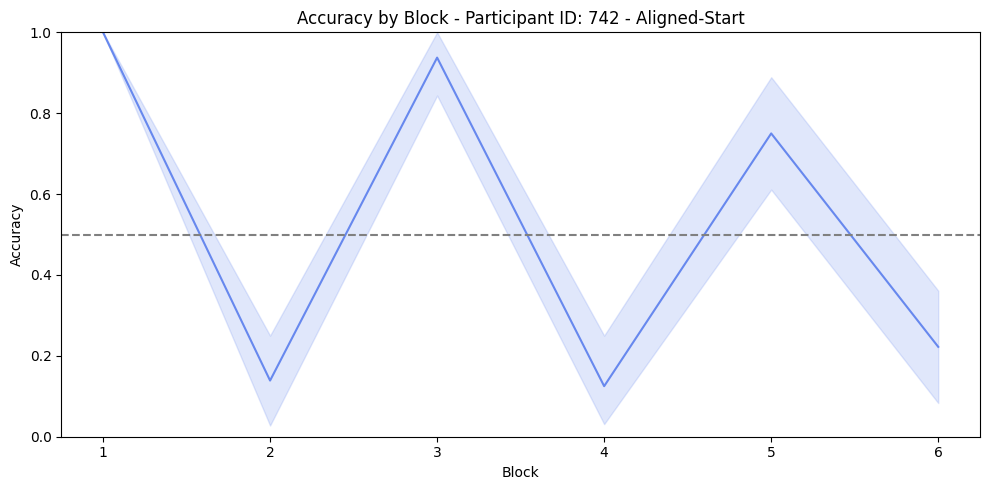

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


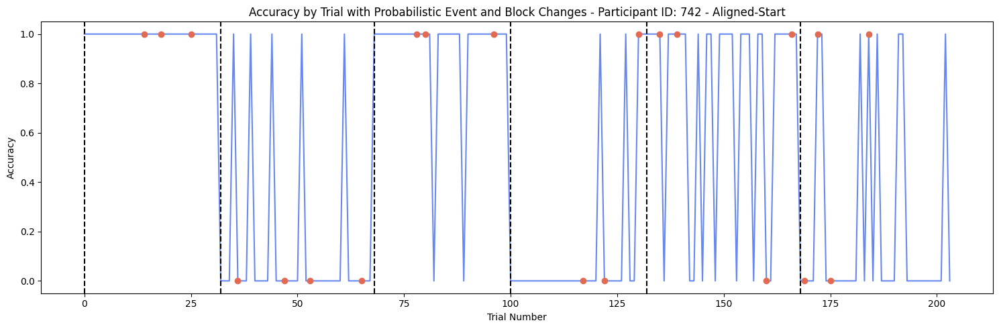

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


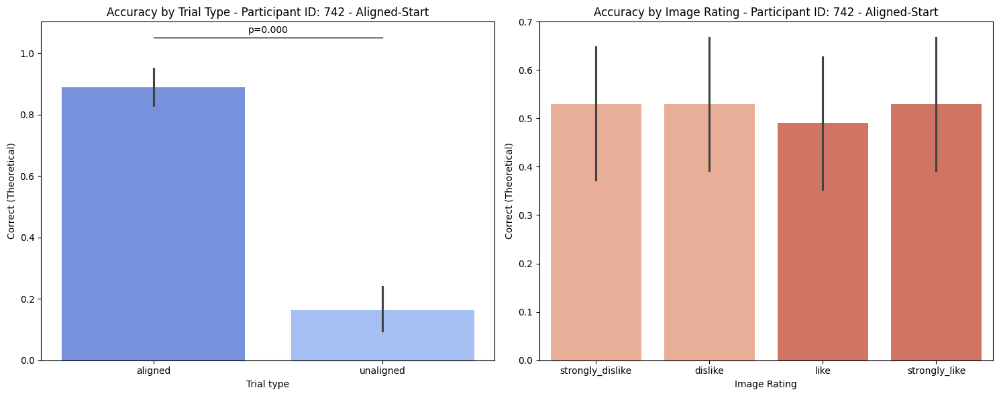

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


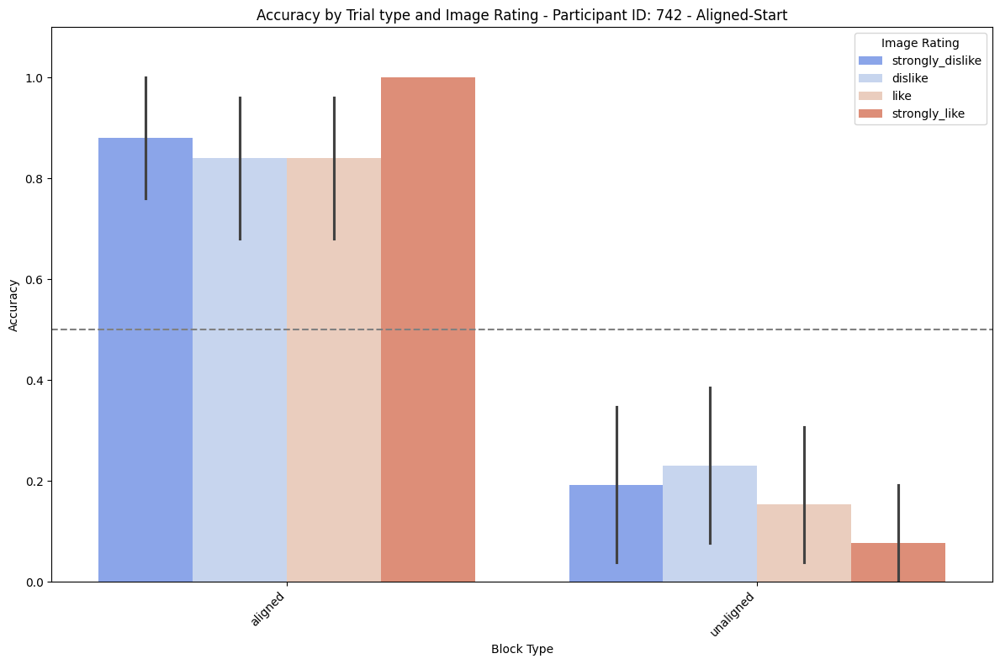

Data for participant 755:
Participant ID: 755

Accuracy in each 'Block':
Block
1    0.944444
2    0.812500
3    0.843750
4    0.531250
5    0.812500
6    0.625000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.87000
unaligned    0.65625
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0003639270067633188

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.944444
            2        0.812500
            3        0.843750
            4        0.531250
            5        0.812500
            6        0.625000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.775510
like                0.775510
strongly_dislike    0.775510
strongly_like       0.734694
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.952167348233449
Data for Chi-squared test:
Correct (Binary)   0

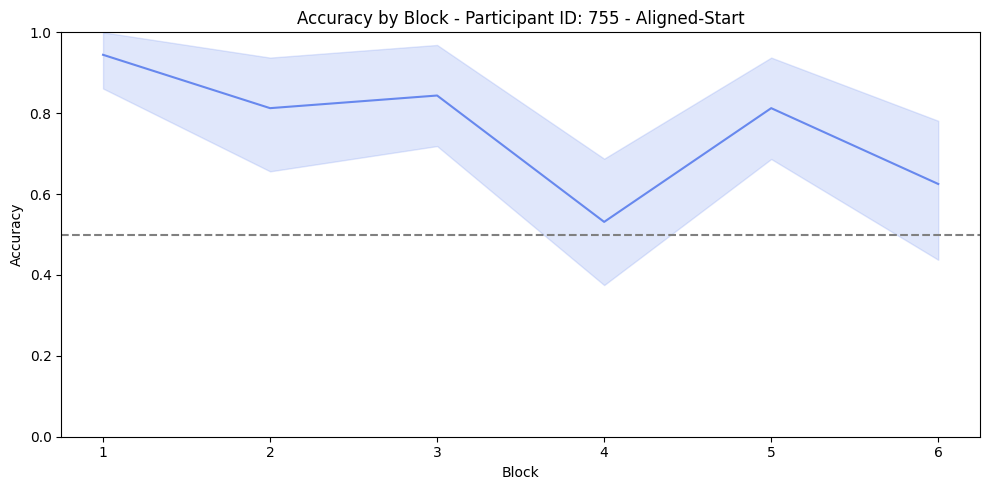

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


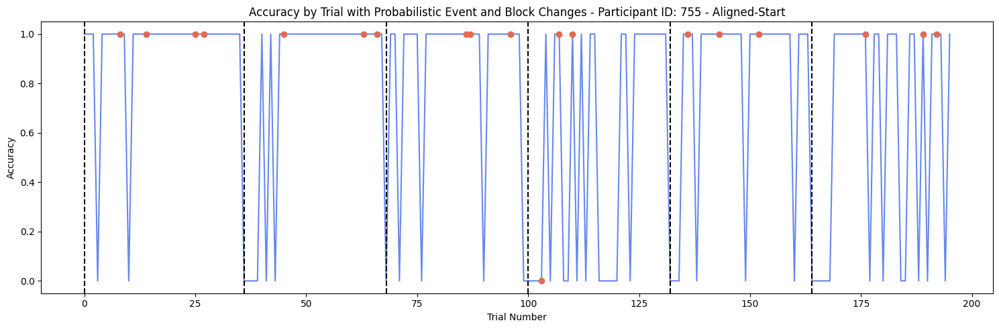

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


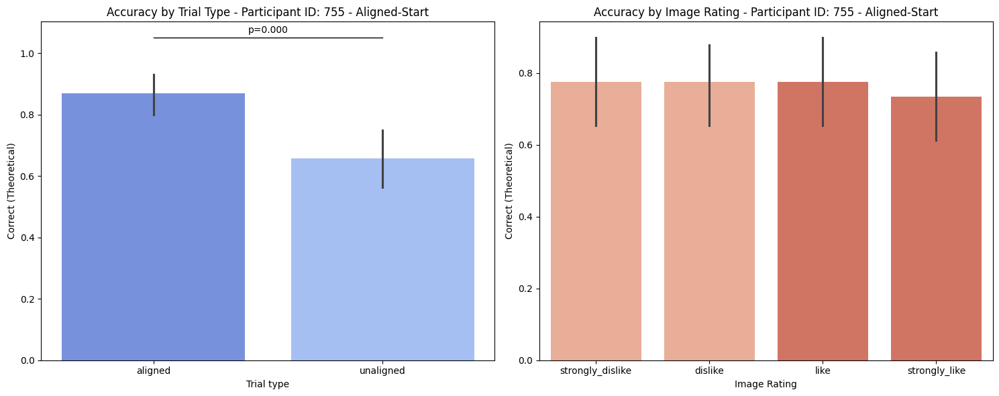

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.038).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.038).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.038).


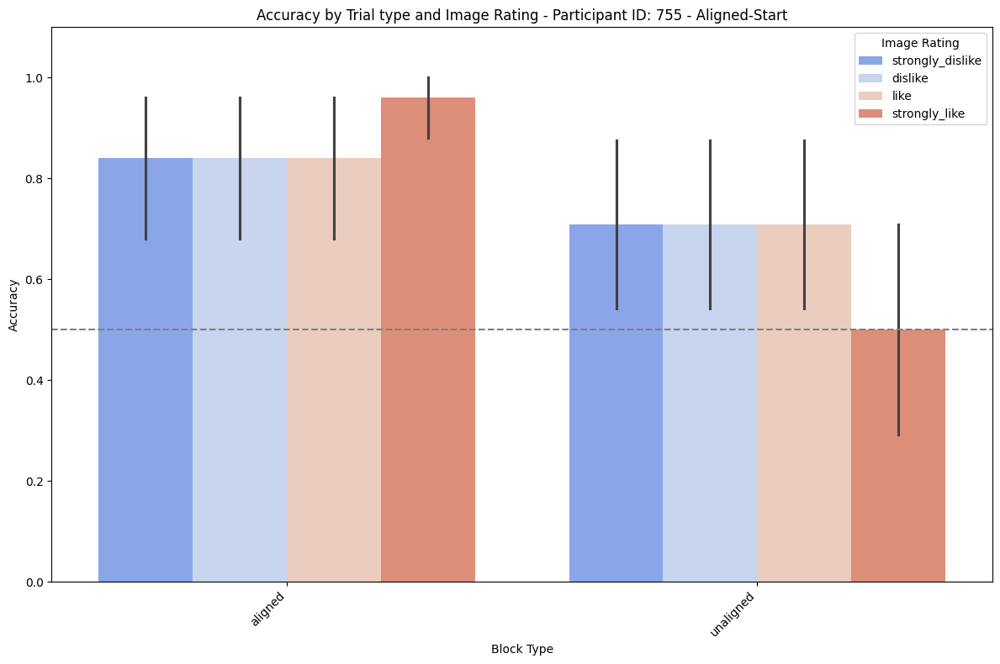

Data for participant 753:
Participant ID: 753

Accuracy in each 'Block':
Block
1    0.875000
2    0.375000
3    0.593750
4    0.562500
5    0.593750
6    0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.6875
unaligned    0.5000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0074192689320908105

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.875000
            2        0.375000
            3        0.593750
            4        0.562500
            5        0.593750
            6        0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.673469
like                0.653061
strongly_dislike    0.510204
strongly_like       0.530612
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.238256304537260
Data for Chi-squared test:
Correct (Binary)   0  

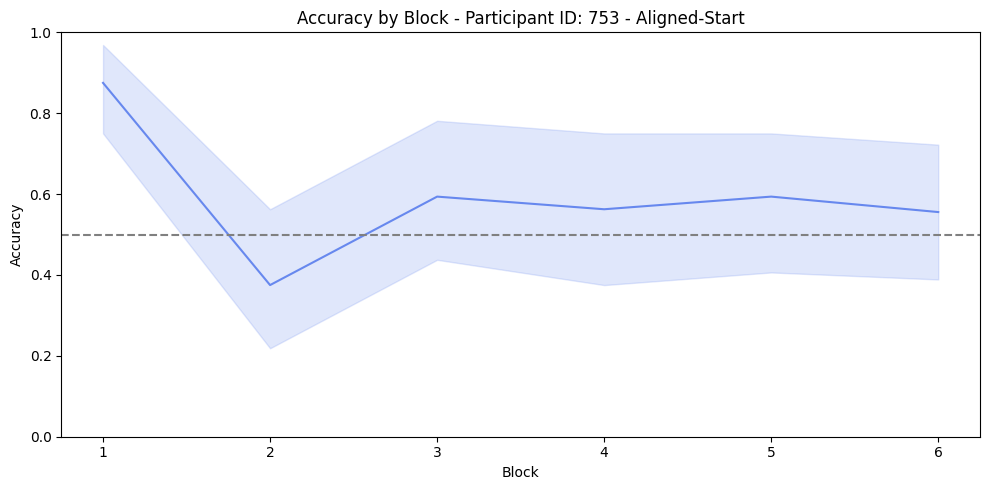

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


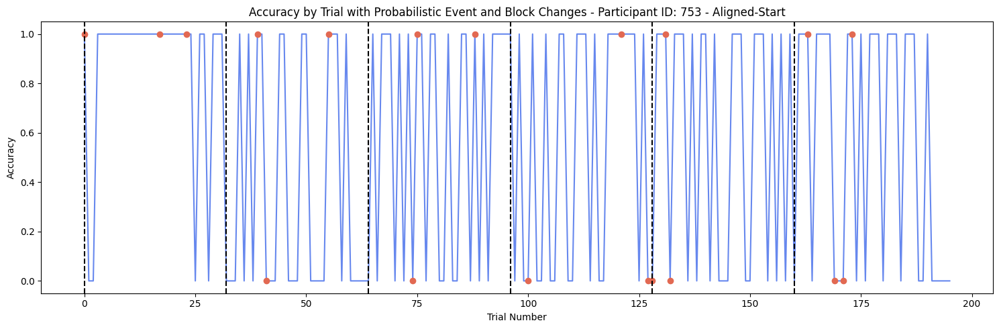

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


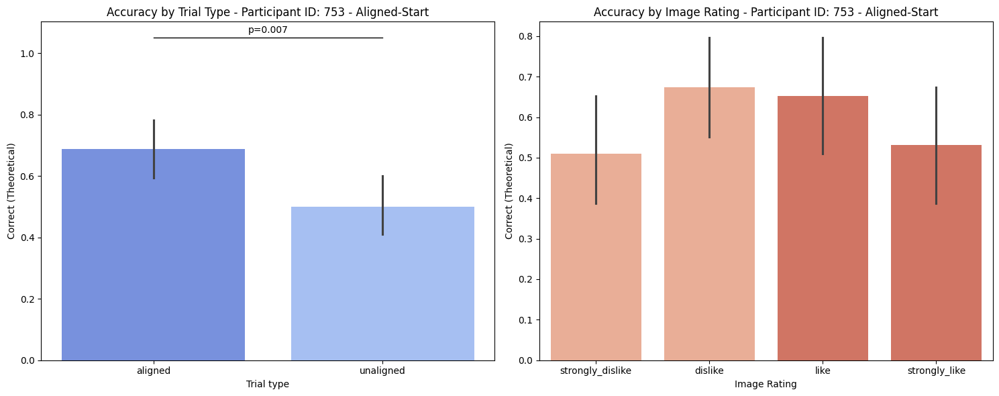

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


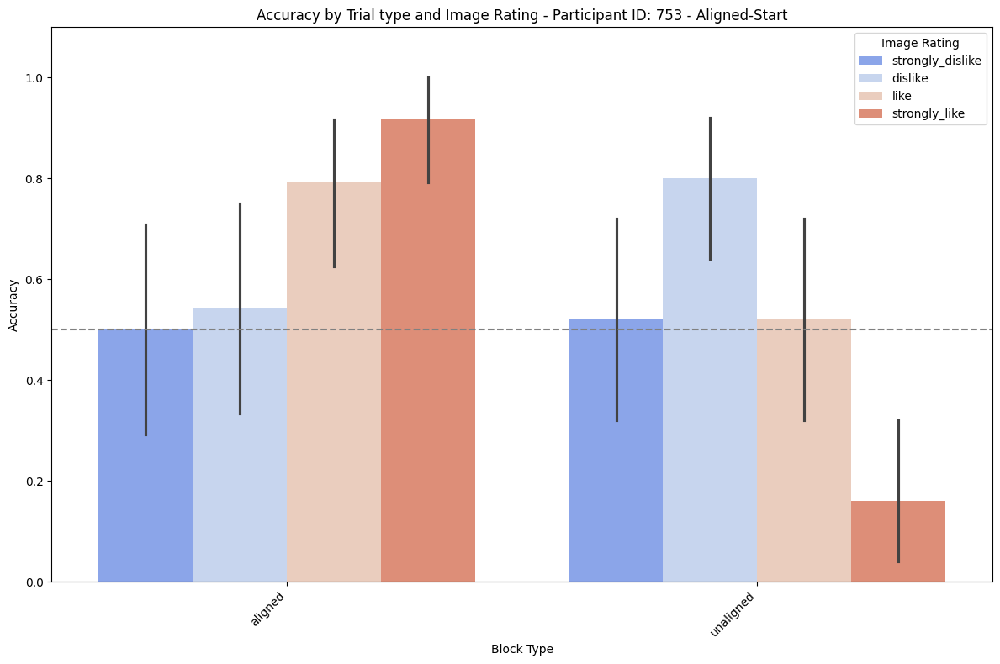

Data for participant 746:
Participant ID: 746

Accuracy in each 'Block':
Block
1    0.906250
2    0.781250
3    0.944444
4    0.861111
5    0.906250
6    0.722222
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.920000
unaligned    0.788462
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.007843953655709354

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.906250
            2        0.781250
            3        0.944444
            4        0.861111
            5        0.906250
            6        0.722222
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.843137
like                0.803922
strongly_dislike    0.843137
strongly_like       0.921569
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.396255852274321
Data for Chi-squared test:
Correct (Binary)   

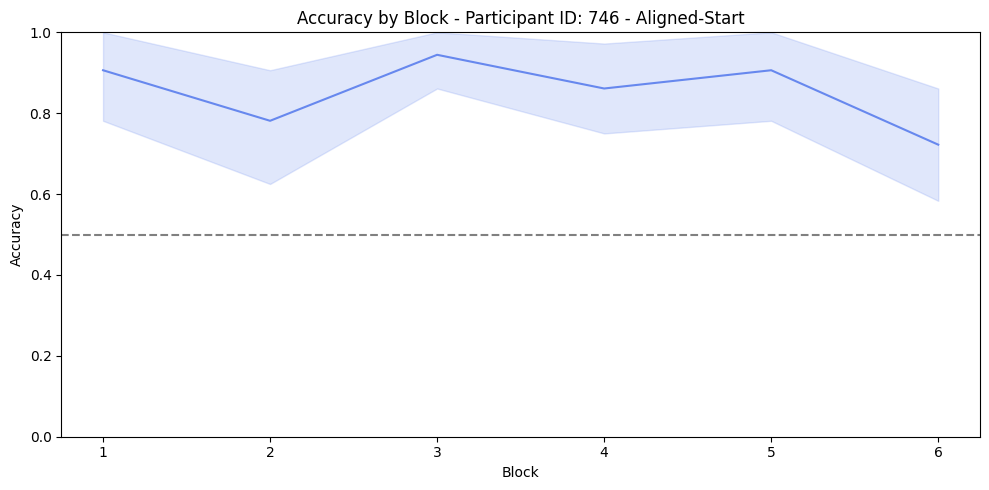

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


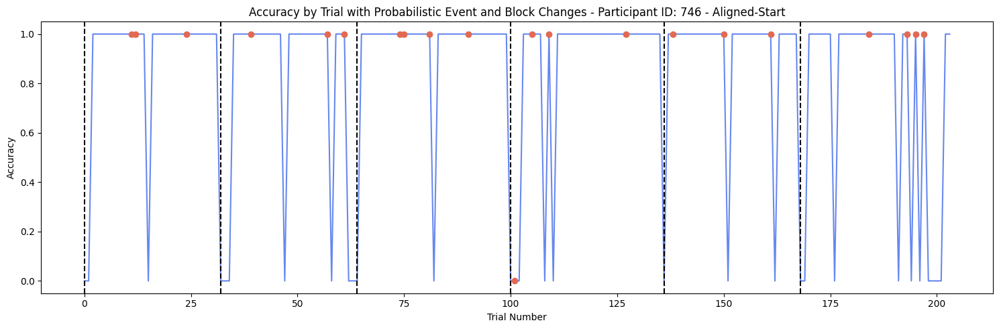

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


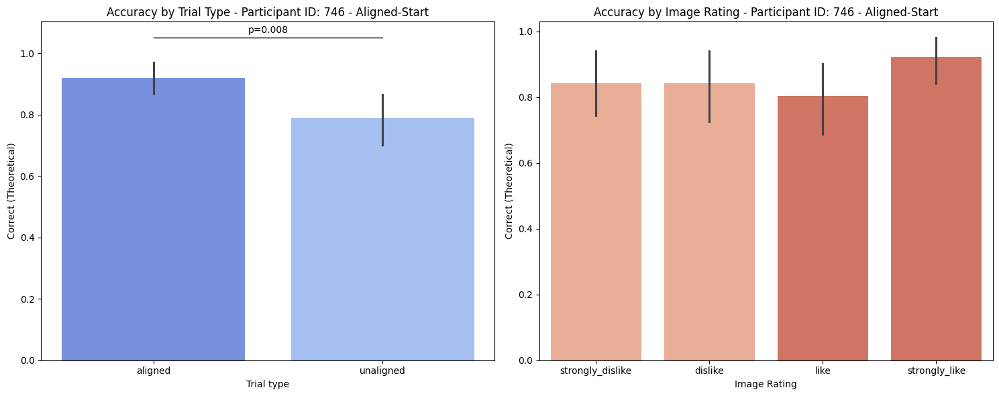

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.015).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


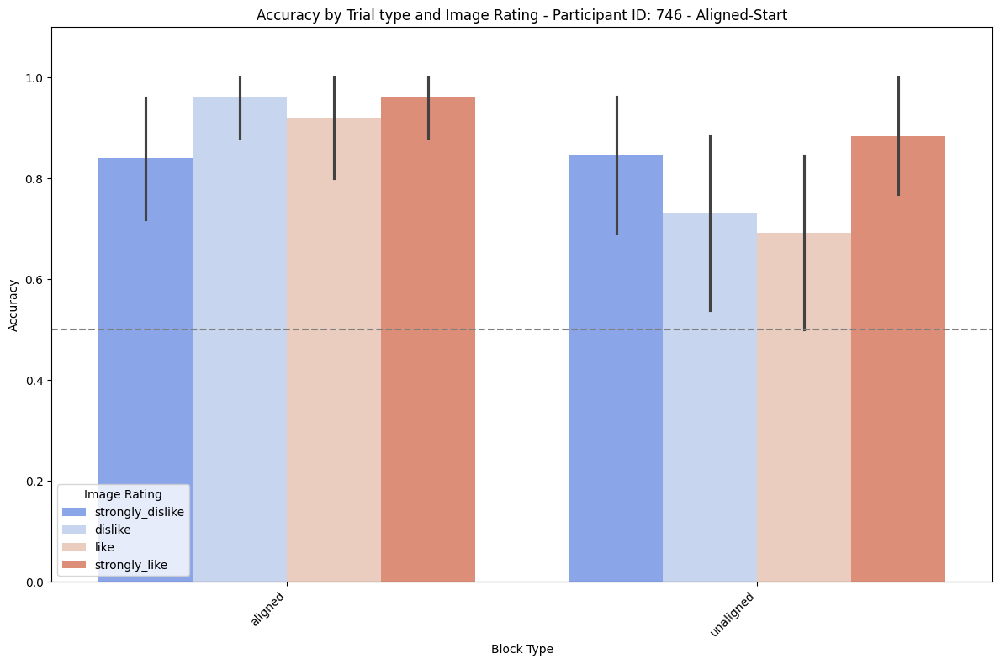

Data for participant 756:
Participant ID: 756

Accuracy in each 'Block':
Block
1    0.861111
2    0.805556
3    0.812500
4    0.750000
5    0.875000
6    0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.85
unaligned    0.77
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.15080983286529692

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.861111
            2        0.805556
            3        0.812500
            4        0.750000
            5        0.875000
            6        0.750000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.82
like                0.84
strongly_dislike    0.72
strongly_like       0.86
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.287550137585932
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating       

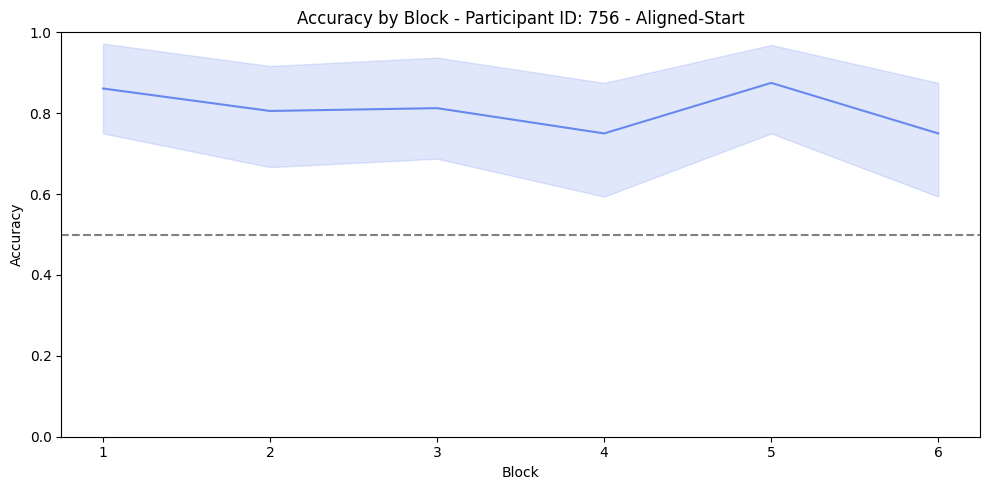

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


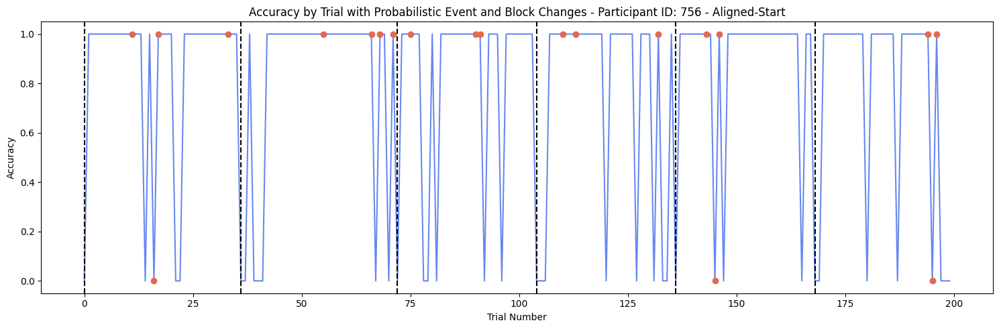

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


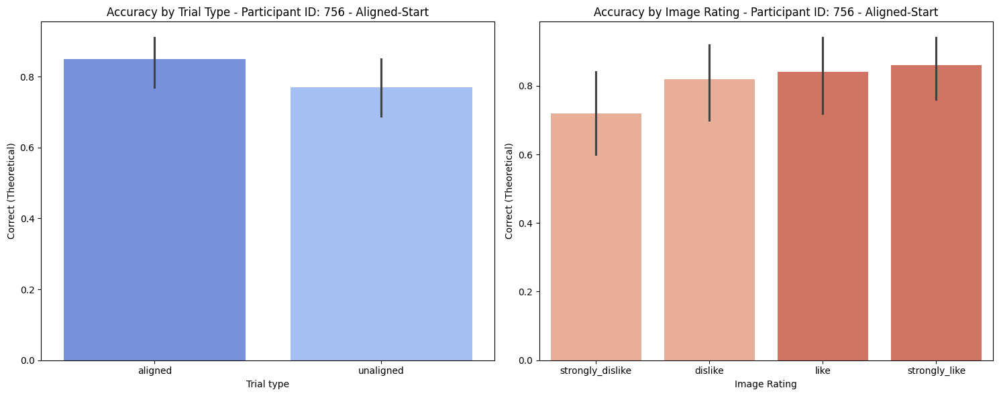

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.024).


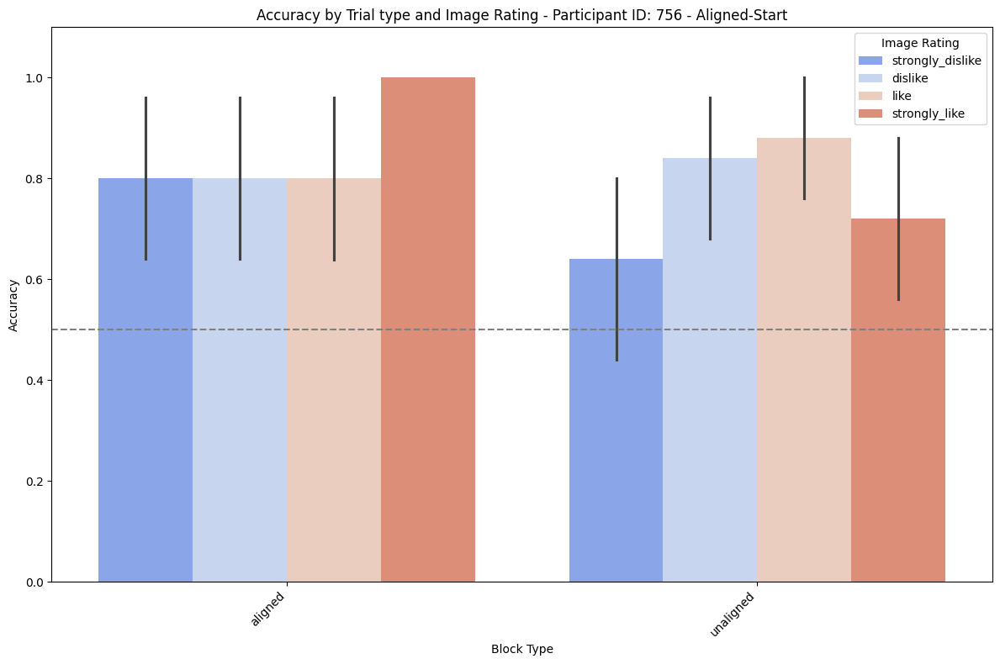

Data for participant 772:
Participant ID: 772

Accuracy in each 'Block':
Block
1    0.638889
2    0.416667
3    0.562500
4    0.555556
5    0.500000
6    0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.567308
unaligned    0.509259
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.3991338576885294

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.638889
            2        0.416667
            3        0.562500
            4        0.555556
            5        0.500000
            6        0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.528302
like                0.584906
strongly_dislike    0.433962
strongly_like       0.603774
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.293413674917680
Data for Chi-squared test:
Correct (Binary)   0 

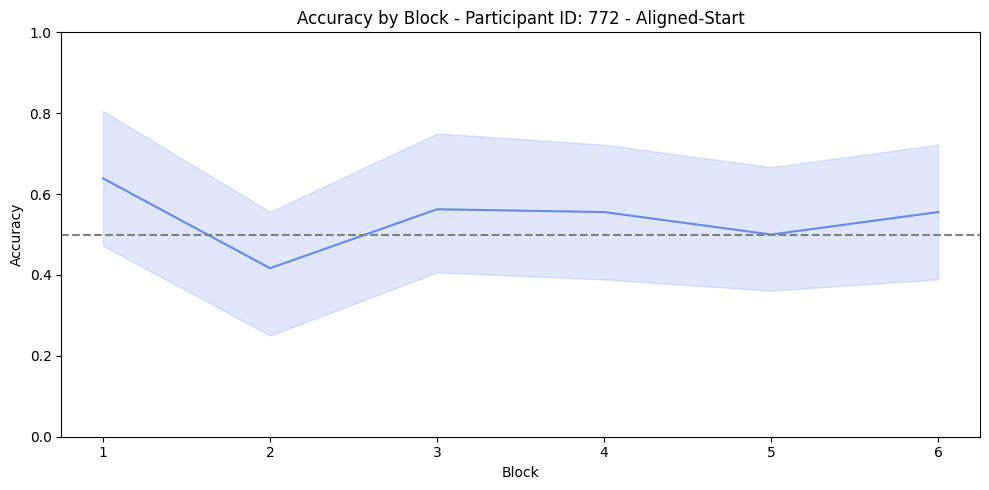

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


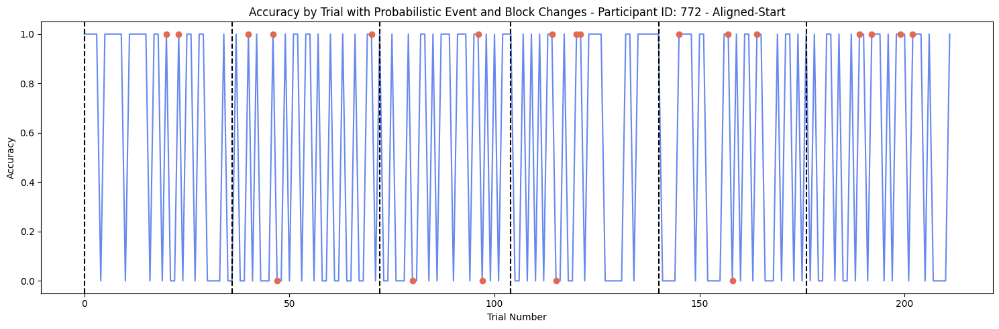

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


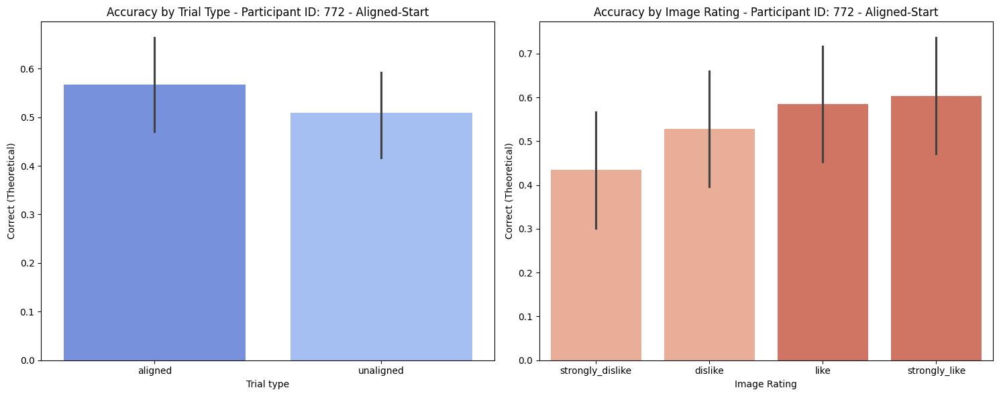

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


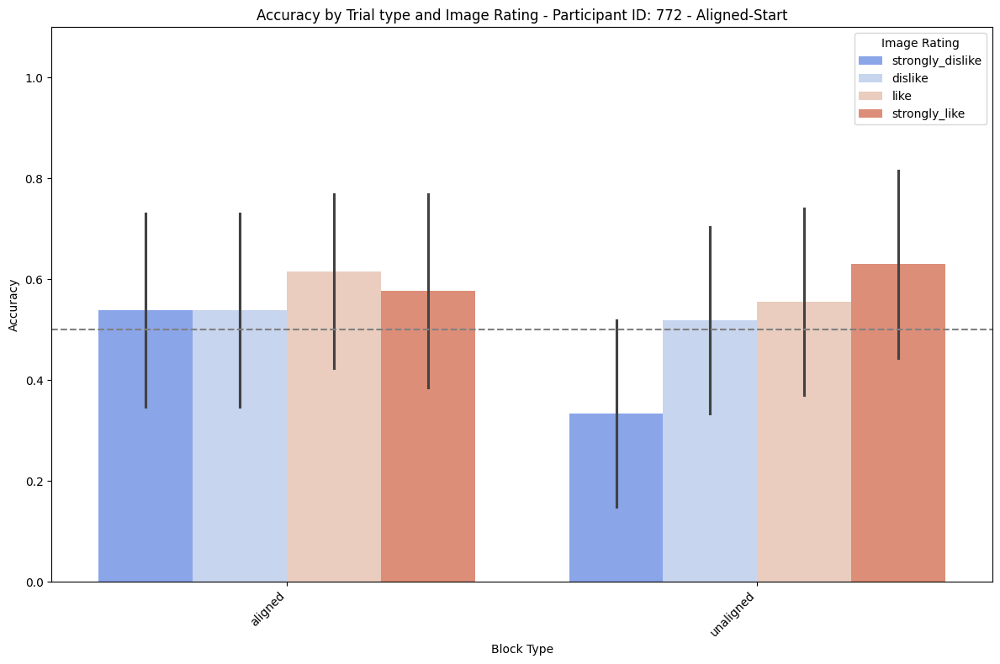

Data for participant 766:
Participant ID: 766

Accuracy in each 'Block':
Block
1    0.972222
2    0.968750
3    0.875000
4    0.937500
5    0.888889
6    0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.913462
unaligned    0.906250
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.8595607340434198

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.972222
            2        0.968750
            3        0.875000
            4        0.937500
            5        0.888889
            6        0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.84
like                0.96
strongly_dislike    0.90
strongly_like       0.94
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.162646474190026
Data for Chi-squared test:
Correct (Binary)  0   1
Image Rating 

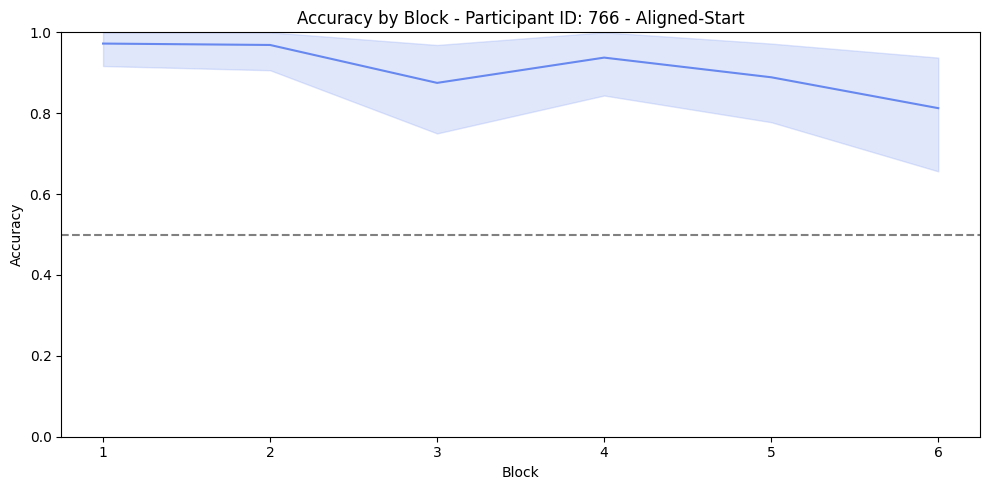

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


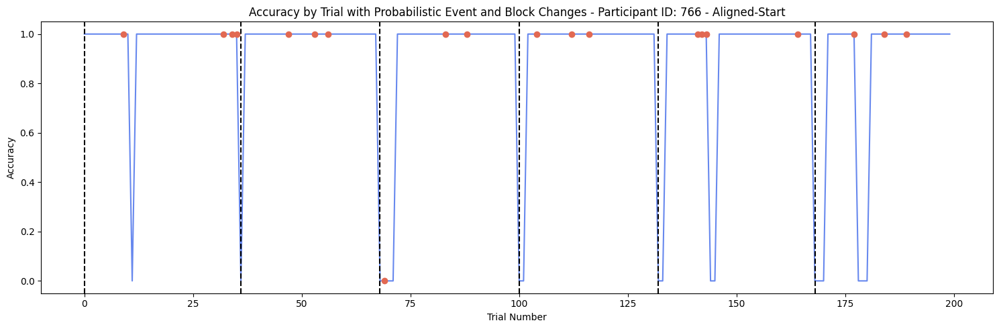

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


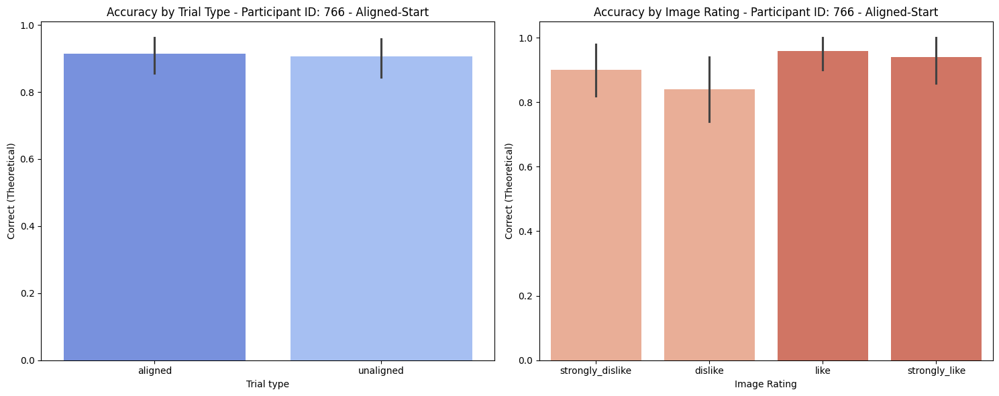

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


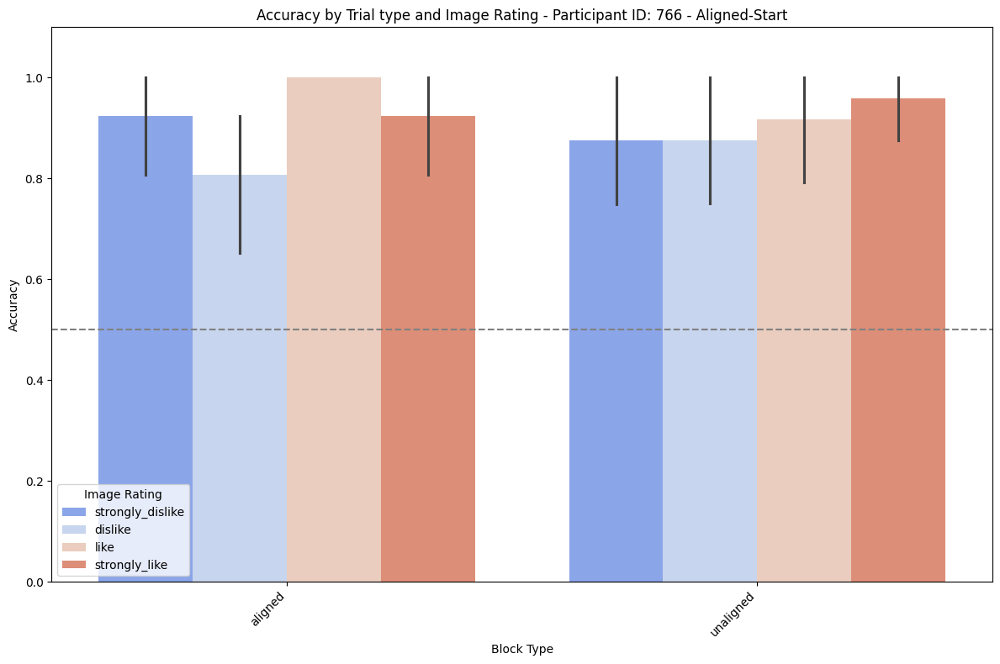

Data for participant 770:
Participant ID: 770

Accuracy in each 'Block':
Block
1    0.968750
2    0.666667
3    0.555556
4    0.375000
5    0.833333
6    0.611111
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.778846
unaligned    0.557692
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0006388322045089754

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.968750
            2        0.666667
            3        0.555556
            4        0.375000
            5        0.833333
            6        0.611111
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.615385
like                0.653846
strongly_dislike    0.673077
strongly_like       0.730769
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.653390550929500
Data for Chi-squared test:
Correct (Binary)  

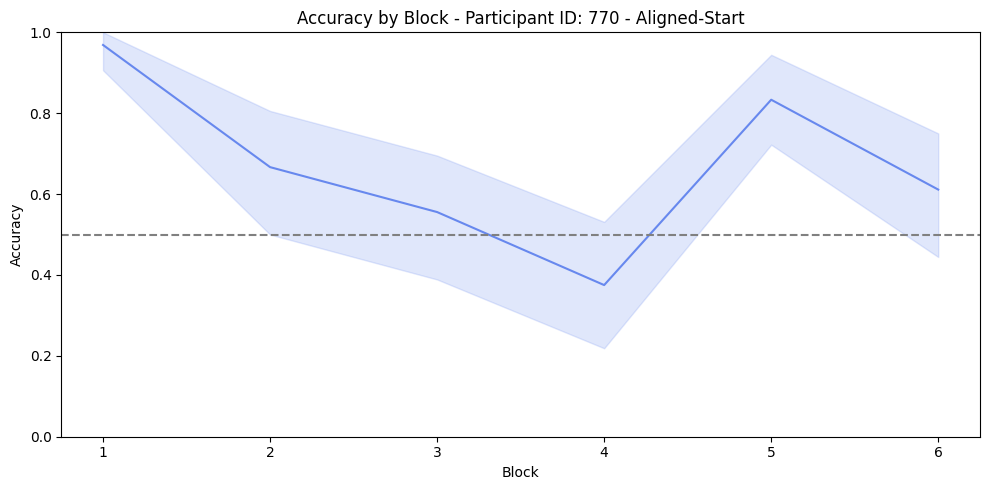

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


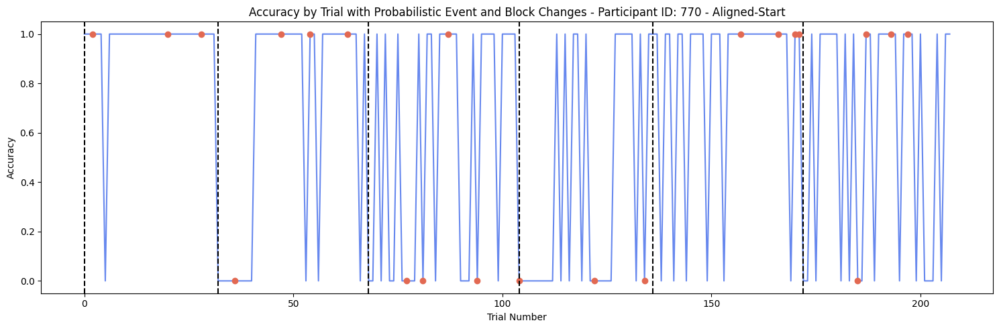

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


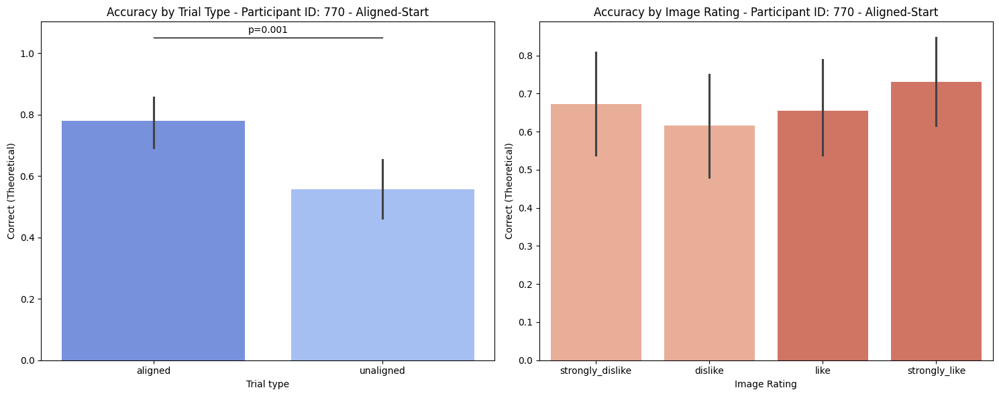

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).


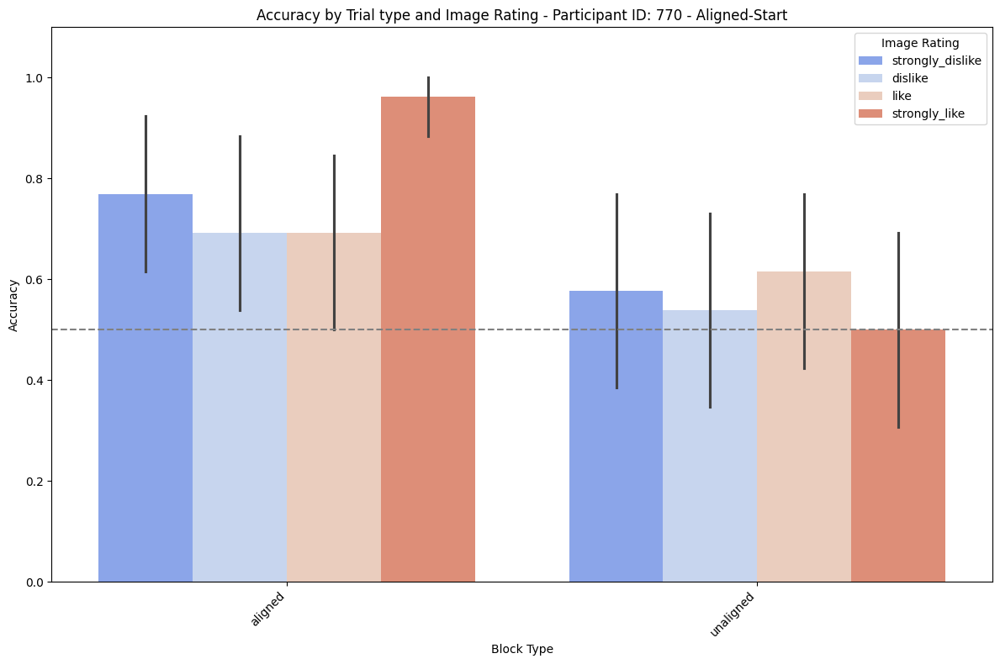

Data for participant 773:
Participant ID: 773

Accuracy in each 'Block':
Block
1    0.944444
2    0.444444
3    0.750000
4    0.444444
5    0.750000
6    0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.820000
unaligned    0.461538
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 4.025043244231886e-08

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.944444
            2        0.444444
            3        0.750000
            4        0.444444
            5        0.750000
            6        0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.568627
like                0.725490
strongly_dislike    0.607843
strongly_like       0.647059
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.396458327838646
Data for Chi-squared test:
Correct (Binary)  

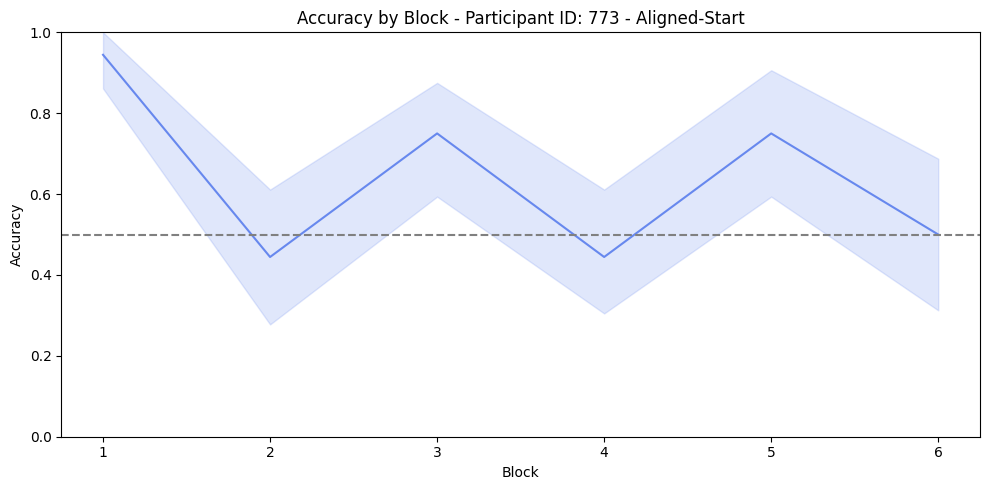

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


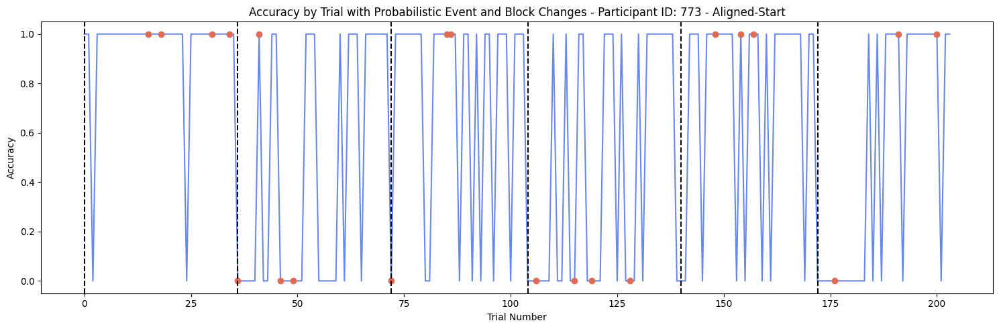

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


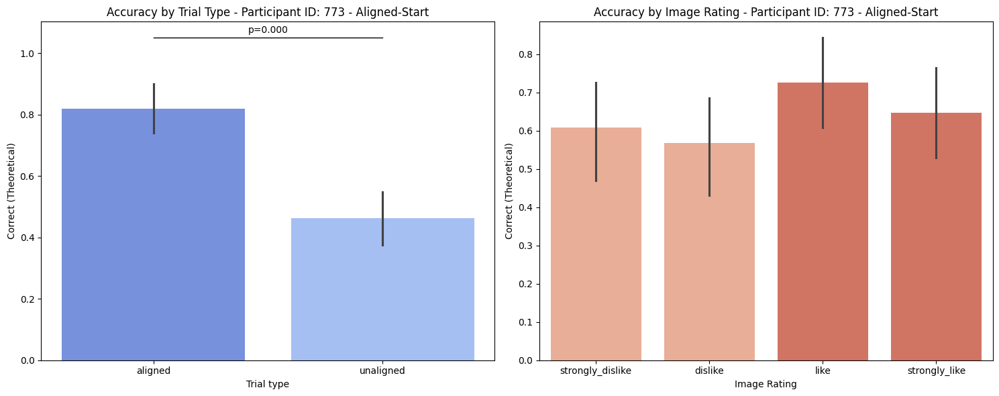

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).


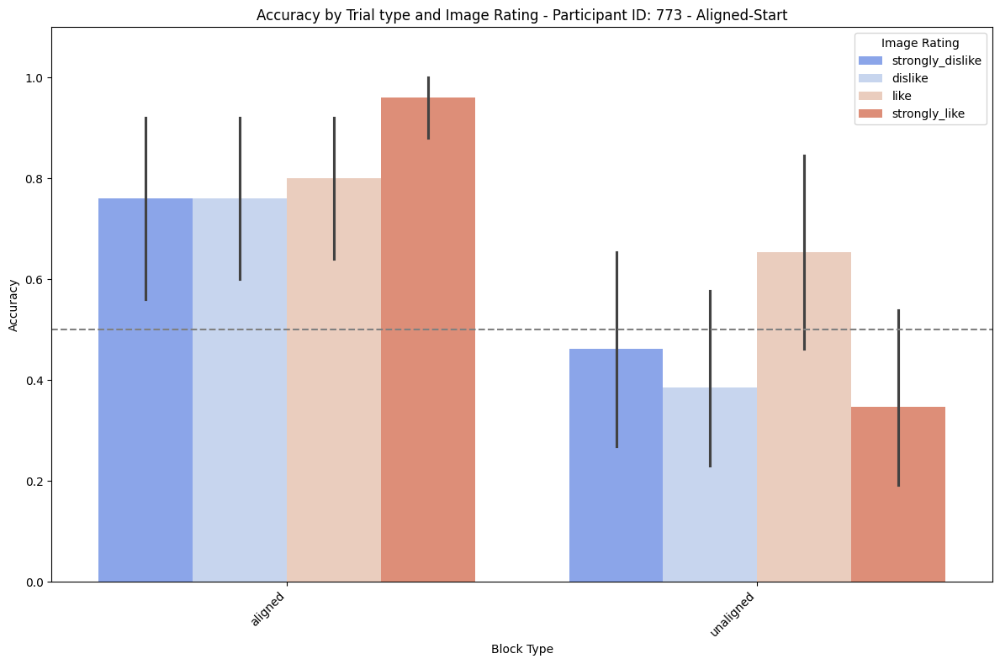

Data for participant 765:
Participant ID: 765

Accuracy in each 'Block':
Block
1    0.937500
2    0.656250
3    0.805556
4    0.718750
5    0.937500
6    0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.89
unaligned    0.75
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.010361731317686454

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.937500
            2        0.656250
            3        0.805556
            4        0.718750
            5        0.937500
            6        0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.795918
like                0.816327
strongly_dislike    0.775510
strongly_like       0.897959
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.409384632511556
Data for Chi-squared test:
Correct (Binary)   0   1
Im

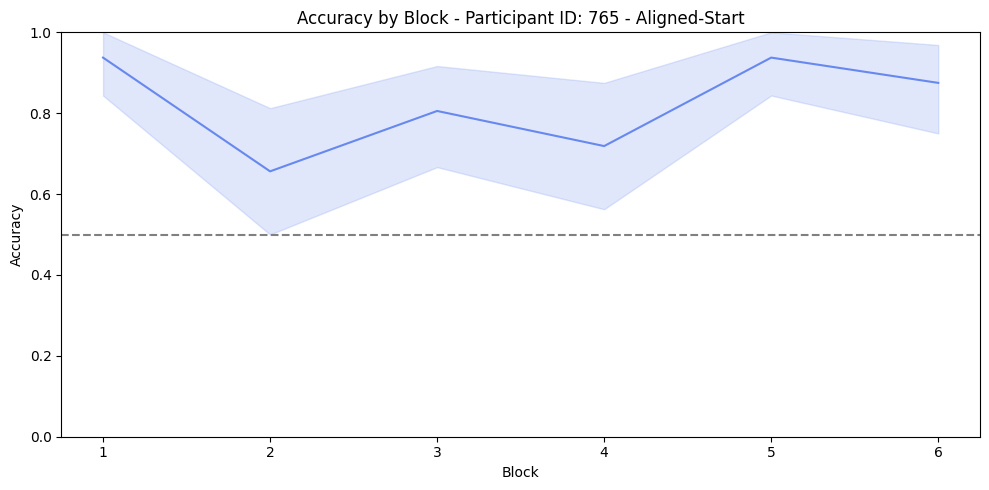

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


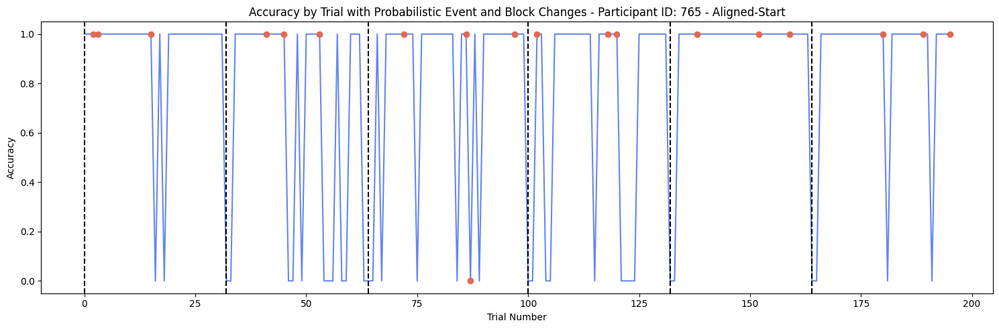

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


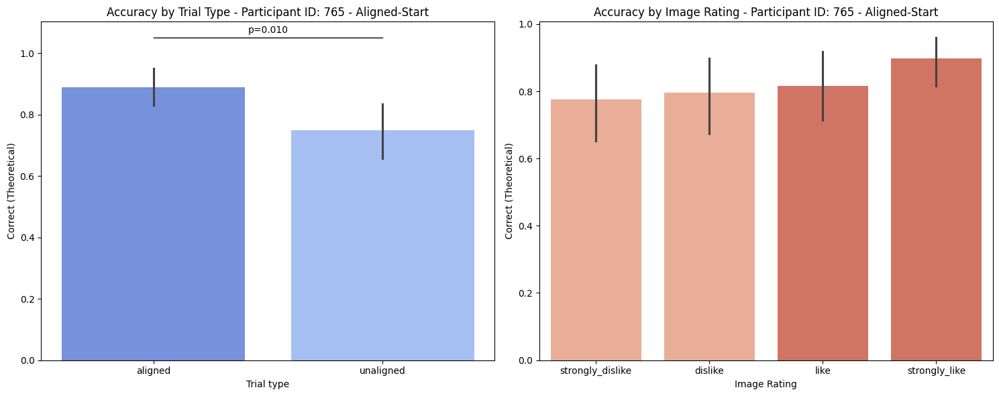

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.011).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.011).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


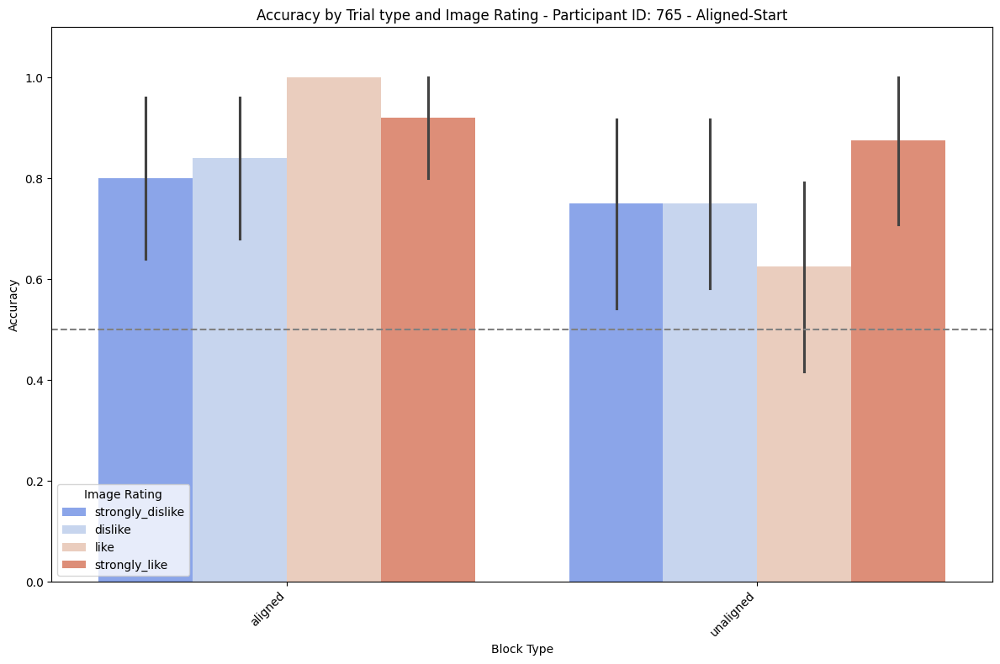

Data for participant 769:
Participant ID: 769

Accuracy in each 'Block':
Block
1    0.687500
2    0.375000
3    0.500000
4    0.312500
5    0.472222
6    0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.550
unaligned    0.375
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.013926568081395238

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.687500
            2        0.375000
            3        0.500000
            4        0.312500
            5        0.472222
            6        0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.428571
like                0.489796
strongly_dislike    0.469388
strongly_like       0.469388
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.942352984357646
Data for Chi-squared test:
Correct (Binary)   0   1


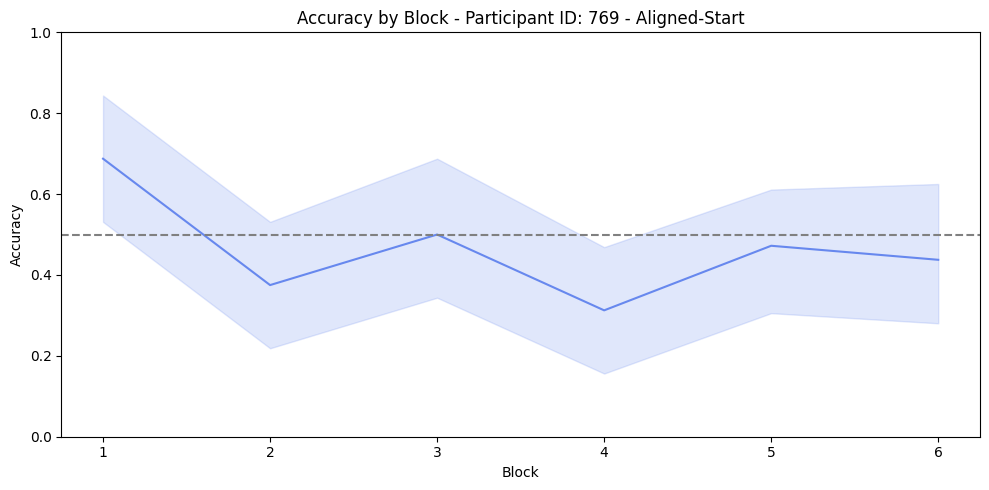

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


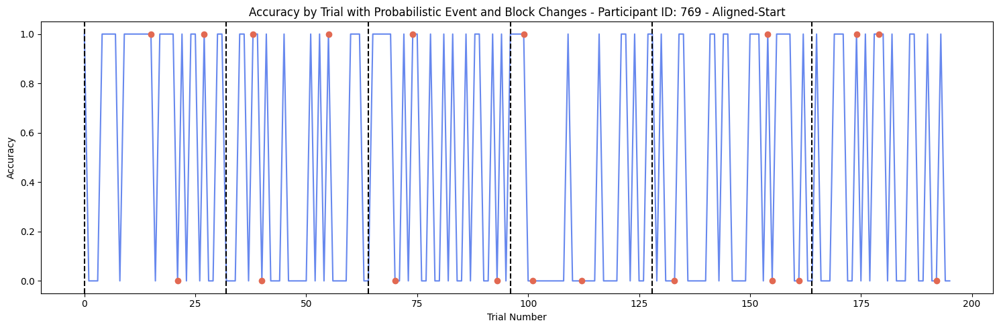

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


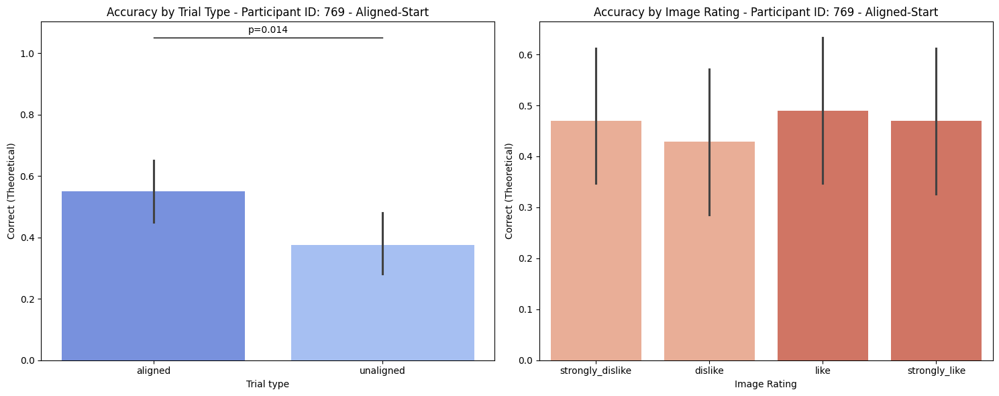

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.002).


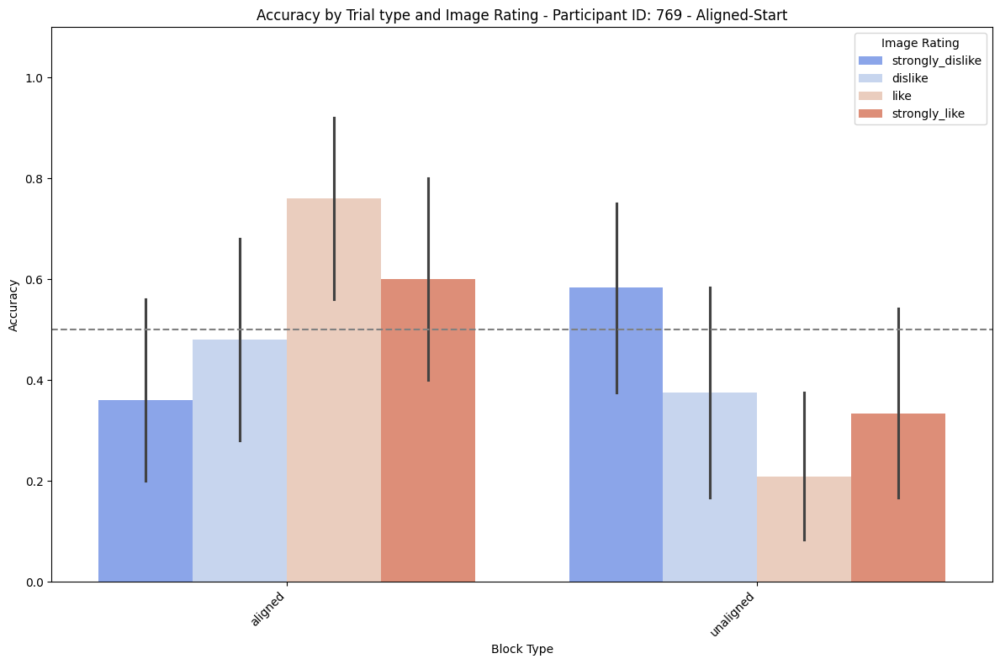

Data for participant 771:
Participant ID: 771

Accuracy in each 'Block':
Block
1    0.937500
2    0.777778
3    0.861111
4    0.812500
5    0.722222
6    0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.836538
unaligned    0.700000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.02054130420167222

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.937500
            2        0.777778
            3        0.861111
            4        0.812500
            5        0.722222
            6        0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.705882
like                0.764706
strongly_dislike    0.803922
strongly_like       0.803922
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.603624079289179
Data for Chi-squared test:
Correct (Binary)   0

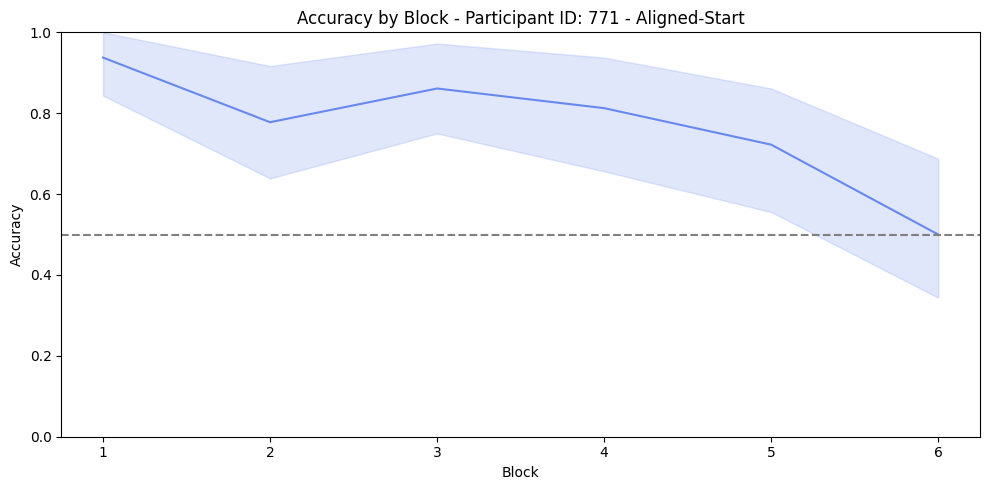

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


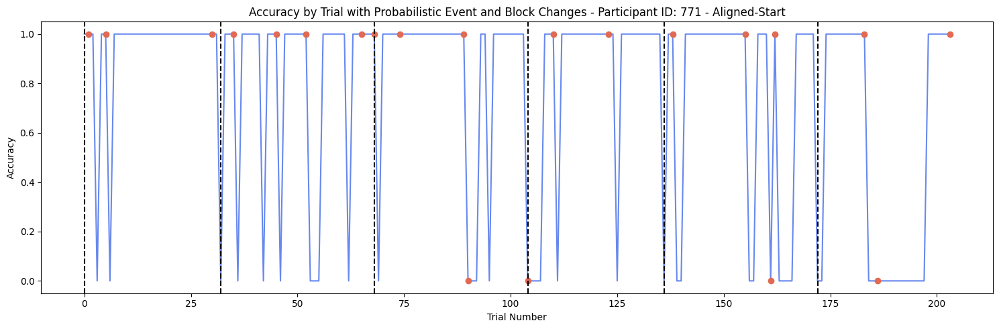

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


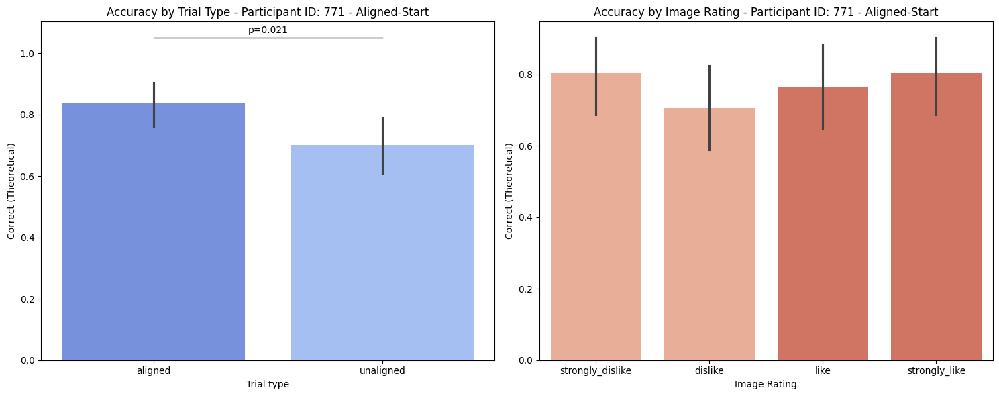

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.024).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


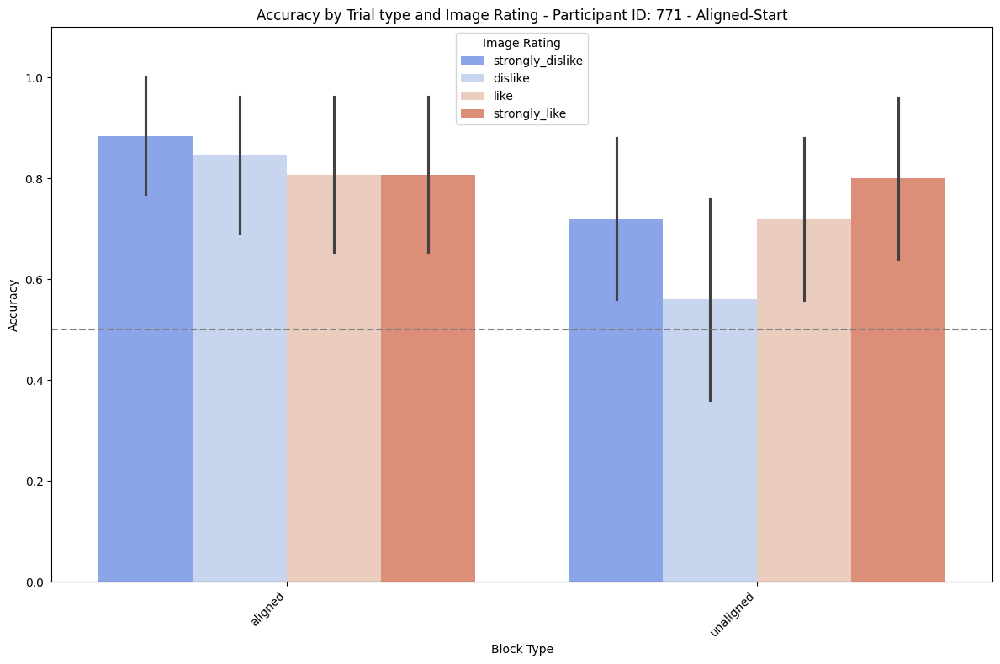

Data for participant 763:
Participant ID: 763

Accuracy in each 'Block':
Block
1    0.527778
2    0.375000
3    0.562500
4    0.437500
5    0.625000
6    0.388889
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.57
unaligned    0.40
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.01605171239068194

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.527778
            2        0.375000
            3        0.562500
            4        0.437500
            5        0.625000
            6        0.388889
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.52
like                0.44
strongly_dislike    0.46
strongly_like       0.52
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.796190395860542
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating       

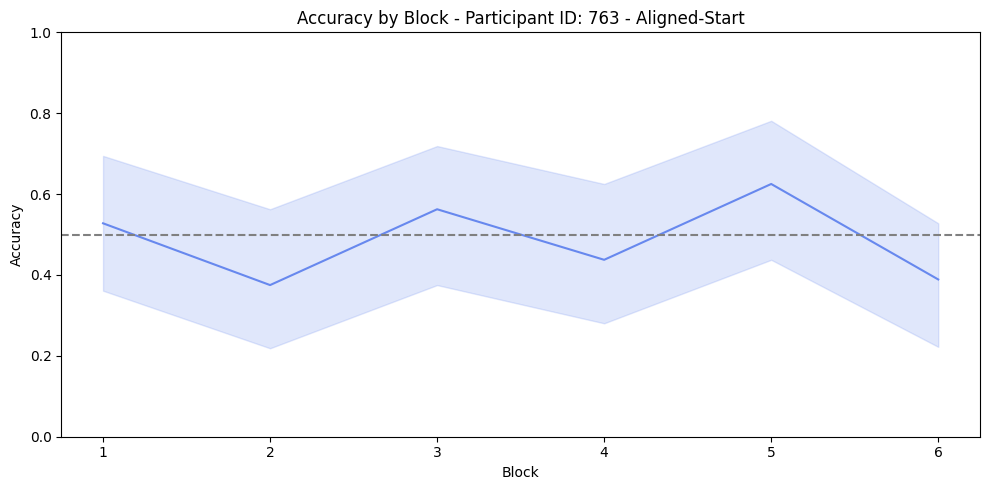

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


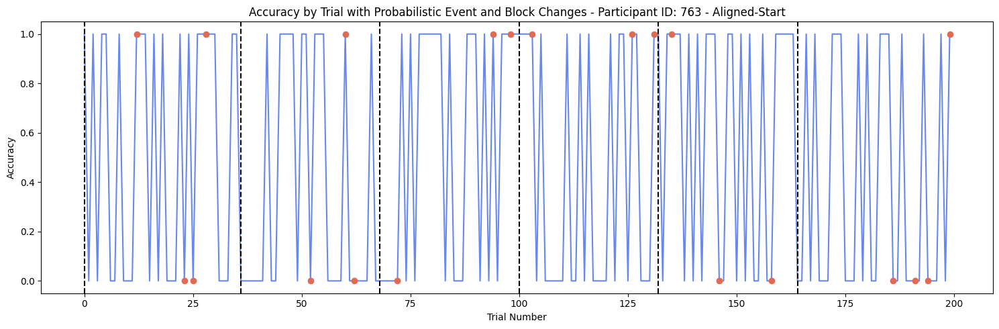

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


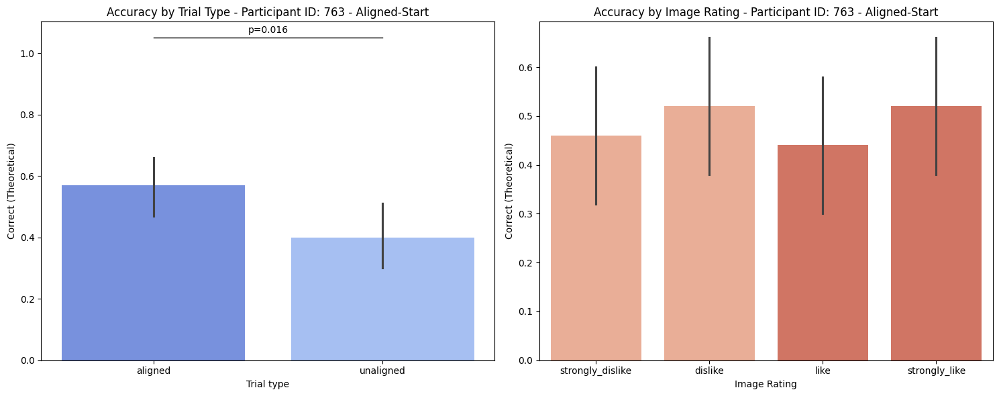

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


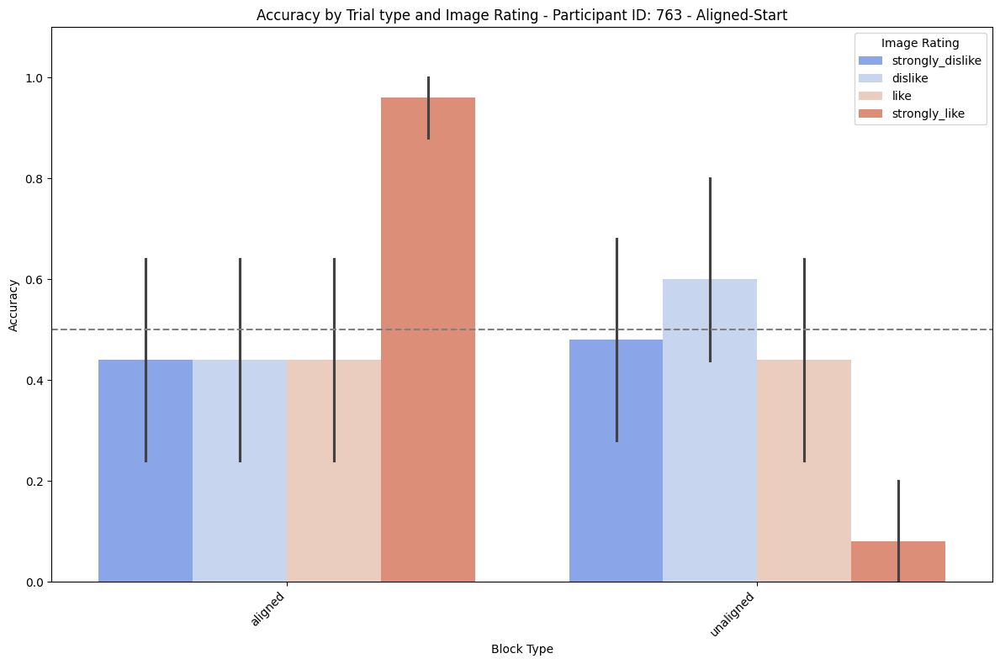

Data for participant 764:
Participant ID: 764

Accuracy in each 'Block':
Block
1    0.906250
2    0.437500
3    0.861111
4    0.305556
5    0.843750
6    0.277778
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.870000
unaligned    0.336538
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 4.1945984116007466e-17

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.906250
            2        0.437500
            3        0.861111
            4        0.305556
            5        0.843750
            6        0.277778
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.607843
like                0.568627
strongly_dislike    0.588235
strongly_like       0.627451
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.938618866184114
Data for Chi-squared test:
Correct (Binary) 

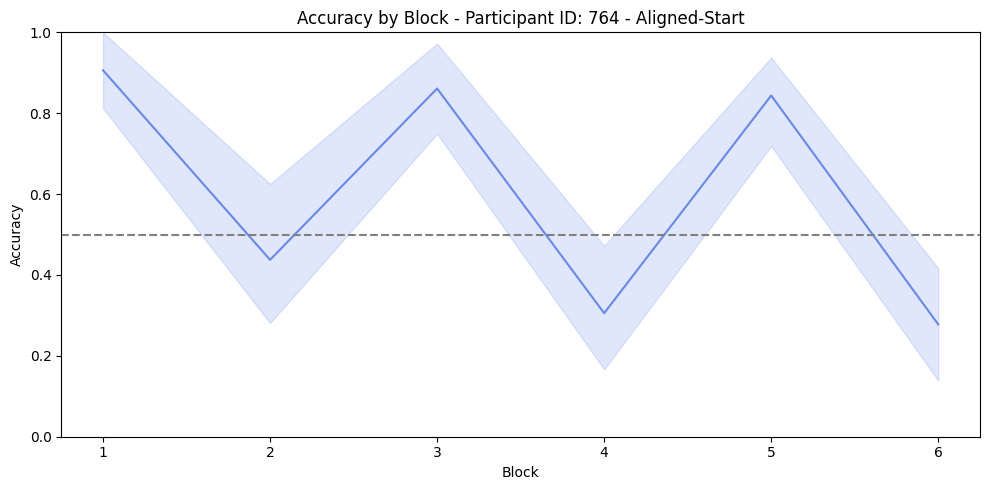

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


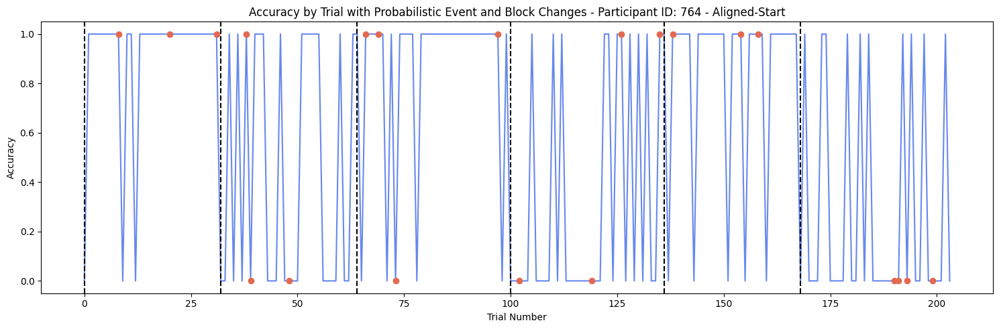

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


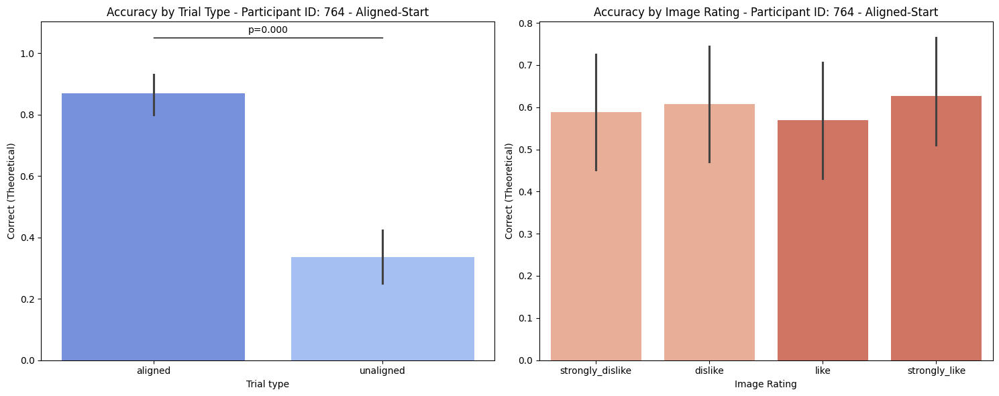

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.048).


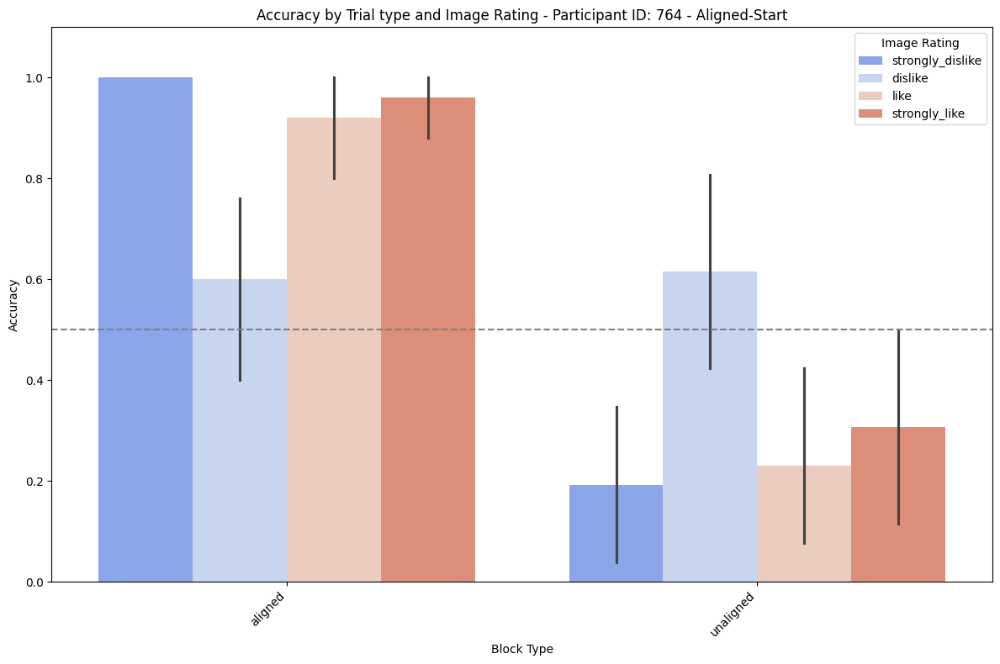

Data for participant 758:
Participant ID: 758

Accuracy in each 'Block':
Block
1    0.843750
2    0.444444
3    0.750000
4    0.843750
5    0.781250
6    0.937500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.791667
unaligned    0.730000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.31457744324165565

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.843750
            2        0.444444
            3        0.750000
            4        0.843750
            5        0.781250
            6        0.937500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.734694
like                0.693878
strongly_dislike    0.836735
strongly_like       0.775510
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.392440497857117
Data for Chi-squared test:
Correct (Binary)   0

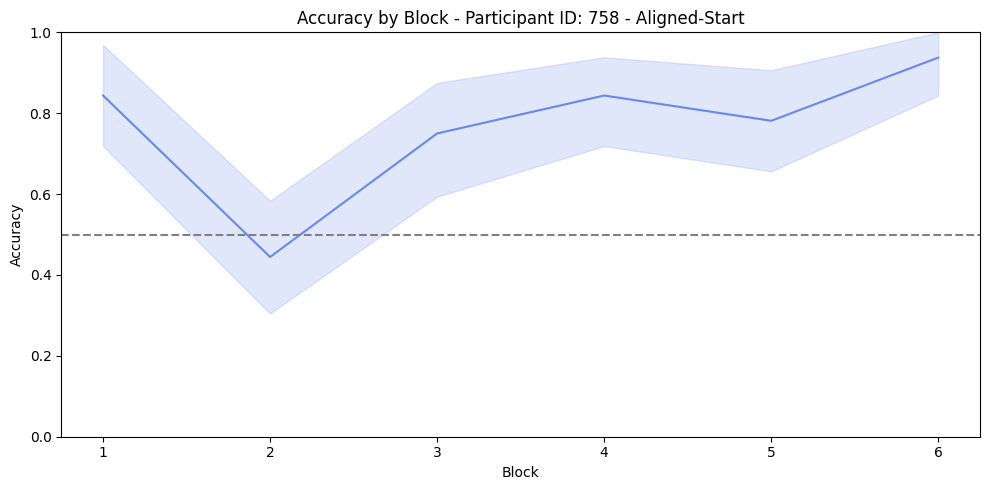

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


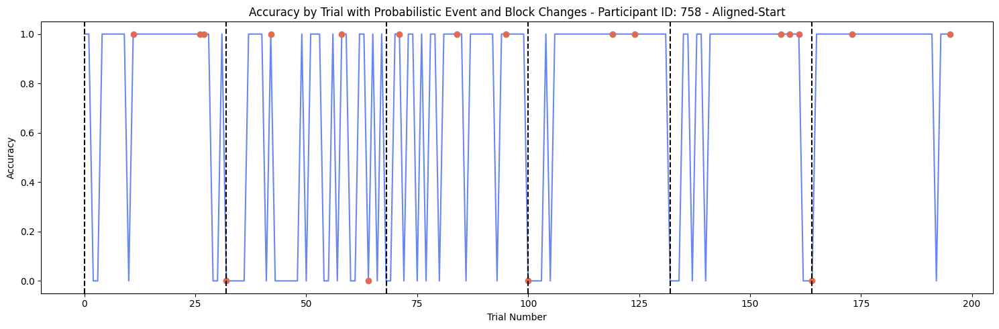

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


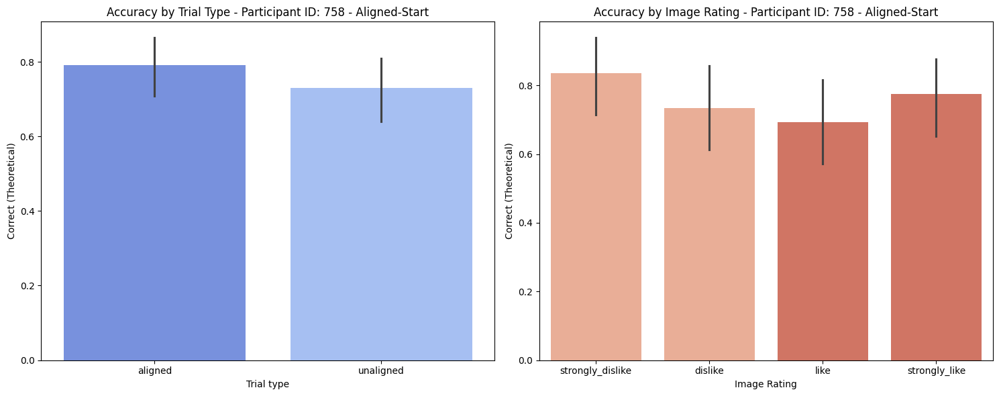

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.038).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.024).


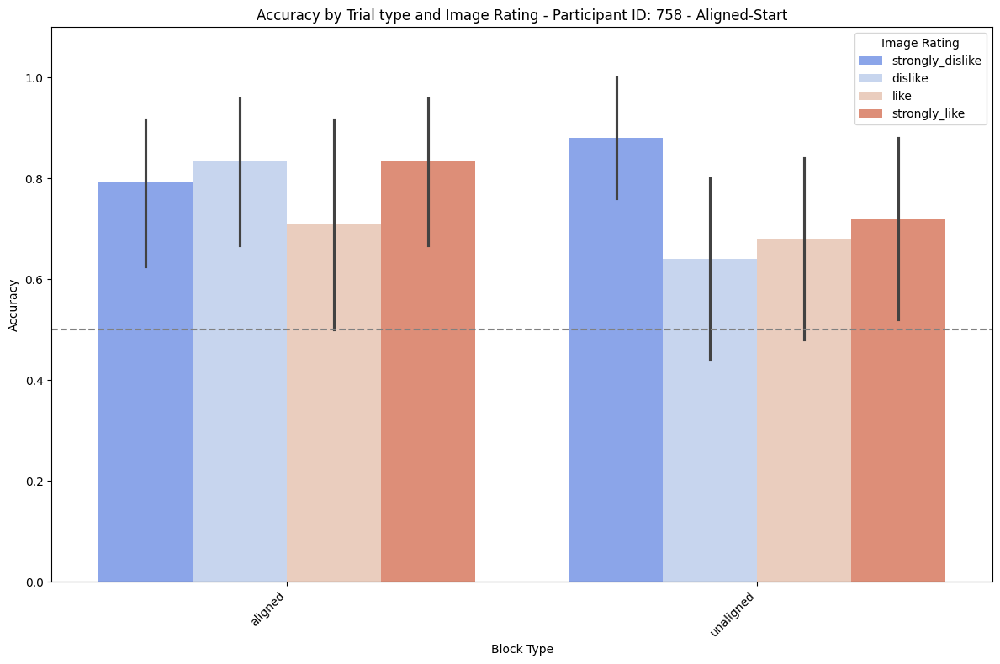

Data for participant 782:
Participant ID: 782

Accuracy in each 'Block':
Block
1    0.750000
2    0.555556
3    0.468750
4    0.437500
5    0.555556
6    0.777778
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.590000
unaligned    0.596154
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.929165895346997

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.750000
            2        0.555556
            3        0.468750
            4        0.437500
            5        0.555556
            6        0.777778
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.607843
like                0.549020
strongly_dislike    0.588235
strongly_like       0.627451
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.870627089459169
Data for Chi-squared test:
Correct (Binary)   0  

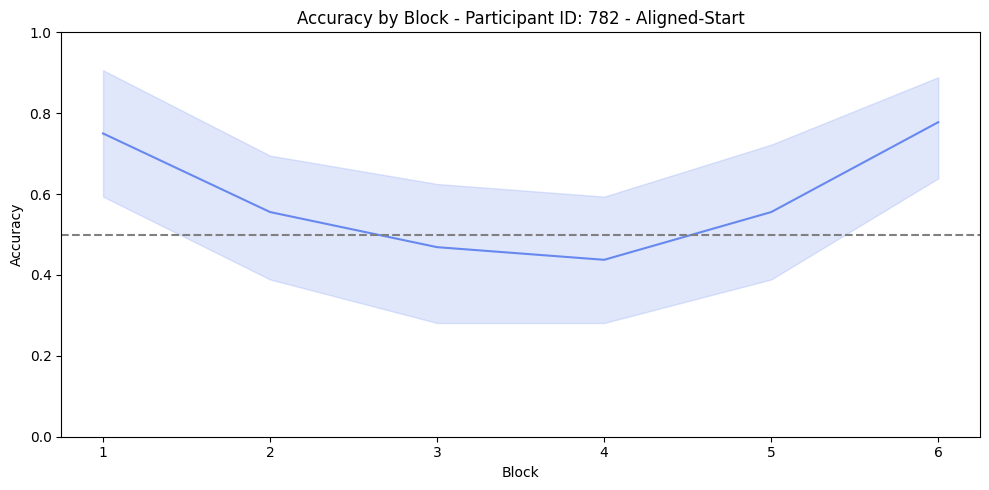

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


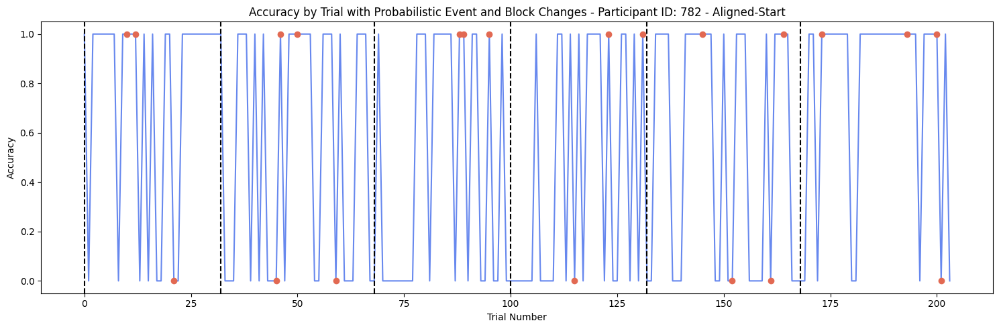

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


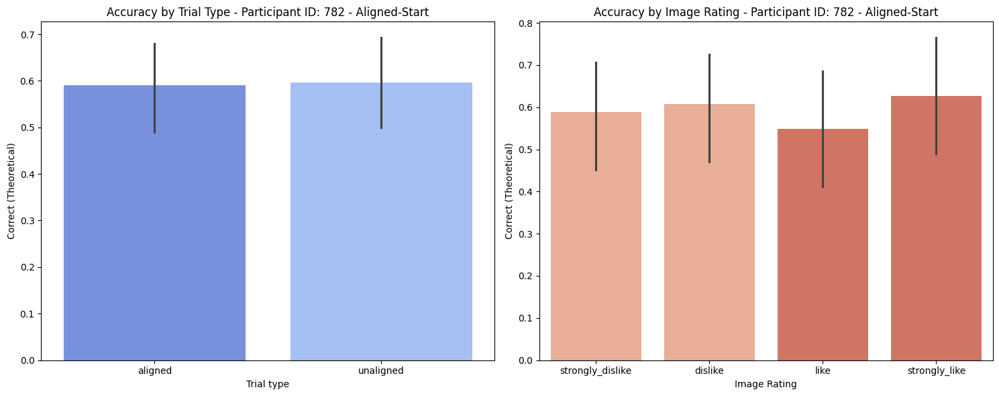

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


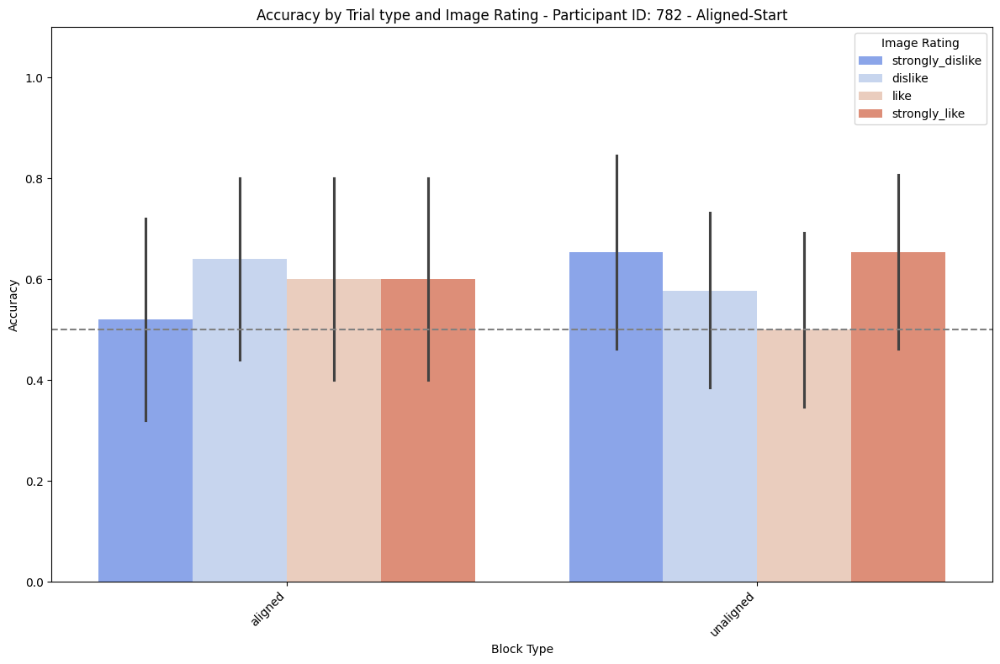

Data for participant 777:
Participant ID: 777

Accuracy in each 'Block':
Block
1    0.472222
2    0.468750
3    0.500000
4    0.500000
5    0.468750
6    0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.480000
unaligned    0.519231
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.5775330961314609

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.472222
            2        0.468750
            3        0.500000
            4        0.500000
            5        0.468750
            6        0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.549020
like                0.529412
strongly_dislike    0.450980
strongly_like       0.470588
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.721233374627760
Data for Chi-squared test:
Correct (Binary)   0 

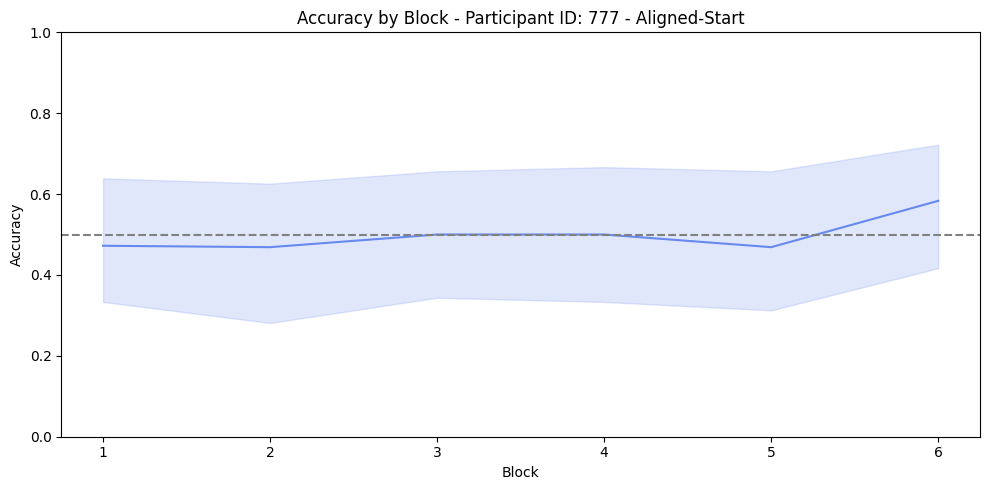

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


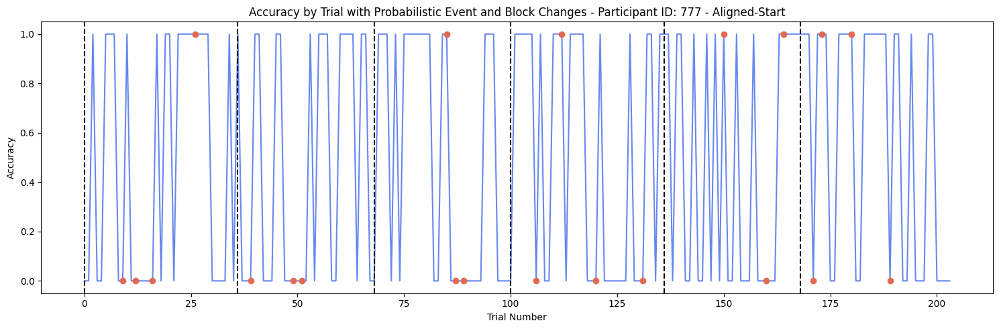

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


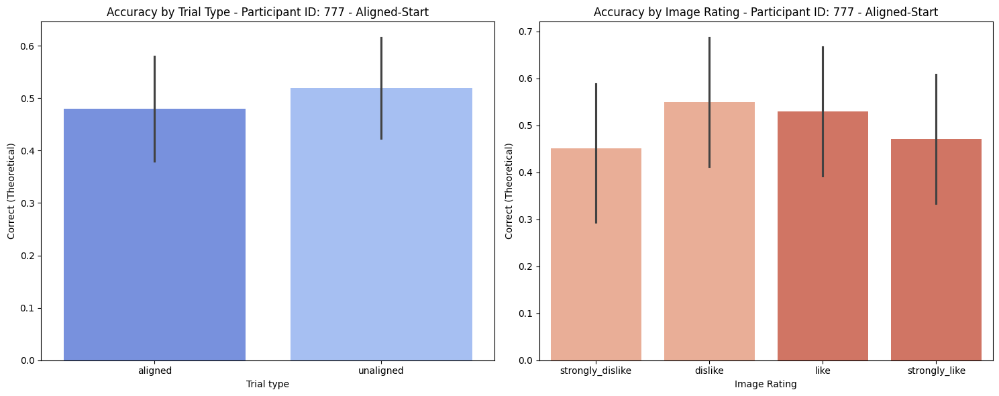

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.048).


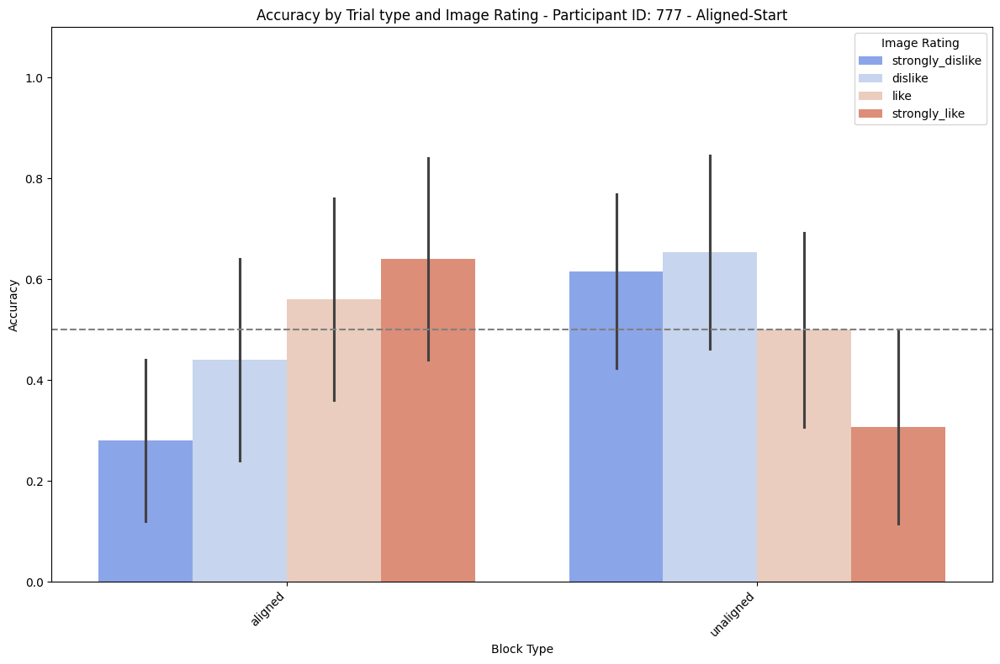

Data for participant 778:
Participant ID: 778

Accuracy in each 'Block':
Block
1    0.625000
2    0.531250
3    0.531250
4    0.593750
5    0.555556
6    0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.570000
unaligned    0.541667
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.6916373859581637

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.625000
            2        0.531250
            3        0.531250
            4        0.593750
            5        0.555556
            6        0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.510204
like                0.551020
strongly_dislike    0.591837
strongly_like       0.571429
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.867686770705629
Data for Chi-squared test:
Correct (Binary)   0 

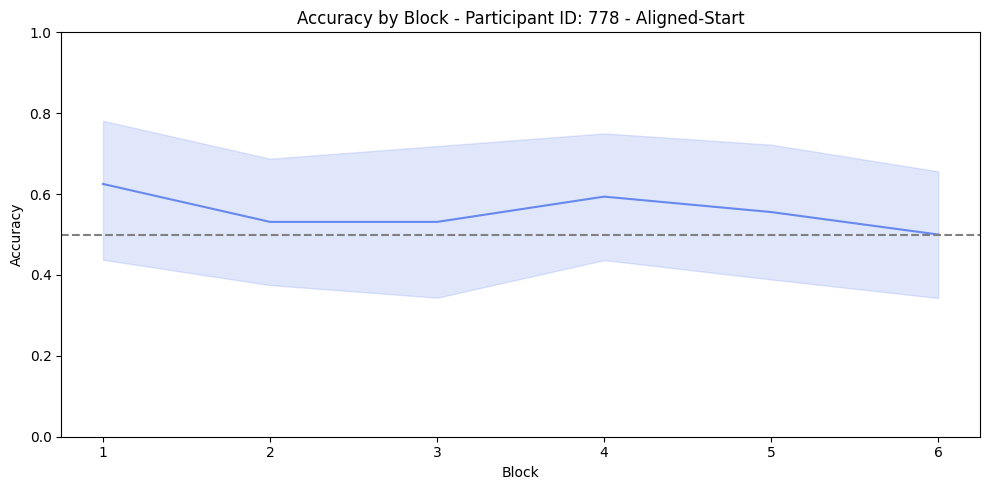

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


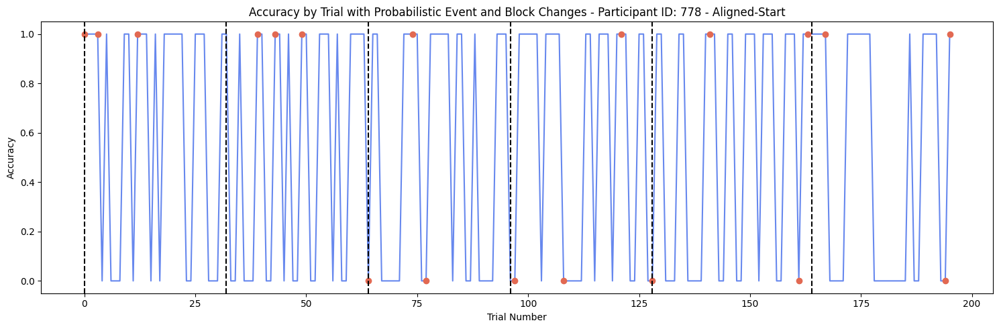

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


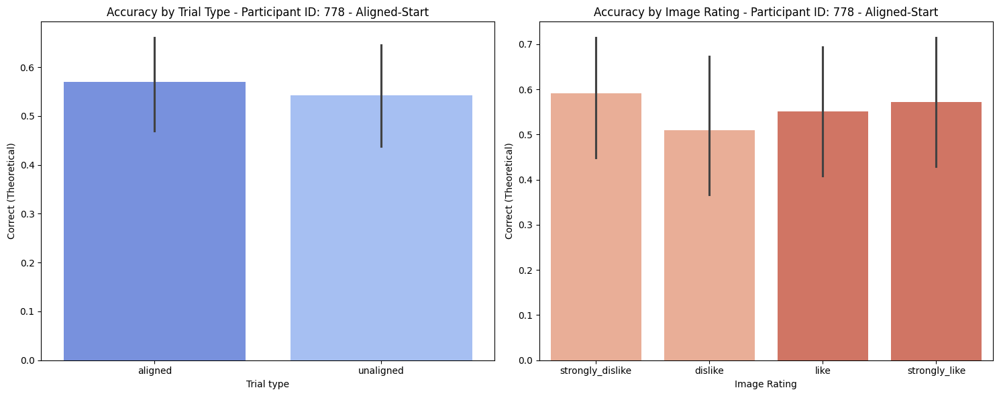

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


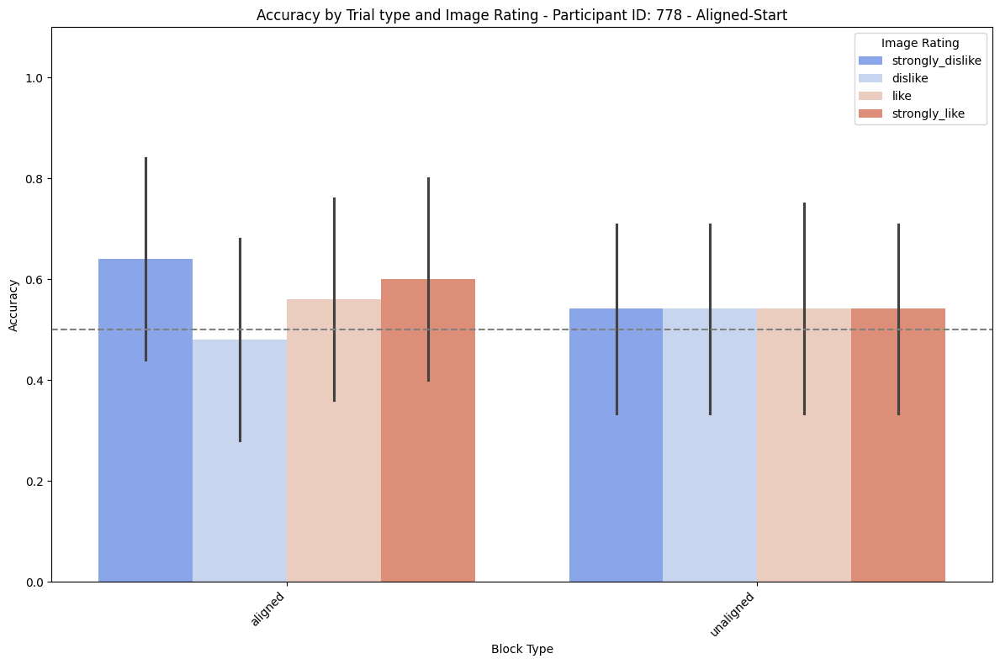

Data for participant 785:
Participant ID: 785

Accuracy in each 'Block':
Block
1    0.666667
2    0.694444
3    0.781250
4    0.656250
5    0.722222
6    0.531250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.721154
unaligned    0.630000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.16575688608405417

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.666667
            2        0.694444
            3        0.781250
            4        0.656250
            5        0.722222
            6        0.531250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.686275
like                0.627451
strongly_dislike    0.666667
strongly_like       0.725490
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.761484867079329
Data for Chi-squared test:
Correct (Binary)   0

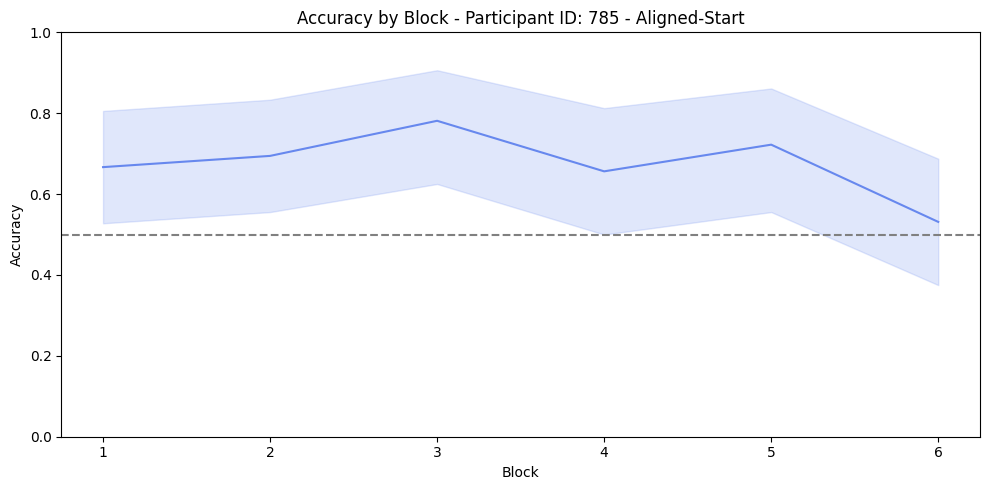

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


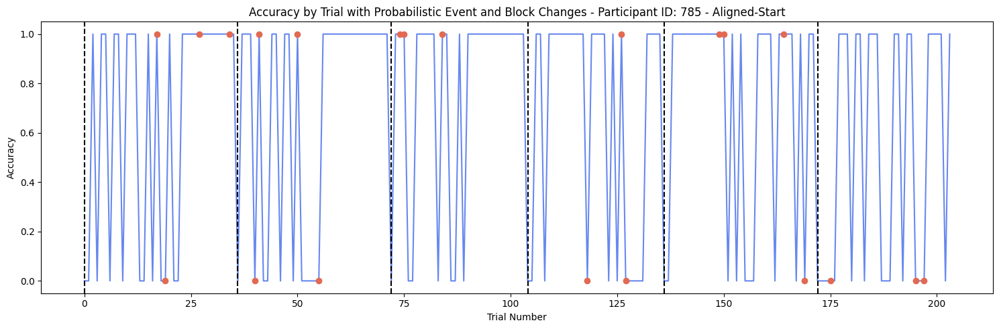

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


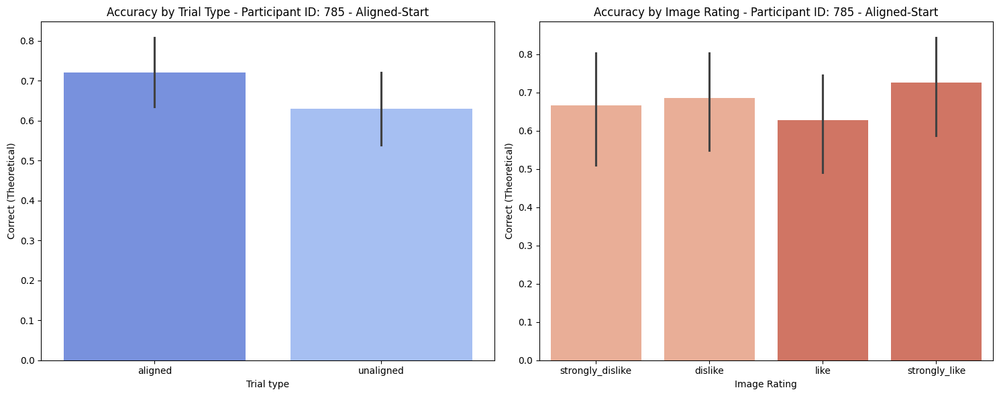

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.024).


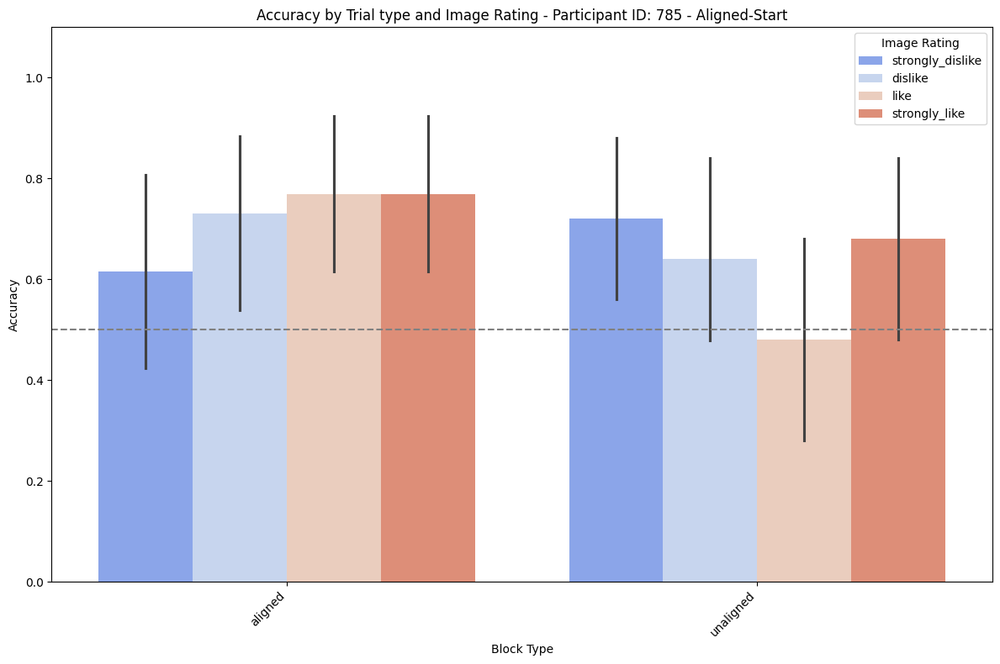

Data for participant 783:
Participant ID: 783

Accuracy in each 'Block':
Block
1    0.694444
2    0.750000
3    0.781250
4    0.916667
5    0.718750
6    0.843750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.73
unaligned    0.84
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.05876227491679709

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.694444
            2        0.750000
            3        0.781250
            4        0.916667
            5        0.718750
            6        0.843750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.72
like                0.84
strongly_dislike    0.82
strongly_like       0.76
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.440925022915593
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating       

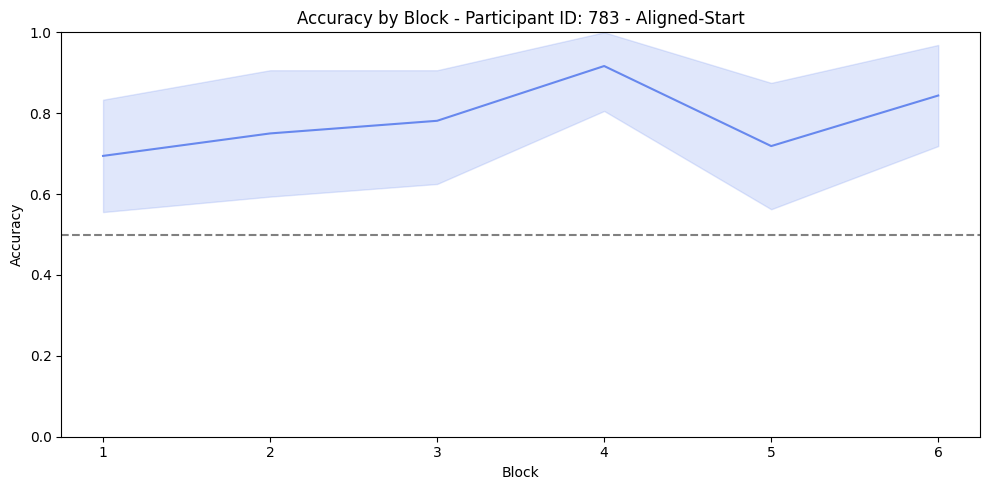

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


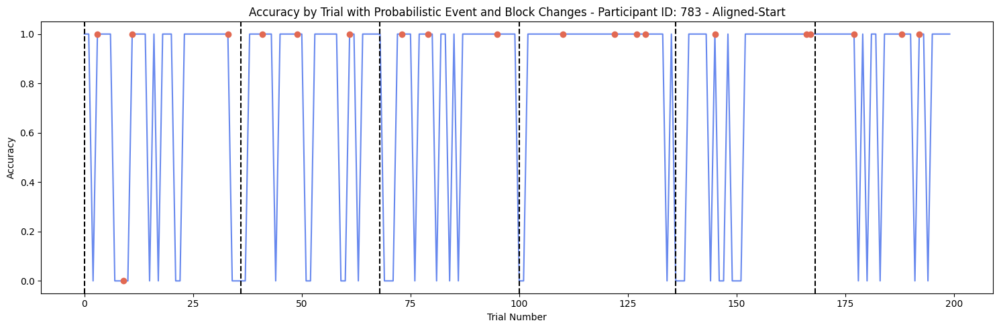

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


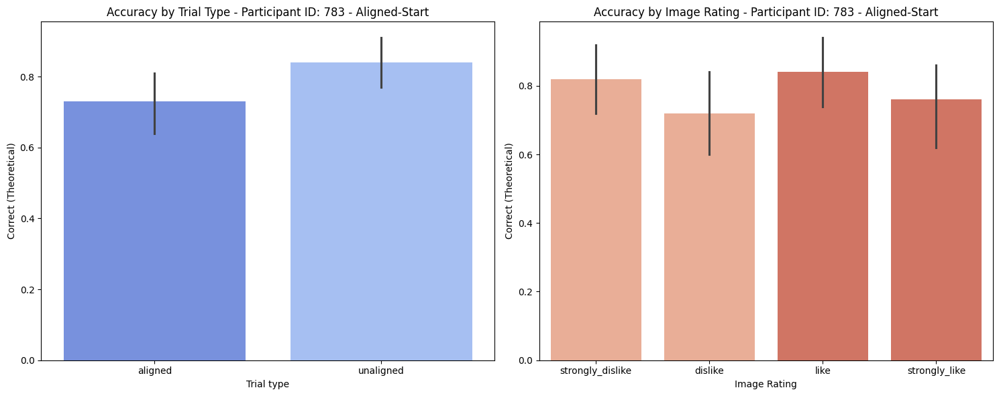

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


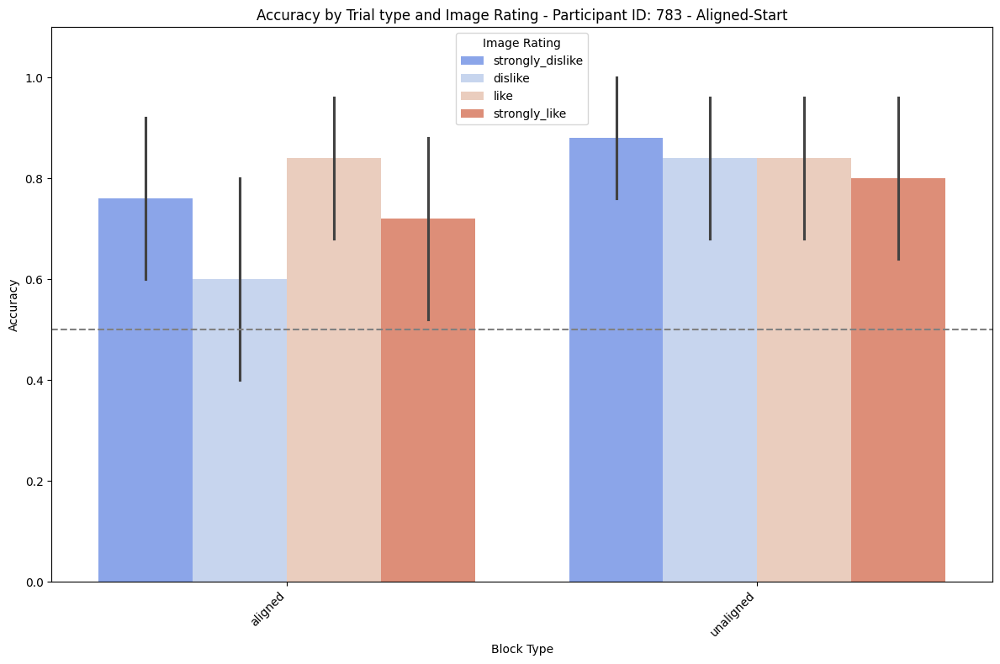

Data for participant 774:
Participant ID: 774

Accuracy in each 'Block':
Block
1    0.750000
2    0.472222
3    0.812500
4    0.312500
5    0.468750
6    0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.680000
unaligned    0.451923
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0009396805313737183

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.750000
            2        0.472222
            3        0.812500
            4        0.312500
            5        0.468750
            6        0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.549020
like                0.627451
strongly_dislike    0.549020
strongly_like       0.529412
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.758774521271278
Data for Chi-squared test:
Correct (Binary)  

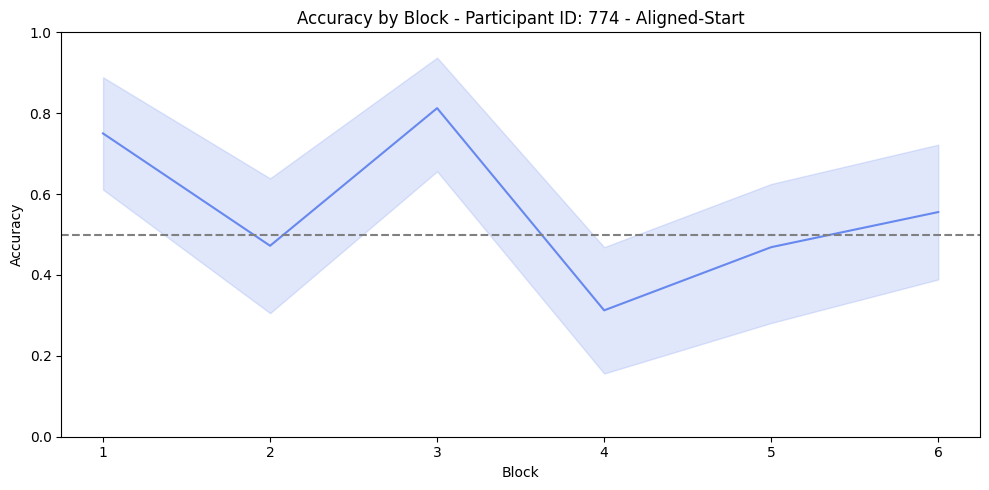

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


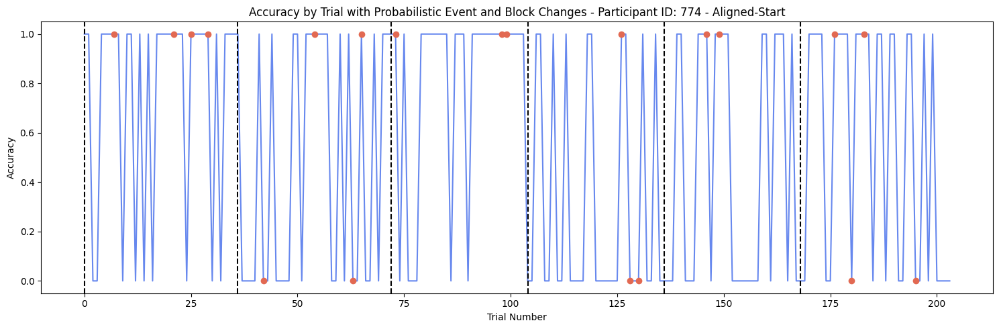

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


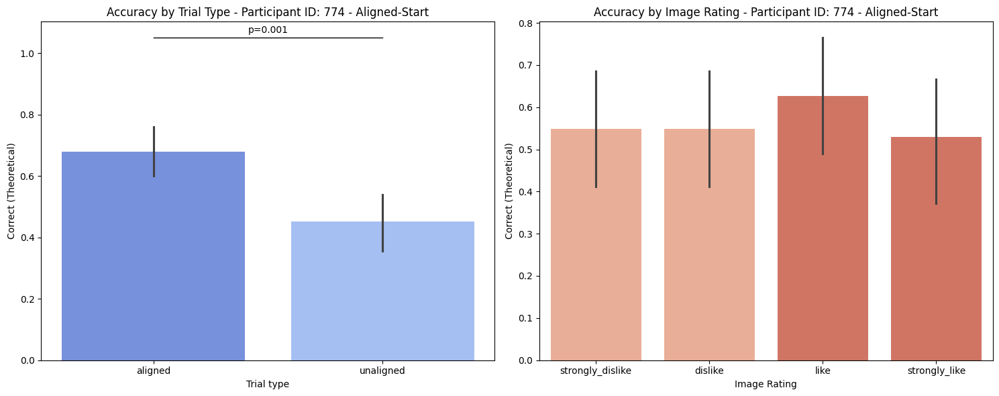

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.024).


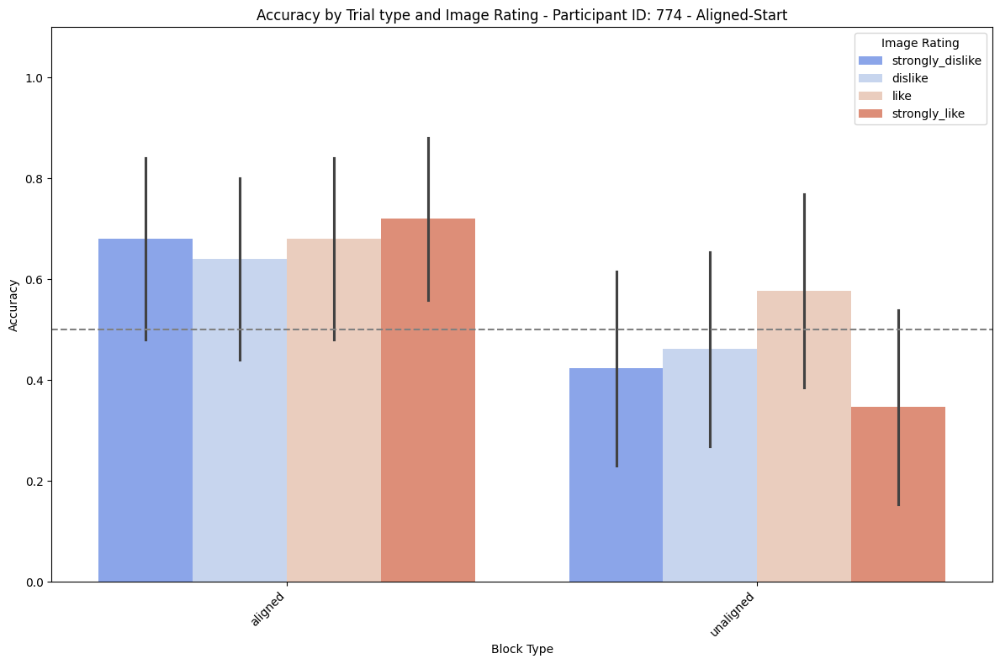

Data for participant 780:
Participant ID: 780

Accuracy in each 'Block':
Block
1    0.937500
2    0.861111
3    0.843750
4    0.861111
5    0.888889
6    0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.890
unaligned    0.875
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.7410844878534486

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.937500
            2        0.861111
            3        0.843750
            4        0.861111
            5        0.888889
            6        0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.862745
like                0.901961
strongly_dislike    0.862745
strongly_like       0.901961
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.860065284244203
Data for Chi-squared test:
Correct (Binary)  0   1
Ima

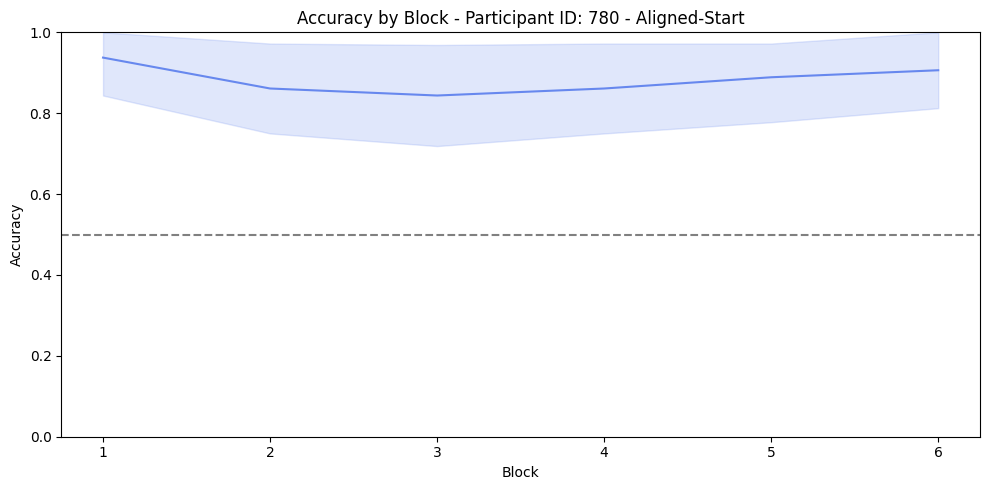

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


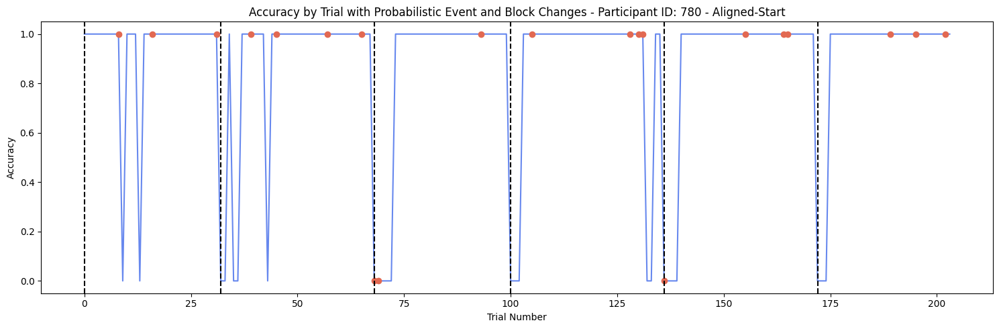

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


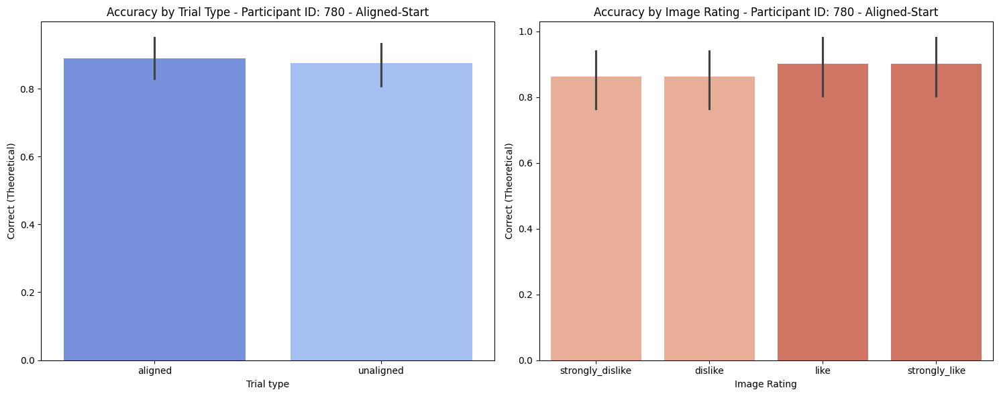

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


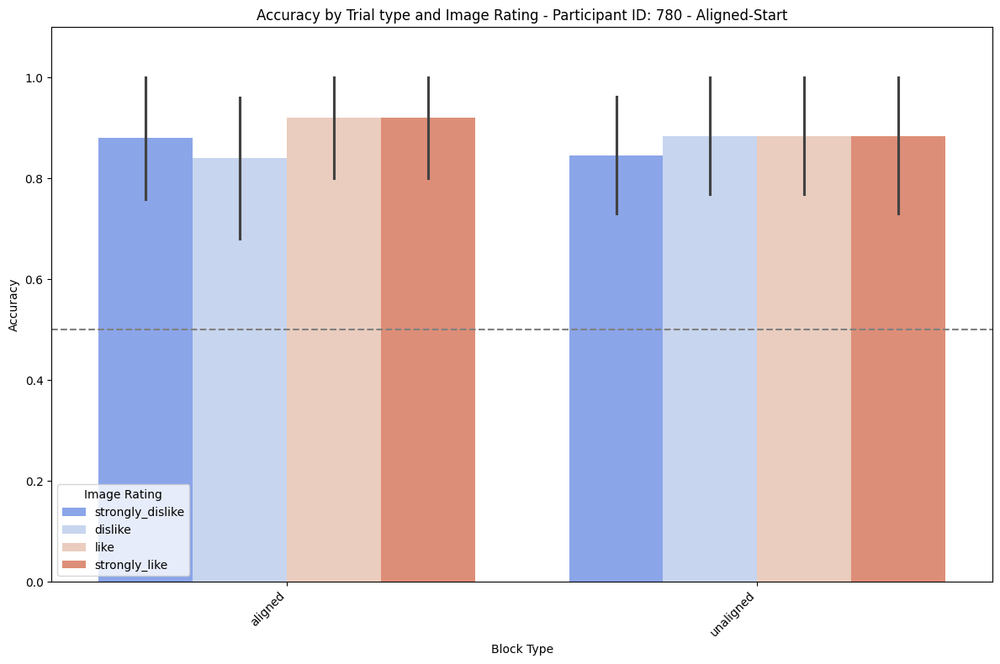

Data for participant 776:
Participant ID: 776

Accuracy in each 'Block':
Block
1    0.833333
2    0.625000
3    0.812500
4    0.781250
5    0.805556
6    0.781250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.817308
unaligned    0.729167
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.13724542603262146

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.833333
            2        0.625000
            3        0.812500
            4        0.781250
            5        0.805556
            6        0.781250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.80
like                0.76
strongly_dislike    0.74
strongly_like       0.80
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.855629109045688
Data for Chi-squared test:
Correct (Binary)   0   1
Image Ratin

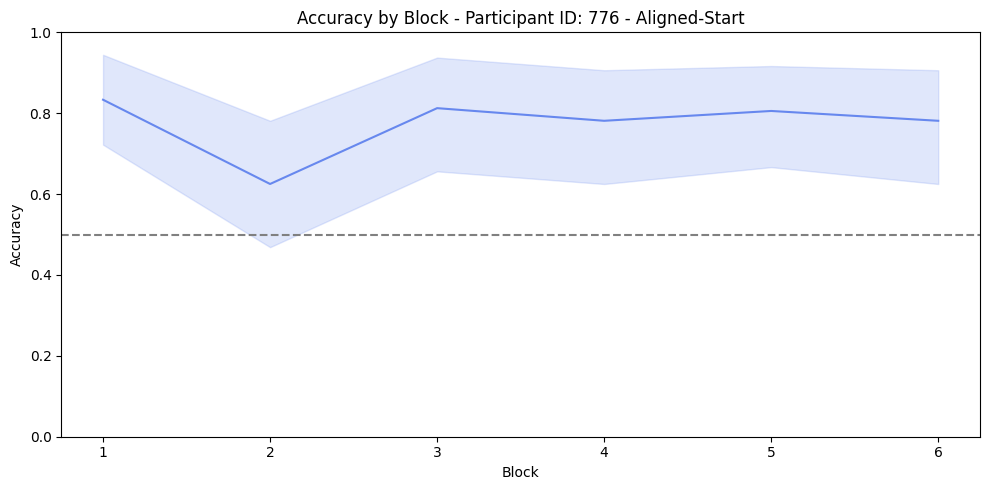

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


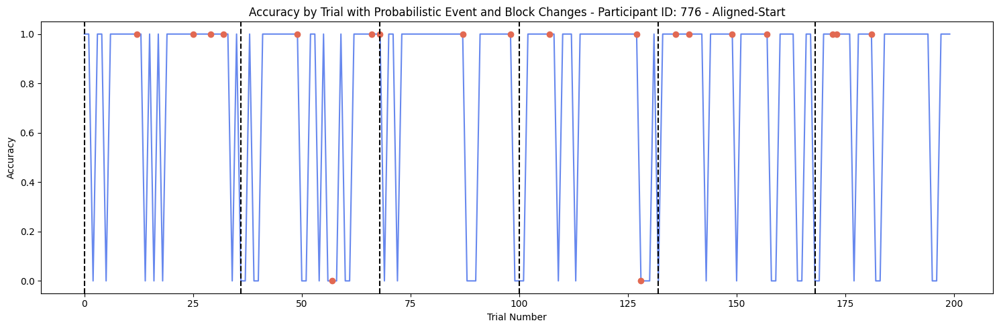

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


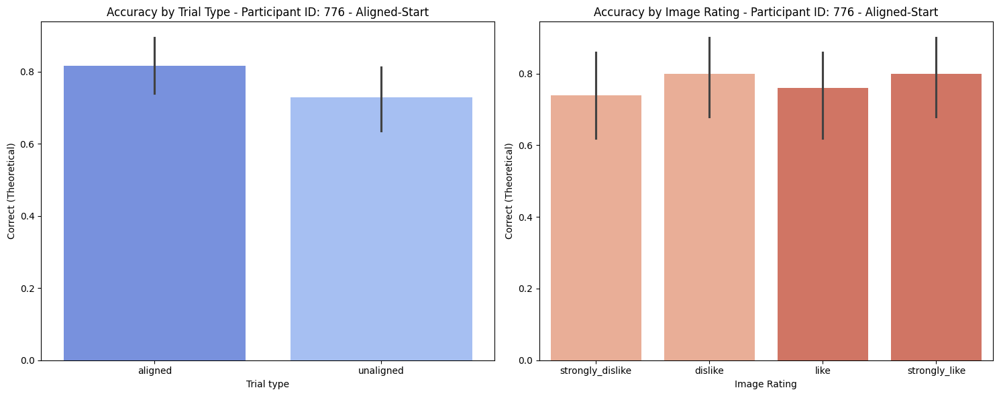

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).


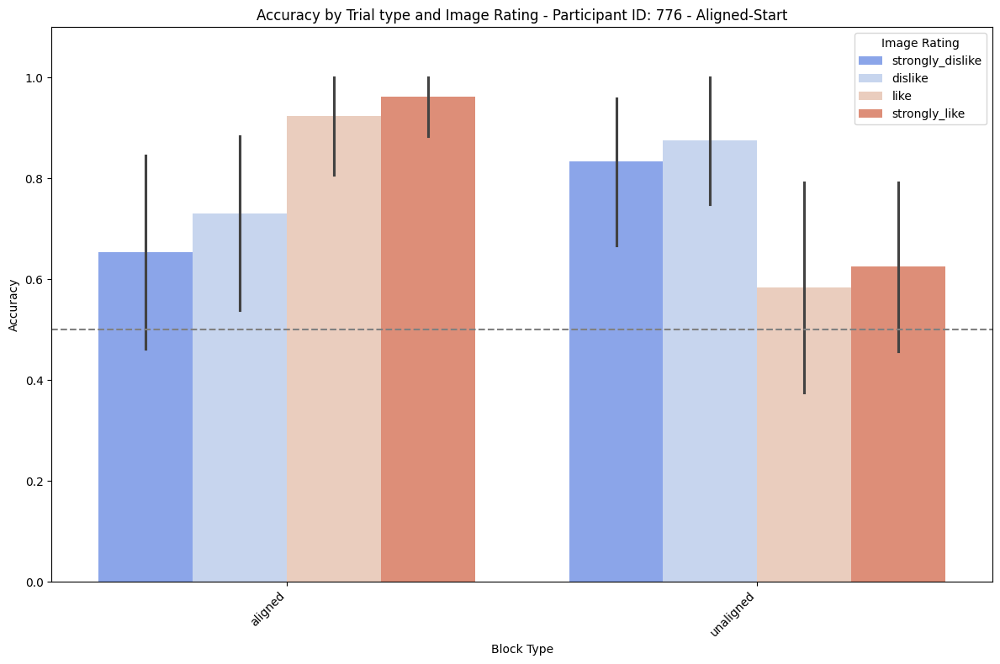

Data for participant 775:
Participant ID: 775

Accuracy in each 'Block':
Block
1    0.833333
2    0.593750
3    0.805556
4    0.750000
5    0.916667
6    0.666667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.851852
unaligned    0.673077
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.0020582215980832165

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.833333
            2        0.593750
            3        0.805556
            4        0.750000
            5        0.916667
            6        0.666667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.792453
like                0.716981
strongly_dislike    0.716981
strongly_like       0.830189
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.419128901556827
Data for Chi-squared test:
Correct (Binary)  

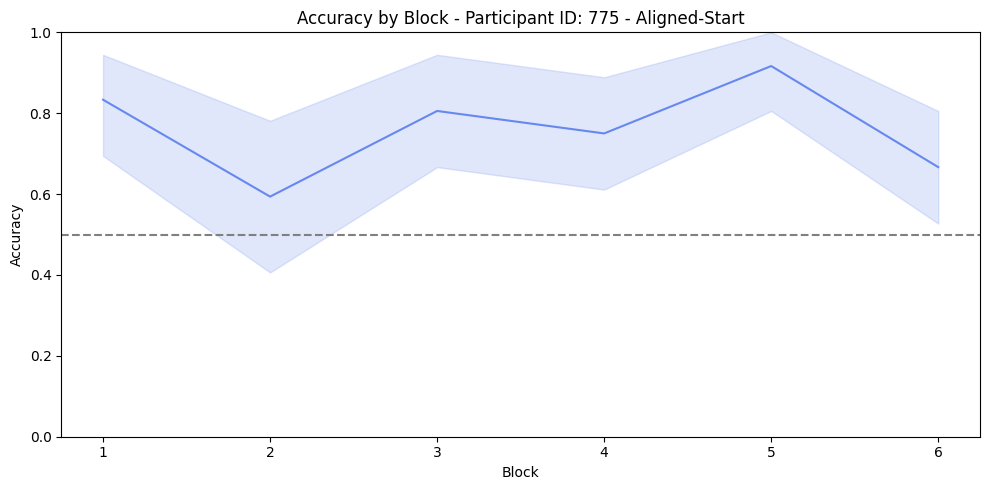

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


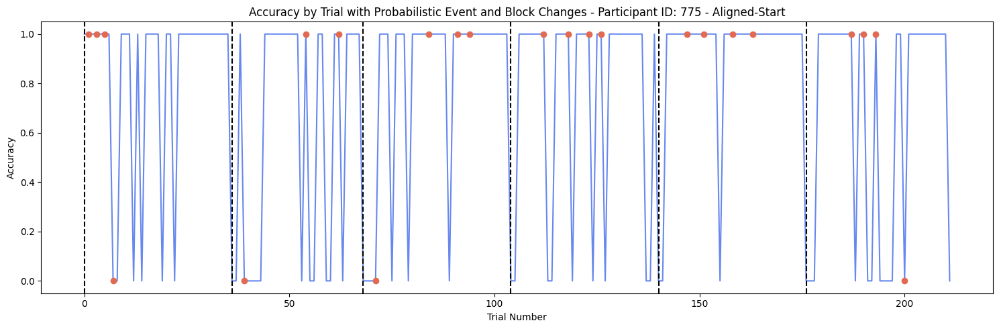

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


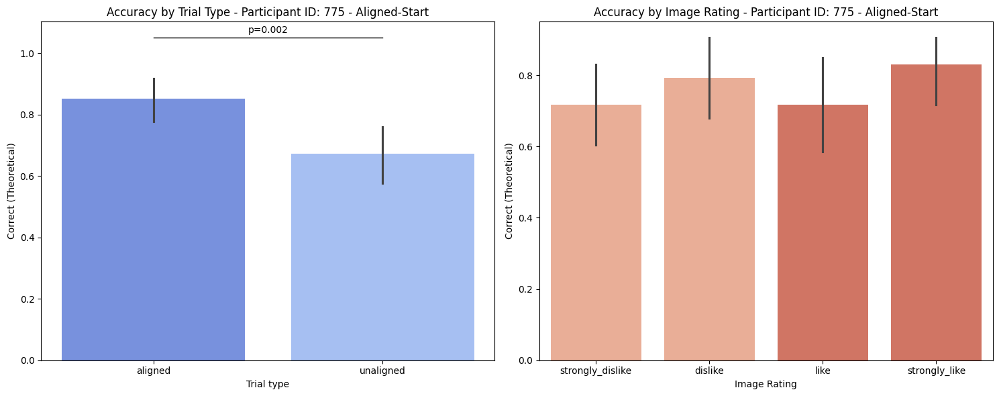

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.015).


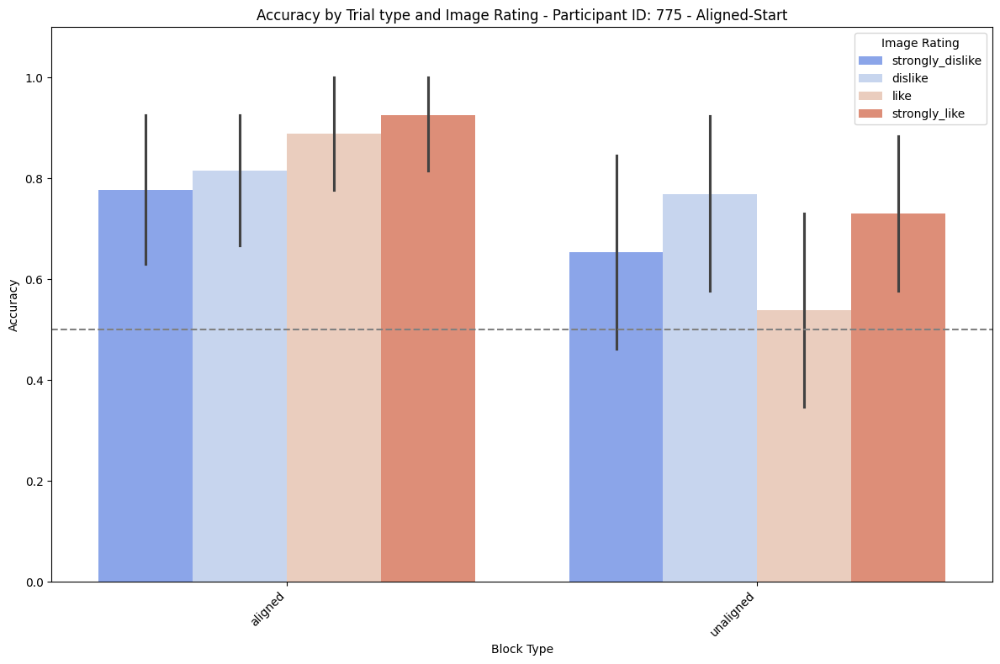

Data for participant 784:
Participant ID: 784

Accuracy in each 'Block':
Block
1    0.625000
2    0.416667
3    0.531250
4    0.444444
5    0.444444
6    0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.530000
unaligned    0.451923
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.26699711869035553

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.625000
            2        0.416667
            3        0.531250
            4        0.444444
            5        0.444444
            6        0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.549020
like                0.431373
strongly_dislike    0.509804
strongly_like       0.470588
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.666386482636793
Data for Chi-squared test:
Correct (Binary)   0

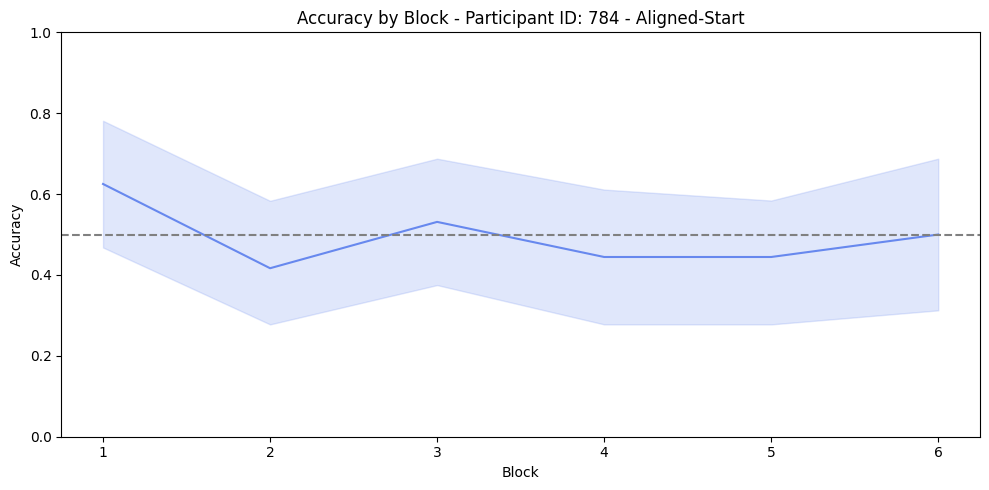

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


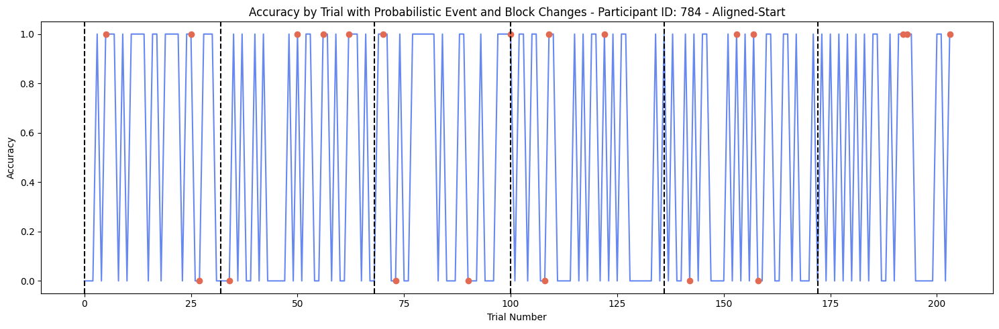

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


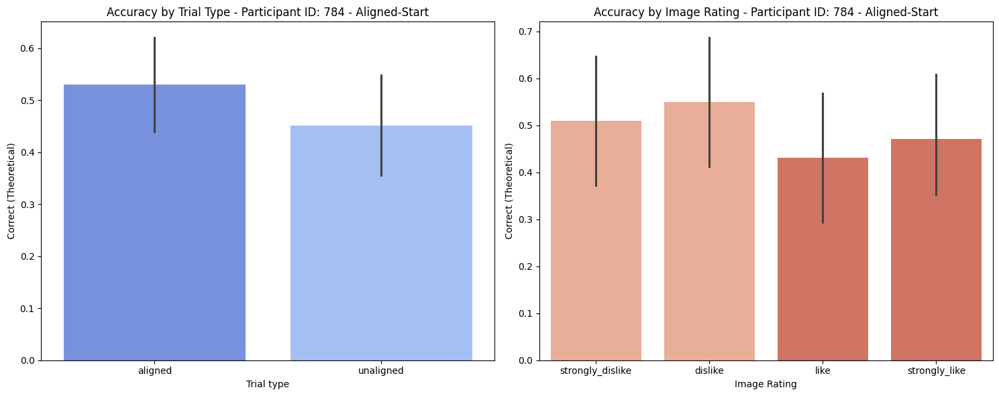

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


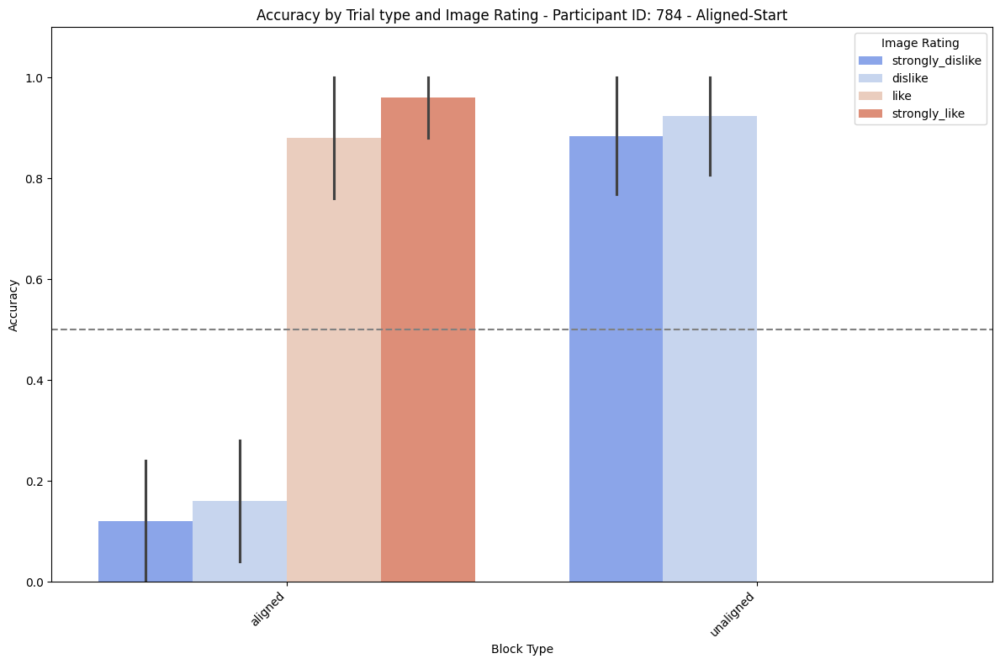

Data for participant 788:
Participant ID: 788

Accuracy in each 'Block':
Block
1    0.687500
2    0.333333
3    0.812500
4    0.138889
5    0.694444
6    0.277778
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.73
unaligned    0.25
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 2.1969608816112814e-13

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.687500
            2        0.333333
            3        0.812500
            4        0.138889
            5        0.694444
            6        0.277778
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.480769
like                0.423077
strongly_dislike    0.480769
strongly_like       0.538462
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.708663093640223
Data for Chi-squared test:
Correct (Binary)   0   1


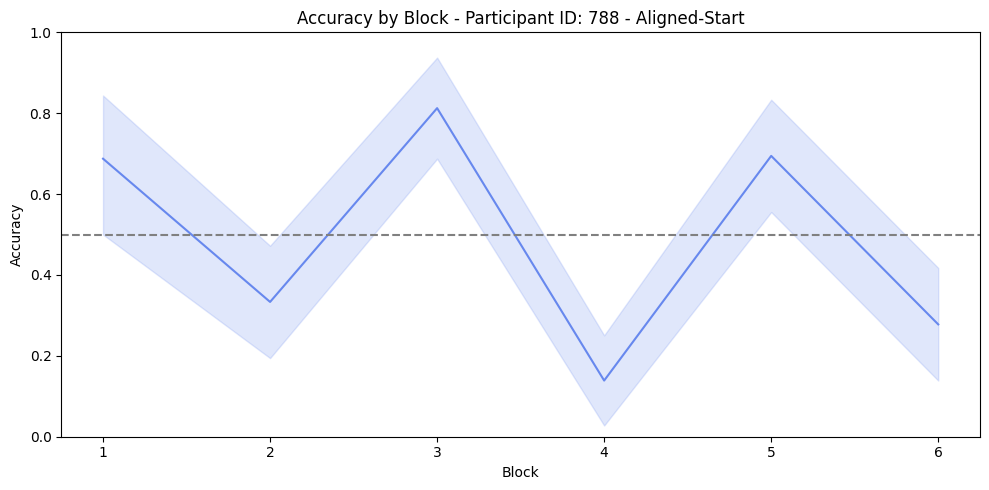

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


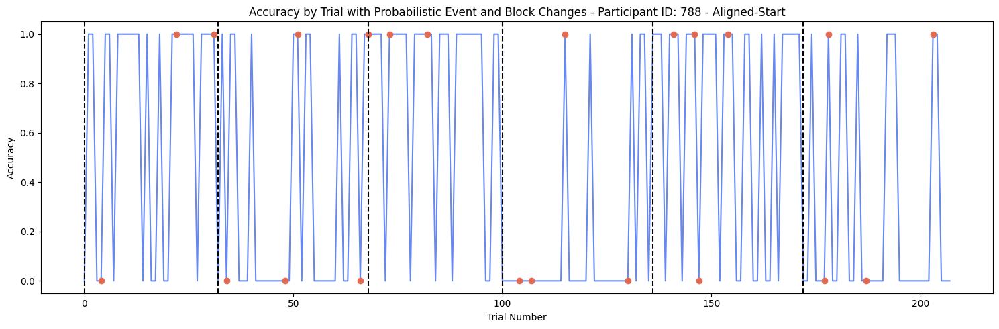

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


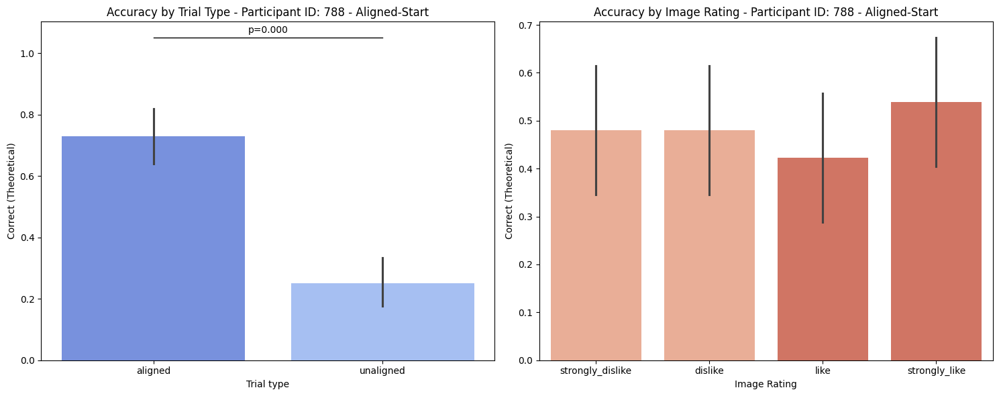

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.031).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.002).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.009).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.002).


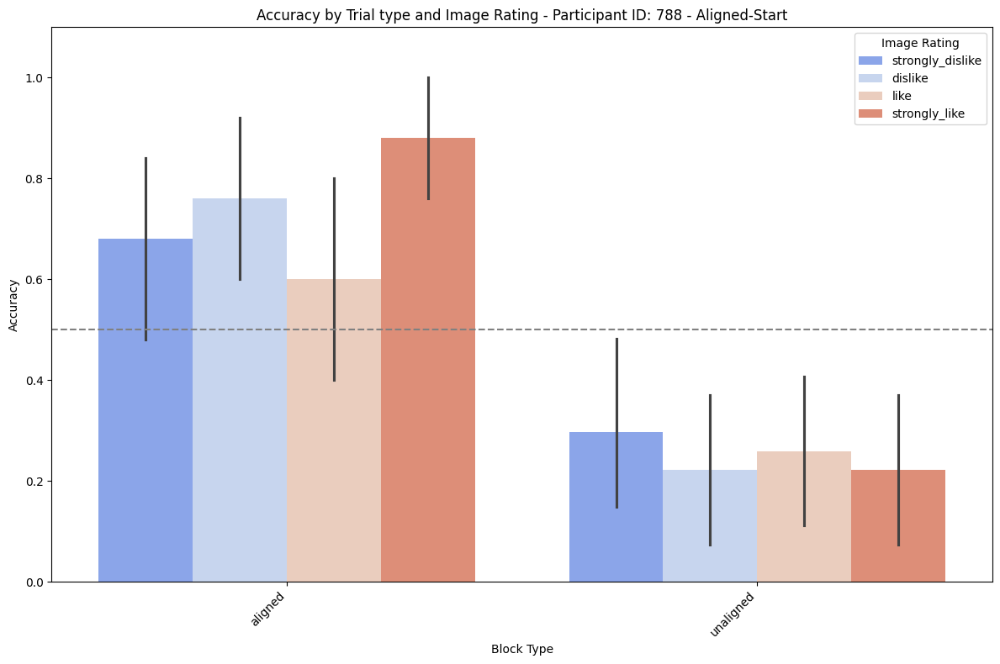

Data for participant 793:
Participant ID: 793

Accuracy in each 'Block':
Block
1    0.718750
2    0.718750
3    0.468750
4    0.562500
5    0.611111
6    0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.600000
unaligned    0.572917
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.7020655713017484

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.718750
            2        0.718750
            3        0.468750
            4        0.562500
            5        0.611111
            6        0.437500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.489796
like                0.693878
strongly_dislike    0.591837
strongly_like       0.571429
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.233610855016538
Data for Chi-squared test:
Correct (Binary)   0 

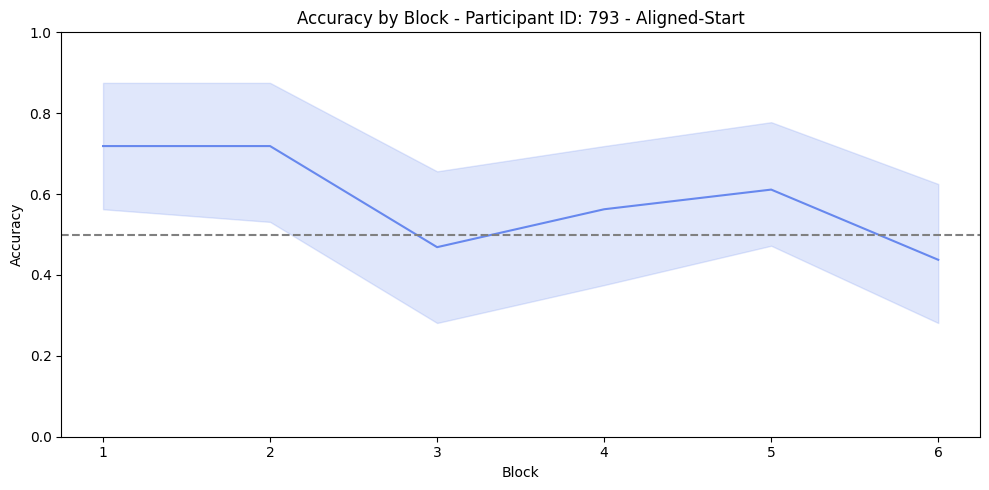

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


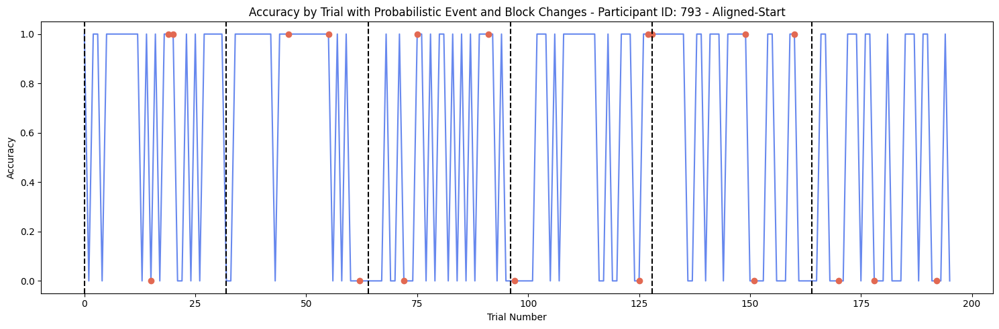

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


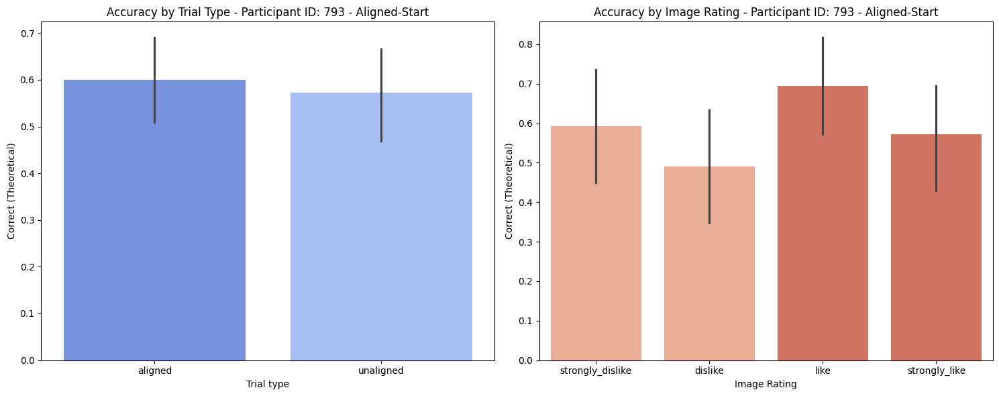

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.024).


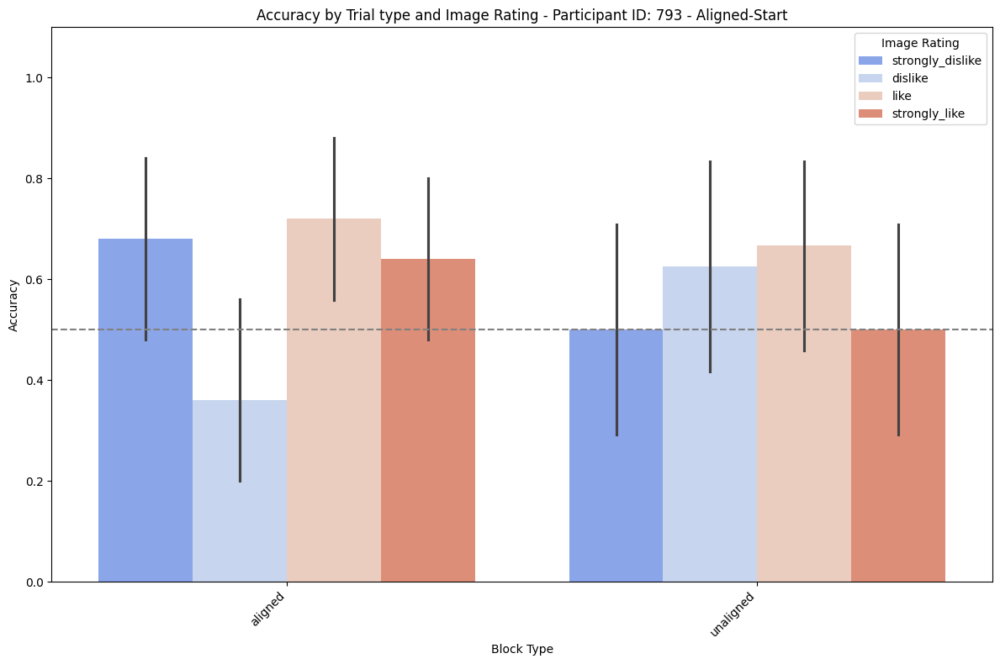

Data for participant 791:
Participant ID: 791

Accuracy in each 'Block':
Block
1    0.694444
2    0.718750
3    0.750000
4    0.718750
5    0.968750
6    0.833333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.798077
unaligned    0.760000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.5144075649508264

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.694444
            2        0.718750
            3        0.750000
            4        0.718750
            5        0.968750
            6        0.833333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.843137
like                0.725490
strongly_dislike    0.803922
strongly_like       0.745098
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.458445932332083
Data for Chi-squared test:
Correct (Binary)   0 

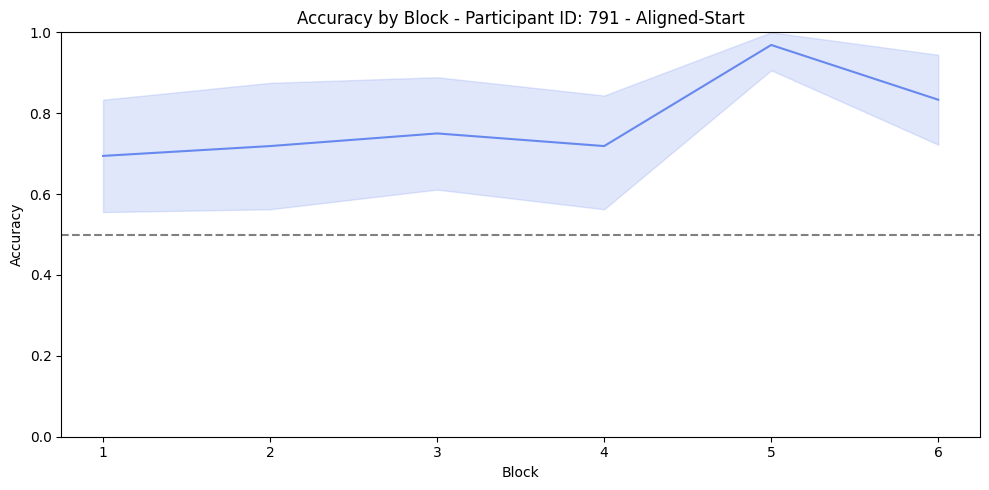

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


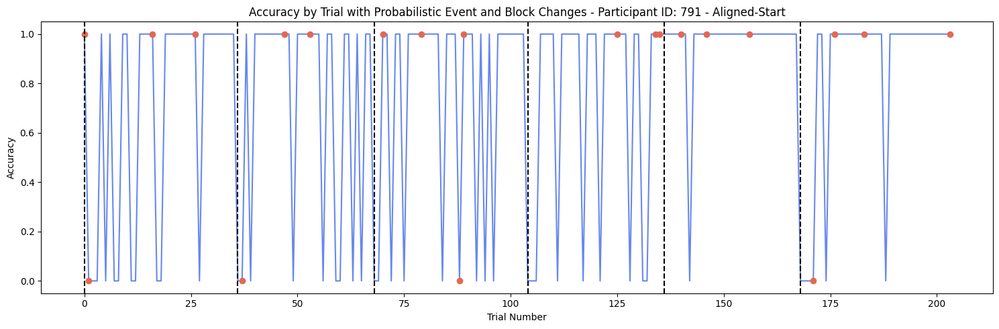

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


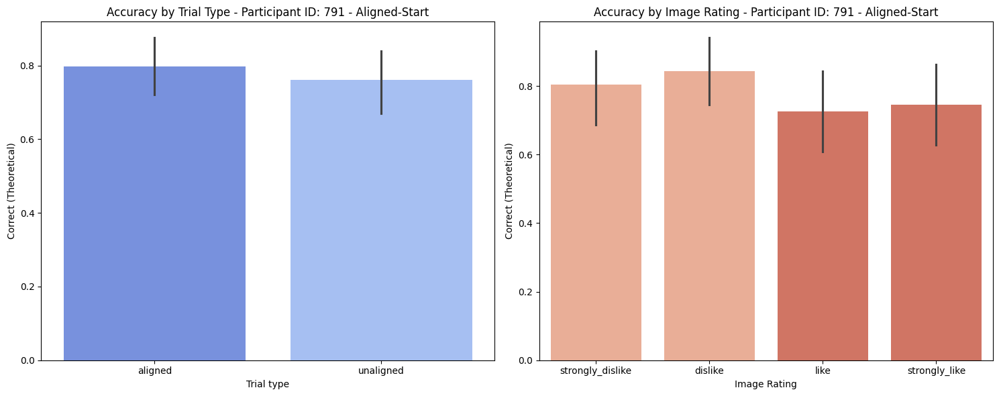

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.024).


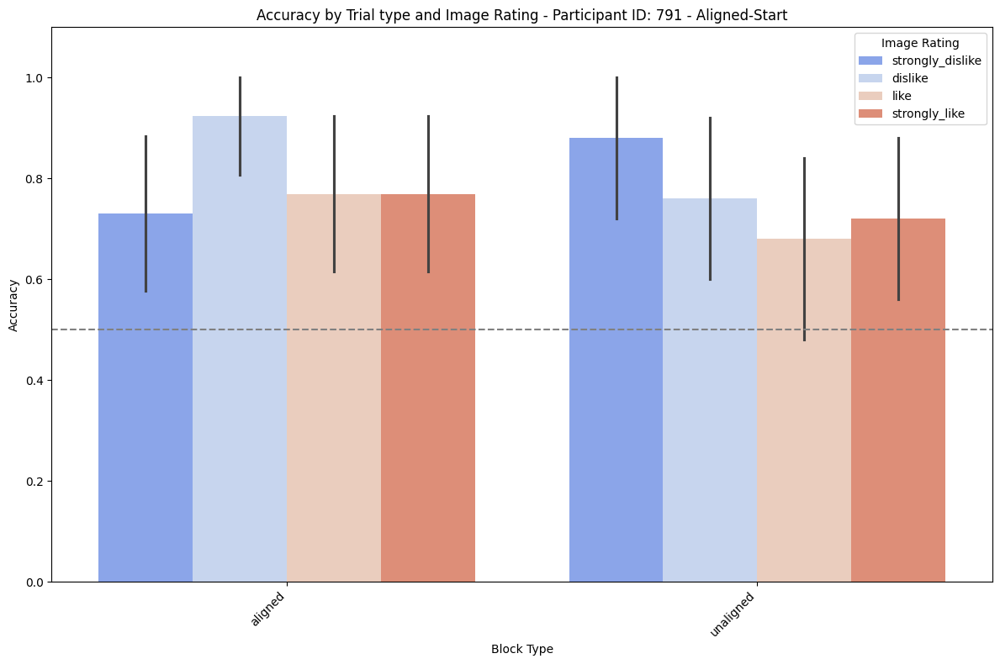

Data for participant 792:
Participant ID: 792

Accuracy in each 'Block':
Block
1    0.843750
2    0.625000
3    0.583333
4    0.406250
5    0.472222
6    0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.625
unaligned    0.540
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.2202945392469536

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.843750
            2        0.625000
            3        0.583333
            4        0.406250
            5        0.472222
            6        0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.588235
like                0.607843
strongly_dislike    0.450980
strongly_like       0.686275
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.110147635111074
Data for Chi-squared test:
Correct (Binary)   0   1
Im

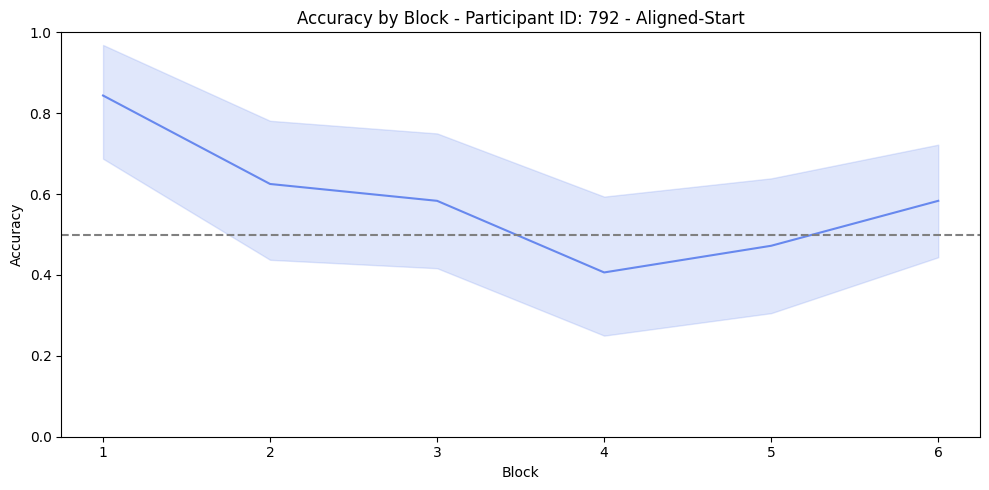

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


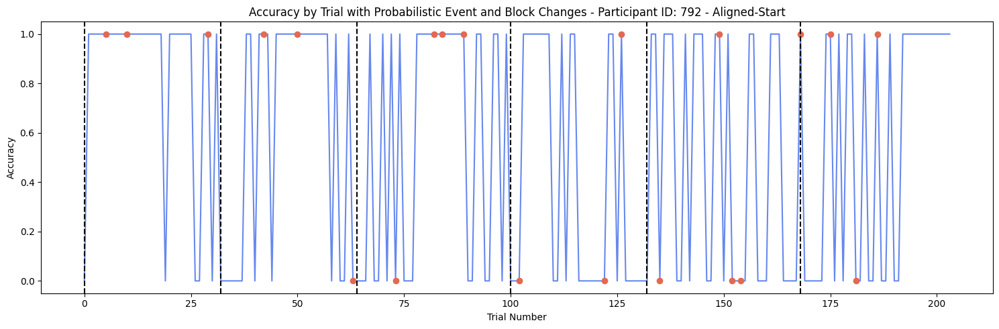

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


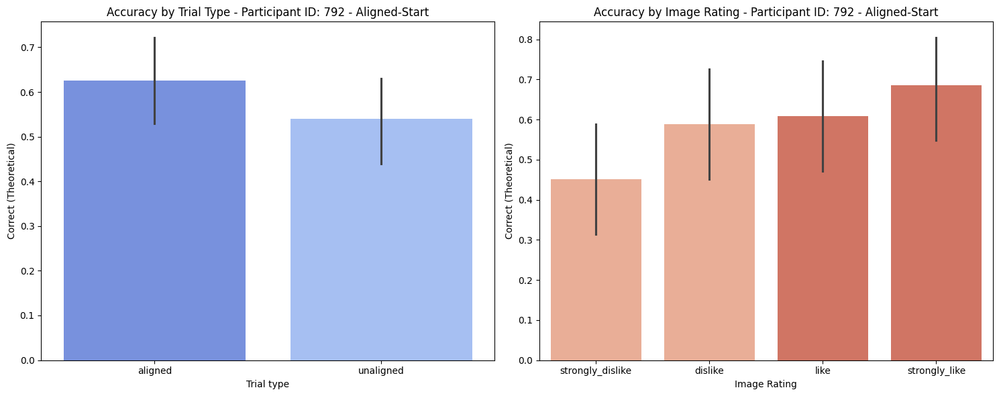

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).


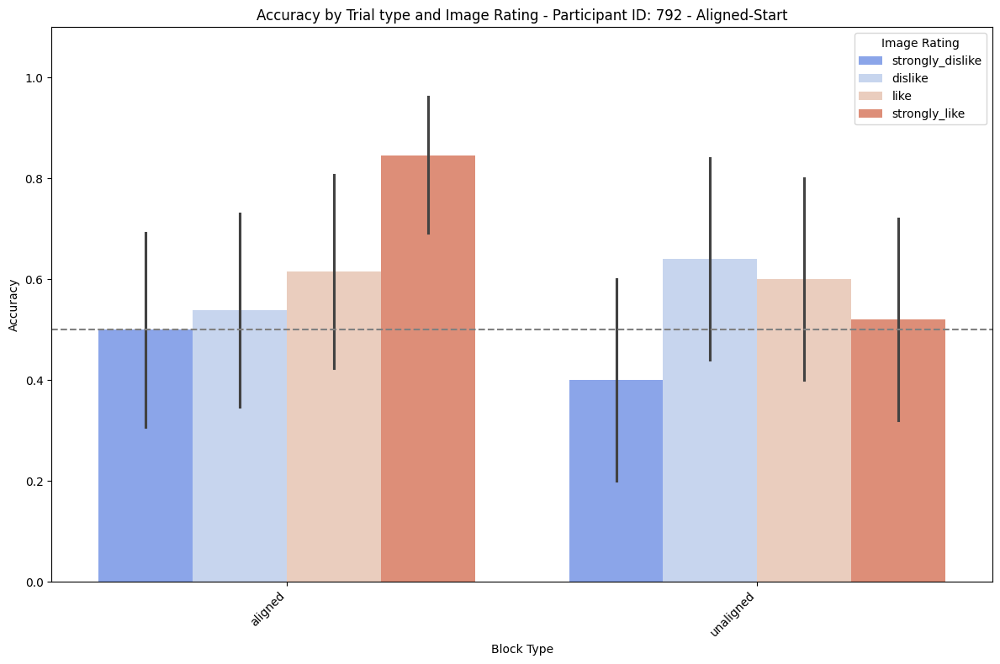

Data for participant 790:
Participant ID: 790

Accuracy in each 'Block':
Block
1    0.722222
2    0.750000
3    0.555556
4    0.531250
5    0.406250
6    0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.567308
unaligned    0.600000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.637860623599178

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.722222
            2        0.750000
            3        0.555556
            4        0.531250
            5        0.406250
            6        0.500000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.529412
like                0.666667
strongly_dislike    0.588235
strongly_like       0.549020
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.508828342356889
Data for Chi-squared test:
Correct (Binary)   0  

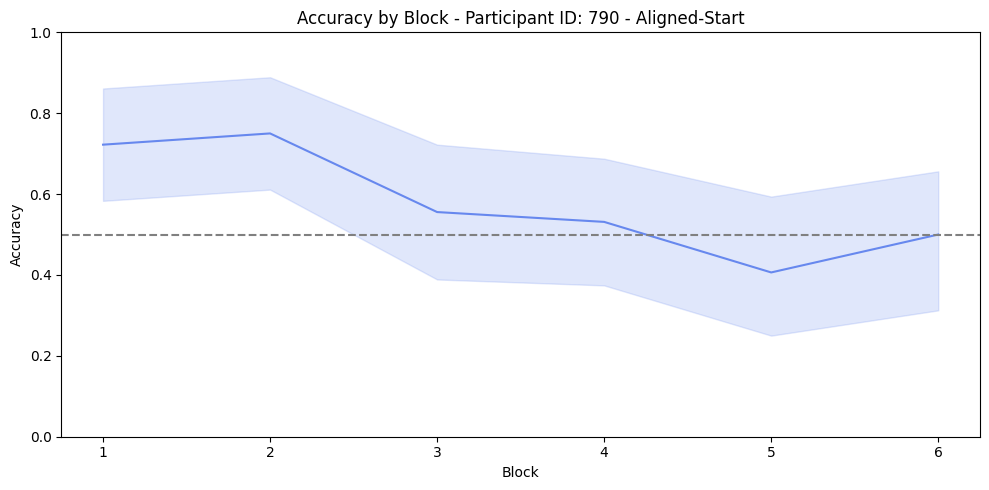

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


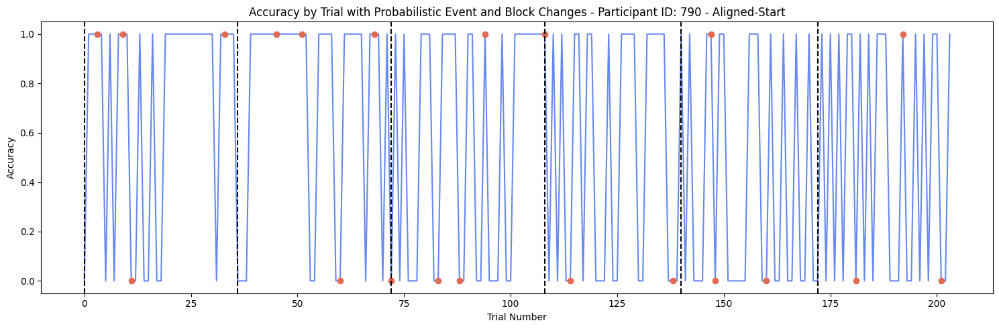

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


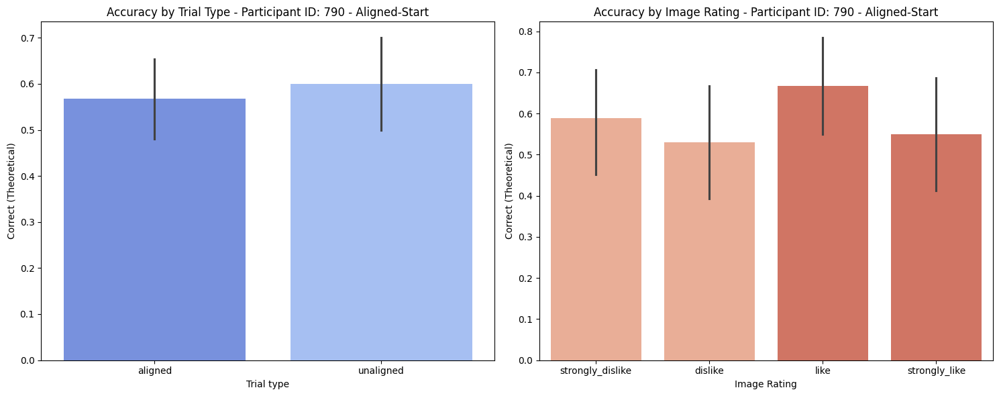

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.004).


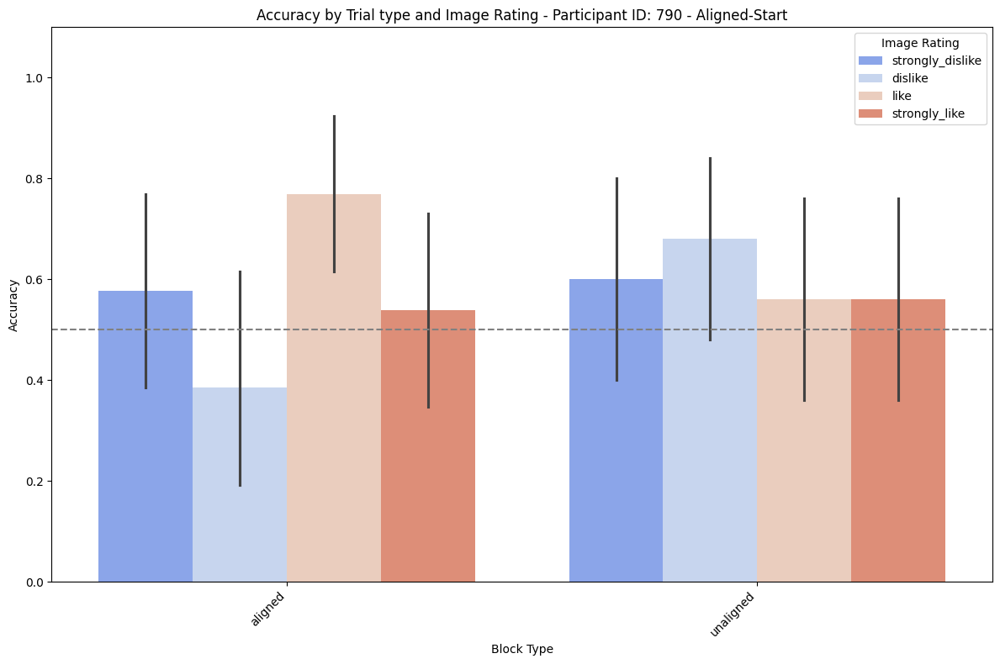

Data for participant 786:
Participant ID: 786

Accuracy in each 'Block':
Block
1    0.777778
2    0.666667
3    0.861111
4    0.722222
5    0.812500
6    0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.817308
unaligned    0.750000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.24054221886483373

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.777778
            2        0.666667
            3        0.861111
            4        0.722222
            5        0.812500
            6        0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.769231
like                0.807692
strongly_dislike    0.788462
strongly_like       0.769231
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.957769545184514
Data for Chi-squared test:
Correct (Binary)   0

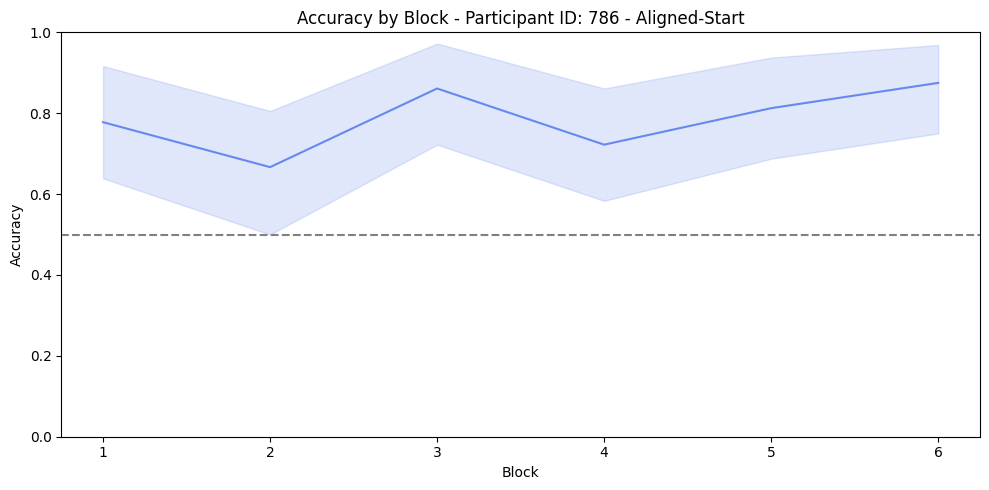

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


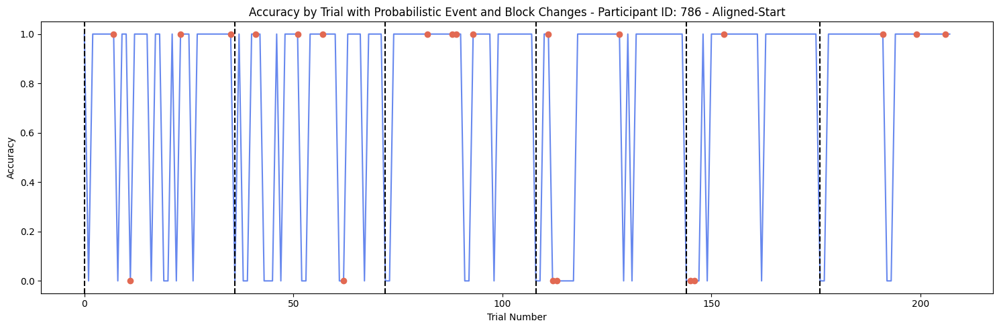

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


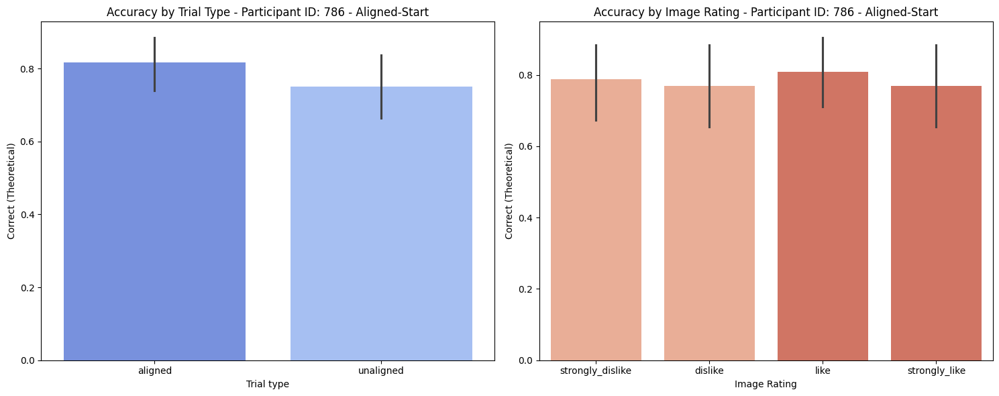

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.015).


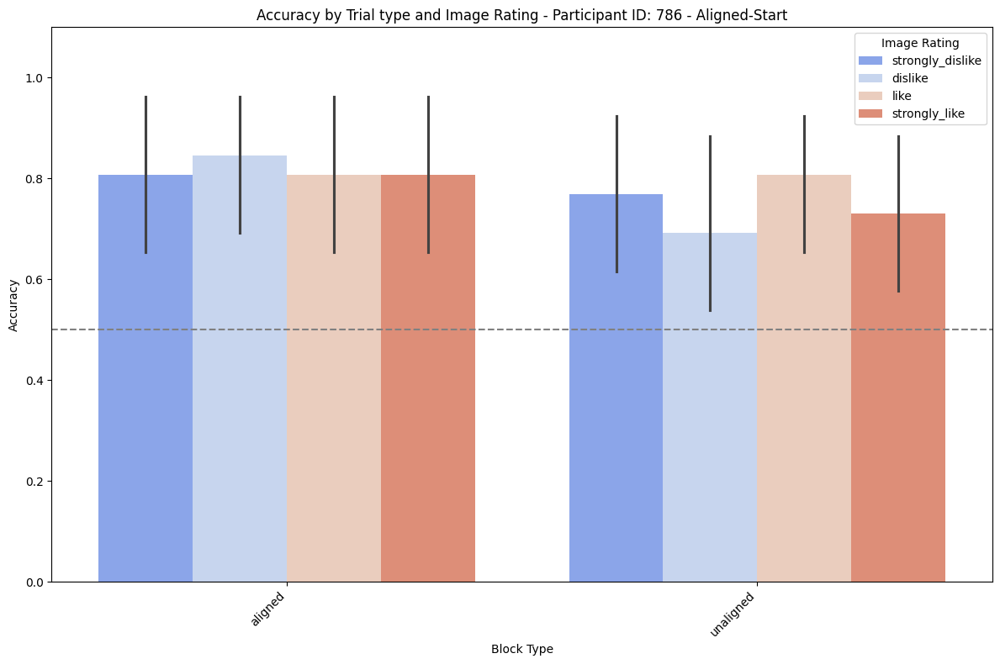

Data for participant 823:
Participant ID: 823

Accuracy in each 'Block':
Block
1    1.000000
2    0.687500
3    0.833333
4    0.843750
5    0.781250
6    0.611111
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.87
unaligned    0.71
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.00531213080812085

Accuracy over the whole task:
All Trials  Block
All Trials  1        1.000000
            2        0.687500
            3        0.833333
            4        0.843750
            5        0.781250
            6        0.611111
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.80
like                0.80
strongly_dislike    0.80
strongly_like       0.76
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.948042891472379
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating       

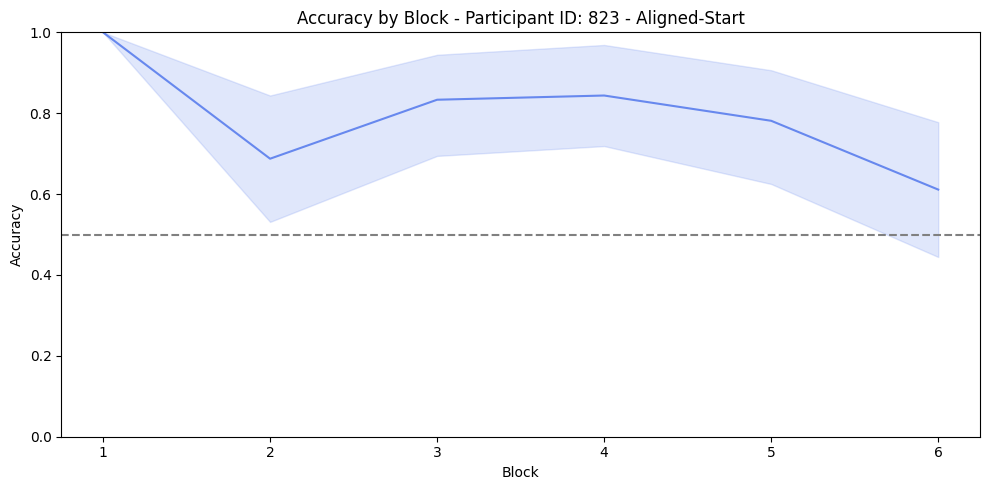

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


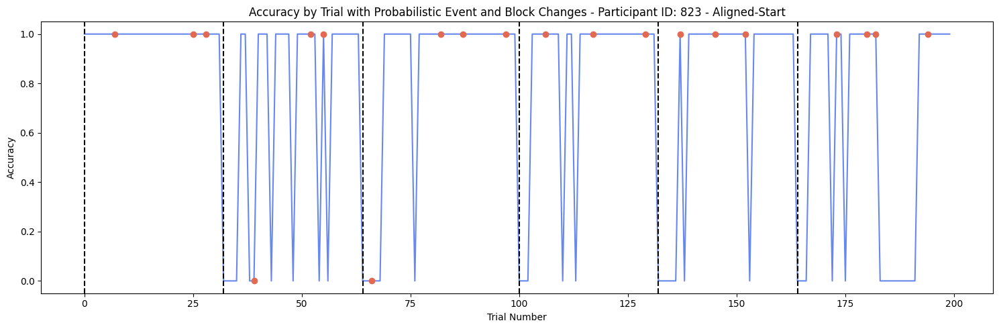

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


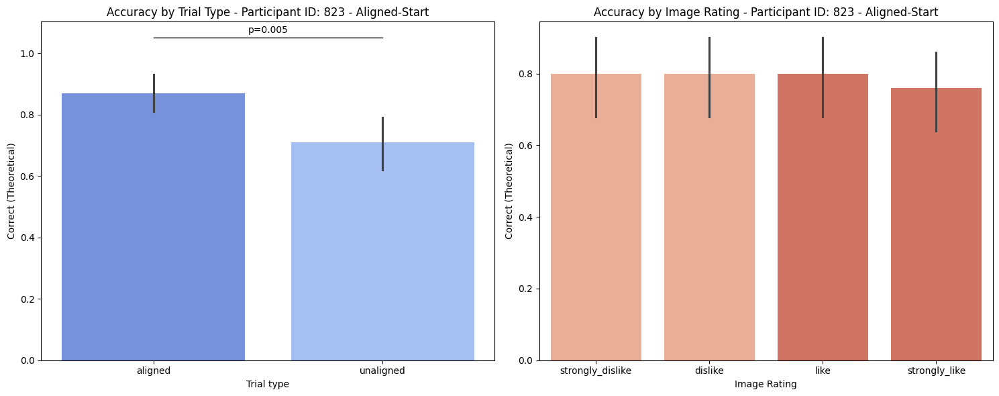

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.024).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.024).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.024).


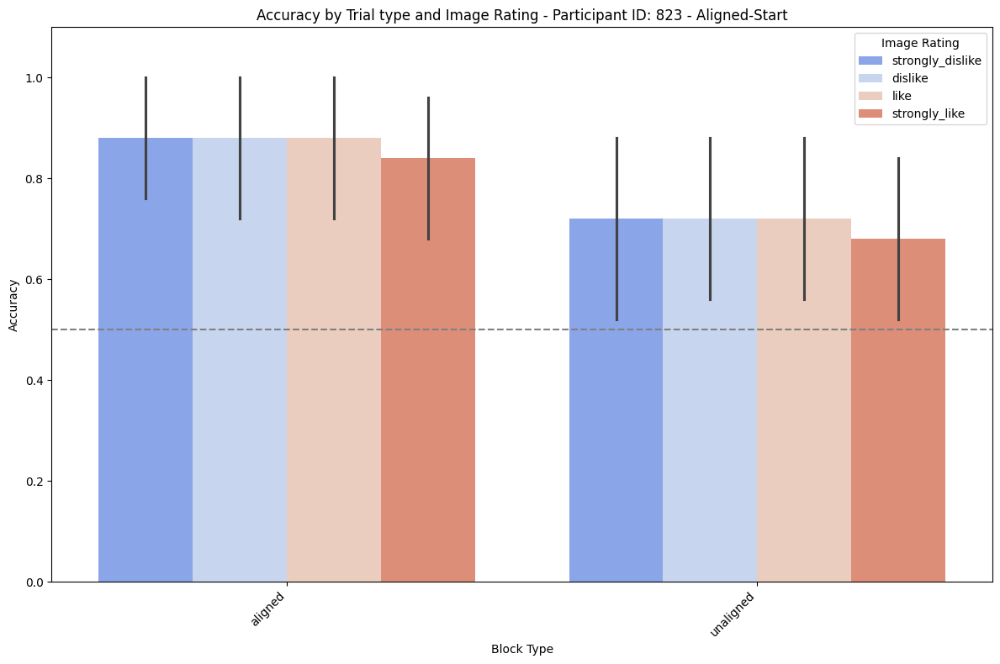

Data for participant 821:
Participant ID: 821

Accuracy in each 'Block':
Block
1    0.972222
2    0.218750
3    1.000000
4    0.083333
5    0.968750
6    0.218750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.98
unaligned    0.17
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 1.0340859684177743e-49

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.972222
            2        0.218750
            3        1.000000
            4        0.083333
            5        0.968750
            6        0.218750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.56
like                0.56
strongly_dislike    0.54
strongly_like       0.64
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.751287295386693
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating    

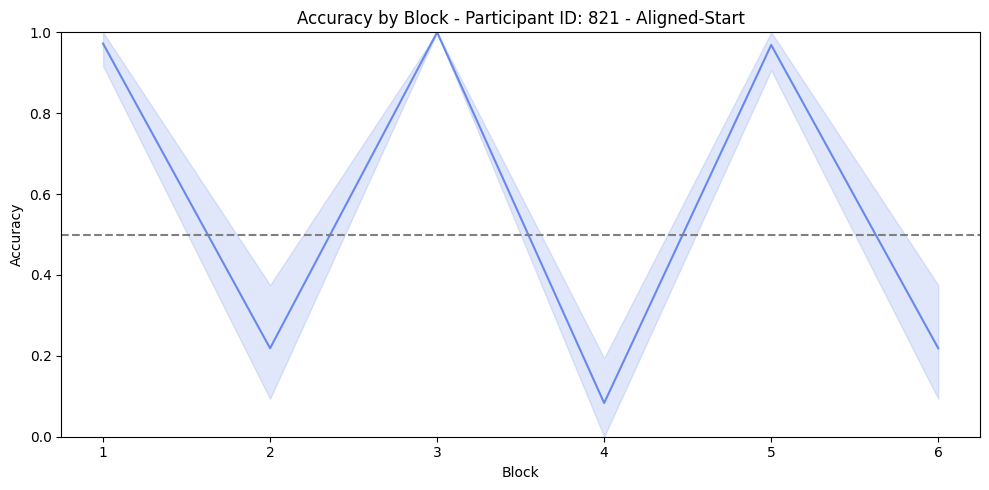

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


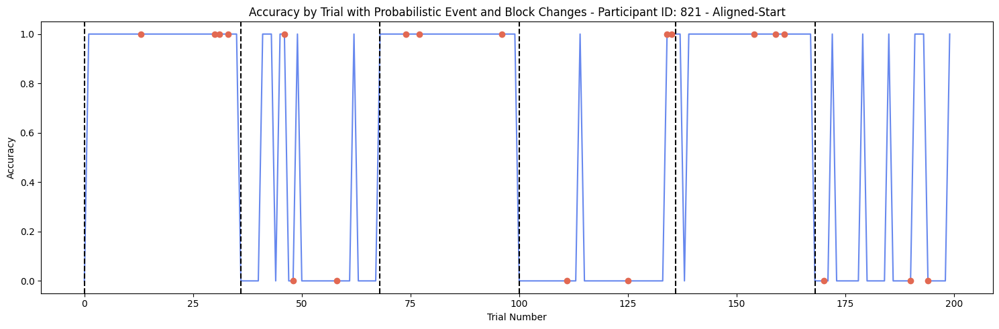

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


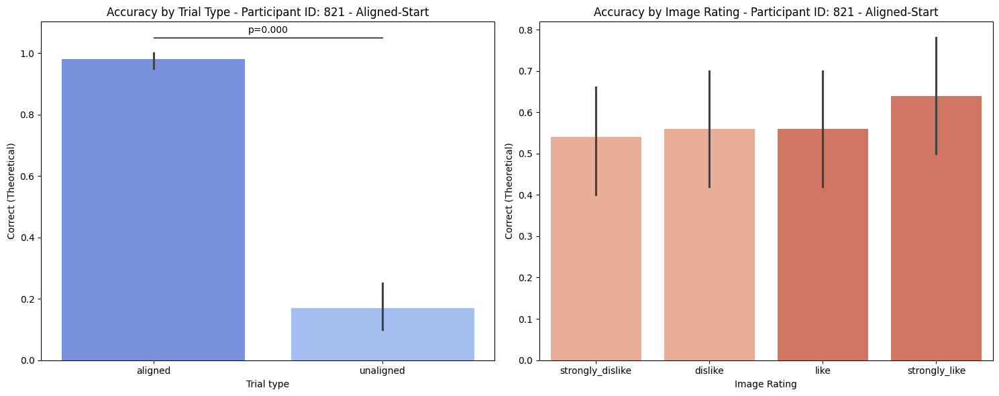

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.024).


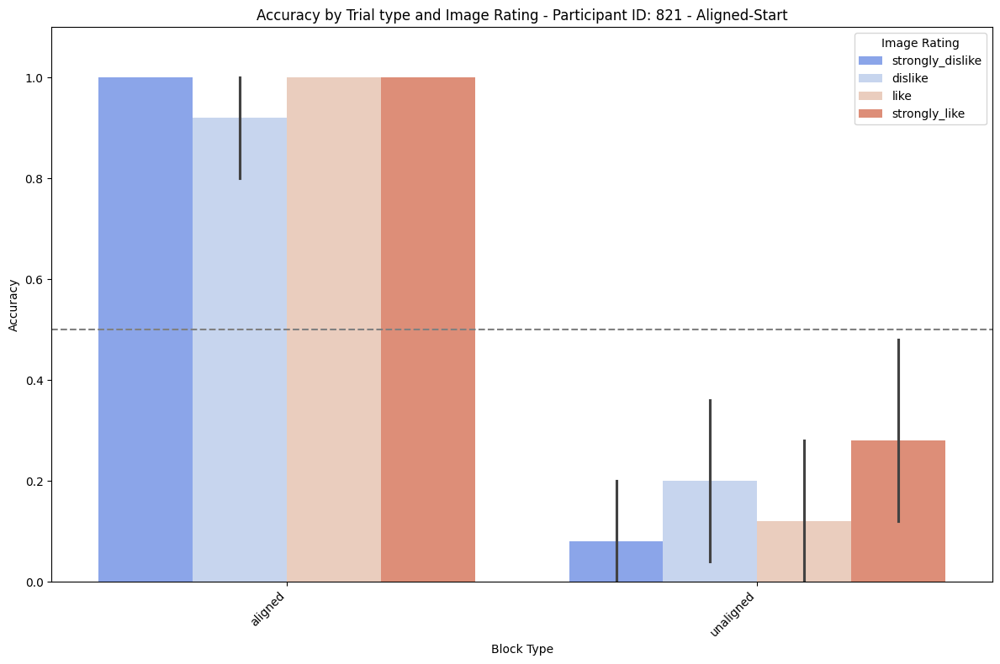

Data for participant 820:
Participant ID: 820

Accuracy in each 'Block':
Block
1    0.843750
2    0.555556
3    0.781250
4    0.375000
5    0.694444
6    0.166667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.770000
unaligned    0.365385
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 1.4038909665824334e-09

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.843750
            2        0.555556
            3        0.781250
            4        0.375000
            5        0.694444
            6        0.166667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.509804
like                0.568627
strongly_dislike    0.549020
strongly_like       0.627451
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.683454711578996
Data for Chi-squared test:
Correct (Binary) 

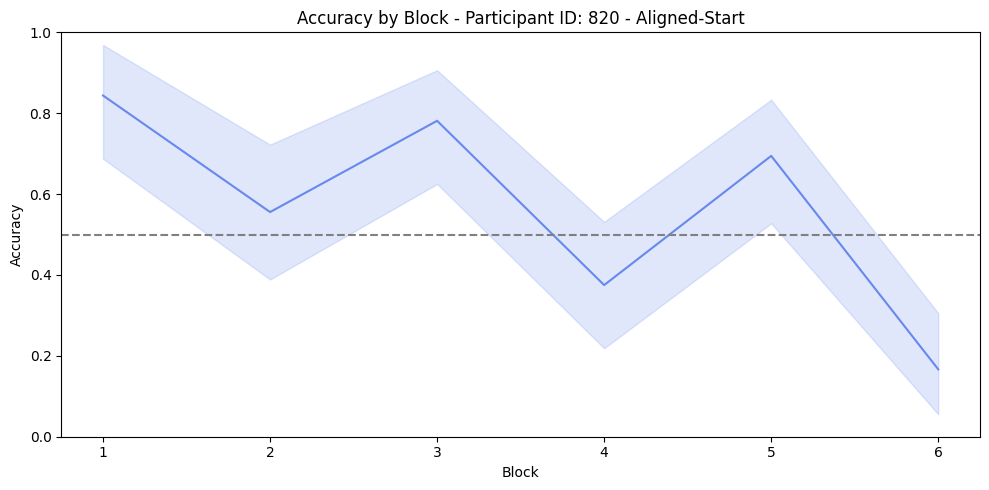

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


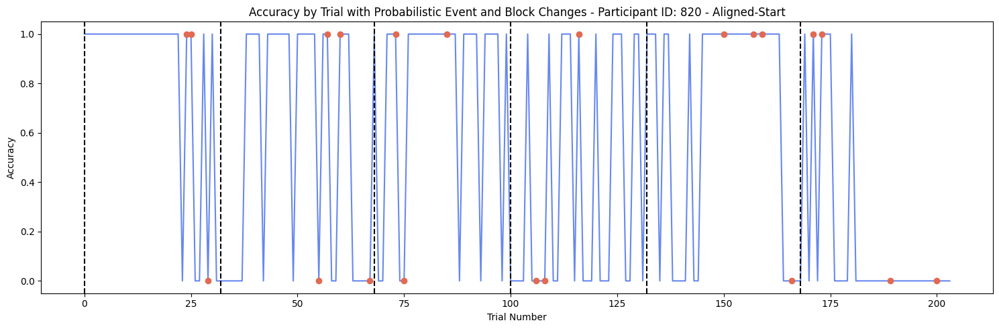

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


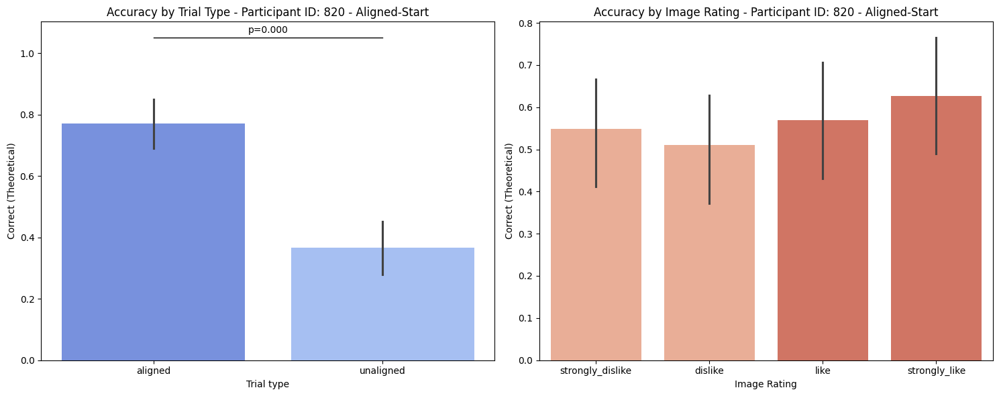

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).


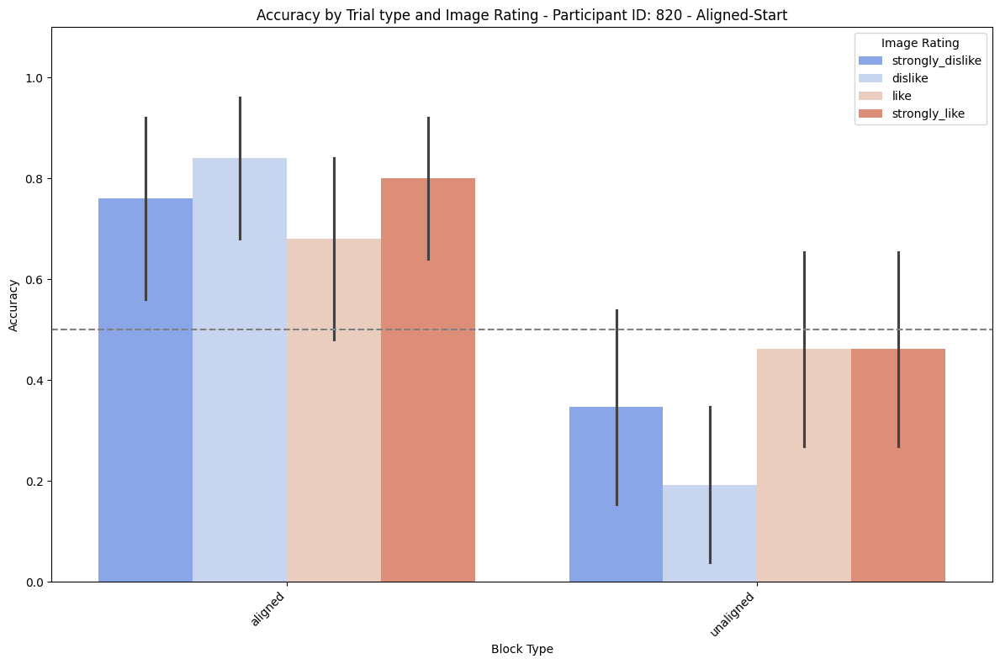

Data for participant 819:
Participant ID: 819

Accuracy in each 'Block':
Block
1    0.937500
2    0.805556
3    0.805556
4    0.906250
5    0.944444
6    0.916667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.894231
unaligned    0.875000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.6660762190825564

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.937500
            2        0.805556
            3        0.805556
            4        0.906250
            5        0.944444
            6        0.916667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.846154
like                0.903846
strongly_dislike    0.903846
strongly_like       0.884615
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.769732547106284
Data for Chi-squared test:
Correct (Binary)  0  

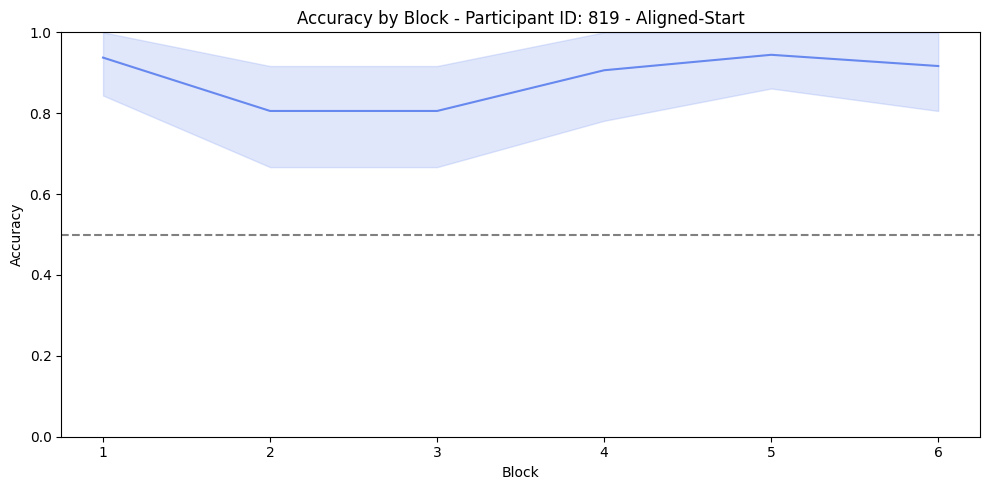

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


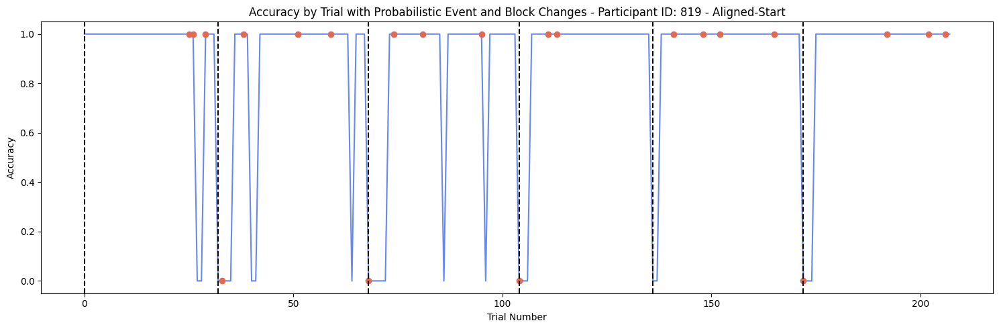

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


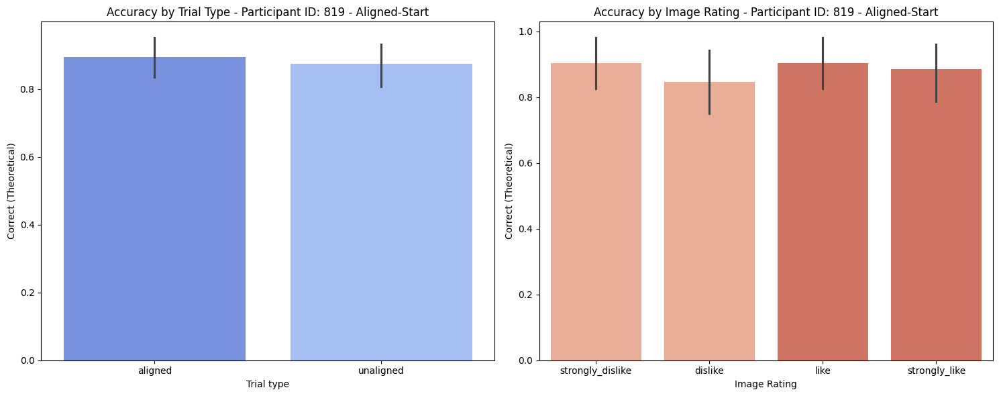

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


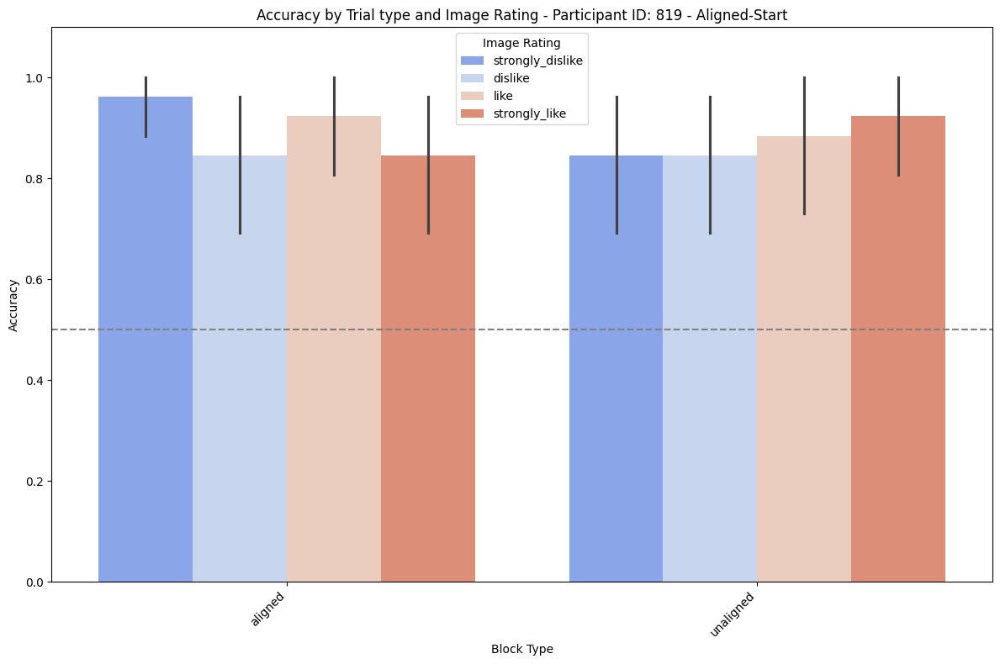

Data for participant 818:
Participant ID: 818

Accuracy in each 'Block':
Block
1    0.944444
2    0.218750
3    1.000000
4    0.083333
5    0.687500
6    0.305556
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.880000
unaligned    0.201923
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 5.501464585443418e-29

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.944444
            2        0.218750
            3        1.000000
            4        0.083333
            5        0.687500
            6        0.305556
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.588235
like                0.529412
strongly_dislike    0.509804
strongly_like       0.509804
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.838164791018082
Data for Chi-squared test:
Correct (Binary)  

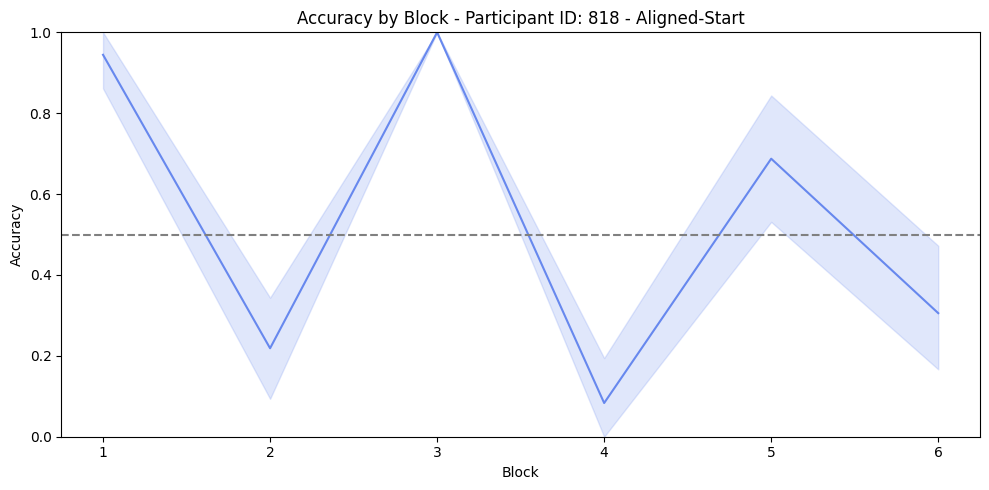

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


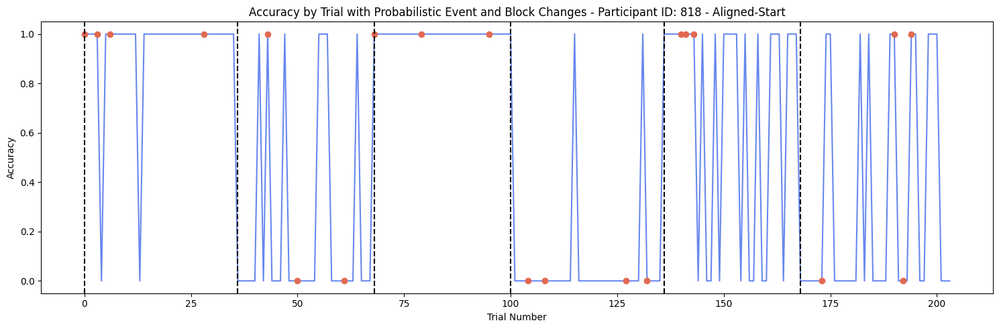

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


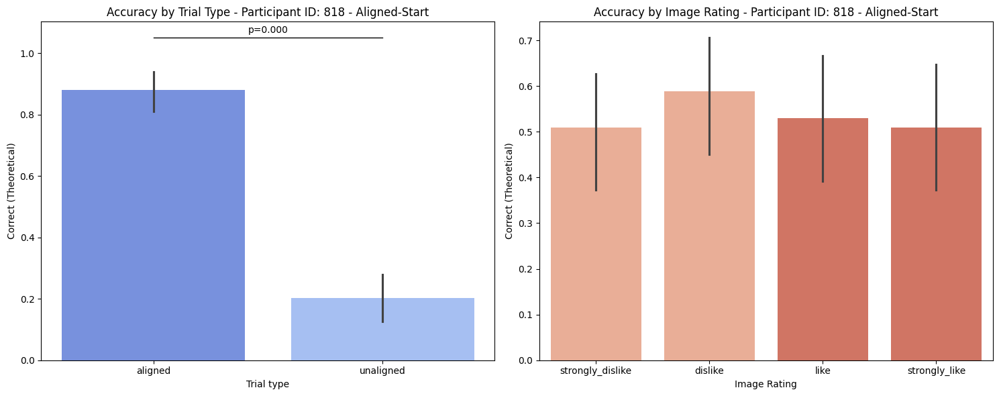

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


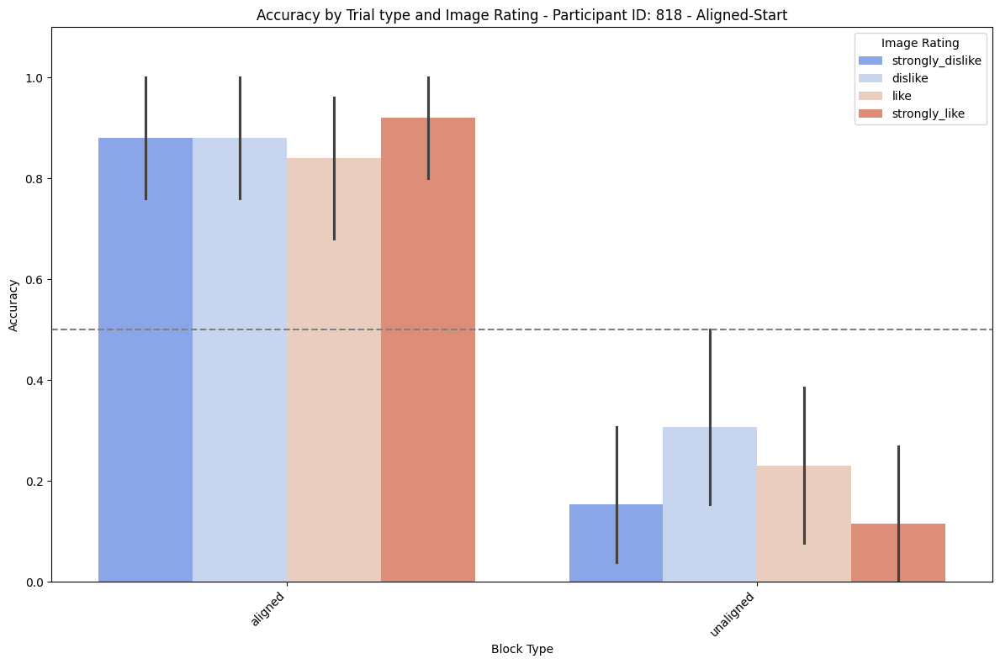

Data for participant 817:
Participant ID: 817

Accuracy in each 'Block':
Block
1    0.944444
2    0.750000
3    0.781250
4    0.718750
5    0.812500
6    0.638889
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.85
unaligned    0.70
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.01093373590190233

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.944444
            2        0.750000
            3        0.781250
            4        0.718750
            5        0.812500
            6        0.638889
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.76
like                0.72
strongly_dislike    0.78
strongly_like       0.84
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.541756504213890
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating       

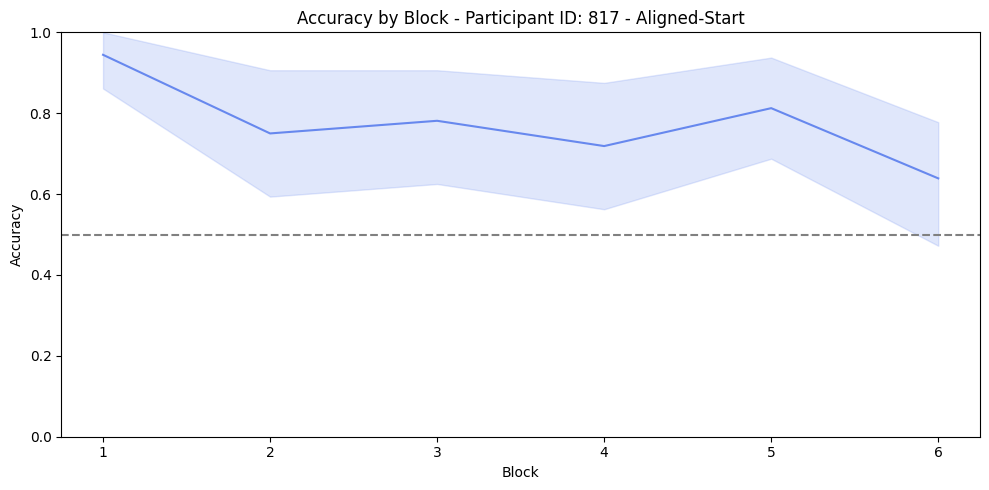

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


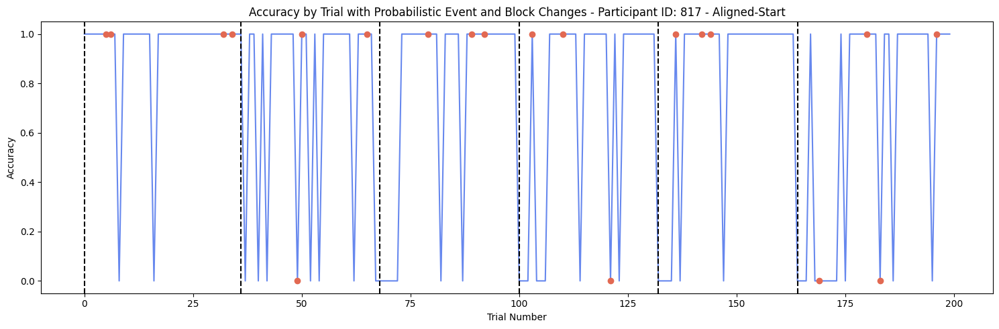

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


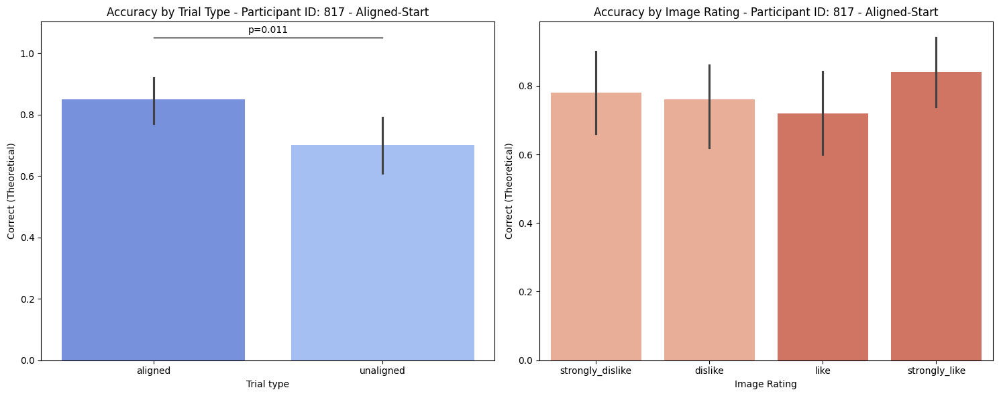

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.006).


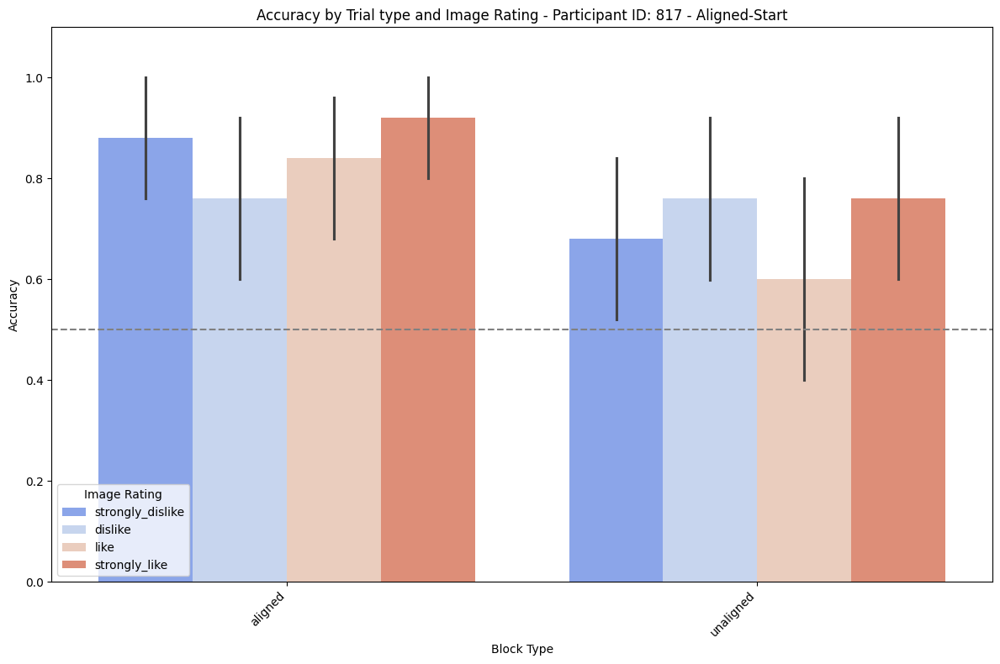

Data for participant 816:
Participant ID: 816

Accuracy in each 'Block':
Block
1    0.944444
2    0.583333
3    0.583333
4    0.437500
5    0.437500
6    0.312500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.663462
unaligned    0.450000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.002022826806312968

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.944444
            2        0.583333
            3        0.583333
            4        0.437500
            5        0.437500
            6        0.312500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.588235
like                0.549020
strongly_dislike    0.568627
strongly_like       0.529412
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.940725289991832
Data for Chi-squared test:
Correct (Binary)   

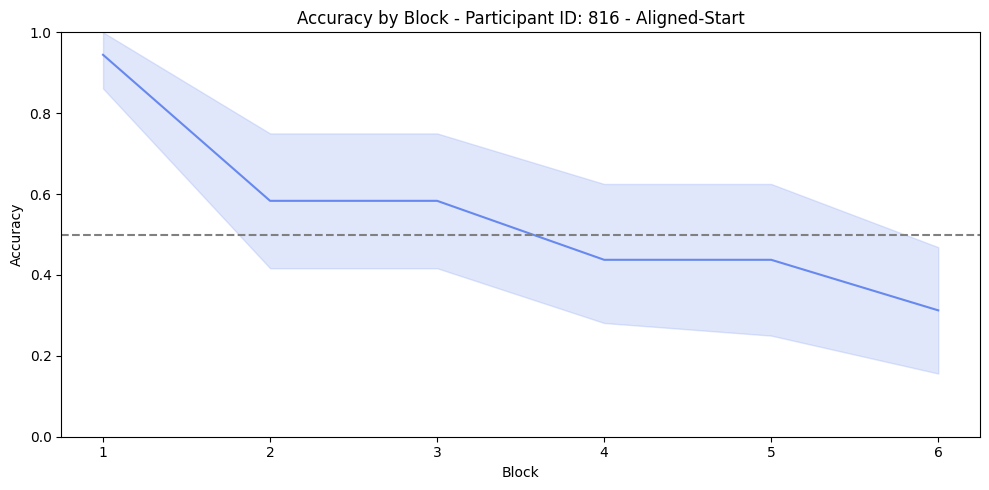

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


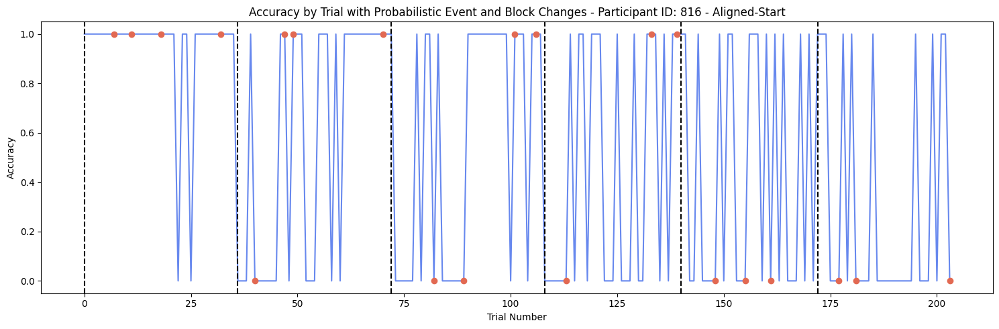

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


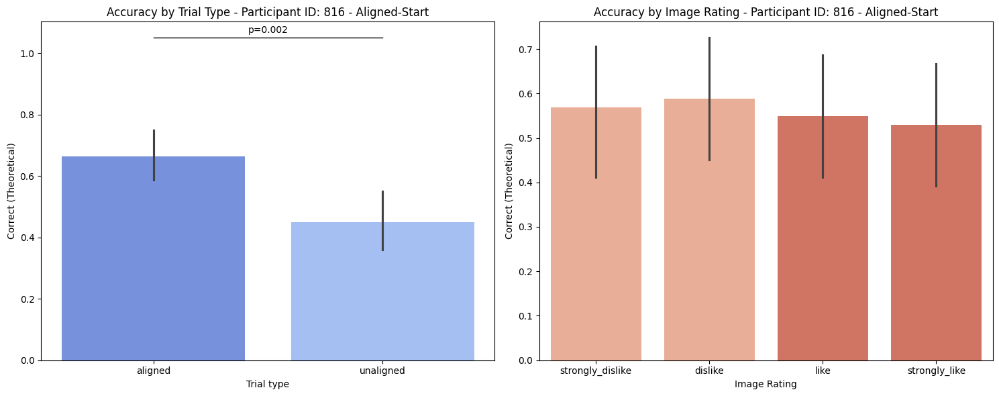

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.024).


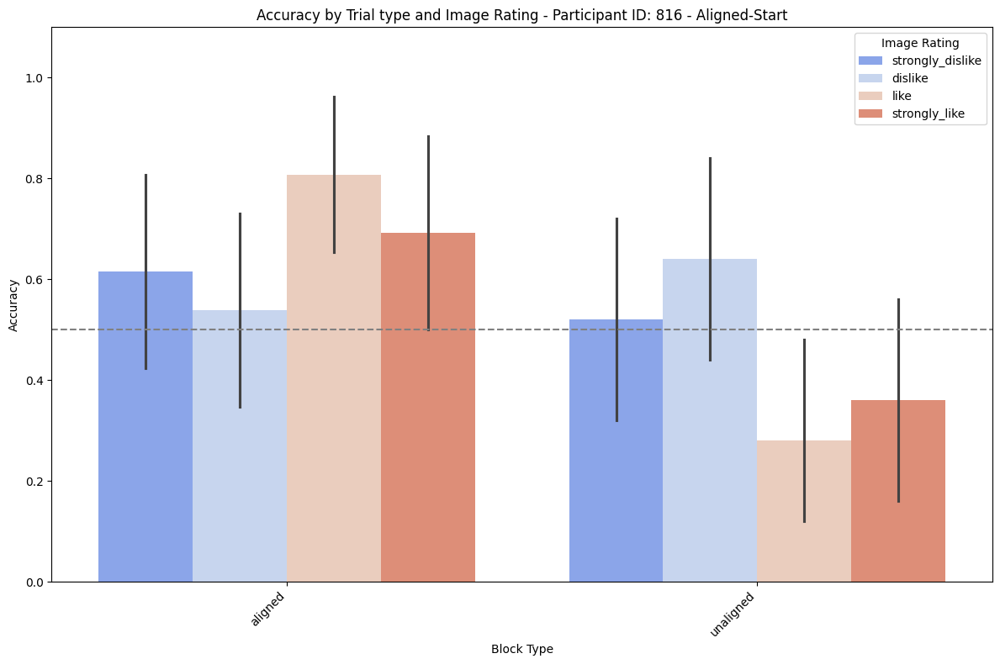

Data for participant 815:
Participant ID: 815

Accuracy in each 'Block':
Block
1    0.375000
2    0.527778
3    0.527778
4    0.444444
5    0.593750
6    0.593750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.500000
unaligned    0.519231
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.7848472339353821

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.375000
            2        0.527778
            3        0.527778
            4        0.444444
            5        0.593750
            6        0.593750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.490196
like                0.529412
strongly_dislike    0.431373
strongly_like       0.588235
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.445745597734977
Data for Chi-squared test:
Correct (Binary)   0 

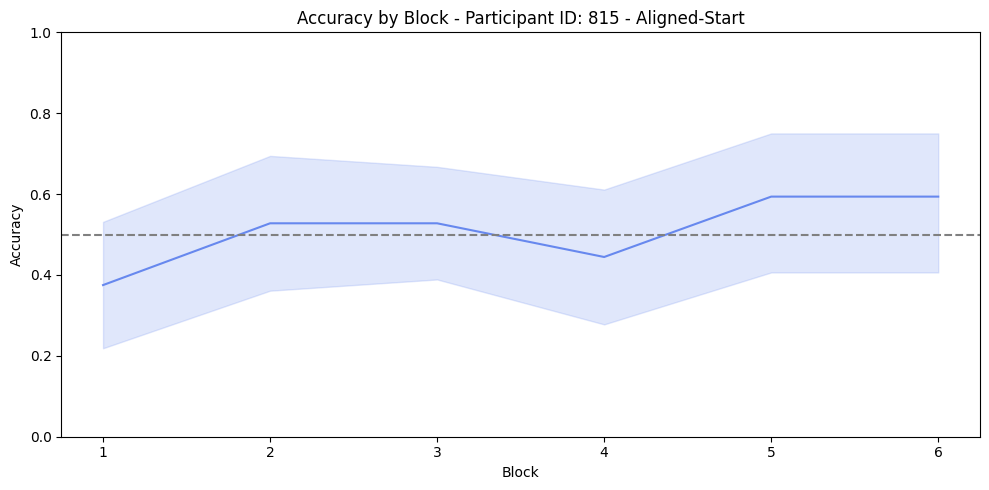

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


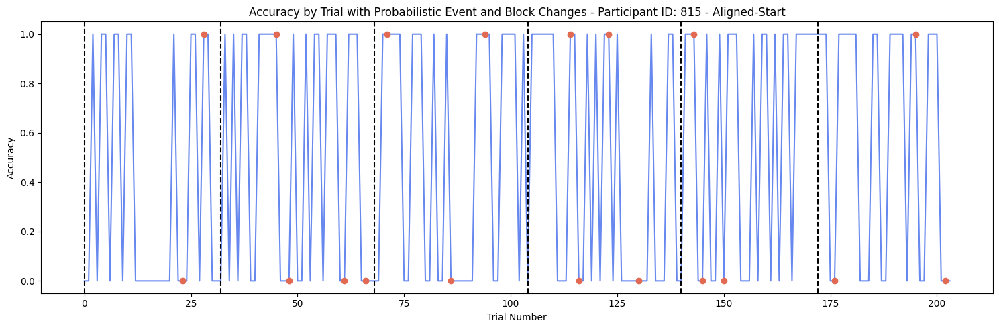

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


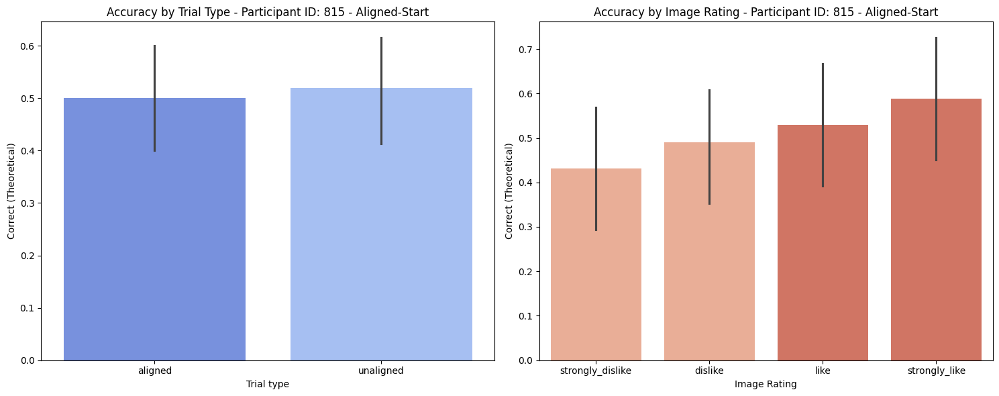

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.024).


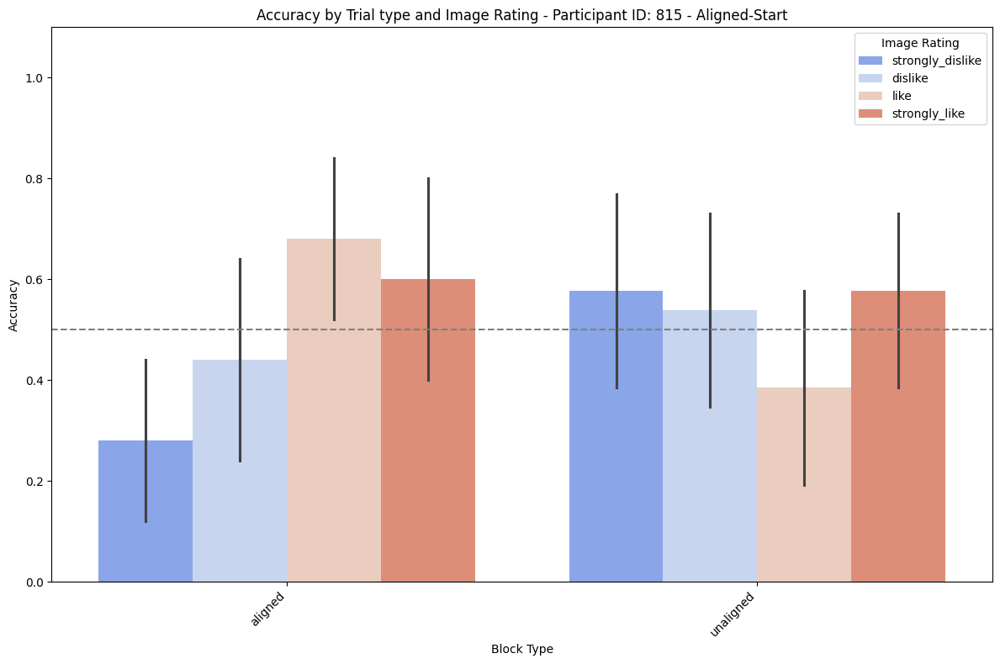

Data for participant 814:
Participant ID: 814

Accuracy in each 'Block':
Block
1    0.687500
2    0.416667
3    0.781250
4    0.781250
5    0.694444
6    0.472222
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.720000
unaligned    0.548077
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.010750350987208121

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.687500
            2        0.416667
            3        0.781250
            4        0.781250
            5        0.694444
            6        0.472222
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.588235
like                0.490196
strongly_dislike    0.764706
strongly_like       0.686275
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.025086990663235
Data for Chi-squared test:
Correct (Binary)   

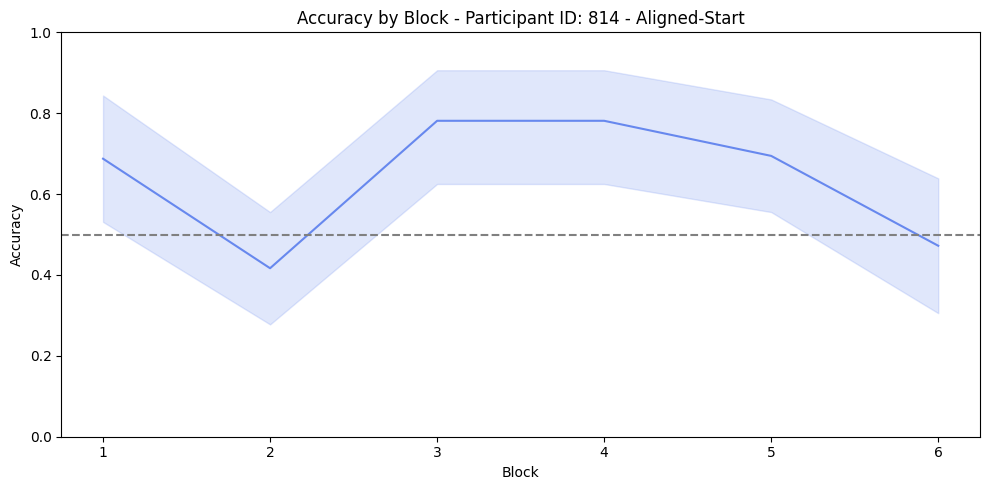

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


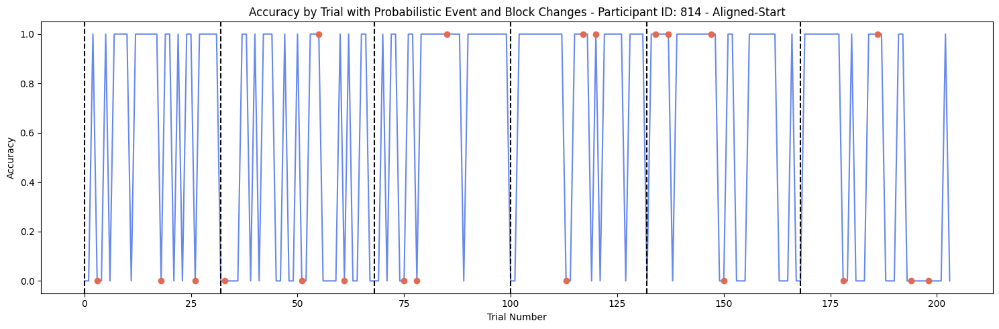

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


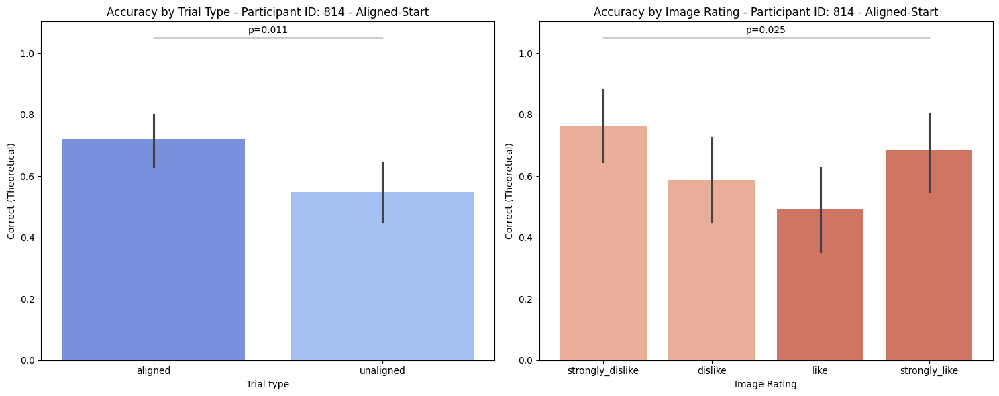

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).


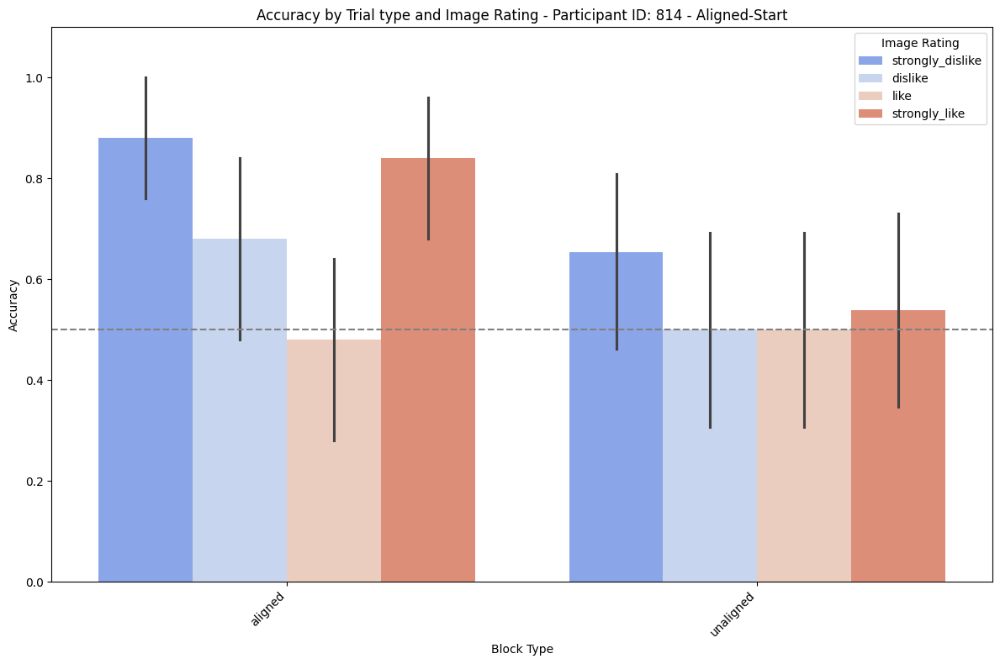

Data for participant 811:
Participant ID: 811

Accuracy in each 'Block':
Block
1    1.000000
2    0.562500
3    0.812500
4    0.687500
5    0.875000
6    0.638889
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.895833
unaligned    0.630000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 8.980964788954757e-06

Accuracy over the whole task:
All Trials  Block
All Trials  1        1.000000
            2        0.562500
            3        0.812500
            4        0.687500
            5        0.875000
            6        0.638889
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.795918
like                0.755102
strongly_dislike    0.673469
strongly_like       0.816327
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.359130685476801
Data for Chi-squared test:
Correct (Binary)  

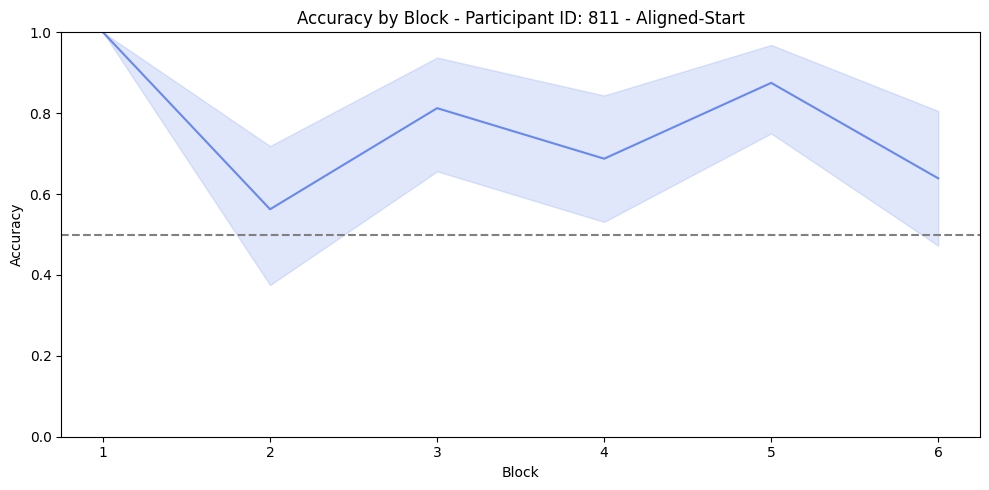

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


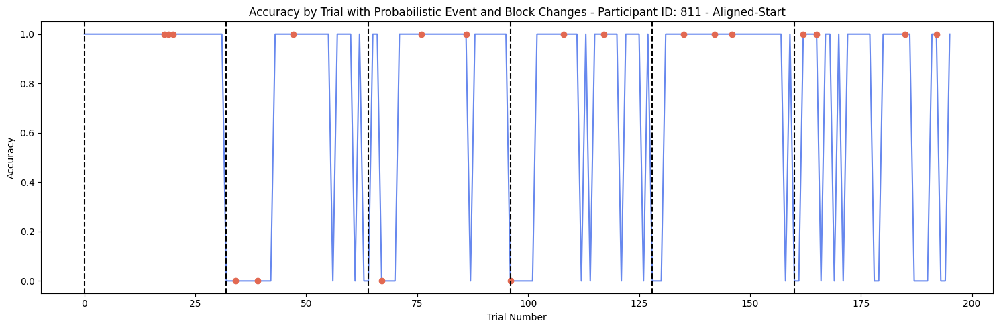

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


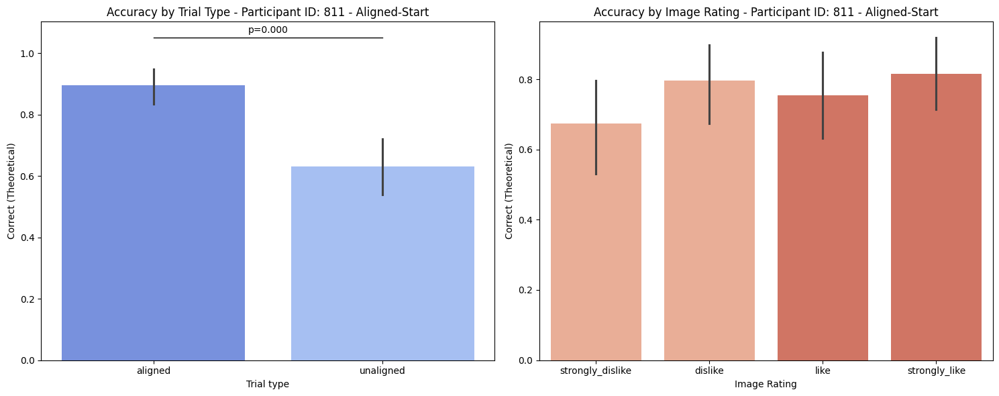

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).


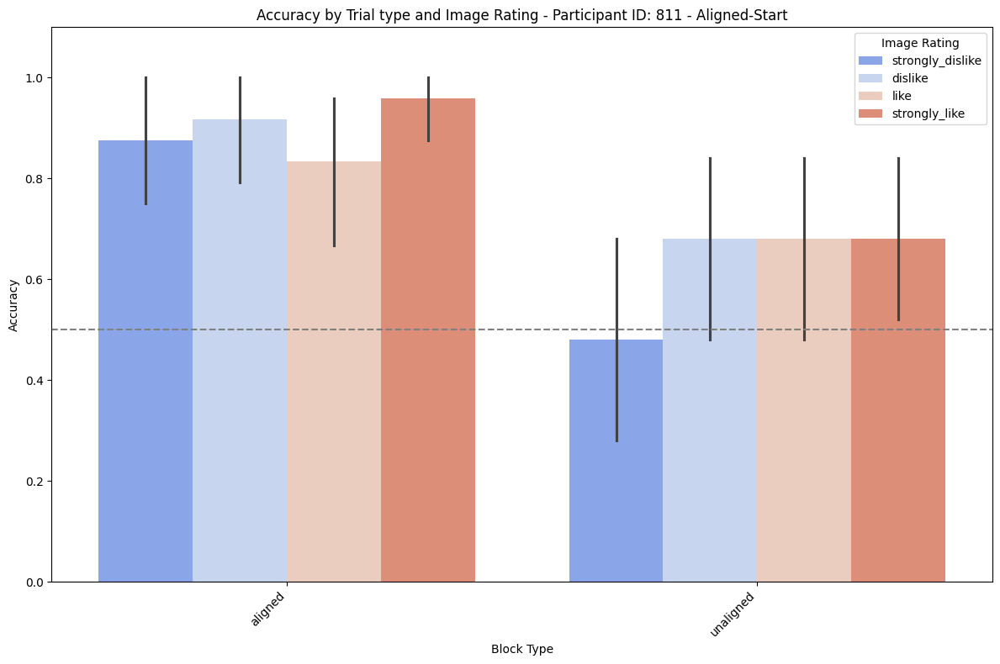

Data for participant 808:
Participant ID: 808

Accuracy in each 'Block':
Block
1    0.625000
2    0.472222
3    0.625000
4    0.777778
5    0.750000
6    0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.666667
unaligned    0.711538
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.49549145971954023

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.625000
            2        0.472222
            3        0.625000
            4        0.777778
            5        0.750000
            6        0.906250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.64
like                0.66
strongly_dislike    0.66
strongly_like       0.80
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.280005783871717
Data for Chi-squared test:
Correct (Binary)   0   1
Image Ratin

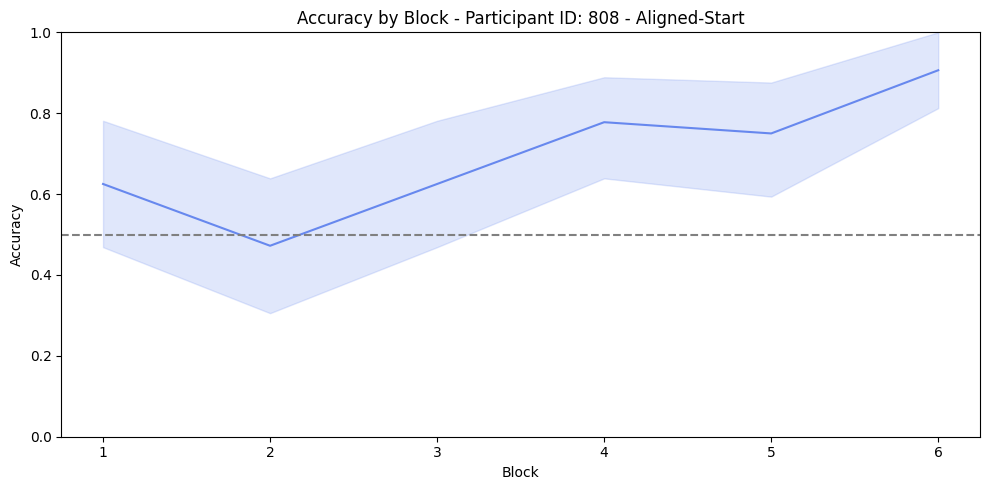

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


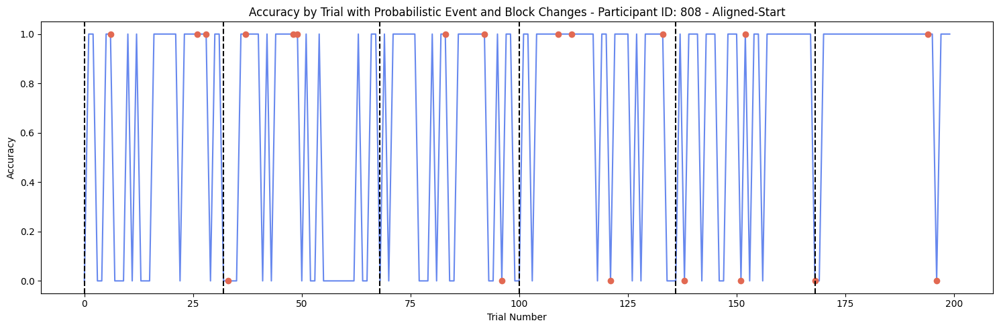

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


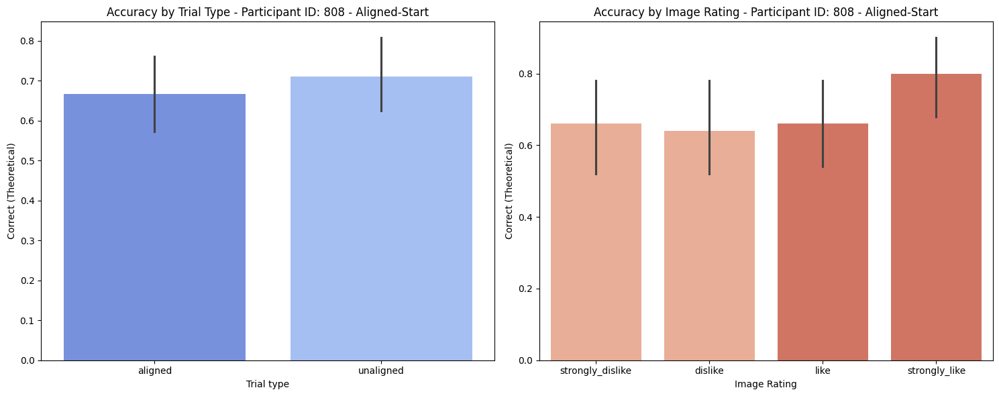

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.015).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.001).


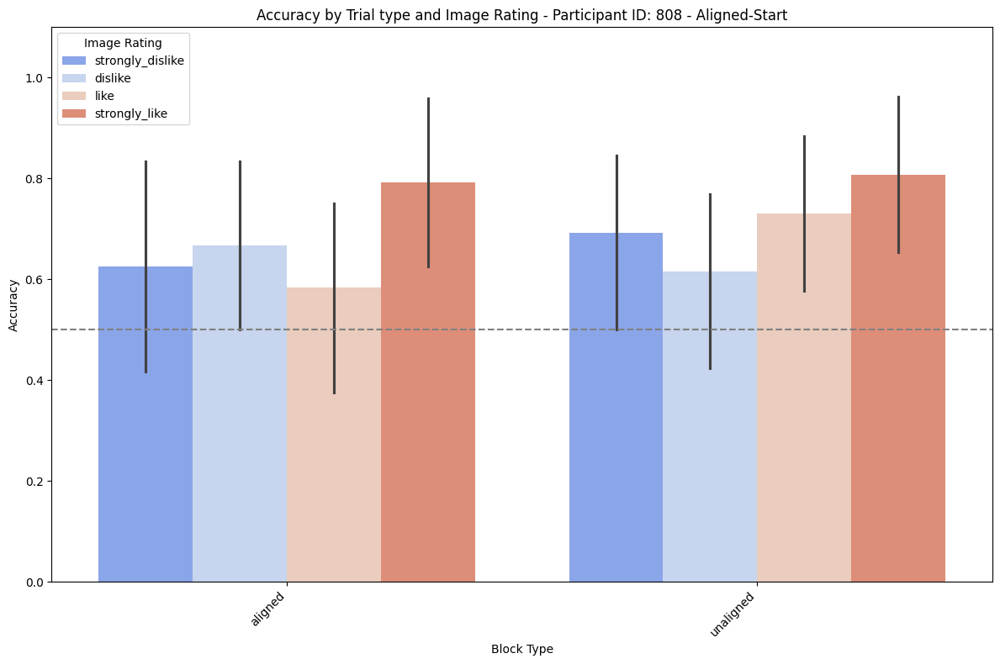

Data for participant 807:
Participant ID: 807

Accuracy in each 'Block':
Block
1    0.718750
2    0.250000
3    0.625000
4    0.187500
5    0.694444
6    0.166667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.680000
unaligned    0.201923
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 2.9284039813562514e-13

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.718750
            2        0.250000
            3        0.625000
            4        0.187500
            5        0.694444
            6        0.166667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.470588
like                0.352941
strongly_dislike    0.392157
strongly_like       0.529412
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.273965371932680
Data for Chi-squared test:
Correct (Binary) 

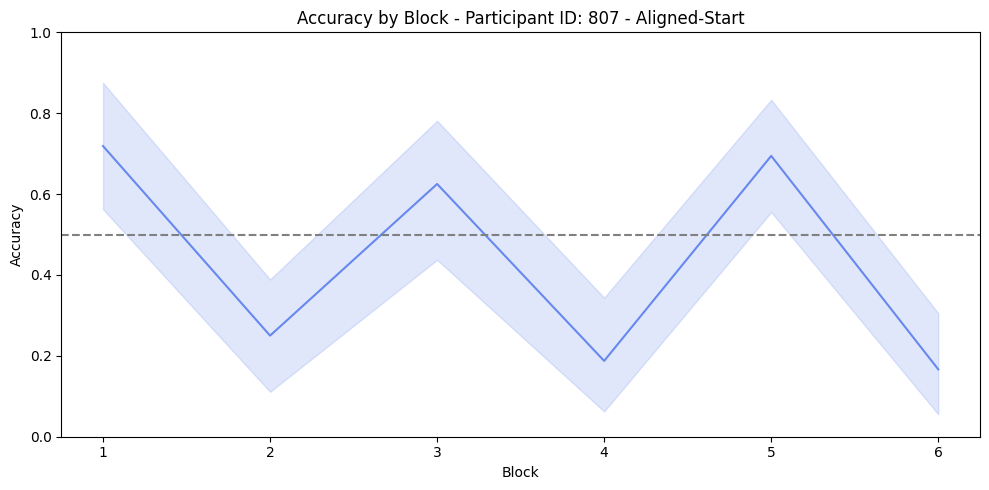

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


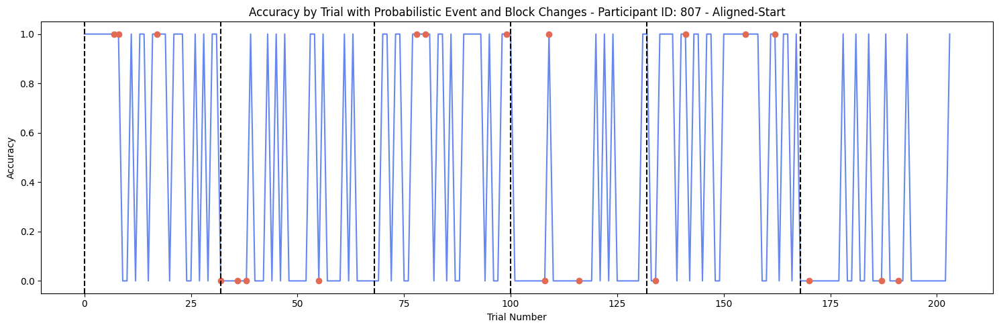

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


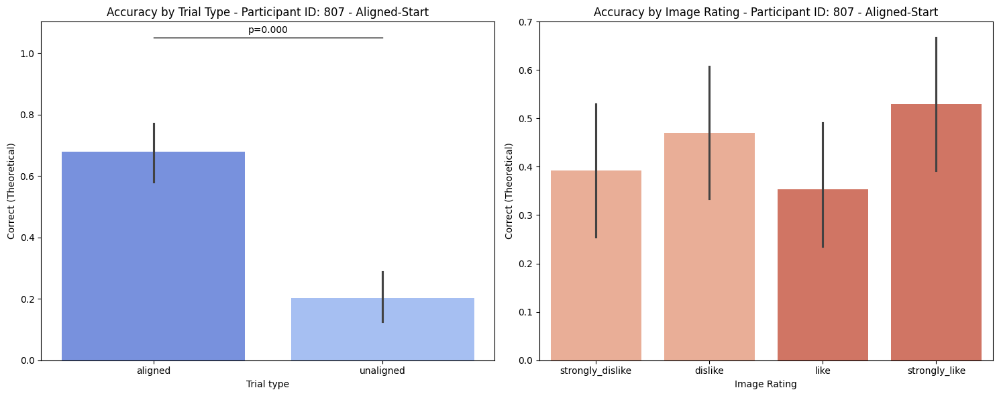

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


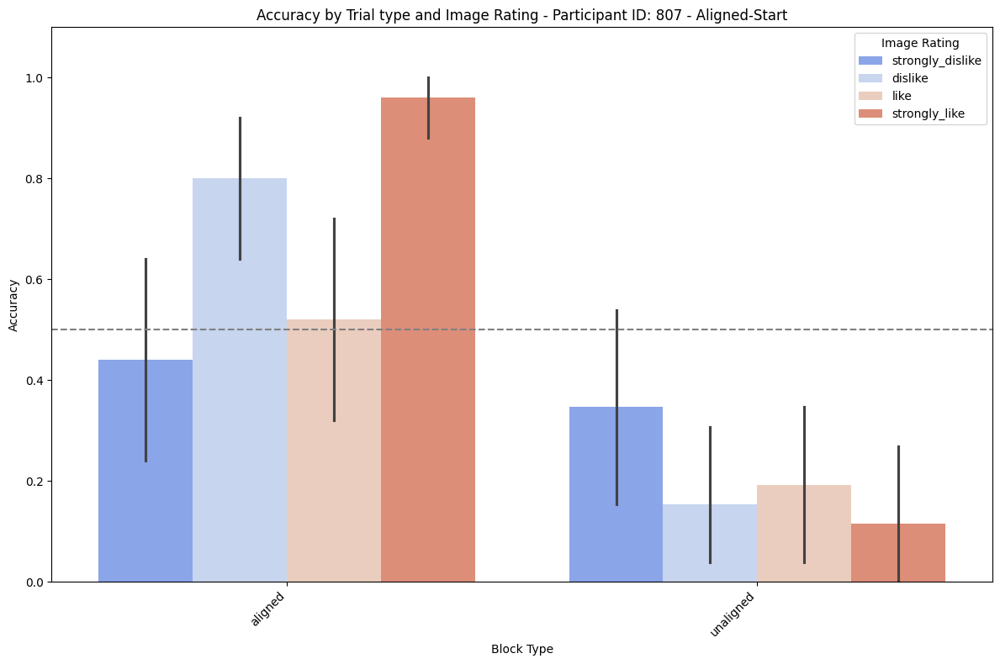

Data for participant 804:
Participant ID: 804

Accuracy in each 'Block':
Block
1    0.666667
2    0.687500
3    0.583333
4    0.555556
5    0.843750
6    0.833333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.692308
unaligned    0.692308
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 1.0

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.666667
            2        0.687500
            3        0.583333
            4        0.555556
            5        0.843750
            6        0.833333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.769231
like                0.673077
strongly_dislike    0.653846
strongly_like       0.673077
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.575294394238898
Data for Chi-squared test:
Correct (Binary)   0   1
Image Ratin

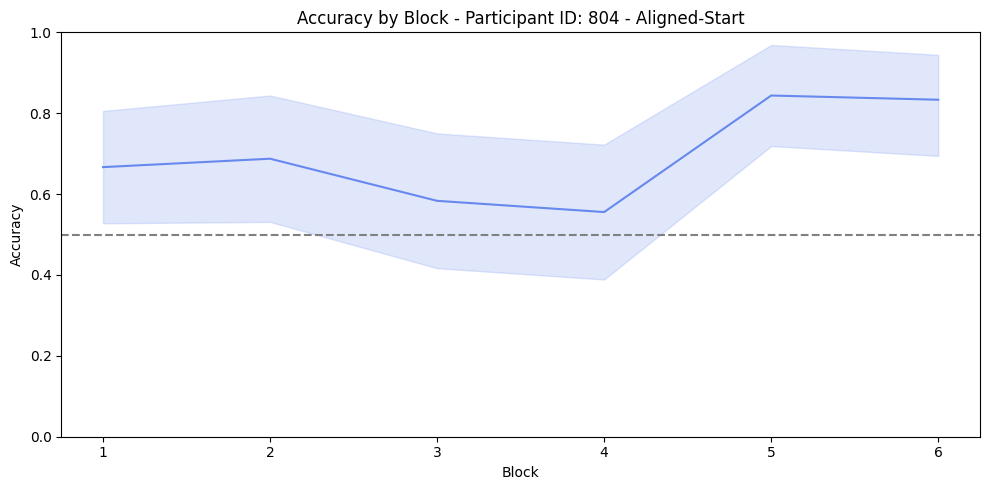

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


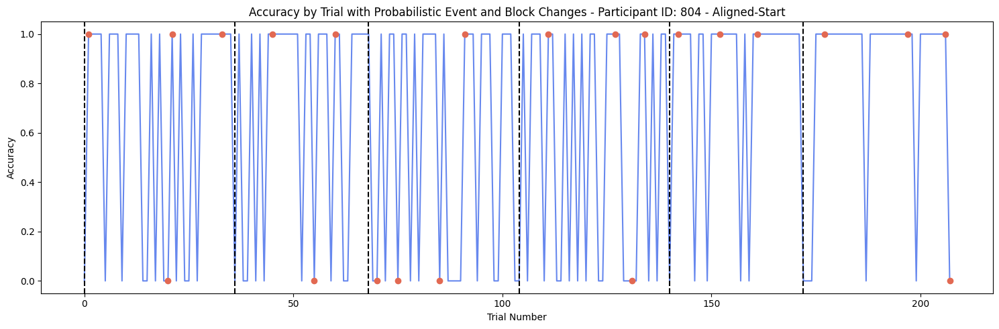

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


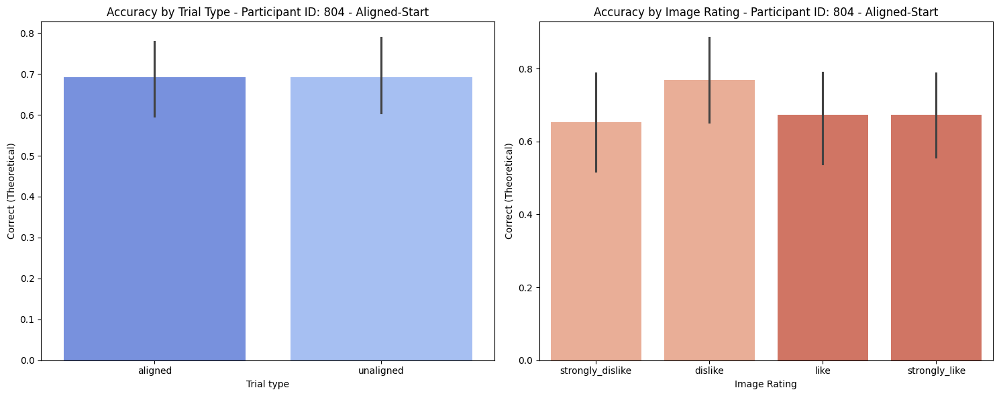

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.015).


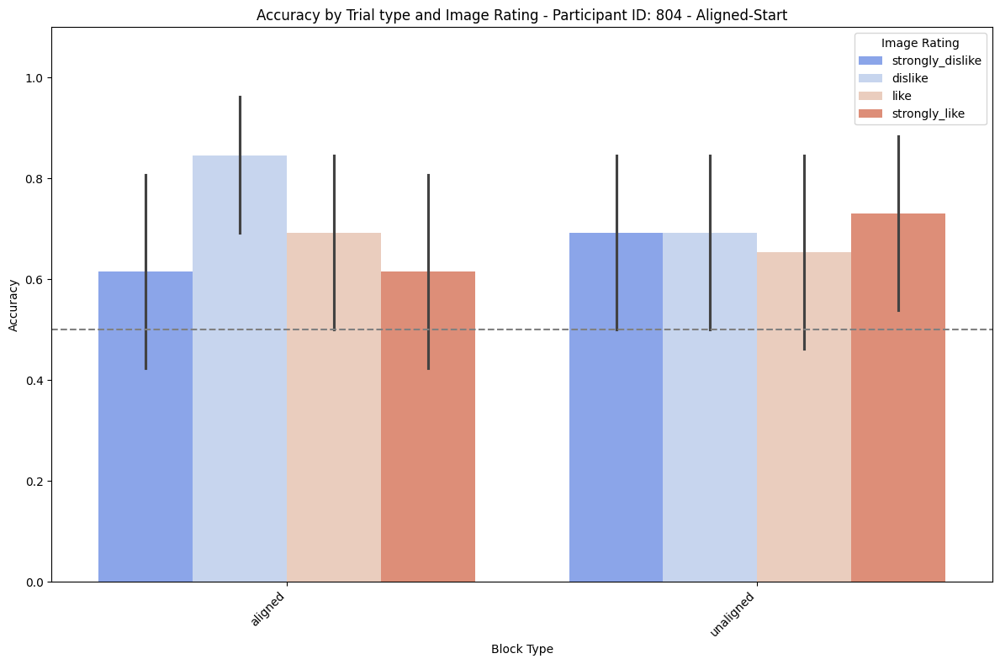

Data for participant 803:
Participant ID: 803

Accuracy in each 'Block':
Block
1    0.750000
2    0.218750
3    0.500000
4    0.437500
5    0.583333
6    0.343750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.605769
unaligned    0.333333
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 9.438645691499514e-05

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.750000
            2        0.218750
            3        0.500000
            4        0.437500
            5        0.583333
            6        0.343750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.46
like                0.54
strongly_dislike    0.38
strongly_like       0.52
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.375305865969430
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rat

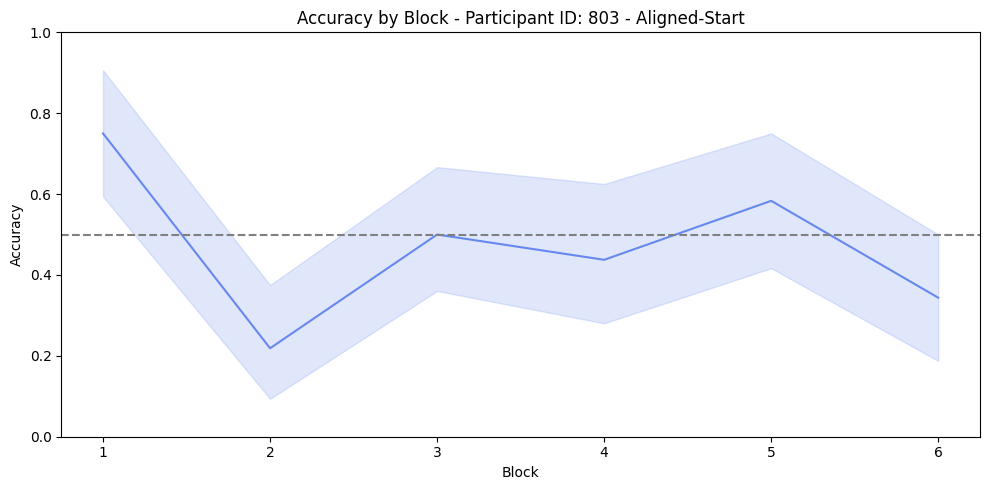

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


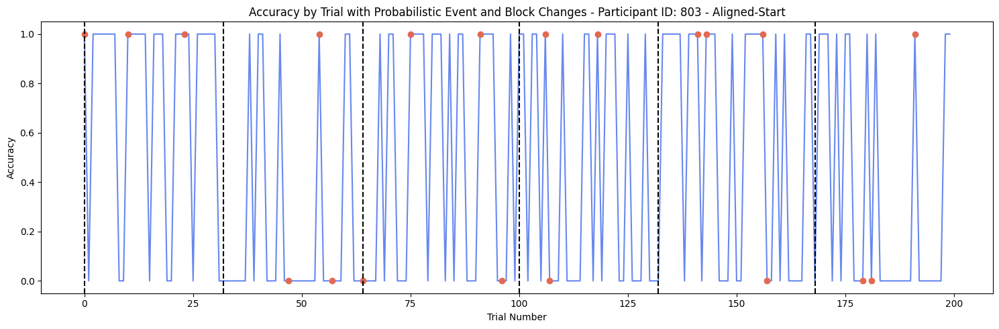

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


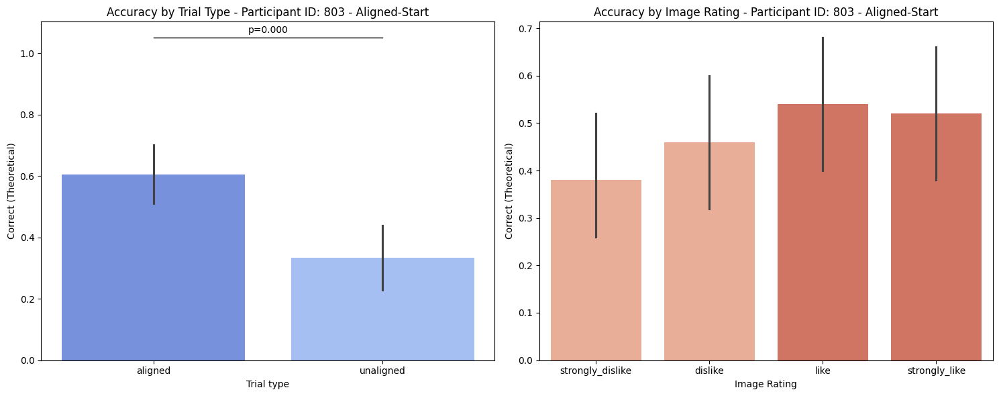

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.002).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.038).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.011).


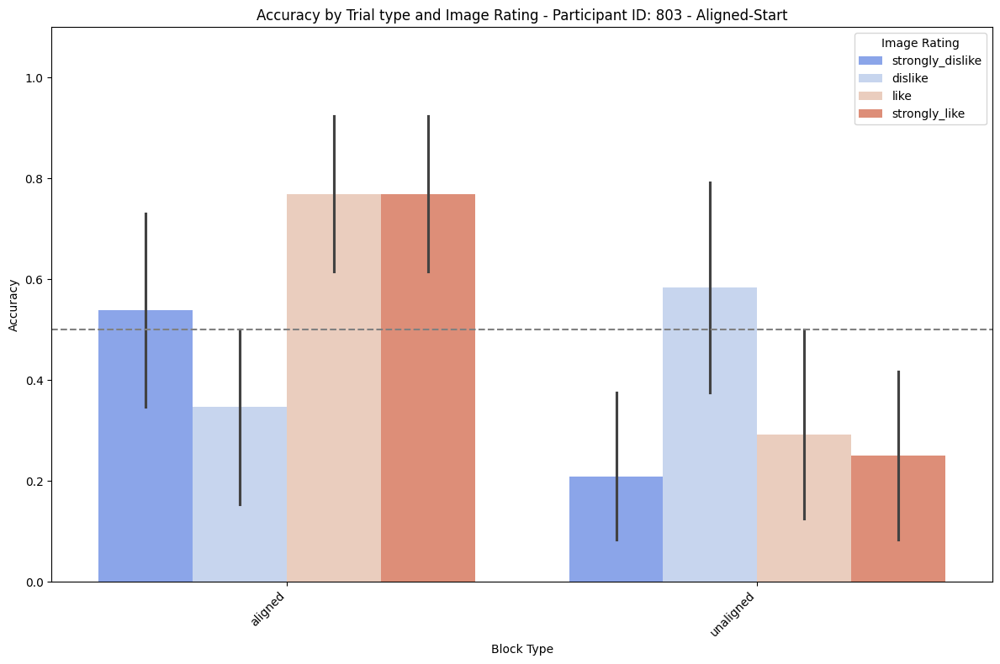

Data for participant 802:
Participant ID: 802

Accuracy in each 'Block':
Block
1    0.718750
2    0.531250
3    0.468750
4    0.305556
5    0.687500
6    0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.625000
unaligned    0.461538
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.02042544314232166

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.718750
            2        0.531250
            3        0.468750
            4        0.305556
            5        0.687500
            6        0.555556
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.60
like                0.58
strongly_dislike    0.60
strongly_like       0.38
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.074349616472031
Data for Chi-squared test:
Correct (Binary)   0   1
Image Ratin

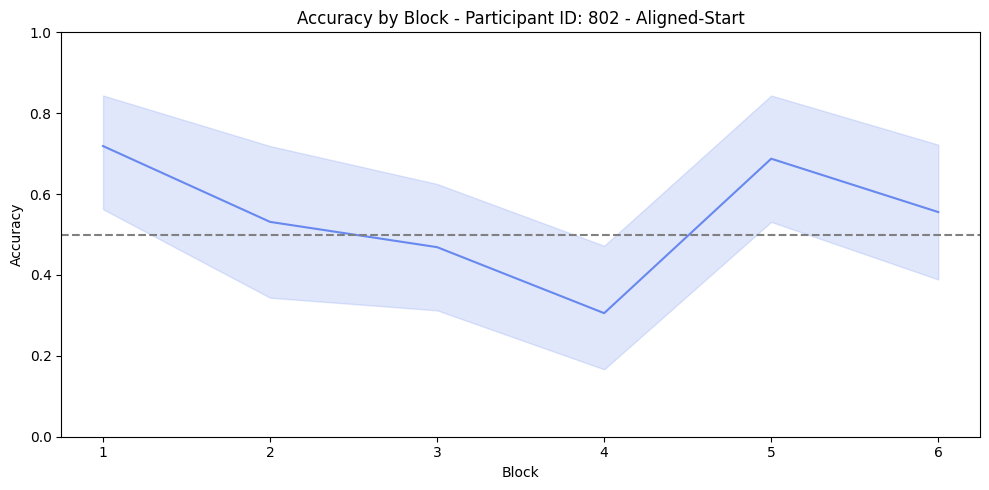

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


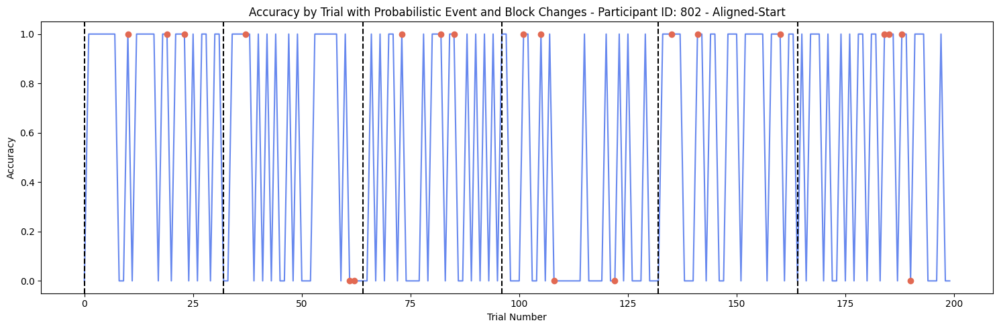

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


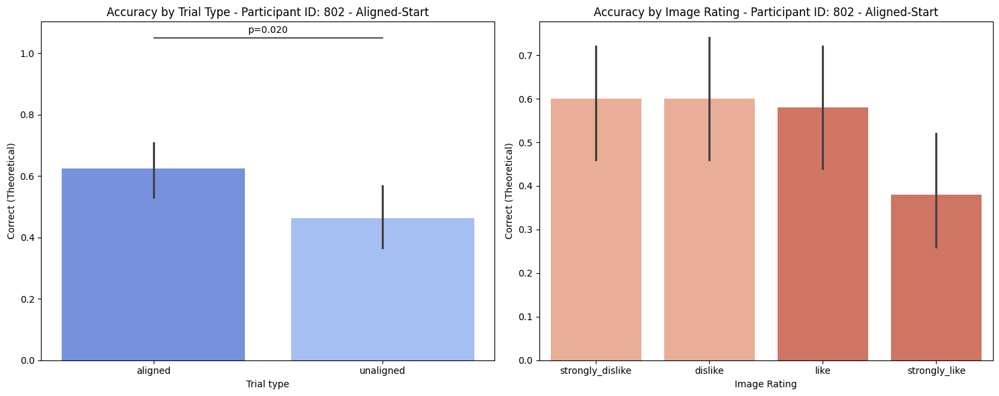

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


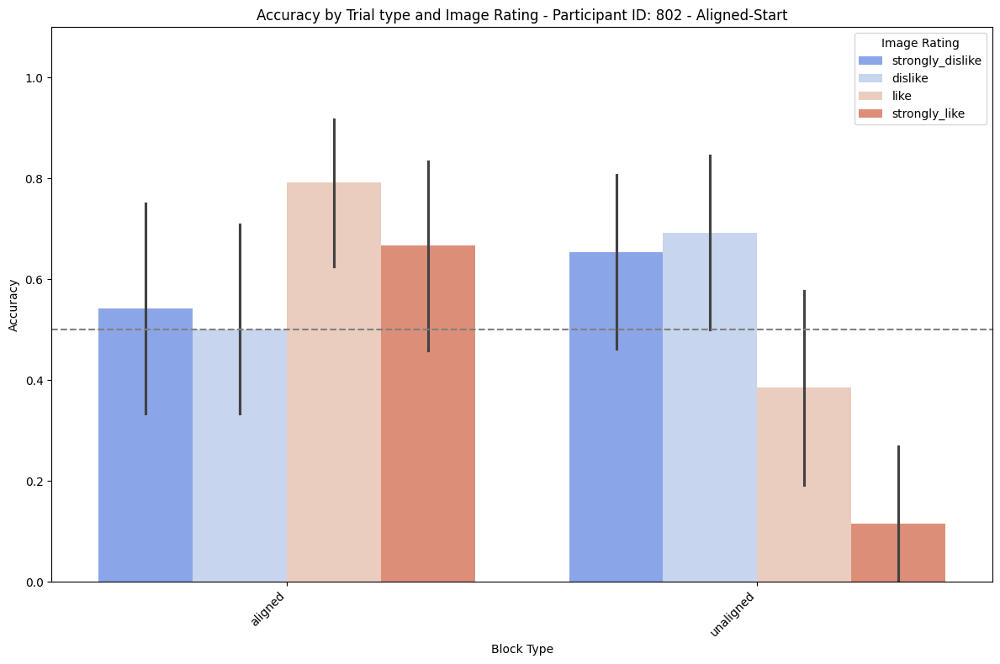

Data for participant 801:
Participant ID: 801

Accuracy in each 'Block':
Block
1    0.875000
2    0.687500
3    0.805556
4    0.593750
5    0.375000
6    0.281250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.690000
unaligned    0.520833
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.01522399580894308

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.875000
            2        0.687500
            3        0.805556
            4        0.593750
            5        0.375000
            6        0.281250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.632653
like                0.591837
strongly_dislike    0.653061
strongly_like       0.551020
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.738168059653586
Data for Chi-squared test:
Correct (Binary)   0

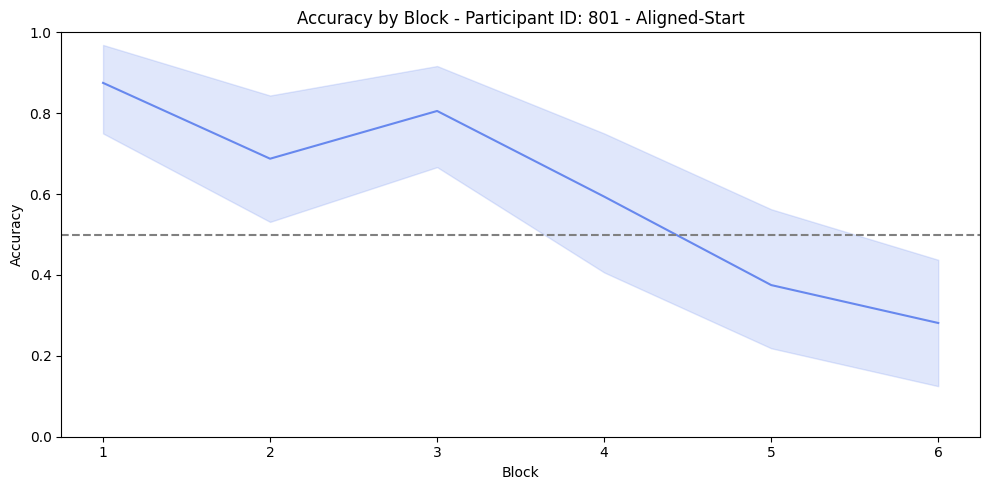

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


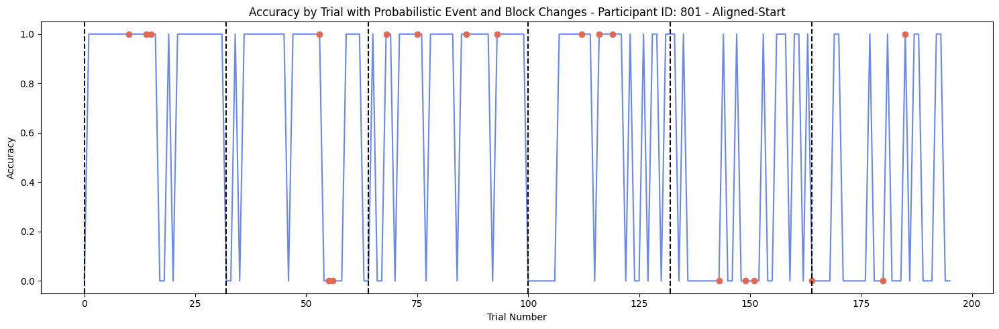

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


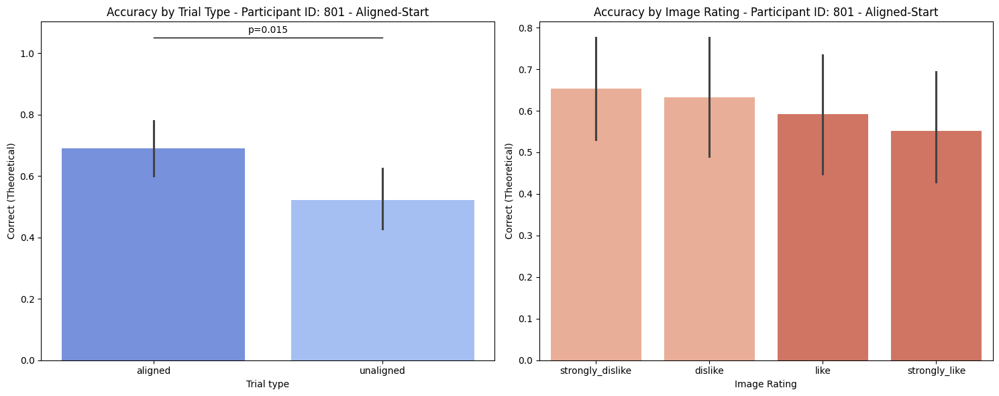

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.024).


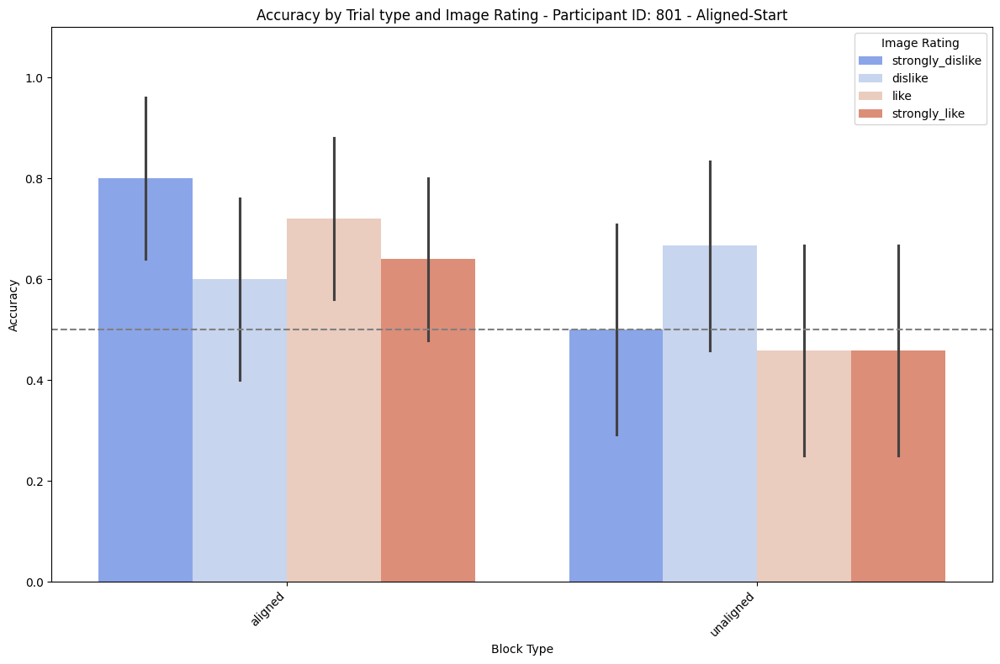

Data for participant 800:
Participant ID: 800

Accuracy in each 'Block':
Block
1    0.777778
2    0.875000
3    0.888889
4    0.833333
5    0.750000
6    0.718750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.805556
unaligned    0.810000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.9356241796999477

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.777778
            2        0.875000
            3        0.888889
            4        0.833333
            5        0.750000
            6        0.718750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.807692
like                0.807692
strongly_dislike    0.807692
strongly_like       0.807692
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 1.000000000000000
Data for Chi-squared test:
Correct (Binary)   0 

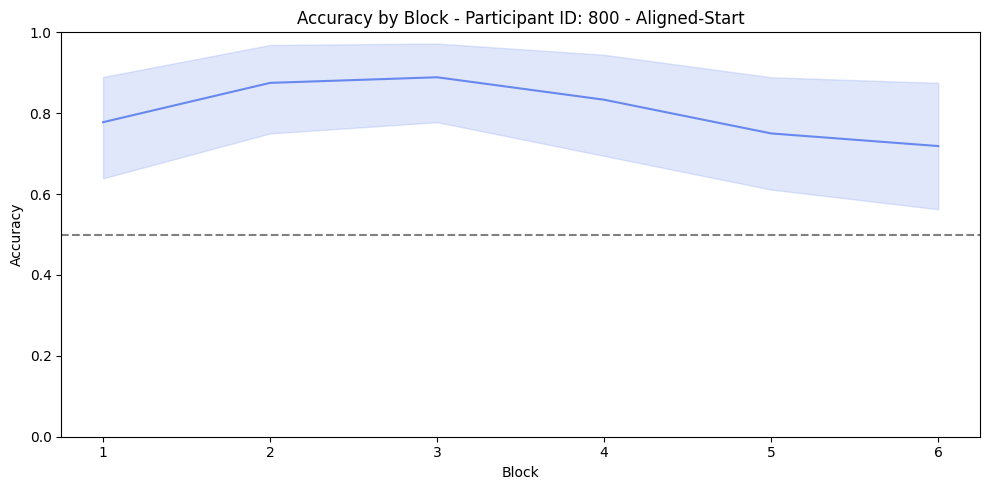

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


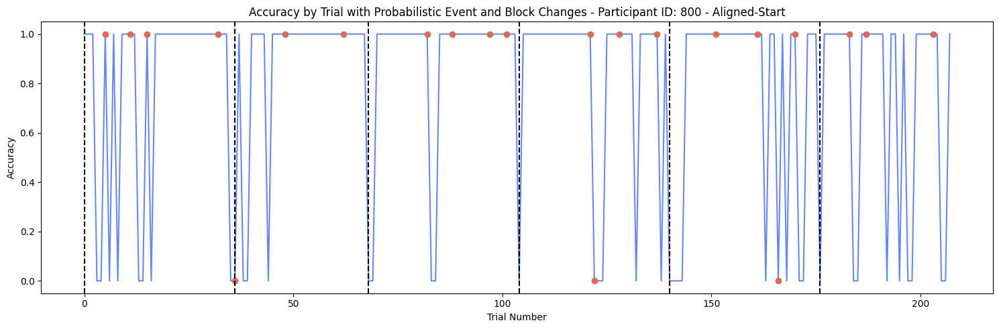

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


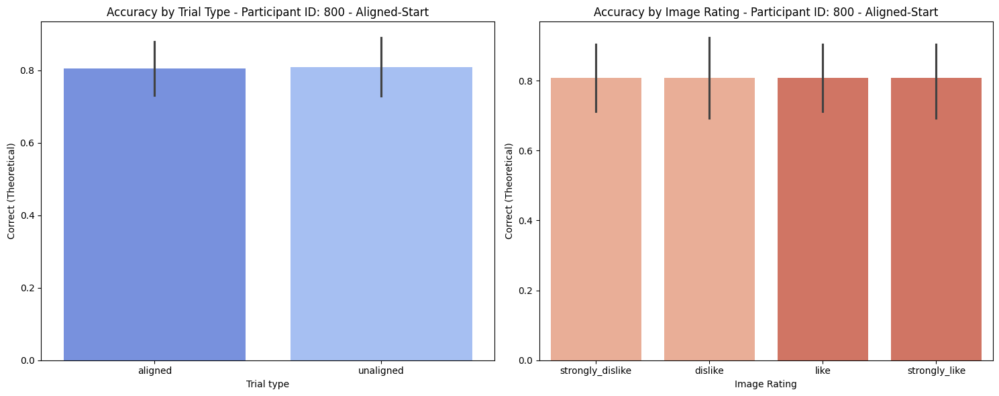

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.009).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.024).


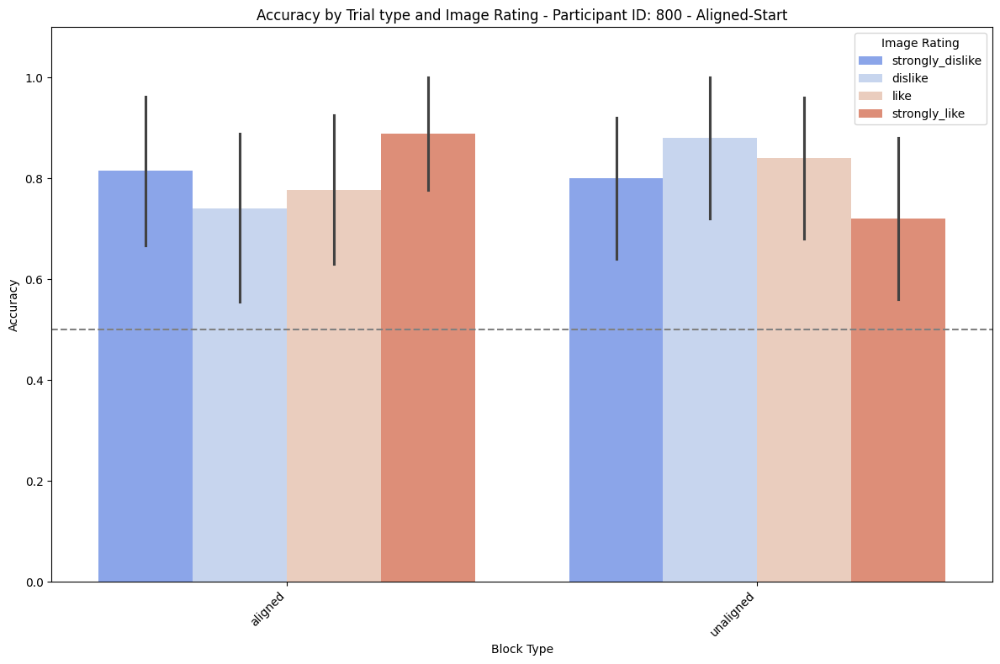

Data for participant 799:
Participant ID: 799

Accuracy in each 'Block':
Block
1    0.611111
2    0.527778
3    0.555556
4    0.500000
5    0.468750
6    0.468750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.548077
unaligned    0.500000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.49426404377245736

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.611111
            2        0.527778
            3        0.555556
            4        0.500000
            5        0.468750
            6        0.468750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.450980
like                0.509804
strongly_dislike    0.509804
strongly_like       0.627451
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.339240043374301
Data for Chi-squared test:
Correct (Binary)   0

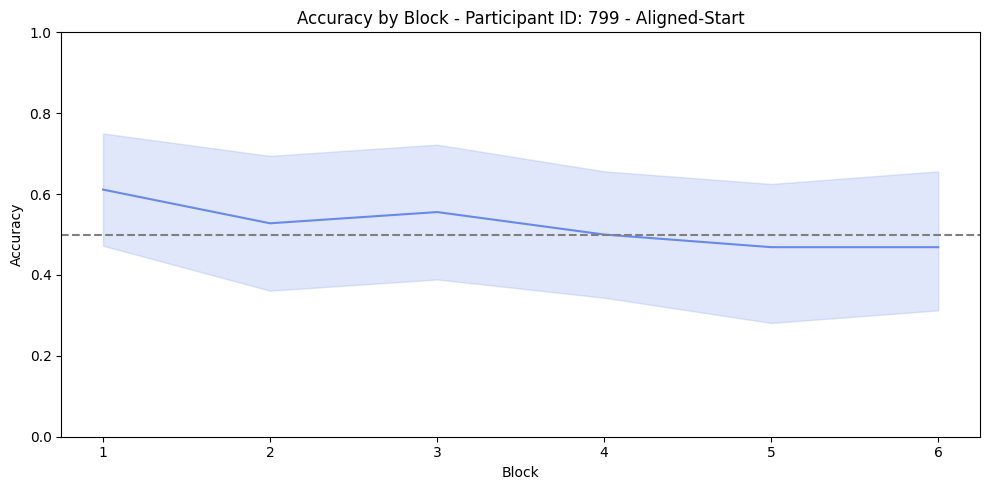

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


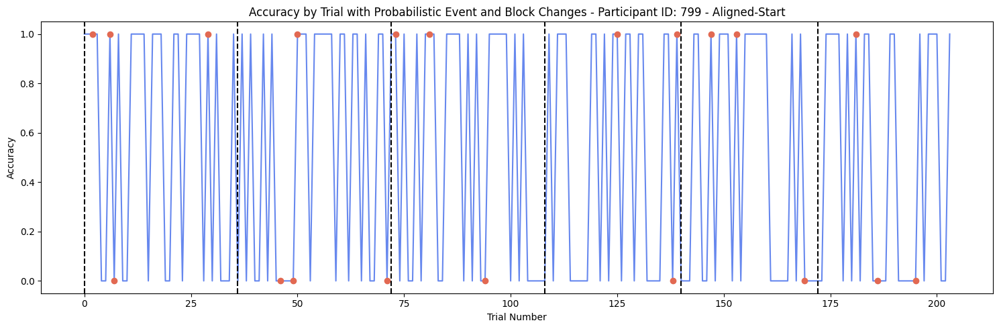

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


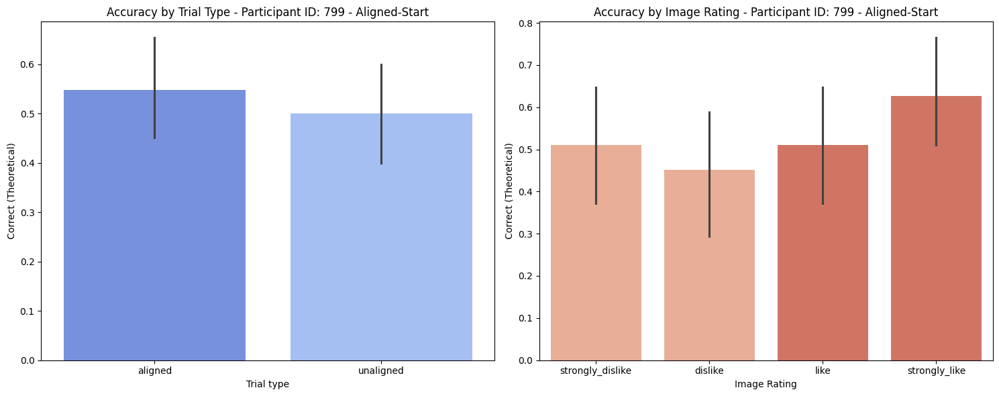

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.004).


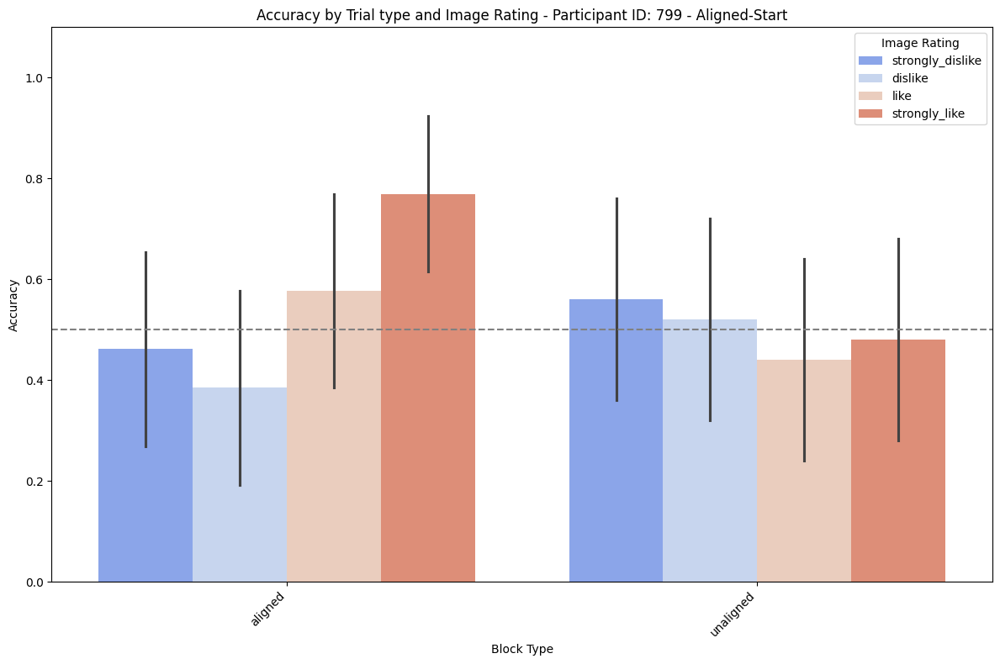

Data for participant 798:
Participant ID: 798

Accuracy in each 'Block':
Block
1    0.888889
2    0.694444
3    0.611111
4    0.500000
5    0.500000
6    0.218750
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.673077
unaligned    0.480000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.005084357491735923

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.888889
            2        0.694444
            3        0.611111
            4        0.500000
            5        0.500000
            6        0.218750
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.529412
like                0.568627
strongly_dislike    0.627451
strongly_like       0.588235
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.790285471102168
Data for Chi-squared test:
Correct (Binary)   

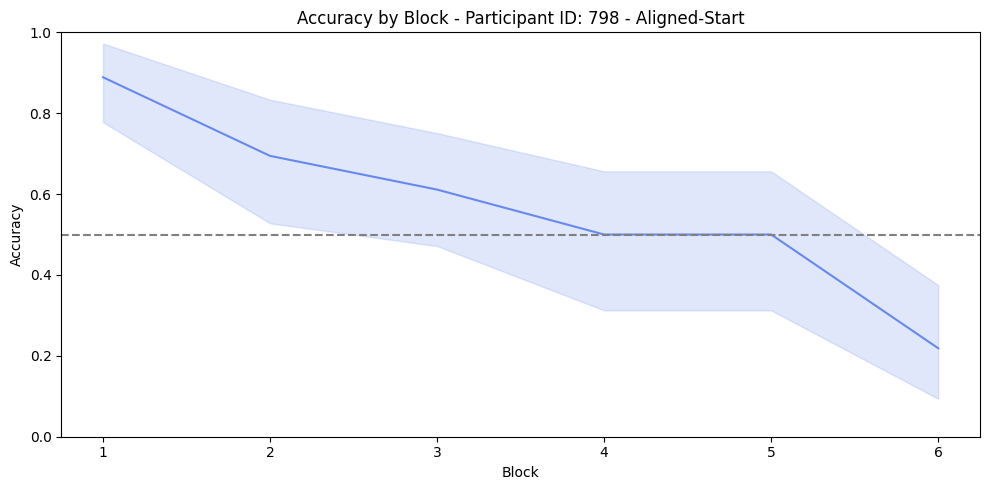

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


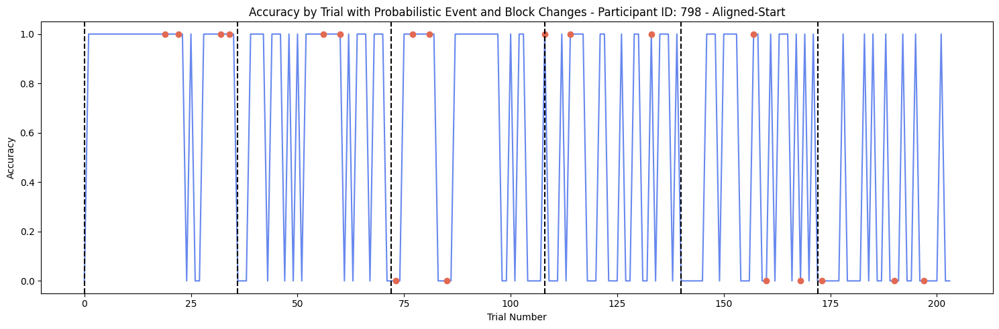

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


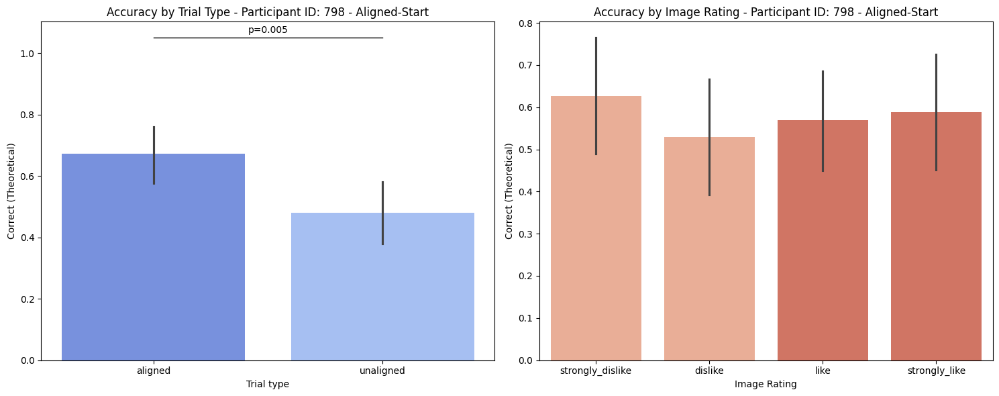

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).


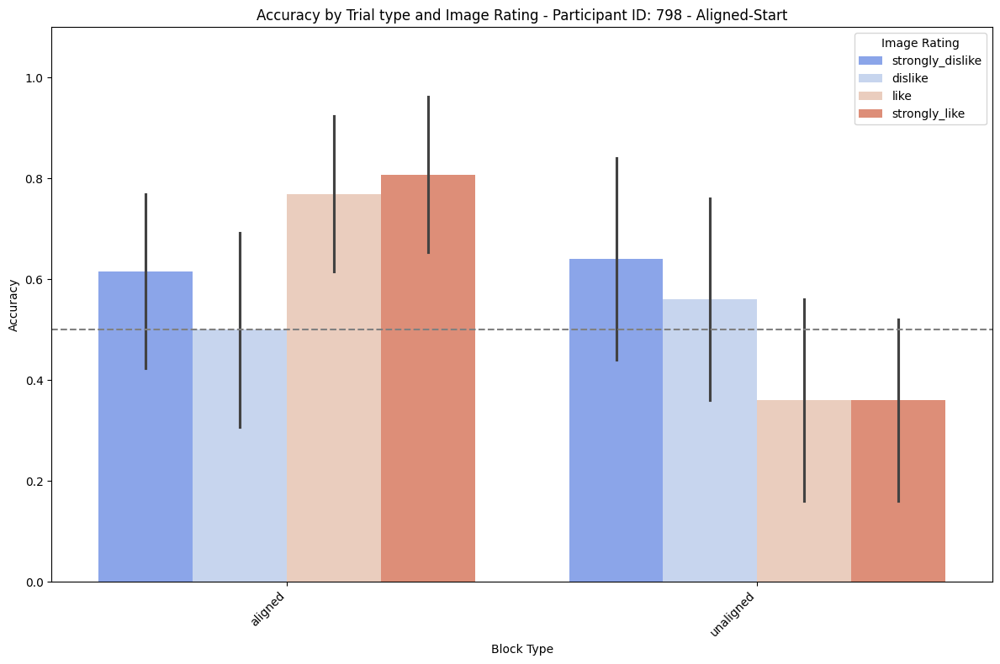

Data for participant 794:
Participant ID: 794

Accuracy in each 'Block':
Block
1    0.638889
2    0.777778
3    0.687500
4    0.361111
5    0.593750
6    0.444444
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.640000
unaligned    0.527778
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.10209780208383593

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.638889
            2        0.777778
            3        0.687500
            4        0.361111
            5        0.593750
            6        0.444444
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.576923
like                0.596154
strongly_dislike    0.634615
strongly_like       0.519231
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.686453206237081
Data for Chi-squared test:
Correct (Binary)   0

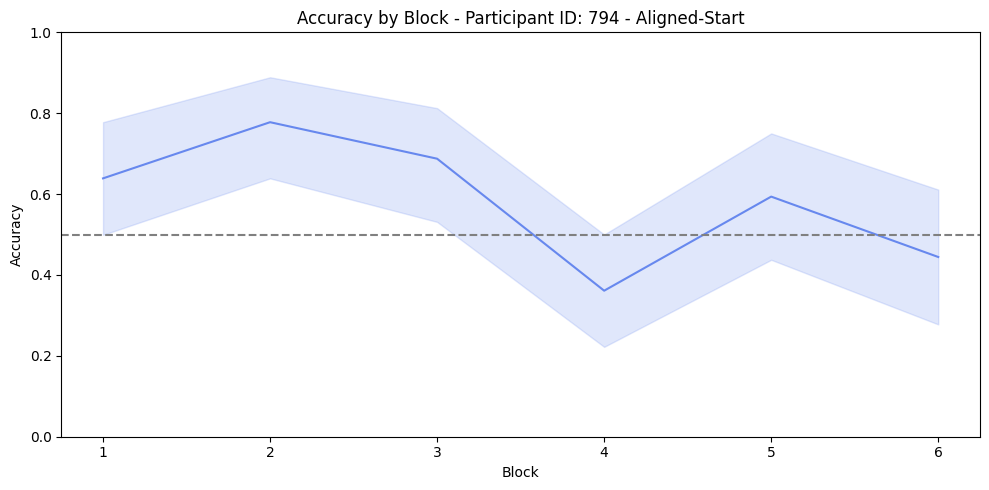

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


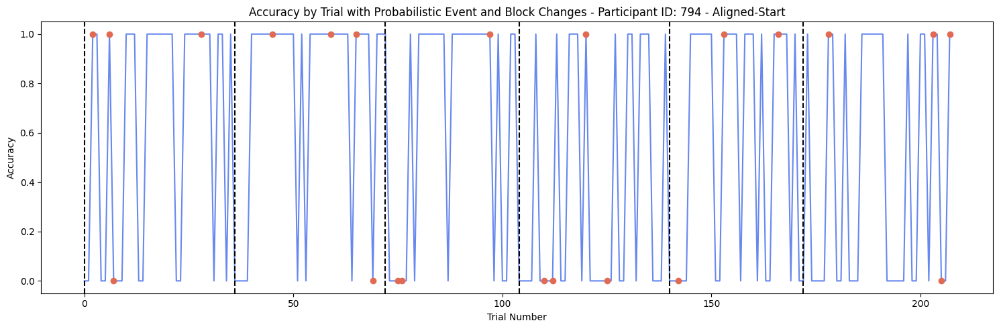

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


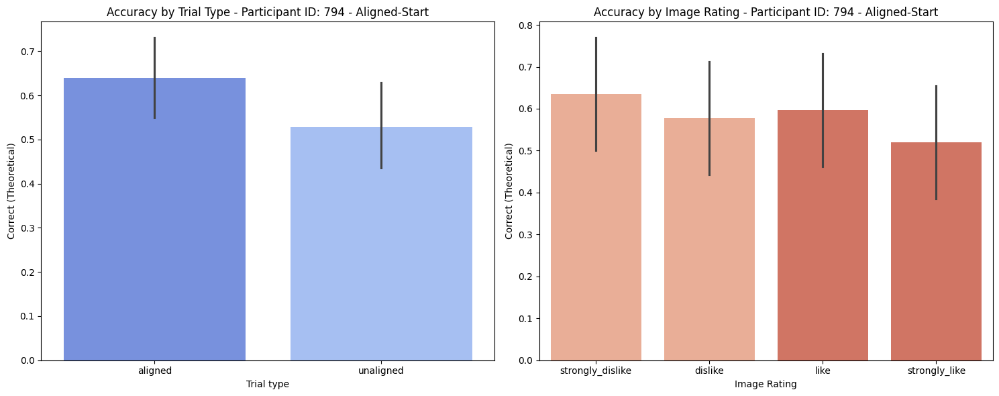

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'like' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.009).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.031).


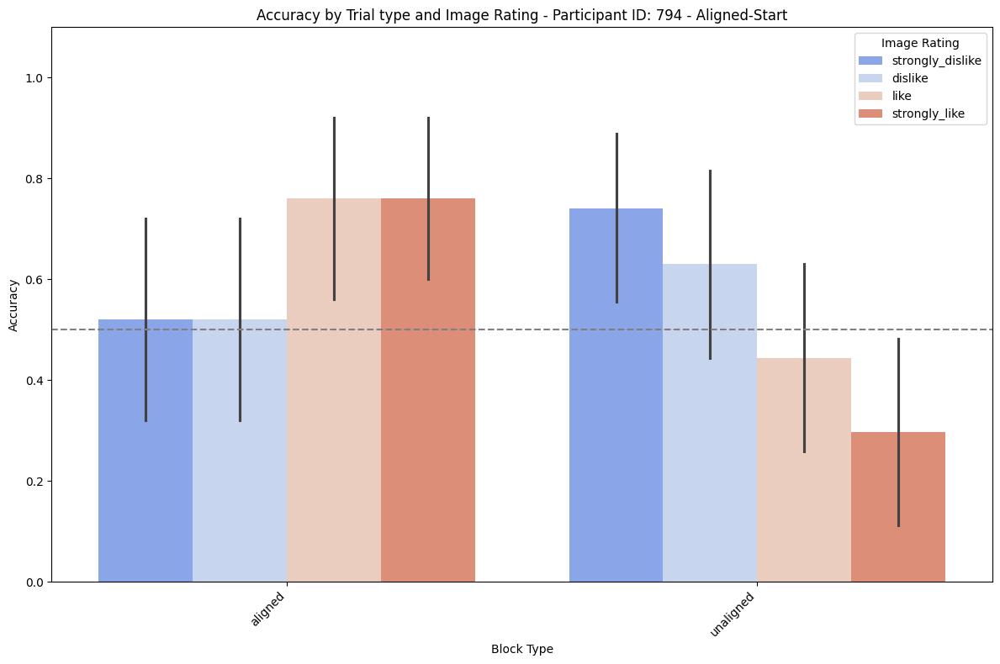

Data for participant 848:
Participant ID: 848

Accuracy in each 'Block':
Block
1    0.472222
2    0.406250
3    0.531250
4    0.361111
5    0.468750
6    0.694444
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.490385
unaligned    0.490000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.9956438506027843

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.472222
            2        0.406250
            3        0.531250
            4        0.361111
            5        0.468750
            6        0.694444
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.490196
like                0.529412
strongly_dislike    0.490196
strongly_like       0.450980
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.890064609589899
Data for Chi-squared test:
Correct (Binary)   0 

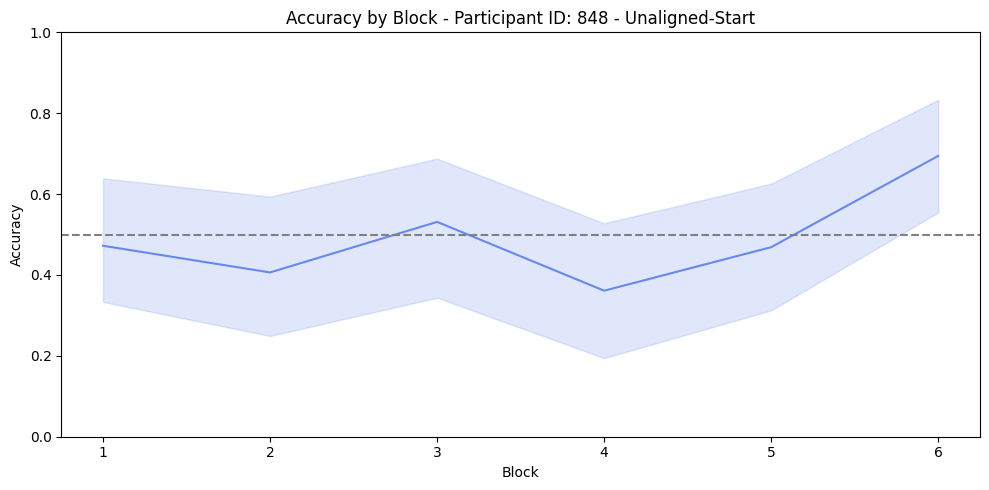

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


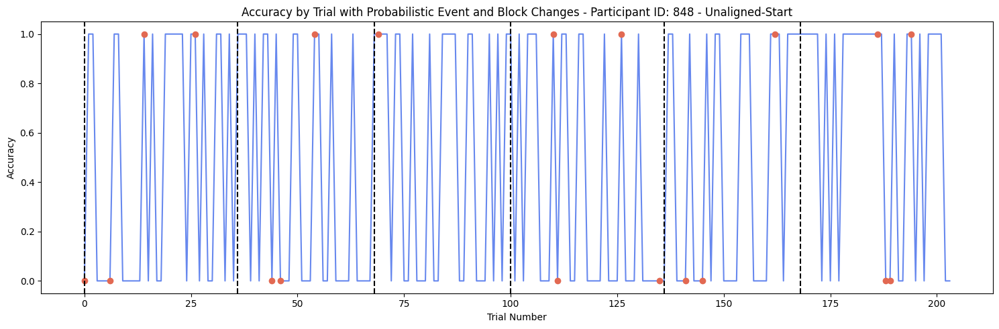

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


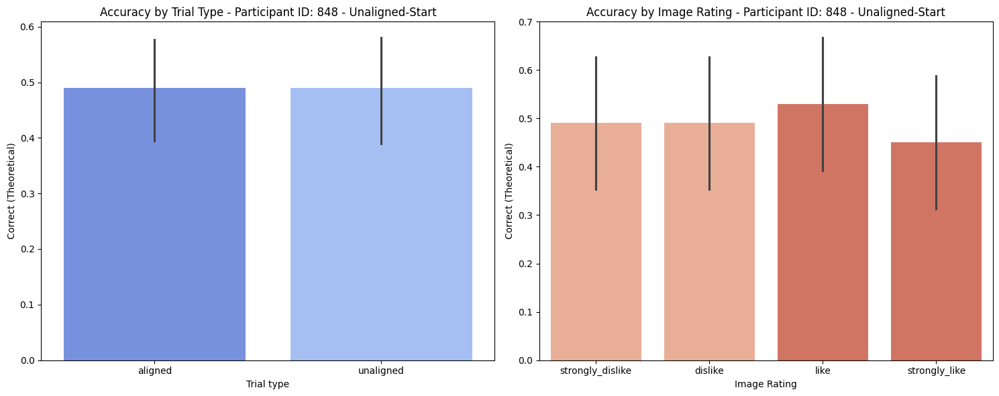

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.048).


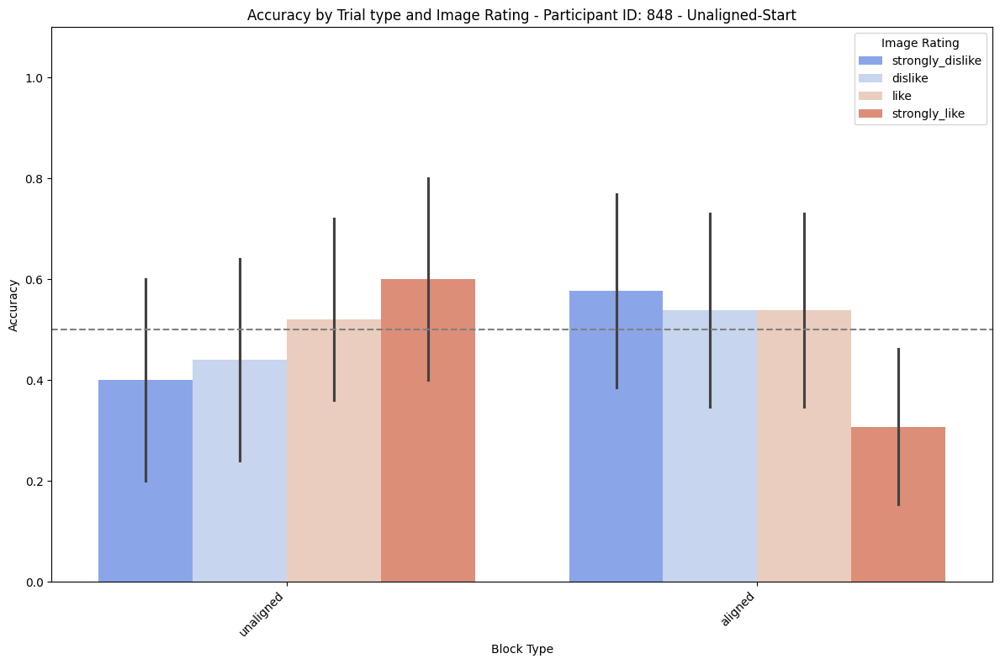

Data for participant 844:
Participant ID: 844

Accuracy in each 'Block':
Block
1    0.218750
2    0.500000
3    0.333333
4    0.437500
5    0.531250
6    0.281250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.40625
unaligned    0.36000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.5079191743108459

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.218750
            2        0.500000
            3        0.333333
            4        0.437500
            5        0.531250
            6        0.281250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.408163
like                0.387755
strongly_dislike    0.265306
strongly_like       0.469388
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.207250244795731
Data for Chi-squared test:
Correct (Binary)   0   

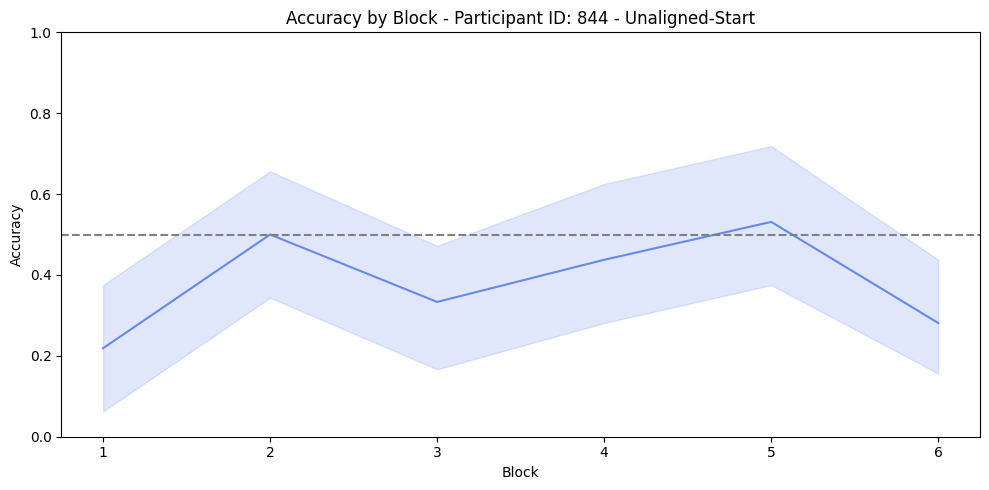

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


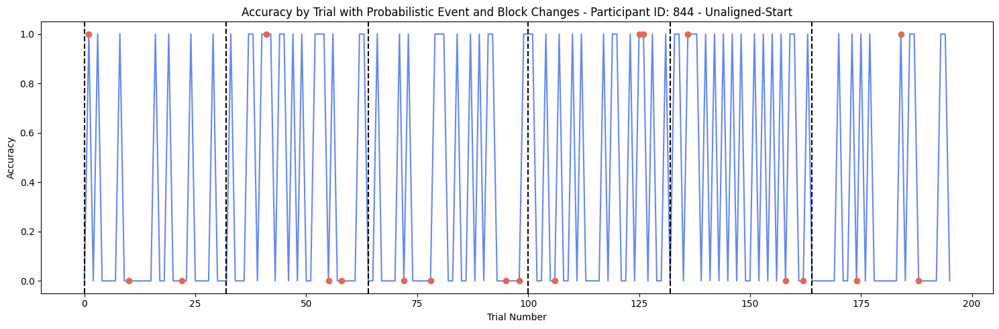

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


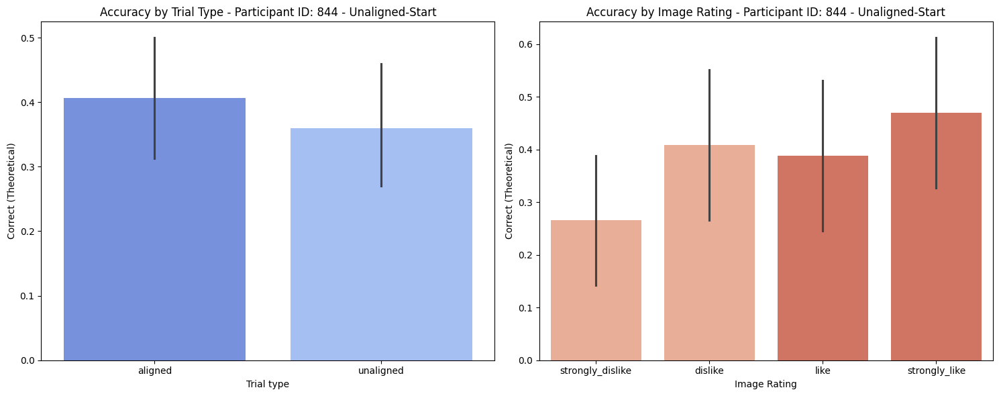

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.011).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.011).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.024).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.001).


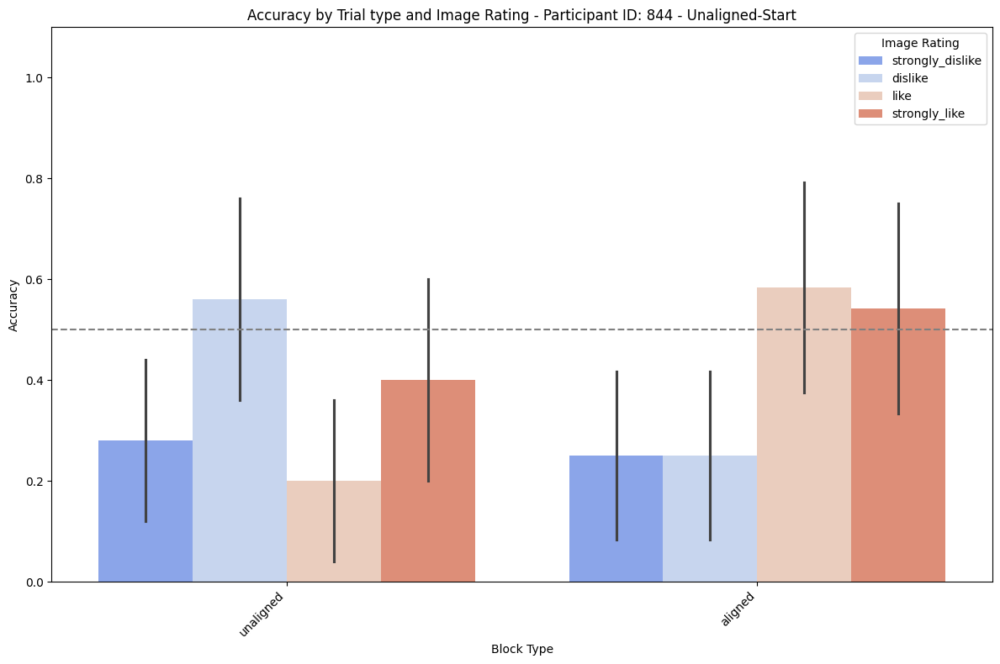

Data for participant 843:
Participant ID: 843

Accuracy in each 'Block':
Block
1    0.833333
2    0.750000
3    0.777778
4    0.833333
5    0.937500
6    0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.798077
unaligned    0.846154
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.3670557679700365

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.833333
            2        0.750000
            3        0.777778
            4        0.833333
            5        0.937500
            6        0.812500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.846154
like                0.826923
strongly_dislike    0.826923
strongly_like       0.788462
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.890772708454801
Data for Chi-squared test:
Correct (Binary)   0 

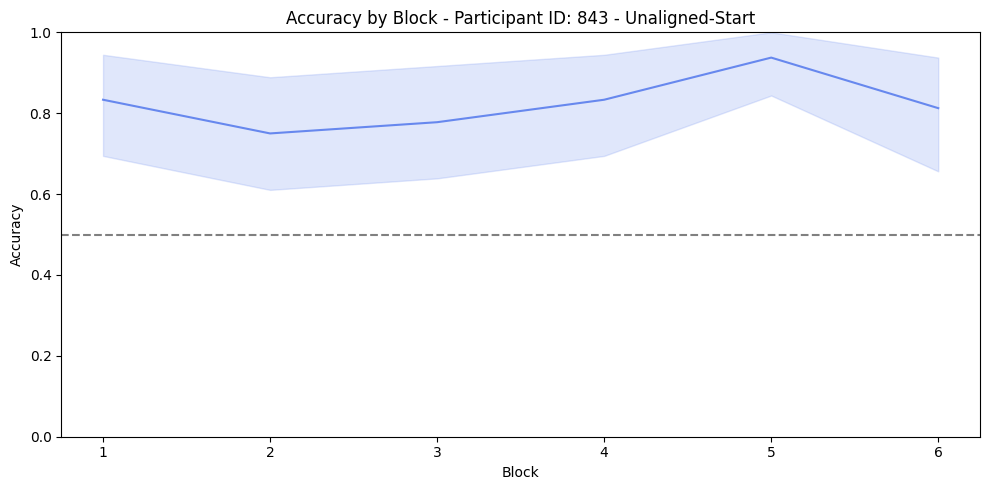

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


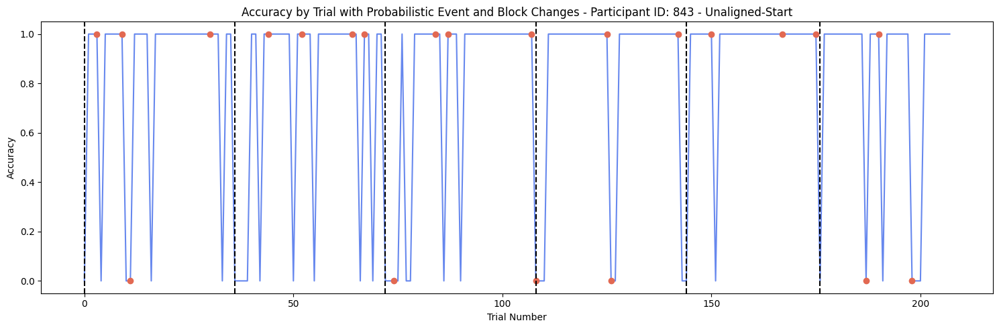

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


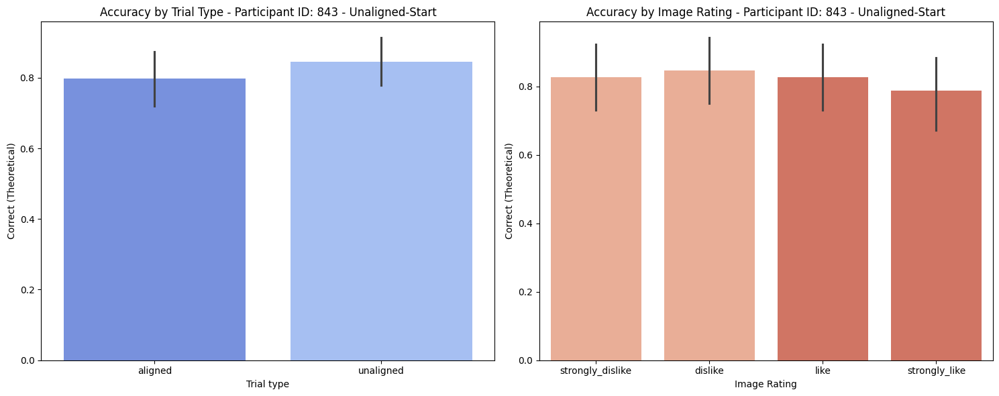

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.004).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.004).


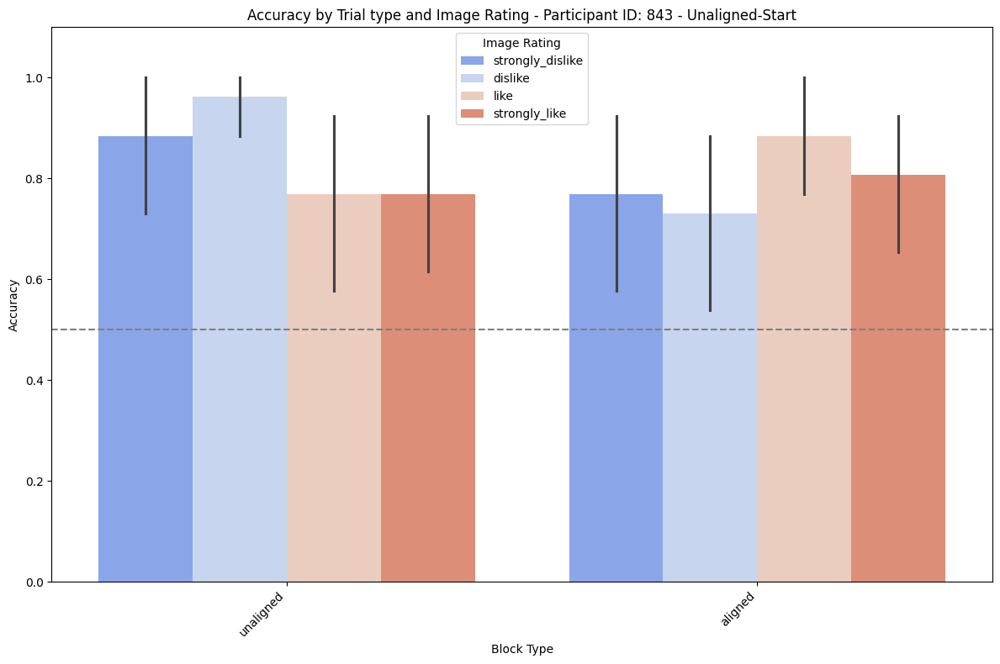

Data for participant 841:
Participant ID: 841

Accuracy in each 'Block':
Block
1    0.500000
2    0.468750
3    0.555556
4    0.468750
5    0.312500
6    0.416667
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.45
unaligned    0.46
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.8877821557443619

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.500000
            2        0.468750
            3        0.555556
            4        0.468750
            5        0.312500
            6        0.416667
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.52
like                0.36
strongly_dislike    0.52
strongly_like       0.42
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.287331306248685
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating        

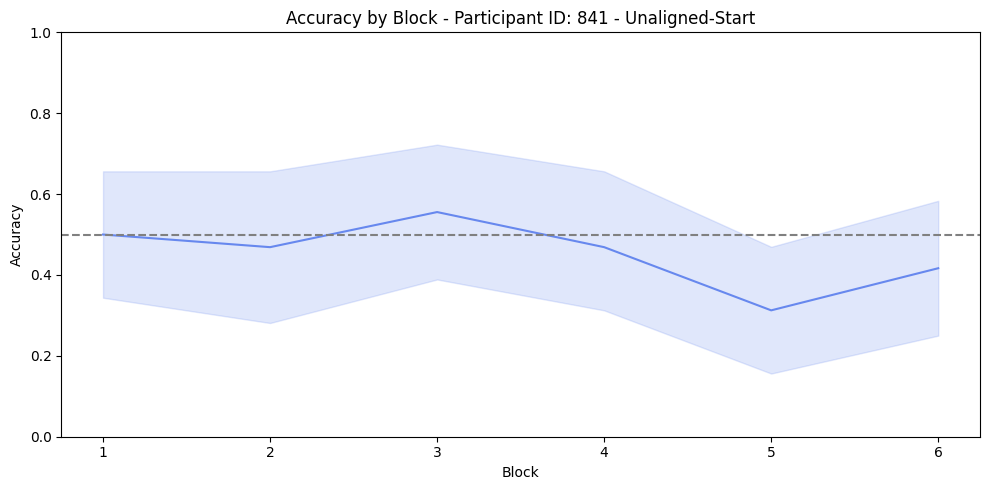

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


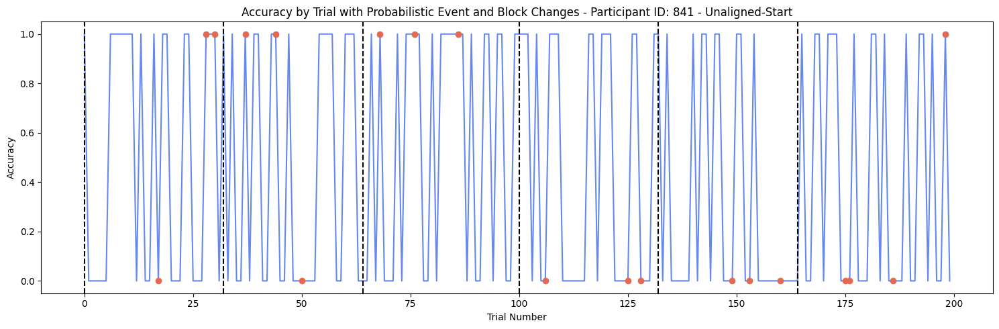

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


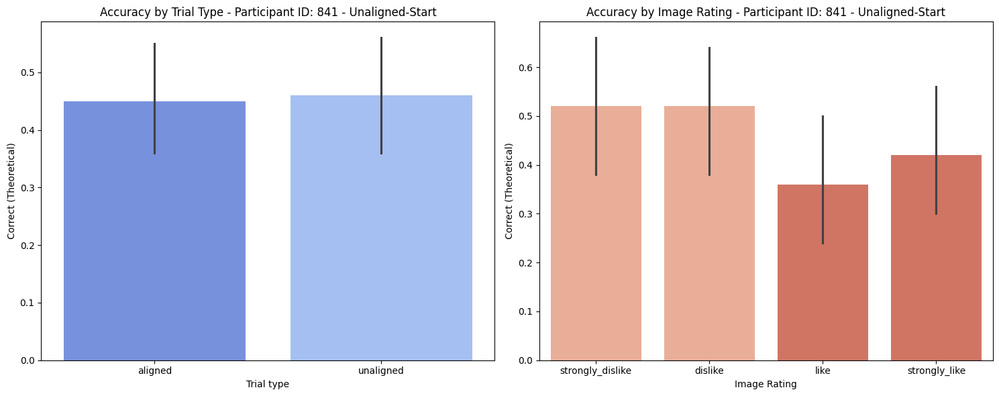

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


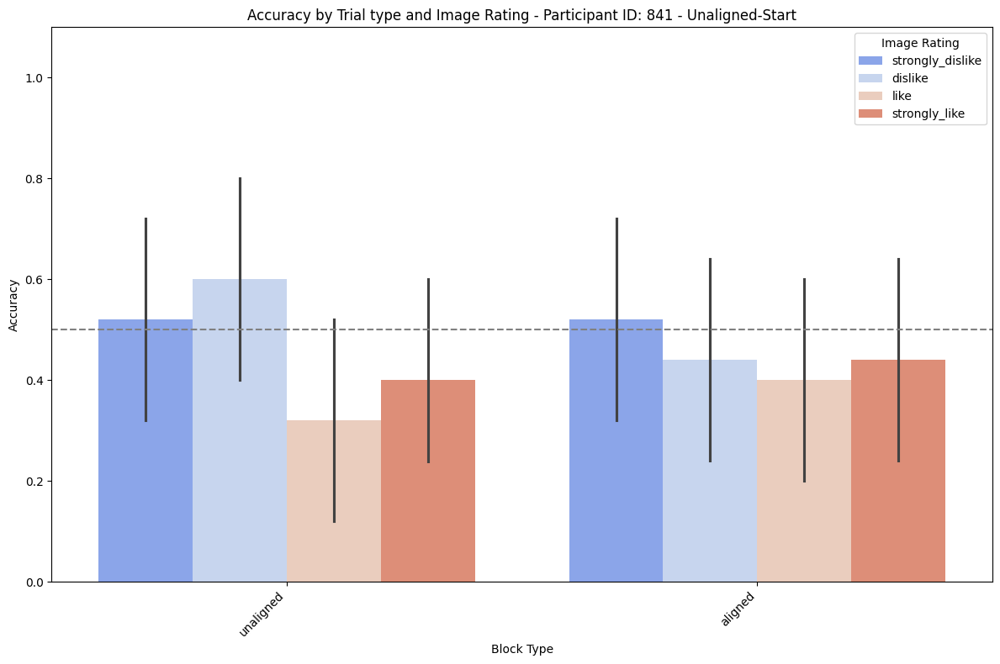

Data for participant 840:
Participant ID: 840

Accuracy in each 'Block':
Block
1    0.416667
2    0.500000
3    0.527778
4    0.444444
5    0.388889
6    0.305556
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.416667
unaligned    0.444444
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.6818555372250039

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.416667
            2        0.500000
            3        0.527778
            4        0.444444
            5        0.388889
            6        0.305556
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.500000
like                0.388889
strongly_dislike    0.407407
strongly_like       0.425926
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.666833714382942
Data for Chi-squared test:
Correct (Binary)   0 

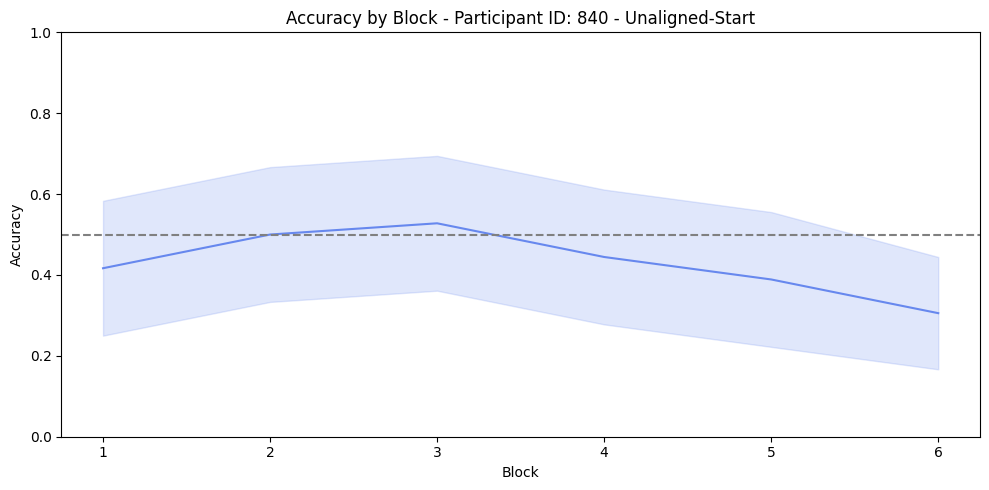

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


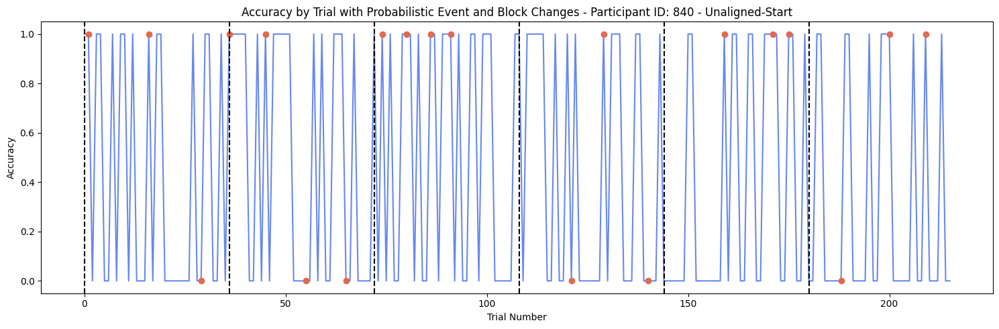

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


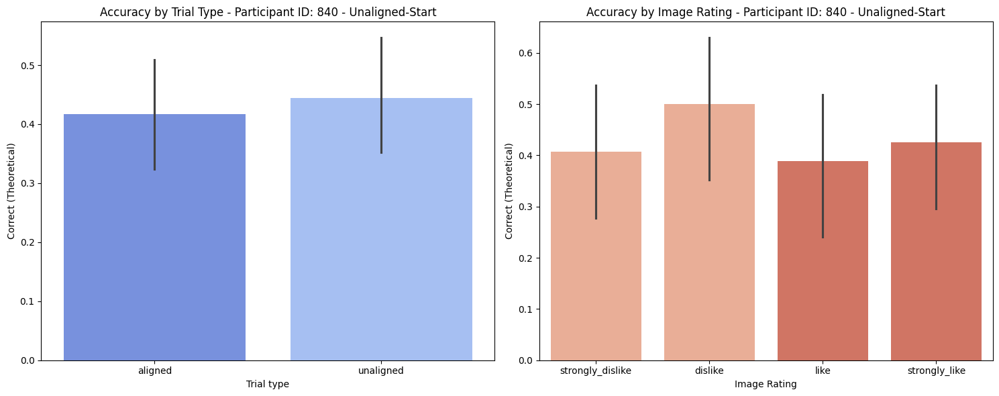

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.031).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.031).


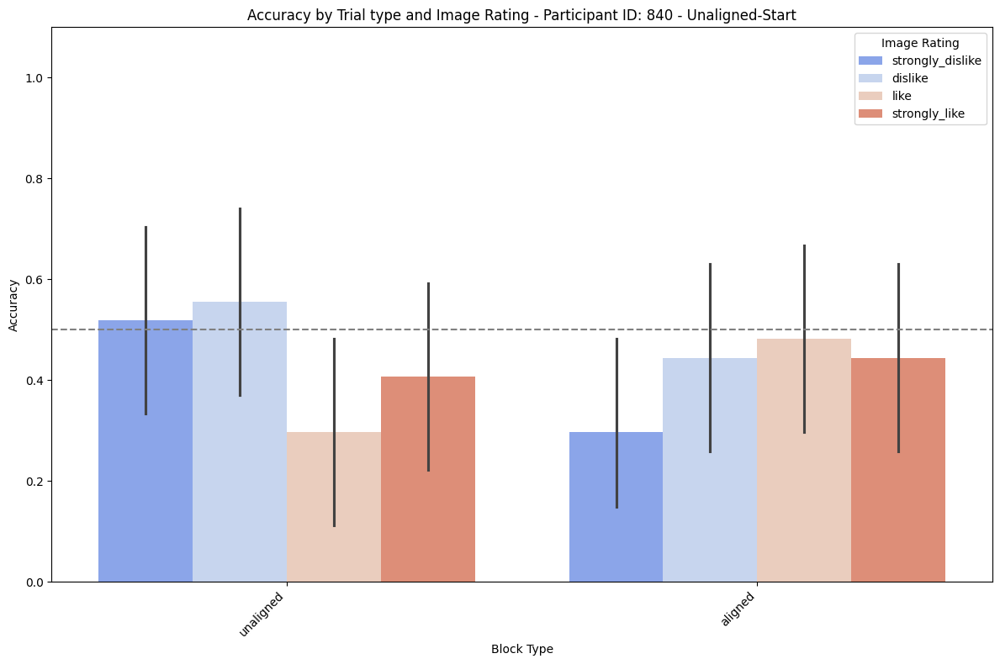

Data for participant 837:
Participant ID: 837

Accuracy in each 'Block':
Block
1    0.750000
2    0.305556
3    0.666667
4    0.562500
5    0.718750
6    0.656250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.50
unaligned    0.71
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.002256085056661217

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.750000
            2        0.305556
            3        0.666667
            4        0.562500
            5        0.718750
            6        0.656250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.48
like                0.66
strongly_dislike    0.66
strongly_like       0.62
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.205085678784649
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating      

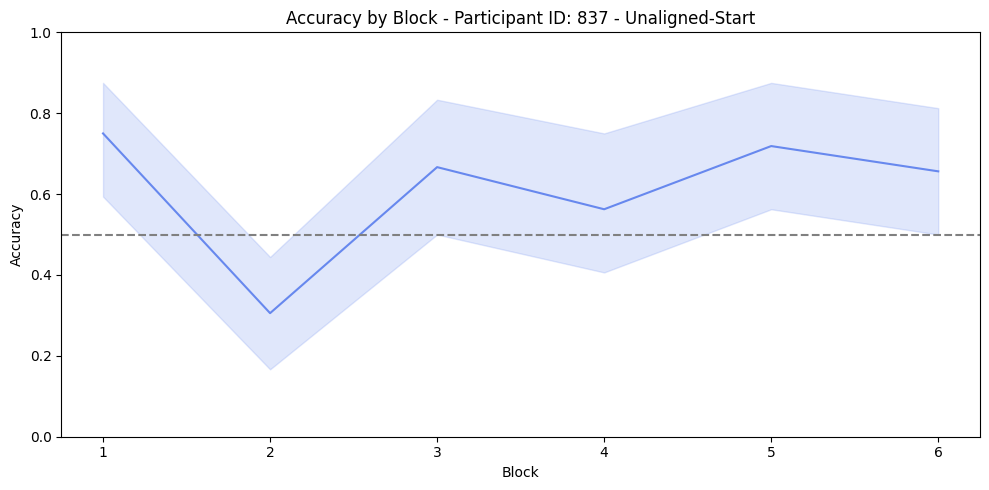

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


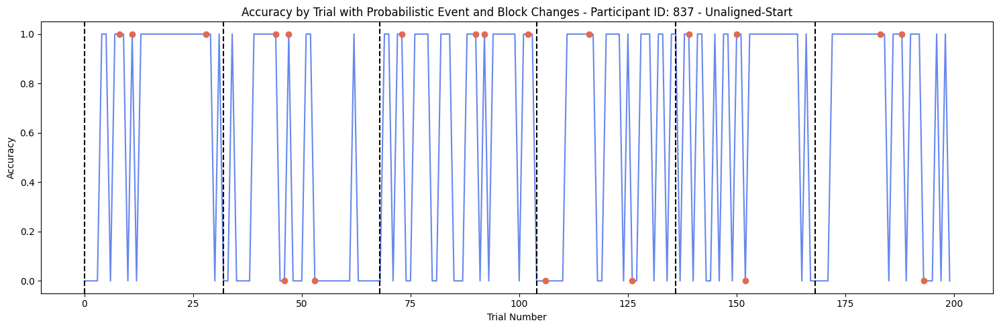

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


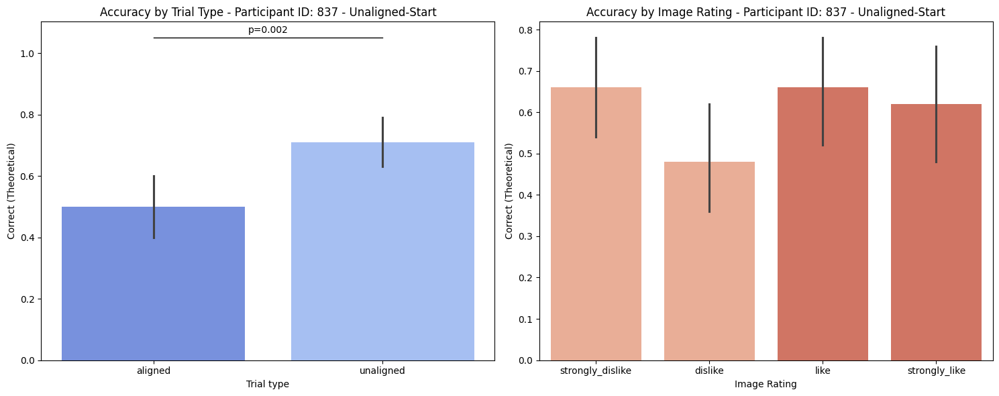

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.000).


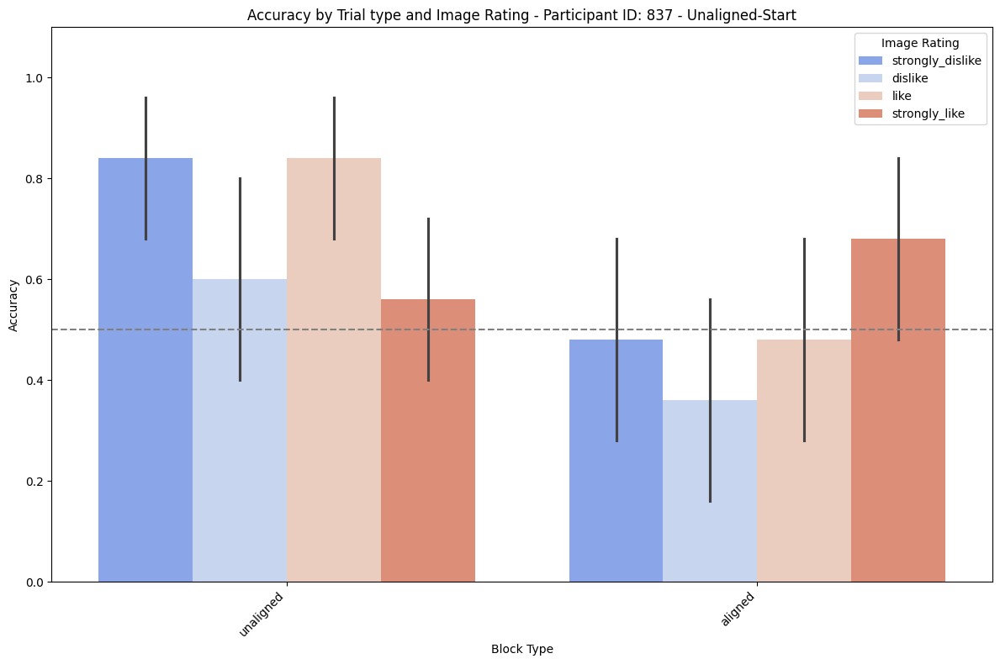

Data for participant 835:
Participant ID: 835

Accuracy in each 'Block':
Block
1    0.555556
2    0.444444
3    0.593750
4    0.625000
5    0.593750
6    0.388889
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.480769
unaligned    0.580000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.15728390345409915

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.555556
            2        0.444444
            3        0.593750
            4        0.625000
            5        0.593750
            6        0.388889
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.686275
like                0.490196
strongly_dislike    0.490196
strongly_like       0.450980
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.074296618252404
Data for Chi-squared test:
Correct (Binary)   0

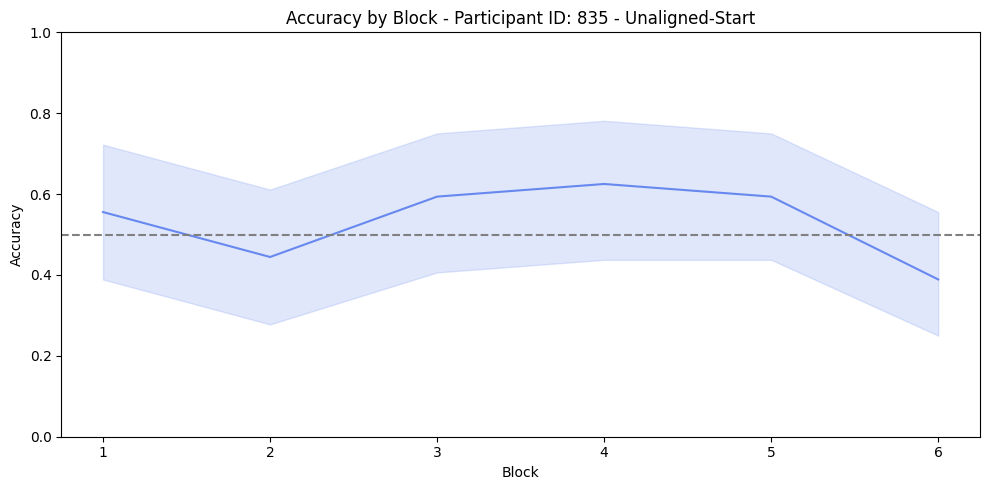

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


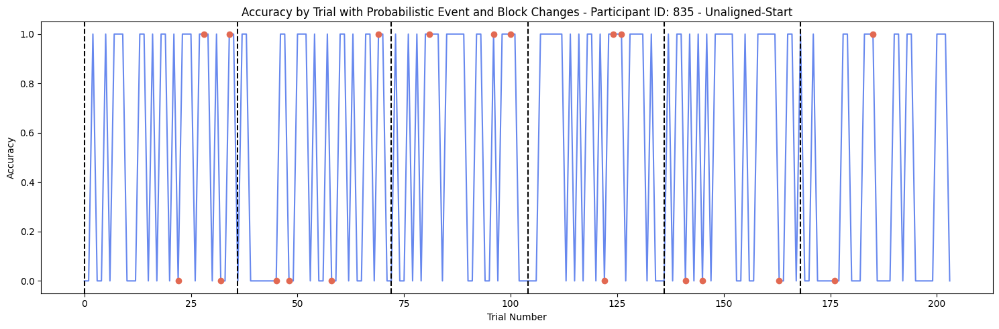

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


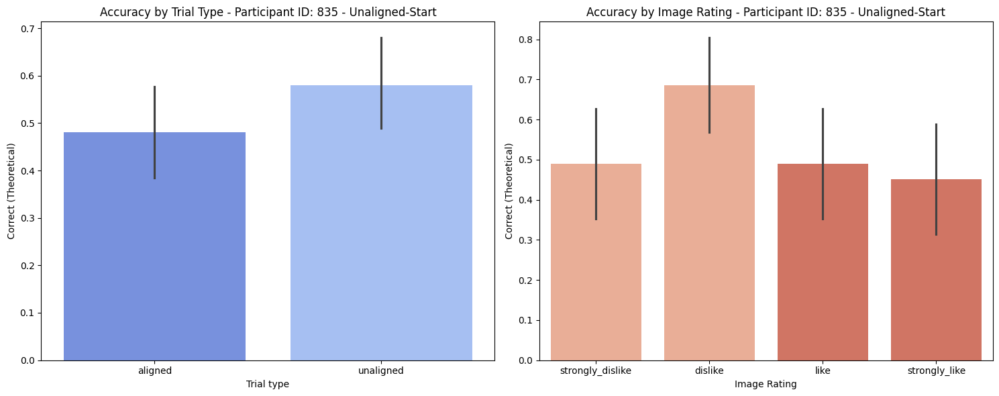

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.015).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.024).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.001).


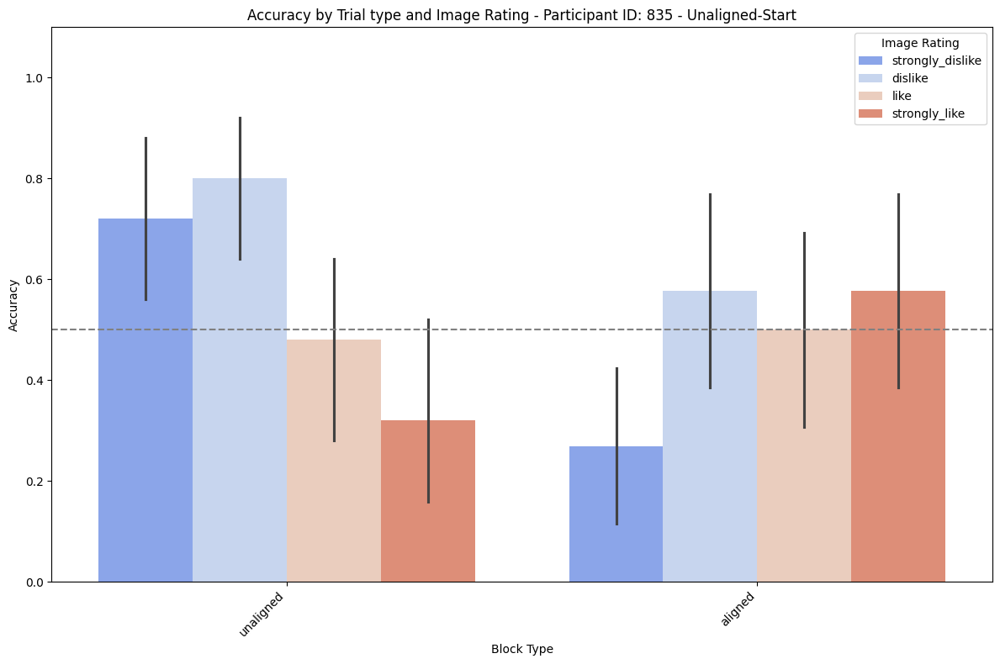

Data for participant 833:
Participant ID: 833

Accuracy in each 'Block':
Block
1    0.718750
2    0.805556
3    0.406250
4    0.625000
5    0.527778
6    0.531250
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.66
unaligned    0.55
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.1126980956693741

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.718750
            2        0.805556
            3        0.406250
            4        0.625000
            5        0.527778
            6        0.531250
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.66
like                0.48
strongly_dislike    0.66
strongly_like       0.62
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.205085678784649
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating        

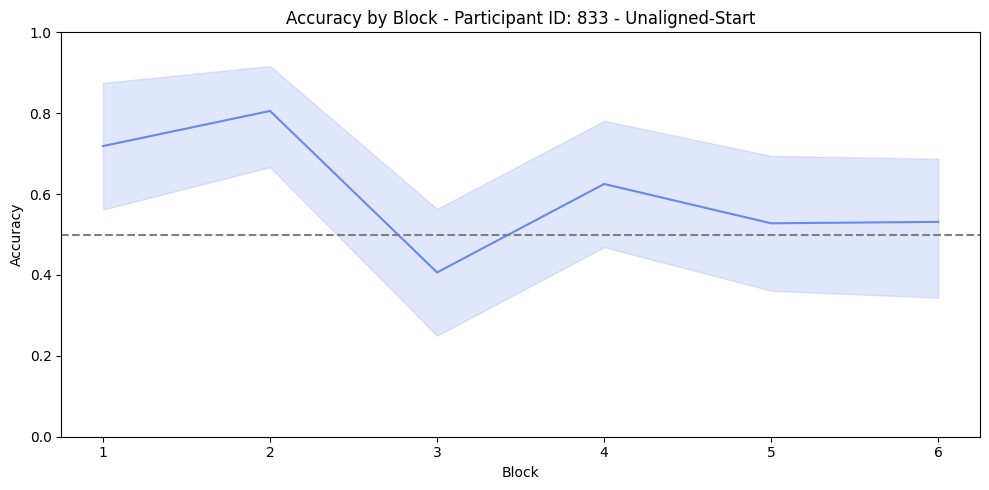

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


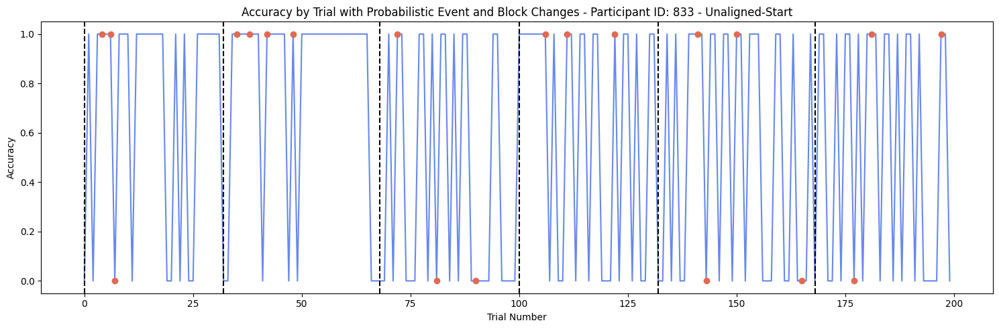

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


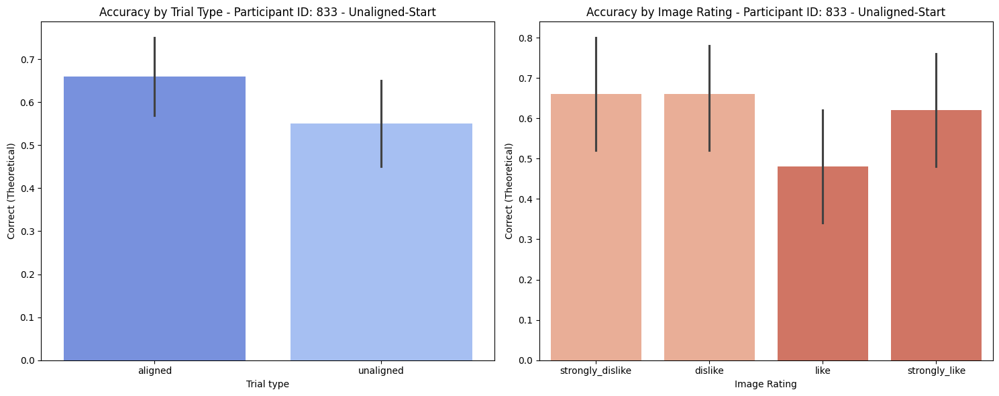

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.024).


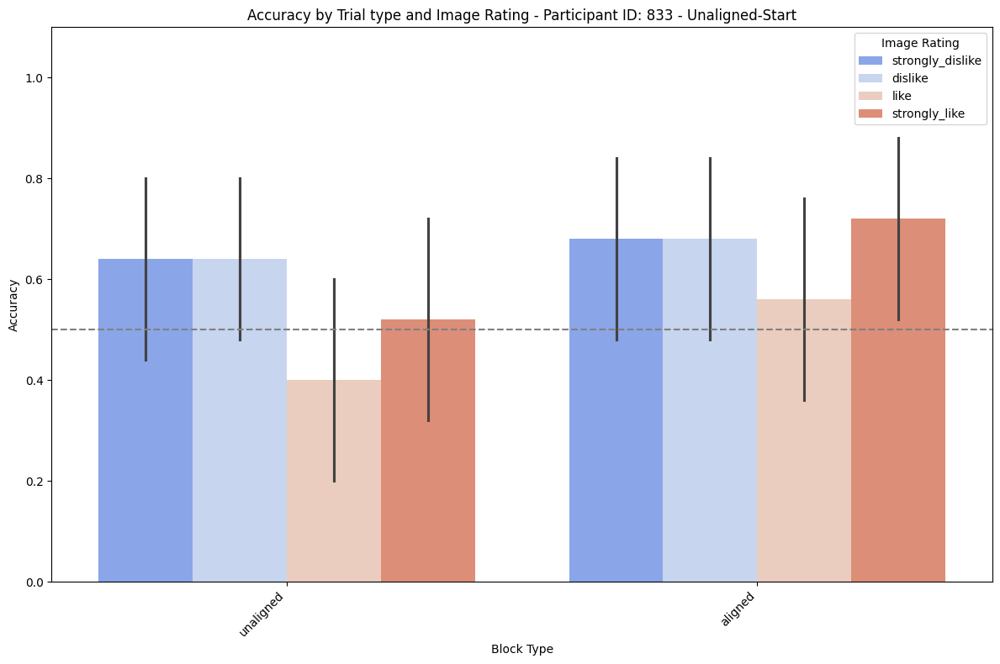

Data for participant 832:
Participant ID: 832

Accuracy in each 'Block':
Block
1    0.583333
2    0.500000
3    0.444444
4    0.444444
5    0.531250
6    0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.509259
unaligned    0.519231
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.8852124799896877

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.583333
            2        0.500000
            3        0.444444
            4        0.444444
            5        0.531250
            6        0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.566038
like                0.471698
strongly_dislike    0.566038
strongly_like       0.452830
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.508202299497869
Data for Chi-squared test:
Correct (Binary)   0 

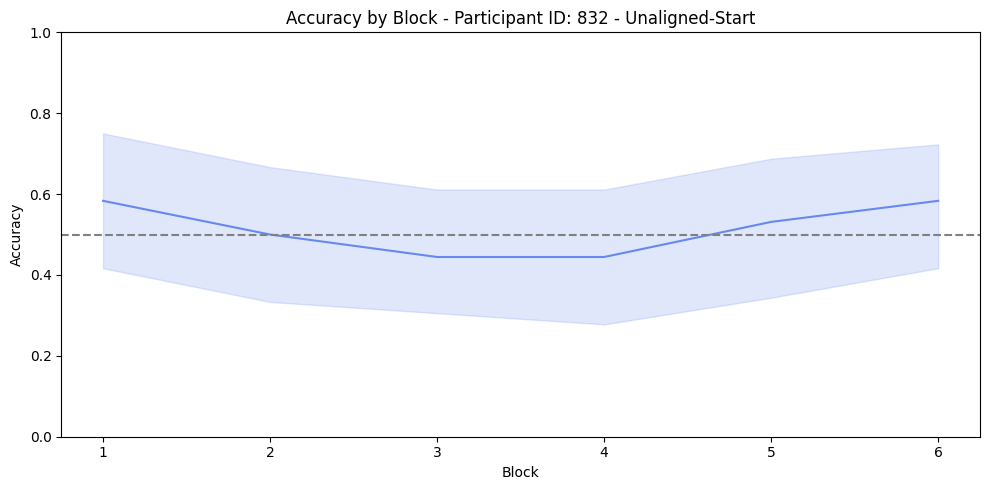

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


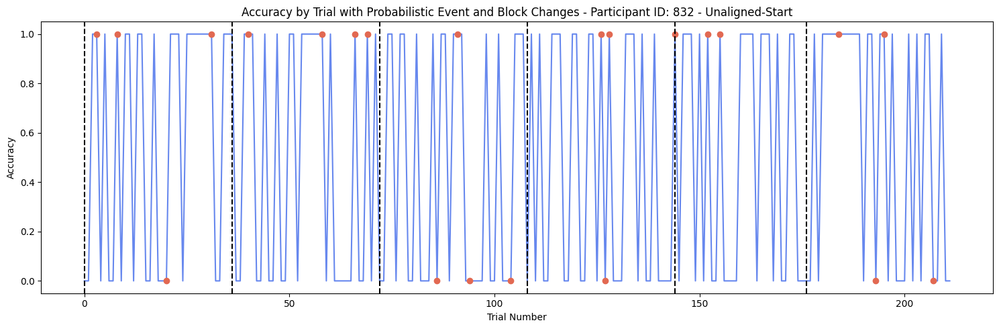

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


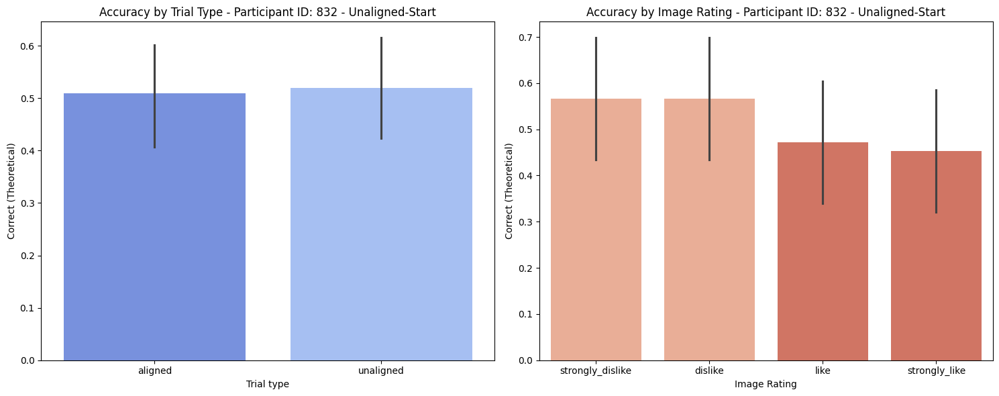

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.048).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.048).


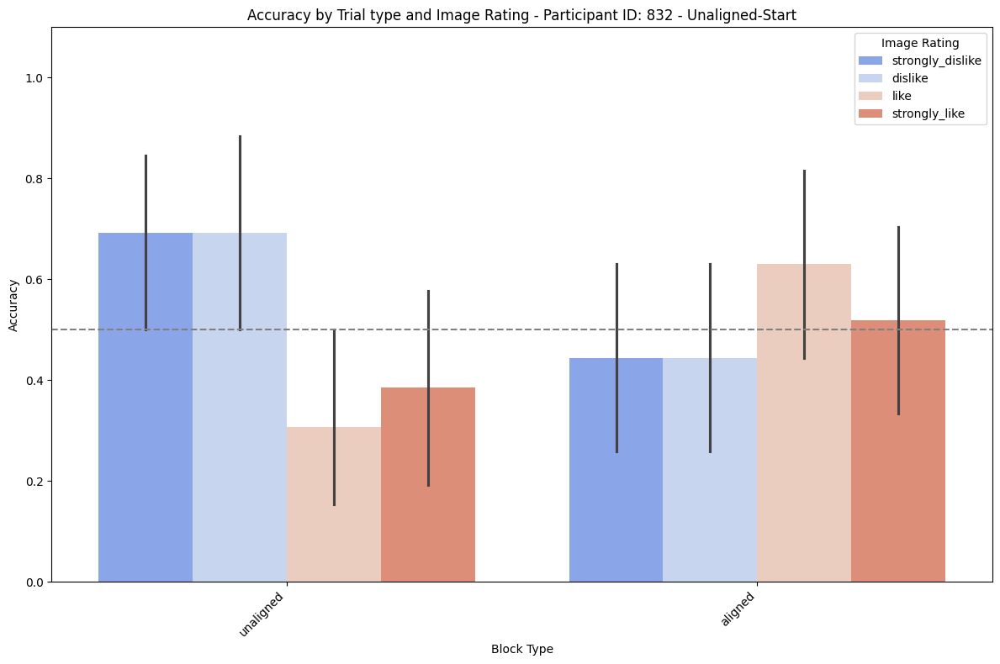

Data for participant 830:
Participant ID: 830

Accuracy in each 'Block':
Block
1    0.843750
2    0.833333
3    0.500000
4    0.388889
5    0.750000
6    0.833333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.685185
unaligned    0.700000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.8181561495403299

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.843750
            2        0.833333
            3        0.500000
            4        0.388889
            5        0.750000
            6        0.833333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.711538
like                0.596154
strongly_dislike    0.730769
strongly_like       0.730769
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.381041645965777
Data for Chi-squared test:
Correct (Binary)   0 

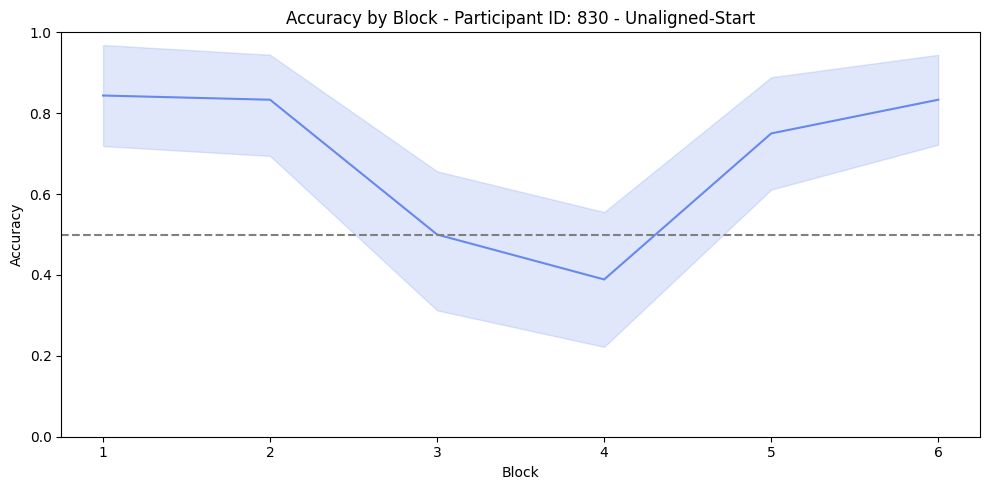

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


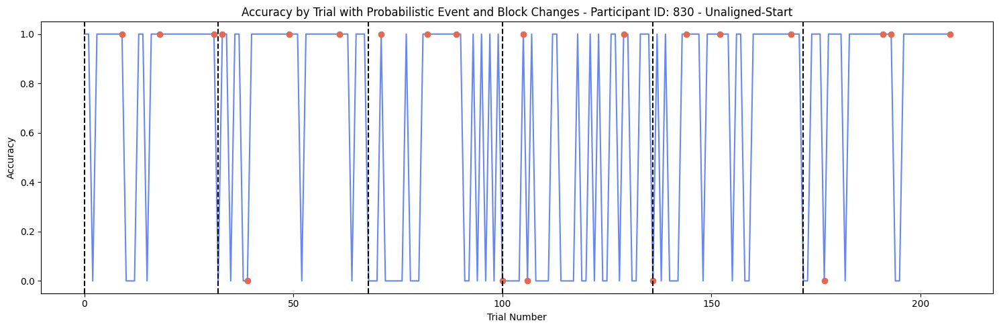

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


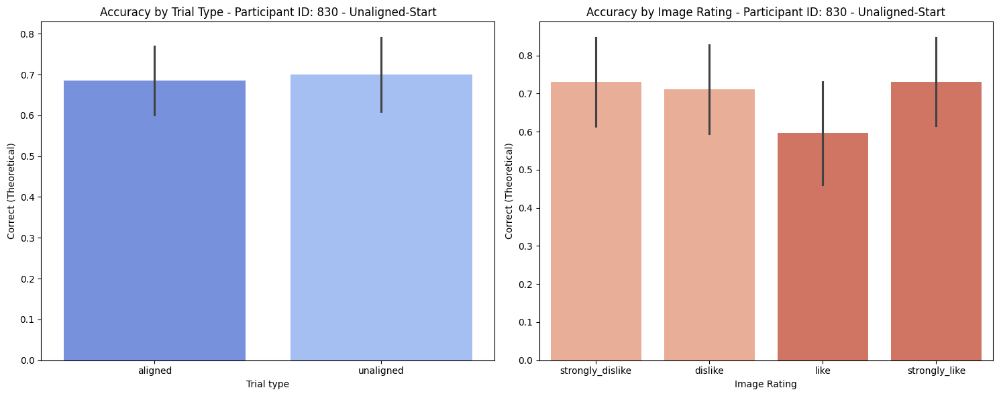

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.031).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.009).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.024).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.024).


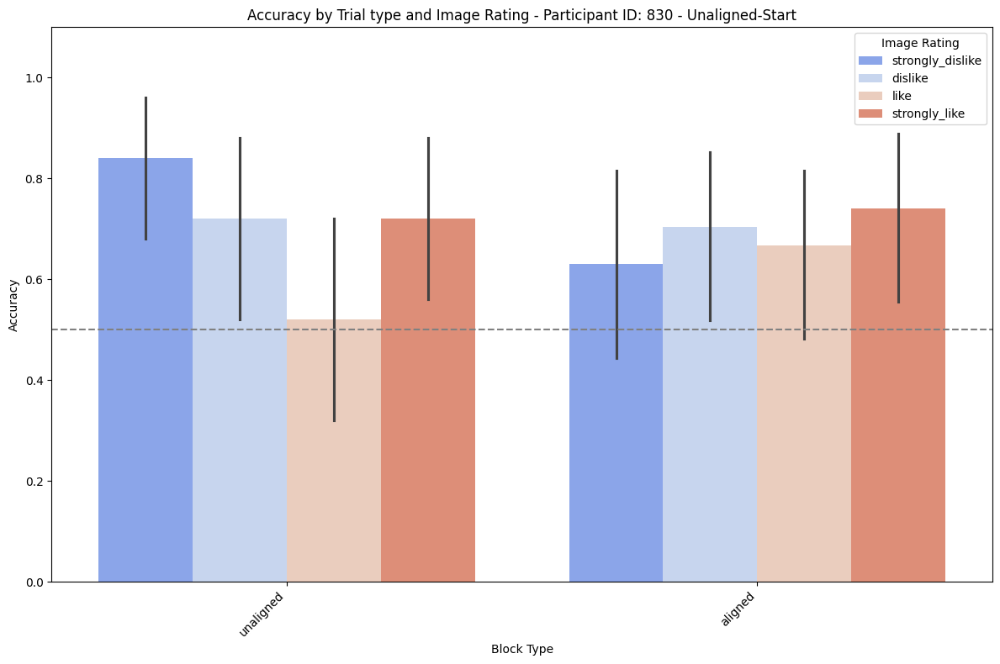

Data for participant 829:
Participant ID: 829

Accuracy in each 'Block':
Block
1    0.777778
2    0.666667
3    0.750000
4    0.888889
5    0.968750
6    0.972222
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.842593
unaligned    0.830000
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.8072912395460599

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.777778
            2        0.666667
            3        0.750000
            4        0.888889
            5        0.968750
            6        0.972222
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.788462
like                0.807692
strongly_dislike    0.865385
strongly_like       0.884615
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.495348639326821
Data for Chi-squared test:
Correct (Binary)   0 

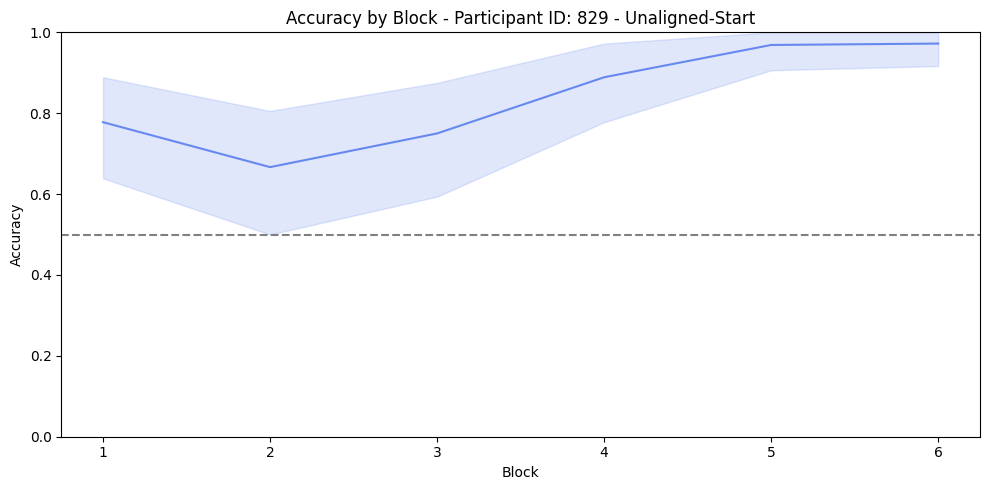

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


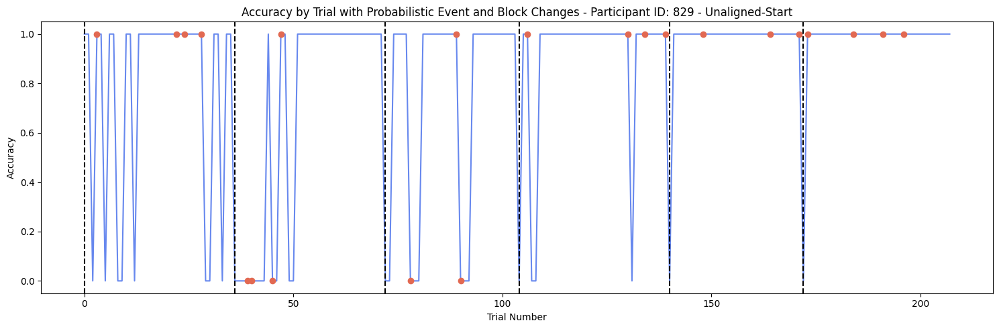

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


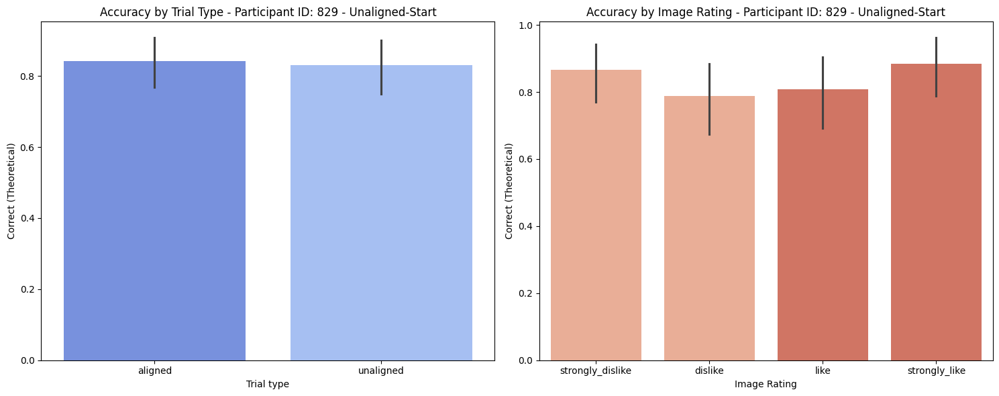

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.006).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.006).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


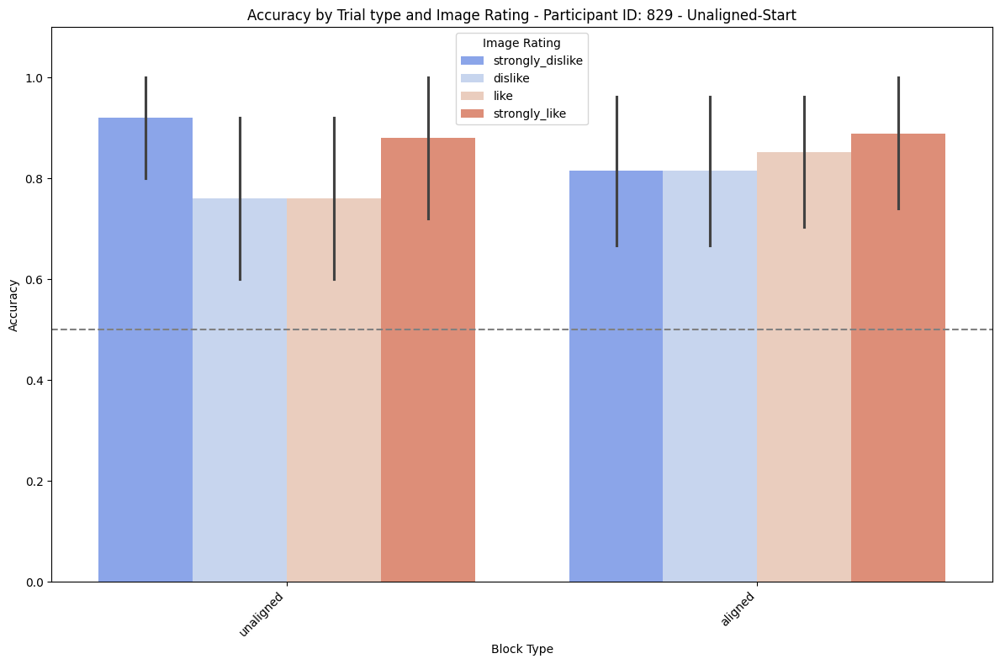

Data for participant 828:
Participant ID: 828

Accuracy in each 'Block':
Block
1    0.500000
2    0.333333
3    0.472222
4    0.361111
5    0.444444
6    0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.425926
unaligned    0.472222
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.4962697250555318

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.500000
            2        0.333333
            3        0.472222
            4        0.361111
            5        0.444444
            6        0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.388889
like                0.462963
strongly_dislike    0.481481
strongly_like       0.462963
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.776097516248164
Data for Chi-squared test:
Correct (Binary)   0 

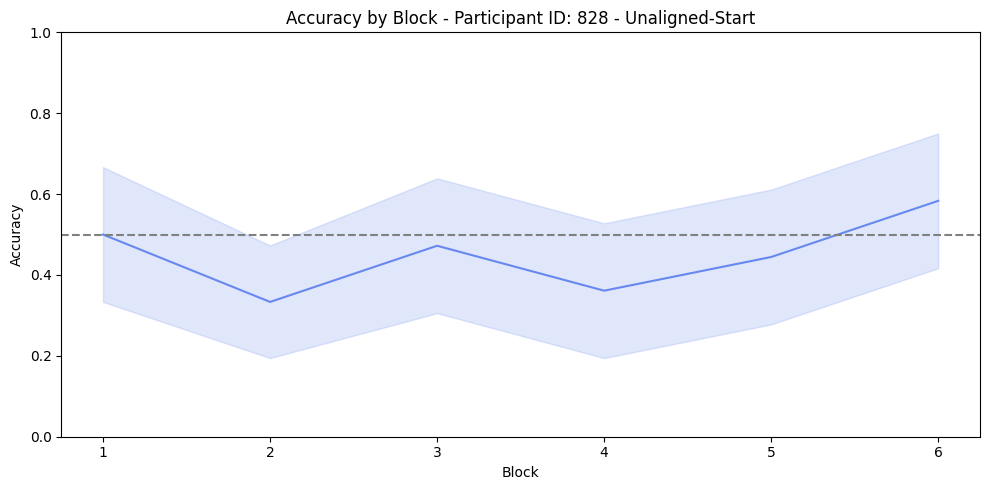

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


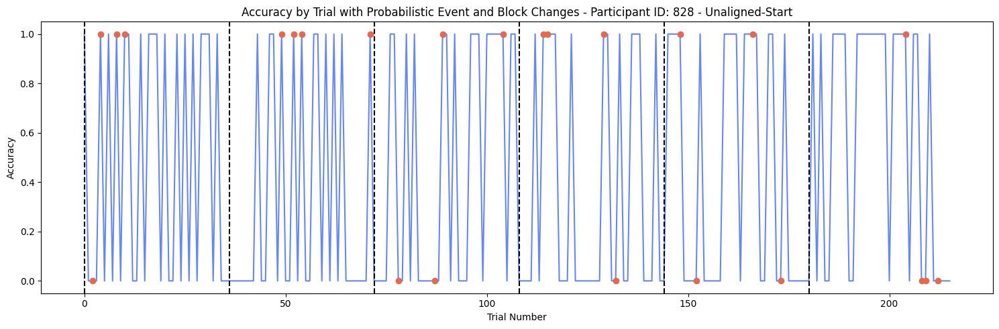

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


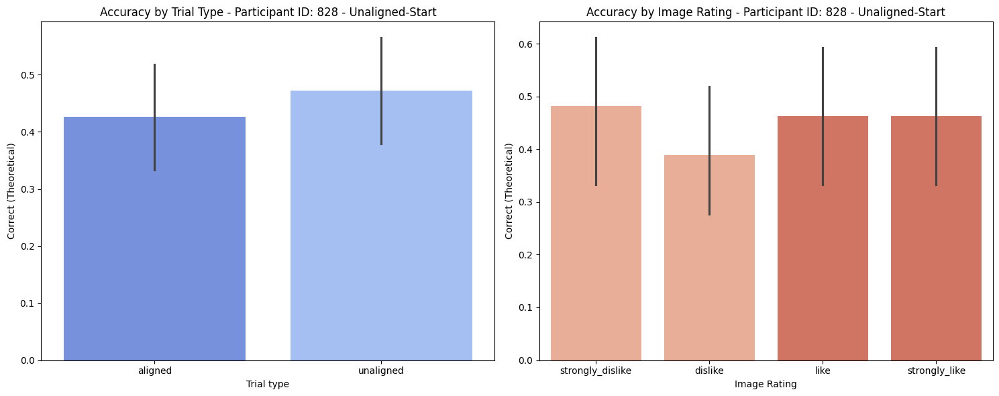

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


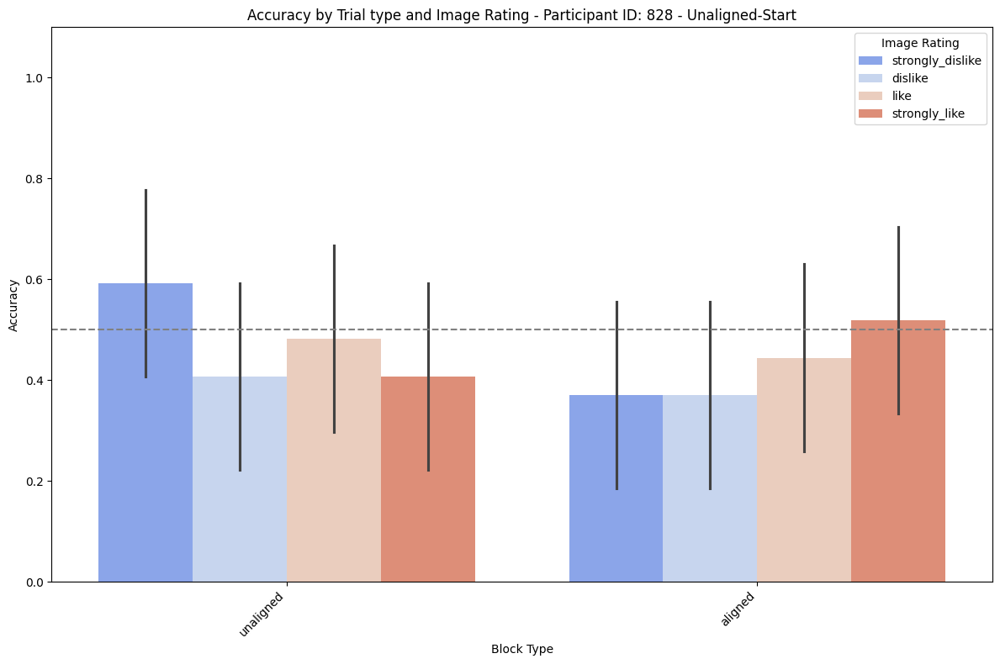

Data for participant 827:
Participant ID: 827

Accuracy in each 'Block':
Block
1    0.555556
2    0.722222
3    0.416667
4    0.472222
5    0.361111
6    0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.592593
unaligned    0.444444
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.029389133559690115

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.555556
            2        0.722222
            3        0.416667
            4        0.472222
            5        0.361111
            6        0.583333
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.500000
like                0.611111
strongly_dislike    0.518519
strongly_like       0.444444
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.374175000630927
Data for Chi-squared test:
Correct (Binary)   

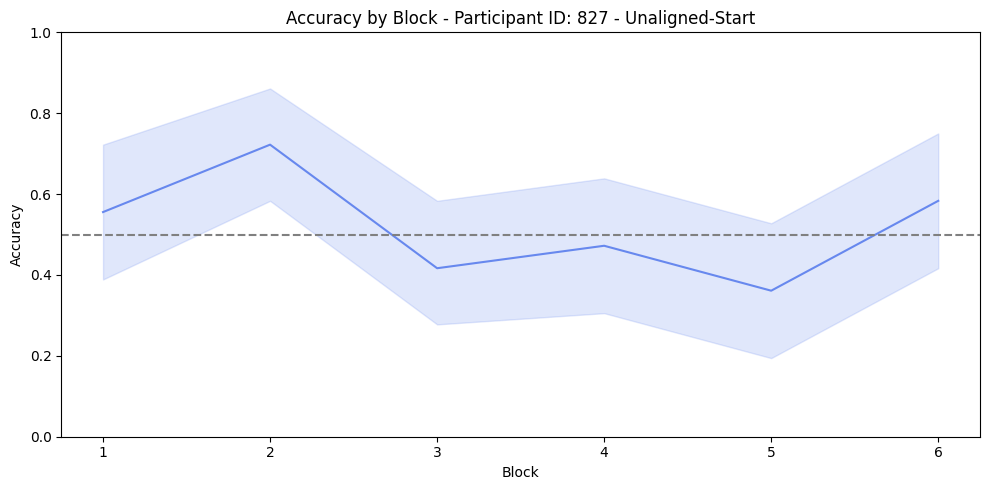

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


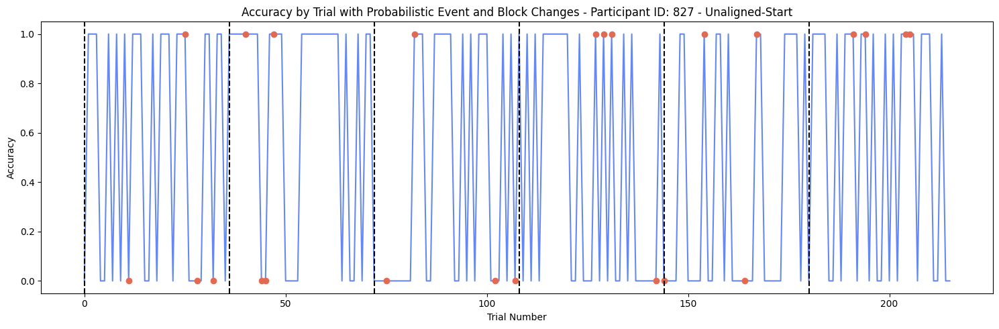

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


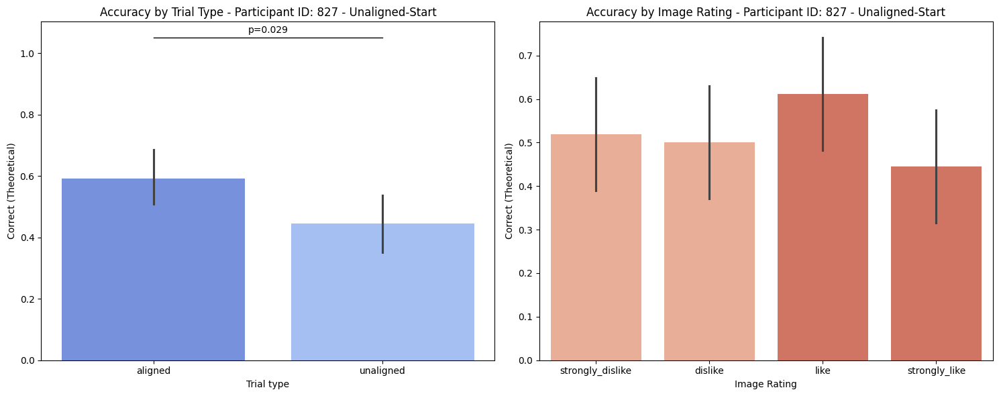

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.031).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


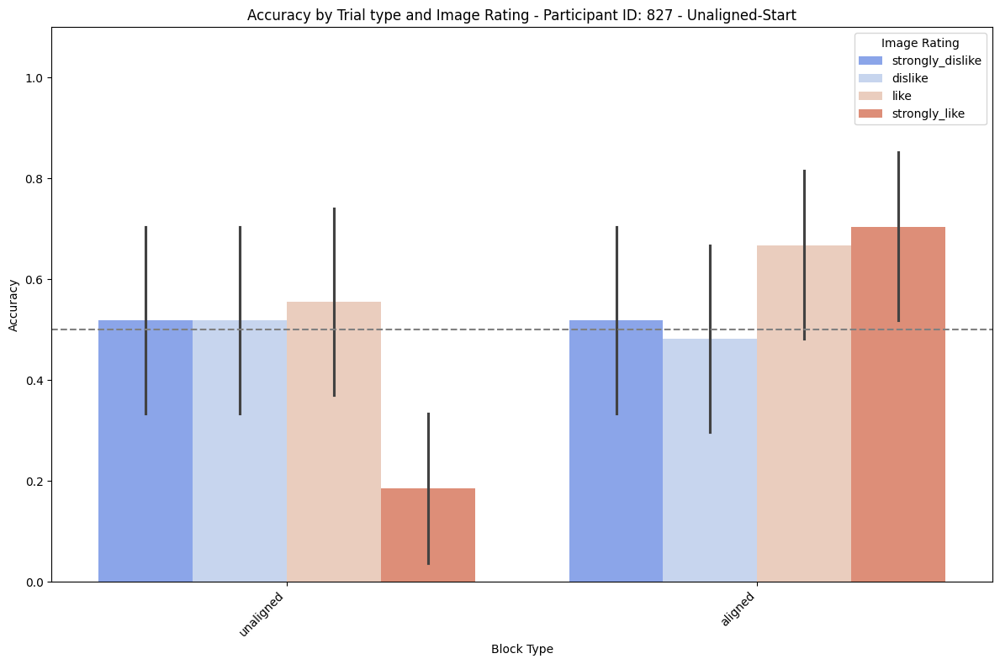

Data for participant 826:
Participant ID: 826

Accuracy in each 'Block':
Block
1    0.375000
2    0.861111
3    0.694444
4    0.375000
5    0.472222
6    0.562500
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.610000
unaligned    0.519231
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.19306896226692608

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.375000
            2        0.861111
            3        0.694444
            4        0.375000
            5        0.472222
            6        0.562500
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.647059
like                0.549020
strongly_dislike    0.490196
strongly_like       0.568627
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.455557283161375
Data for Chi-squared test:
Correct (Binary)   0

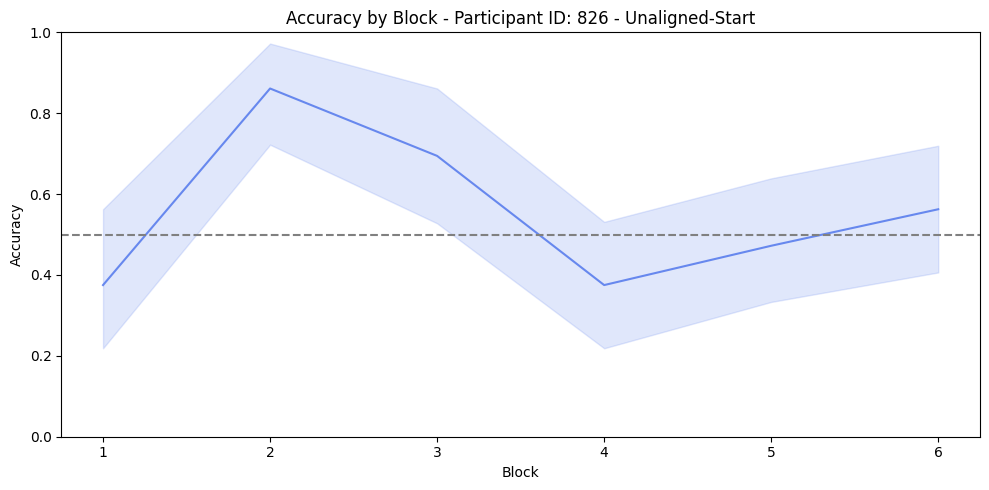

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


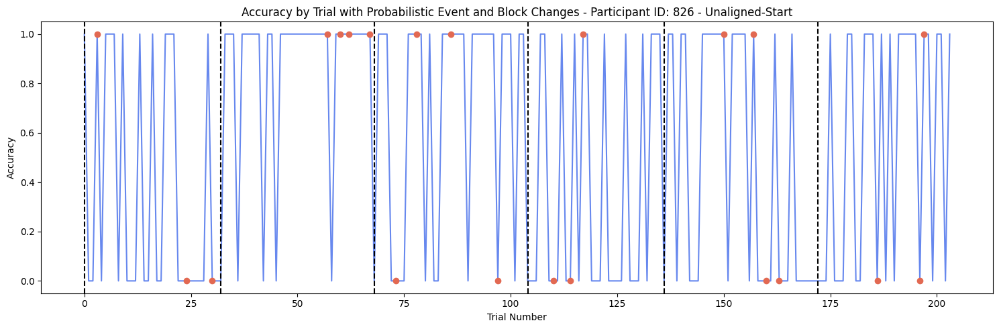

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


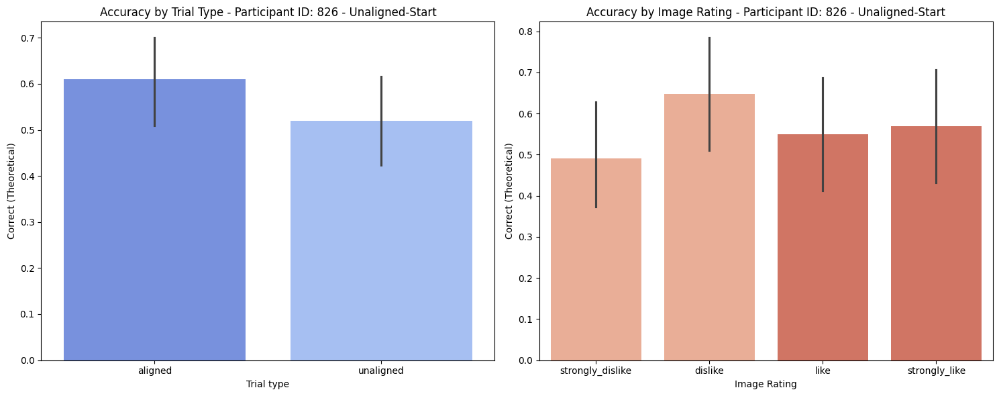

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.048).


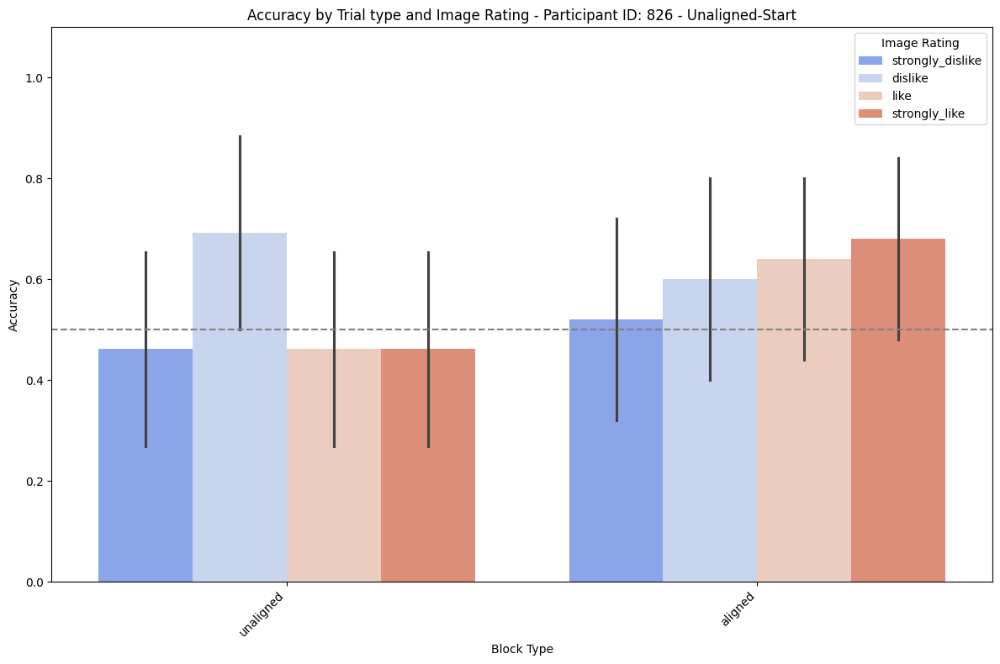

Data for participant 824:
Participant ID: 824

Accuracy in each 'Block':
Block
1    0.722222
2    0.687500
3    0.694444
4    0.843750
5    0.875000
6    0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy per 'Trial type' (aligned and unaligned):
Trial type
aligned      0.802083
unaligned    0.759615
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type': 0.471359683636954

Accuracy over the whole task:
All Trials  Block
All Trials  1        0.722222
            2        0.687500
            3        0.694444
            4        0.843750
            5        0.875000
            6        0.875000
Name: Correct (Theoretical), dtype: float64

Accuracy as a function of 'Image Rating':
Image Rating
dislike             0.76
like                0.76
strongly_dislike    0.76
strongly_like       0.84
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating': 0.705862603902659
Data for Chi-squared test:
Correct (Binary)   0   1
Image Rating 

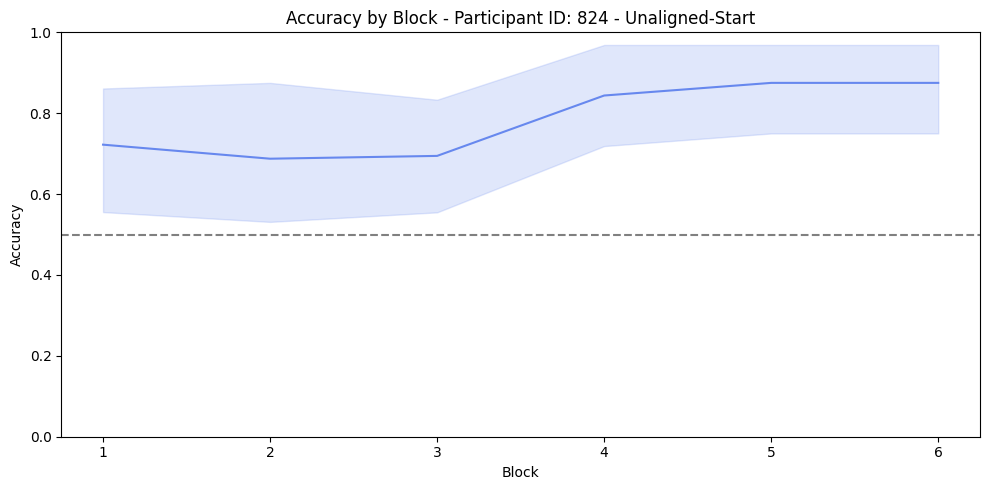

<ipython-input-33-a3a56bc4ac5f>:77: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ro" (-> color='r'). The keyword argument will take precedence.
  plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])


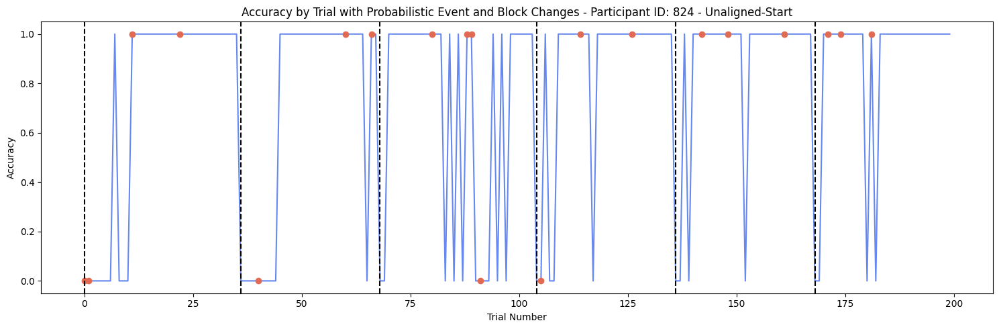

<ipython-input-33-a3a56bc4ac5f>:98: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
<ipython-input-33-a3a56bc4ac5f>:107: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)


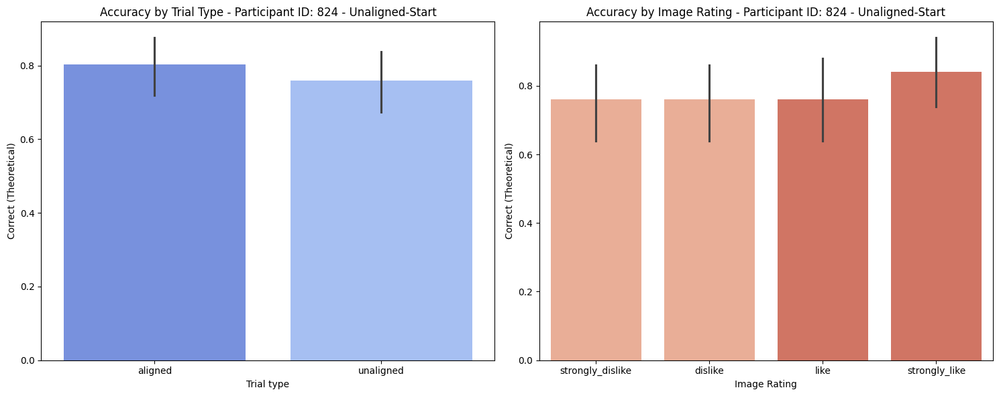

<ipython-input-33-a3a56bc4ac5f>:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in aligned is significantly different from chance level (p = 0.011).
Accuracy for 'like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'strongly_like' in aligned is significantly different from chance level (p = 0.002).
Accuracy for 'dislike' in unaligned is significantly different from chance level (p = 0.004).
Accuracy for 'like' in unaligned is significantly different from chance level (p = 0.015).
Accuracy for 'strongly_like' in unaligned is significantly different from chance level (p = 0.000).


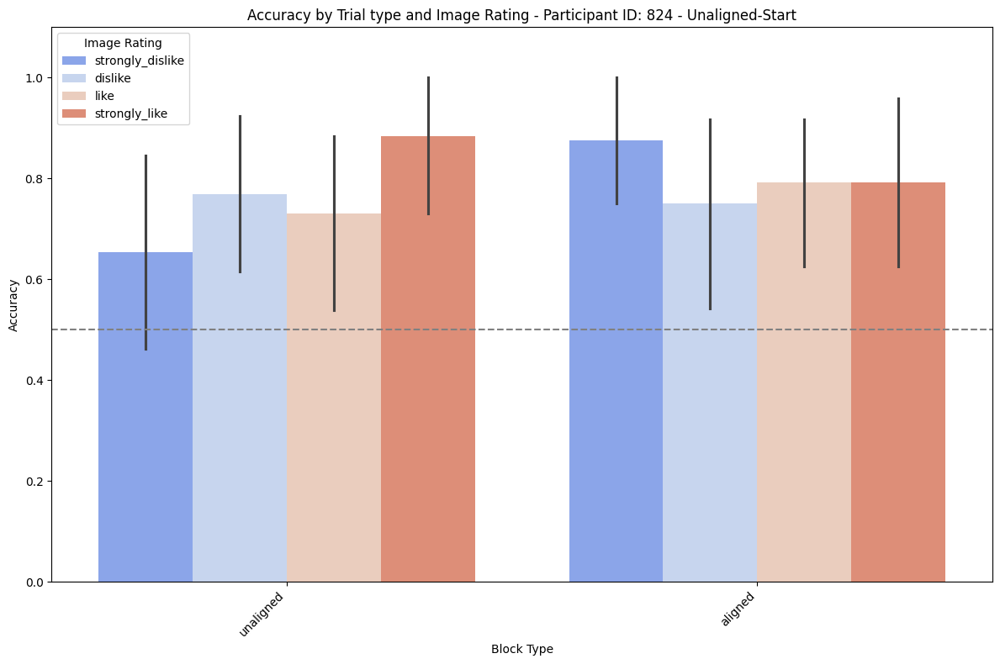

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats import ttest_ind, chi2_contingency

# Assuming participant_data is a dictionary where keys are participant IDs
for participant_id in participant_data.keys():
    df = participant_data[participant_id]  # Access the DataFrame for this participant
    print(f"Data for participant {participant_id}:")

    # Define blocks based on switches in 'Trial type'
    df['Block'] = (df['Trial type'] != df['Trial type'].shift(1)).cumsum()

    # Accuracy in each 'Block'
    block_accuracy = df.groupby('Block')['Correct (Theoretical)'].mean()

    # Accuracy per 'Trial type' (aligned and unaligned)
    trial_type_accuracy = df.groupby('Trial type')['Correct (Theoretical)'].mean()
    ttest_p_value_tt = ttest_ind(df[df['Trial type'] == 'aligned']['Correct (Theoretical)'],
                                  df[df['Trial type'] == 'unaligned']['Correct (Theoretical)'], nan_policy='omit').pvalue

    # Accuracy over the whole task
    df['Block Change'] = df['Block'].ne(df['Block'].shift())
    df['All Trials'] = 'All Trials'
    overall_accuracy = df.groupby(['All Trials', 'Block'])['Correct (Theoretical)'].mean()

    # Accuracy as a function of 'Image Rating'
    df['Correct (Binary)'] = df['Correct (Theoretical)'].astype(int)

    # Create a contingency table
    contingency_table = pd.crosstab(df['Image Rating'], df['Correct (Binary)'])

    # Perform chi-squared test
    chi2, p, _, _ = chi2_contingency(contingency_table)

    # Output results
    print(f"Participant ID: {participant_id.split('_')[0]}")
    print("\nAccuracy in each 'Block':")
    print(block_accuracy)
    print("\nAccuracy per 'Trial type' (aligned and unaligned):")
    print(trial_type_accuracy)
    print(f"t-test p-value for 'Trial type': {ttest_p_value_tt}")
    print("\nAccuracy over the whole task:")
    print(overall_accuracy)
    print("\nAccuracy as a function of 'Image Rating':")
    print(df.groupby('Image Rating')['Correct (Binary)'].mean())
    print(f"Chi-squared p-value for 'Image Rating': {p:.15f}")
    print("Data for Chi-squared test:")
    print(contingency_table)

    # Determine the starting block type
    starting_block_type = 'Aligned-Start' if df['Trial type'].iloc[0] == 'aligned' else 'Unaligned-Start'

    # Visualization

    # Define custom color palette
    coolwarm_palette = sns.color_palette("coolwarm", 6)  # Generate the coolwarm palette

    # Accuracy by Block
    plt.figure(figsize=(10, 5))
    sns.lineplot(x='Block', y='Correct (Theoretical)', data=df, color=coolwarm_palette[0])  # Choose a color for the line
    plt.ylabel('Accuracy')
    plt.axhline(y=0.5, color='gray', linestyle='--')  # Add a dotted line at y=0.5
    plt.ylim(0, 1)  # Set y-axis limits to 0-1
    plt.title(f"Accuracy by Block - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")

    plt.tight_layout()
    plt.show()

    # Accuracy by Trial with Probabilistic Event and Block Changes
    plt.figure(figsize=(15, 5))
    sns.lineplot(x=df.index, y='Correct (Theoretical)', data=df, color=coolwarm_palette[0])  # Choose a color for the line
    for i, event in enumerate(df['Probabilistic event']):
        if event:
            plt.plot(i, df.loc[i, 'Correct (Theoretical)'], 'ro', color=coolwarm_palette[5])
    for i, change in enumerate(df['Block Change']):
        if change:
            plt.axvline(x=i, linestyle='--', linewidth=1.5, color='k')
    plt.title(f"Accuracy by Trial with Probabilistic Event and Block Changes - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
    plt.ylabel('Accuracy')
    plt.xlabel('Trial Number')
    plt.tight_layout()
    plt.show()

    # Accuracy by Trial Type and Image Rating
    fig, axs = plt.subplots(1, 2, figsize=(15, 6))
    # Define custom color palette
    coolwarm_palette = sns.color_palette("coolwarm")  # You can choose any palette
    # Assign specific colors from the coolwarm palette
    palette = {'aligned': coolwarm_palette[0], 'unaligned': coolwarm_palette[1],
              'strongly_dislike': coolwarm_palette[4], 'dislike': coolwarm_palette[4],
              'like': coolwarm_palette[5], 'strongly_like': coolwarm_palette[5]}  # Switching colors

    # Accuracy by Trial Type with specified order
    trial_type_order = ['aligned', 'unaligned']
    sns.barplot(x='Trial type', y='Correct (Theoretical)', data=df, ax=axs[0], palette=palette, order=trial_type_order)
    axs[0].set_title(f"Accuracy by Trial Type - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
    if ttest_p_value_tt < 0.05:
        height = max(df.groupby('Trial type')['Correct (Theoretical)'].max()) + 0.05
        axs[0].plot([0, 1], [height, height], linewidth=1, color='k')
        axs[0].text(0.5, height + 0.01, f'p={ttest_p_value_tt:.3f}', ha='center', va='bottom')

    # Accuracy by Image Rating with the correct order
    image_rating_order = ['strongly_dislike', 'dislike', 'like', 'strongly_like']
    sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=df, ax=axs[1], palette=palette, order=image_rating_order)
    axs[1].set_title(f"Accuracy by Image Rating - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
    if p < 0.05:
        height = max(df.groupby('Image Rating')['Correct (Theoretical)'].max()) + 0.05
        axs[1].plot([0, 1, 2, 3], [height, height, height, height], linewidth=1, color='k')
        axs[1].text(1.5, height + 0.01, f'p={p:.3f}', ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

    # Define a function to plot accuracy by block and image rating for each group with significance
    def plot_accuracy_by_block_image_rating(df, title_suffix):
      if df.empty:
          print(f"No data to plot for {title_suffix}.")
          return

      # Ensure 'Image Rating' is in the specified order
      rating_order = ['strongly_dislike', 'dislike', 'like', 'strongly_like']
      df['Image Rating'] = pd.Categorical(df['Image Rating'], categories=rating_order, ordered=True)

      # Compute the average accuracy for each participant by Block Type and Image Rating
      participant_mean = df.groupby(['Trial type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()

      # Define custom color palette
      palette = sns.color_palette("coolwarm", len(rating_order))  # You can choose any palette

      # Create a DataFrame for significance testing
      results = []
      printed_results = set()  # Set to track printed results
      for _, row in participant_mean.iterrows():
          t_stat, p_value = stats.ttest_1samp(df[(df['Trial type'] == row['Trial type']) &
                                                      (df['Image Rating'] == row['Image Rating'])]['Correct (Binary)'], 0.5)
          results.append({'Trial type': row['Trial type'], 'Image Rating': row['Image Rating'],
                          'p_value': p_value, 'mean_accuracy': row['Correct (Binary)']})

          # Only print if the result is significant and not already printed
          if p_value < 0.05 and (row['Trial type'], row['Image Rating']) not in printed_results:
              significance = 'significantly'
              print(f"Accuracy for '{row['Image Rating']}' in {row['Trial type']} is {significance} different from chance level (p = {p_value:.3f}).")
              printed_results.add((row['Trial type'], row['Image Rating']))  # Add to printed results set

      # Plot Accuracy by Trial type and Image Rating with overlaid participant averages
      plt.figure(figsize=(12, 8))
      ax = sns.barplot(
          data=df,
          x='Trial type',
          y='Correct (Binary)',
          hue='Image Rating',
          hue_order=rating_order,  # Specify the order of the hue categories
          palette=palette  # Apply custom color palette
      )


      plt.title(f"Accuracy by Trial type and Image Rating - Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")
      plt.axhline(y=0.5, color='gray', linestyle='--', label='Chance Level')  # Add a dotted line at y=0.5
      plt.ylim(0, 1.1)  # Set y-axis limits to 0-1.1
      plt.xlabel('Block Type')
      plt.ylabel('Accuracy')
      plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

      plt.tight_layout()
      plt.show()

    plot_accuracy_by_block_image_rating(df, f"Participant ID: {participant_id.split('_')[0]} - {starting_block_type}")



# Across participants


In [ ]:
from google.colab import drive
import os
import pandas as pd

# Path to the shared folder containing the subject data folders
shared_folder_path = "/content/drive/My Drive/Levy Lab/Value updating project/online fall 2024 analysis/subject data"

# List to store DataFrames for each participant
all_participants_data = []

# Iterate through each subject folder in the shared folder
for subject_folder in os.listdir(shared_folder_path):
    subject_folder_path = os.path.join(shared_folder_path, subject_folder)

    # Check if the item is a directory (subject folder)
    if os.path.isdir(subject_folder_path):
        # Construct the path to the task CSV file (e.g., 654_task.csv)
        task_file_name = f"{subject_folder}_task.csv"
        task_file_path = os.path.join(subject_folder_path, task_file_name)

        # Check if the task CSV file exists
        if os.path.exists(task_file_path):
            # Read the task CSV file into a DataFrame
            df = pd.read_csv(task_file_path)

            # Add a column for the subject ID
            df['Subject ID'] = subject_folder

            # Append the DataFrame to the list
            all_participants_data.append(df)
            #print(f"Data loaded for participant {subject_folder}.")
        else:
            print(f"Task data file not found for participant {subject_folder}.")

# Report the number of participants
total_participants = len(all_participants_data)
print(f"\nTotal participants processed: {total_participants}")

# Concatenate all participant DataFrames into a single DataFrame for analysis
all_participants_df = pd.concat(all_participants_data, ignore_index=True)

# Now you can perform across-subjects analysis using `all_participants_df`
#print(all_participants_df.head())  # Display the first few rows of the combined DataFrame

# Optionally, save the combined data to a CSV for future analysis
#all_participants_df.to_csv("/content/drive/My Drive/Levy Lab/Value updating project/online fall 2024 analysis/all_participants_data.csv", index=False)


<IPython.core.display.Javascript object>


Total participants processed: 109


## Average number of trials per block (separated by U & A starts) and average accuracy time course (separated by U & A start)

<IPython.core.display.Javascript object>

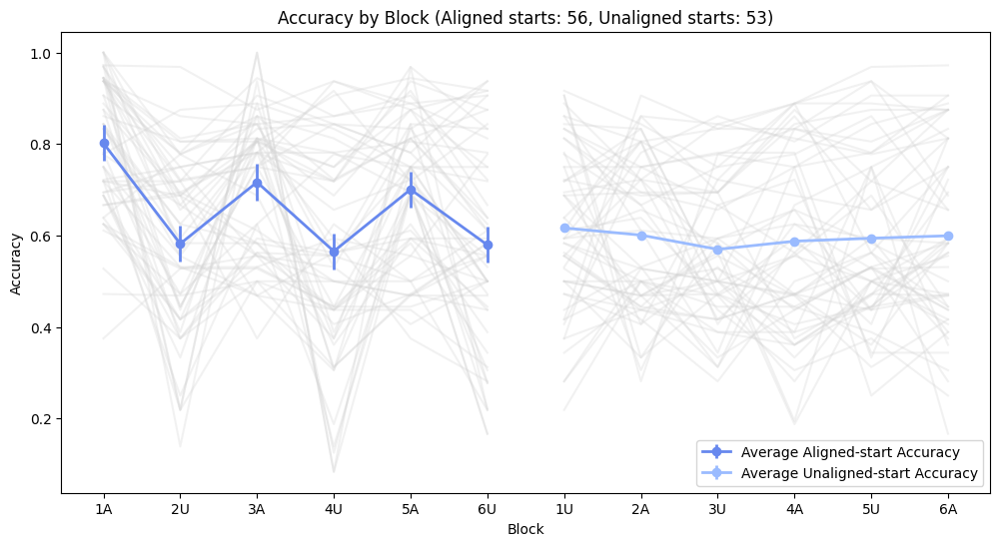

Two-sample t-test result:
 t-statistic = 2.411, p-value = 0.018
Cohen's d = 0.462
There is a significant difference in average accuracy between aligned and unaligned start participants.


In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_ind, chi2_contingency

# Assuming all_participants_df is already created with the combined data

# Initialize empty lists to store aggregated data
all_block_counts = []
all_block_accuracy = []
all_trial_type_accuracy = []
all_ttest_p_values_tt = []
all_overall_accuracy = []
all_image_rating_data = []
all_chi2_p_values = []
aligned_start_count = 0
unaligned_start_count = 0

# Iterate over each participant's data in the combined DataFrame
for subject_id, df in all_participants_df.groupby('Subject ID'):

    # Define blocks based on switches in 'Trial type'
    df['Block Number'] = (df['Trial type'] != df['Trial type'].shift(1)).cumsum()
    df['Block'] = df['Block Number'].astype(str) + df['Trial type'].apply(lambda x: 'A' if x == 'aligned' else 'U')

    # Count how many participants started with aligned vs unaligned
    first_trial_type = df['Trial type'].iloc[0]
    if first_trial_type == 'aligned':
        aligned_start_count += 1
    else:
        unaligned_start_count += 1

    # Number of trials in each 'Block'
    block_counts = df['Block'].value_counts()

    # Accuracy in each 'Block'
    block_accuracy = df.groupby('Block')['Correct (Theoretical)'].mean()

    # Accuracy per 'Trial type' (aligned and unaligned)
    trial_type_accuracy = df.groupby('Trial type')['Correct (Theoretical)'].mean()
    ttest_p_value_tt = ttest_ind(df[df['Trial type'] == 'aligned']['Correct (Theoretical)'],
                                 df[df['Trial type'] == 'unaligned']['Correct (Theoretical)'], nan_policy='omit').pvalue

    # Accuracy over the whole task
    overall_accuracy = df.groupby('Block')['Correct (Theoretical)'].mean()

    # Accuracy as a function of 'Image Rating'
    # Convert 'Correct (Theoretical)' to binary (1 for True, 0 for False)
    df['Correct (Binary)'] = df['Correct (Theoretical)'].astype(int)

    # Create a contingency table
    contingency_table = pd.crosstab(df['Image Rating'], df['Correct (Binary)'])

    # Perform chi-squared test
    chi2, p, _, _ = chi2_contingency(contingency_table)

    # Append data to lists
    all_block_counts.append(block_counts)
    all_block_accuracy.append(block_accuracy)
    all_trial_type_accuracy.append(trial_type_accuracy)
    all_ttest_p_values_tt.append(ttest_p_value_tt)
    all_overall_accuracy.append(overall_accuracy)
    all_image_rating_data.append(df.groupby('Image Rating')['Correct (Theoretical)'].mean())
    all_chi2_p_values.append(p)

# Plotting across participants

# Define custom color palette
coolwarm_palette = sns.color_palette("coolwarm")  # You can choose any palette

# Accuracy by Block with Error 'Cloud' for Average Accuracy for Aligned and Unaligned Starts
plt.figure(figsize=(12, 6))

# Separate data for 'Aligned' and 'Unaligned' starts
aligned_data = [block_accuracy for block_accuracy in all_block_accuracy if 'A' in block_accuracy.index[0]]
unaligned_data = [block_accuracy for block_accuracy in all_block_accuracy if 'U' in block_accuracy.index[0]]

# Plot for Aligned starts if there is any data
if aligned_data:
    for block_accuracy in aligned_data:
        plt.plot(block_accuracy.index, block_accuracy, color='LightGrey', alpha=0.3)  # Faint grey lines for individual accuracies
    avg_aligned_accuracy = pd.concat(aligned_data, axis=1).mean(axis=1)
    plt.errorbar(avg_aligned_accuracy.index, avg_aligned_accuracy, yerr=avg_aligned_accuracy.sem(), fmt='-o', color=coolwarm_palette[0], lw=2, label='Average Aligned-start Accuracy')

# Plot for Unaligned starts if there is any data
if unaligned_data:
    for block_accuracy in unaligned_data:
        plt.plot(block_accuracy.index, block_accuracy, color='LightGrey', alpha=0.3)  # Faint grey lines for individual accuracies
    avg_unaligned_accuracy = pd.concat(unaligned_data, axis=1).mean(axis=1)
    plt.errorbar(avg_unaligned_accuracy.index, avg_unaligned_accuracy, yerr=avg_unaligned_accuracy.sem(), fmt='-o', color=coolwarm_palette[1], lw=2, label='Average Unaligned-start Accuracy')

# Only show plot if there is data
if aligned_data or unaligned_data:
    plt.xlabel('Block')
    plt.ylabel('Accuracy')
    plt.title(f'Accuracy by Block (Aligned starts: {aligned_start_count}, Unaligned starts: {unaligned_start_count})')
    plt.legend()
    plt.show()
else:
    print("No data available for aligned or unaligned starts.")


from scipy.stats import ttest_ind

# Initialize lists to store mean accuracy for each participant based on their start type
aligned_start_accuracies = []
unaligned_start_accuracies = []

# Iterate over each participant's data
for subject_id, df in all_participants_df.groupby('Subject ID'):

    # Define blocks based on switches in 'Trial type'
    df['Block Number'] = (df['Trial type'] != df['Trial type'].shift(1)).cumsum()
    df['Block'] = df['Block Number'].astype(str) + df['Trial type'].apply(lambda x: 'A' if x == 'aligned' else 'U')

    # Calculate mean accuracy across all blocks for this participant
    mean_accuracy = df['Correct (Theoretical)'].mean()

    # Determine if this participant started with aligned or unaligned
    first_trial_type = df['Trial type'].iloc[0]

    # Append mean accuracy to the corresponding list
    if first_trial_type == 'aligned':
        aligned_start_accuracies.append(mean_accuracy)
    else:
        unaligned_start_accuracies.append(mean_accuracy)

# Perform a two-sample t-test to compare the mean accuracies between the two groups
t_stat, p_value = ttest_ind(aligned_start_accuracies, unaligned_start_accuracies, nan_policy='omit')

# Calculate Cohen's d
mean_aligned = np.mean(aligned_start_accuracies)
mean_unaligned = np.mean(unaligned_start_accuracies)
std_aligned = np.std(aligned_start_accuracies, ddof=1)
std_unaligned = np.std(unaligned_start_accuracies, ddof=1)
n_aligned = len(aligned_start_accuracies)
n_unaligned = len(unaligned_start_accuracies)

# Pooled standard deviation
pooled_std = np.sqrt(((n_aligned - 1) * std_aligned**2 + (n_unaligned - 1) * std_unaligned**2) / (n_aligned + n_unaligned - 2))

# Cohen's d
cohens_d = (mean_aligned - mean_unaligned) / pooled_std

# Output the results
print(f"Two-sample t-test result:\n t-statistic = {t_stat:.3f}, p-value = {p_value:.3f}")
print(f"Cohen's d = {cohens_d:.3f}")

# Interpretation
if p_value < 0.05:
    print("There is a significant difference in average accuracy between aligned and unaligned start participants.")
else:
    print("There is no significant difference in average accuracy between aligned and unaligned start participants.")



<IPython.core.display.Javascript object>

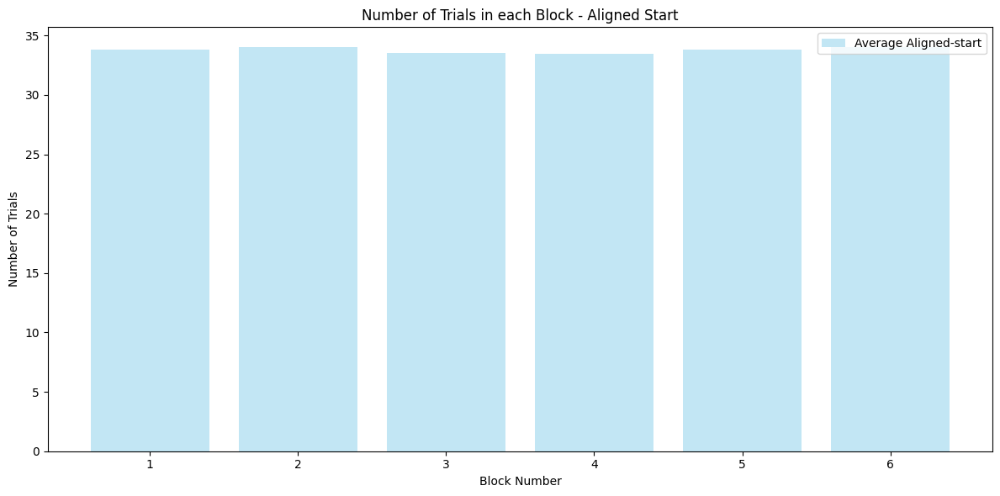

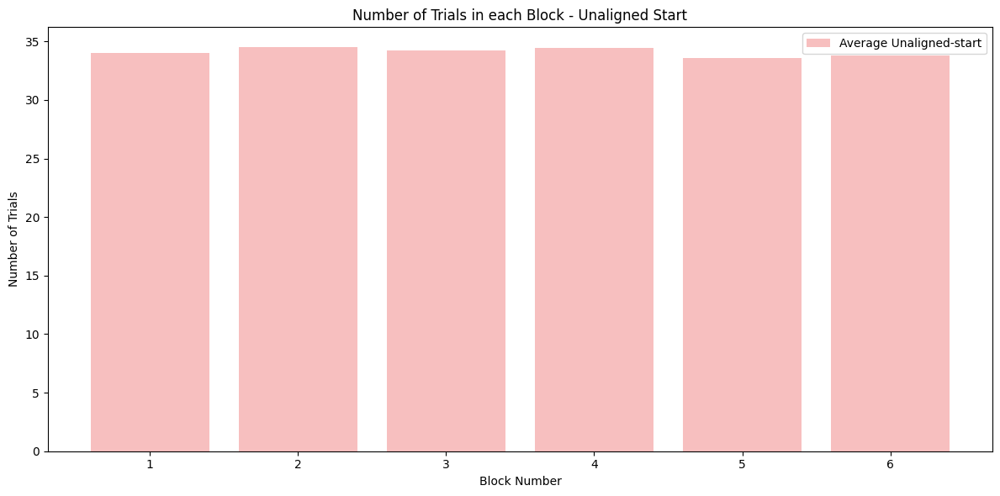

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


# Initialize empty lists to store aggregated data
aligned_block_counts = []
unaligned_block_counts = []

# Iterate over each participant's data in the combined DataFrame
for subject_id, df in all_participants_df.groupby('Subject ID'):

        # Define blocks based on switches in 'Trial type'
        df['Block Number'] = (df['Trial type'] != df['Trial type'].shift(1)).cumsum()

        # Number of trials in each Block
        block_counts = df['Block Number'].value_counts().sort_index()

        # Separate out aligned and unaligned starts
        if df['Trial type'].iloc[0] == 'aligned':
            aligned_block_counts.append(block_counts)
        else:
            unaligned_block_counts.append(block_counts)

# Calculate the average number of trials in each block across participants for aligned starts
aligned_block_counts_df = pd.concat(aligned_block_counts, axis=1)
avg_aligned_block_counts = aligned_block_counts_df.mean(axis=1)

# Calculate the average number of trials in each block across participants for unaligned starts
unaligned_block_counts_df = pd.concat(unaligned_block_counts, axis=1)
avg_unaligned_block_counts = unaligned_block_counts_df.mean(axis=1)

# Plotting the number of trials in each Block, separated by Unaligned and Aligned starts

# Plot for aligned starts
plt.figure(figsize=(12, 6))
plt.bar(range(1, len(avg_aligned_block_counts) + 1), avg_aligned_block_counts, color='skyblue', alpha=0.5, label='Average Aligned-start')

plt.xlabel('Block Number')
plt.ylabel('Number of Trials')
plt.xticks(range(1, len(avg_aligned_block_counts) + 1), range(1, len(avg_aligned_block_counts) + 1))
plt.title('Number of Trials in each Block - Aligned Start')
plt.legend()
plt.tight_layout()
plt.show()

# Plot for unaligned starts
plt.figure(figsize=(12, 6))
plt.bar(range(1, len(avg_unaligned_block_counts) + 1), avg_unaligned_block_counts, color='lightcoral', alpha=0.5, label='Average Unaligned-start')

plt.xlabel('Block Number')
plt.ylabel('Number of Trials')
plt.xticks(range(1, len(avg_unaligned_block_counts) + 1), range(1, len(avg_unaligned_block_counts) + 1))
plt.title('Number of Trials in each Block - Unaligned Start')
plt.legend()
plt.tight_layout()
plt.show()


## Average accuracy within a block (by block type)

<IPython.core.display.Javascript object>

Columns in the DataFrame: Index(['Image', 'Image Rating', 'Expectation', 'Outcome', 'Response Time',
       'Jitter 1', 'Jitter 2', 'Correct', 'Correct (Theoretical)',
       'Probabilistic event', 'Trial type', 'Subject ID', 'Correct (Binary)'],
      dtype='object')
Participants with more than 36 trials in aligned blocks:
     Subject ID
7756        744
Participants with unusually high trial numbers in unaligned blocks:
      Subject ID
19092        835


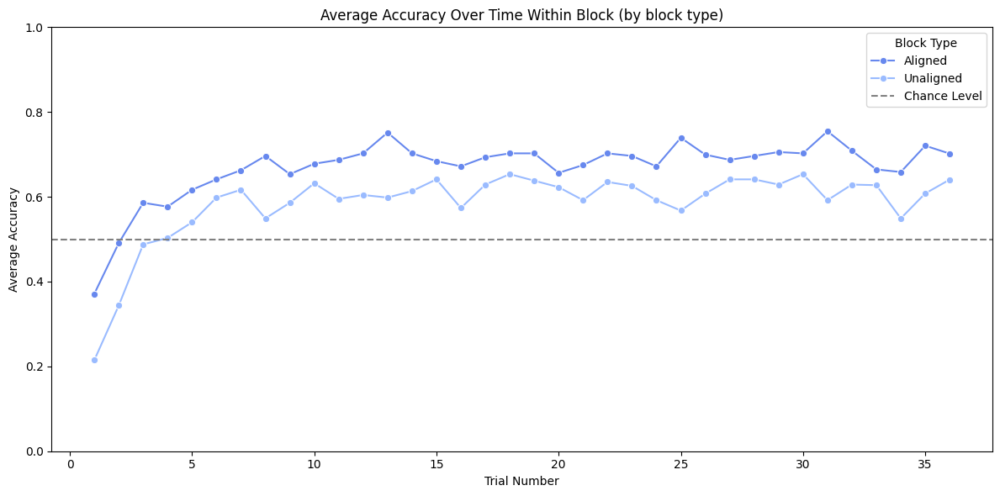

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Check columns for sanity
print("Columns in the DataFrame:", all_participants_df.columns)

# Define blocks based on switches in 'Trial type'
all_participants_df['Block Number'] = (all_participants_df['Trial type'] != all_participants_df['Trial type'].shift(1)).cumsum()

# Create 'Block' column with Block Number and Block Type (A for aligned, U for unaligned)
all_participants_df['Block'] = all_participants_df['Block Number'].astype(str) + \
                               all_participants_df['Trial type'].apply(lambda x: 'A' if x == 'aligned' else 'U')

# Add cumulative trial number within each block
all_participants_df['Trial Number'] = all_participants_df.groupby('Block')['Trial type'].cumcount() + 1

# Convert 'Correct (Theoretical)' to binary (1 for True, 0 for False)
all_participants_df['Correct (Binary)'] = all_participants_df['Correct (Theoretical)'].astype(int)

# Convert 'Block' to string and create a column to represent the type of block (Aligned/Unaligned)
all_participants_df['Block Type'] = all_participants_df['Trial type'].apply(lambda x: 'Aligned' if x == 'aligned' else 'Unaligned')

# Find participants who have more than 36 trials in aligned blocks
aligned_exceeding_36 = all_participants_df[(all_participants_df['Block Type'] == 'Aligned') &
                                           (all_participants_df['Trial Number'] > 36)]

# Find participants with unusually high number of trials in unaligned blocks
unaligned_exceeding = all_participants_df[(all_participants_df['Block Type'] == 'Unaligned') &
                                          (all_participants_df['Trial Number'] > 36)]  # Adjust threshold for unaligned if needed

# Check which participants have trials exceeding the limit
if not aligned_exceeding_36.empty:
    print("Participants with more than 36 trials in aligned blocks:")
    print(aligned_exceeding_36[['Subject ID']].drop_duplicates())

if not unaligned_exceeding.empty:
    print("Participants with unusually high trial numbers in unaligned blocks:")
    print(unaligned_exceeding[['Subject ID']].drop_duplicates())

# Proceed with correct plotting logic after filtering
overall_avg = all_participants_df.groupby(['Block Type', 'Trial Number'])['Correct (Theoretical)'].mean().reset_index()

# Determine the maximum number of trials in aligned and unaligned blocks
max_aligned_trials = 36  # Assuming 36 is the expected maximum for aligned blocks
max_unaligned_trials = 36  # Adjust if you expect fewer/more trials in unaligned blocks

# Filter out trials that exceed the maximum for each block type
overall_avg_filtered = overall_avg[
    ((overall_avg['Block Type'] == 'Aligned') & (overall_avg['Trial Number'] <= max_aligned_trials)) |
    ((overall_avg['Block Type'] == 'Unaligned') & (overall_avg['Trial Number'] <= max_unaligned_trials))
]

# Define the coolwarm palette and extract colors
coolwarm_palette = sns.color_palette("coolwarm")

# Assign specific colors from the coolwarm palette
# For example, let's say you want to switch the first and second colors
palette = {'Aligned': coolwarm_palette[0], 'Unaligned': coolwarm_palette[1]}  # Switching colors

# Plot overall average accuracy per trial
plt.figure(figsize=(12, 6))
sns.lineplot(x='Trial Number', y='Correct (Theoretical)', hue='Block Type', palette=palette, data=overall_avg_filtered, marker='o')
plt.title('Average Accuracy Over Time Within Block (by block type)')
plt.ylim(0, 1)
plt.axhline(0.5, linestyle='--', color='grey', label='Chance Level')
plt.xlabel('Trial Number')
plt.ylabel('Average Accuracy')
plt.legend(title='Block Type')
plt.tight_layout()
plt.show()




## Bar plots: Accuracy by trial type and by stimulus valence
First overall
Second by Unaligned and Aligned start

<IPython.core.display.Javascript object>


Accuracy per 'Trial type' (aligned and unaligned) (average across participants):
Trial type
aligned      0.669488
unaligned    0.583845
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type' (average across participants): 7.510916603271636e-40
Cohen's d for 'Trial type' (aligned vs. unaligned): 0.178

Accuracy as a function of 'Image Rating' (average across participants):
Image Rating
dislike             0.631987
like                0.619726
strongly_dislike    0.621349
strongly_like       0.633790
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating' (average across participants): 0.297395807533012
Data for Chi-squared test (average across participants):
Correct (Binary)     0     1
Image Rating                
dislike           2041  3505
like              2109  3437
strongly_dislike  2100  3446
strongly_like     2031  3515


<ipython-input-15-a3e05f3bbad2>:74: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=all_participants_df,
<ipython-input-15-a3e05f3bbad2>:74: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=all_participants_df,
<ipython-input-15-a3e05f3bbad2>:85: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=all_participants_df,
<ipython-input-15-a3e05f3bbad2>:85: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretic

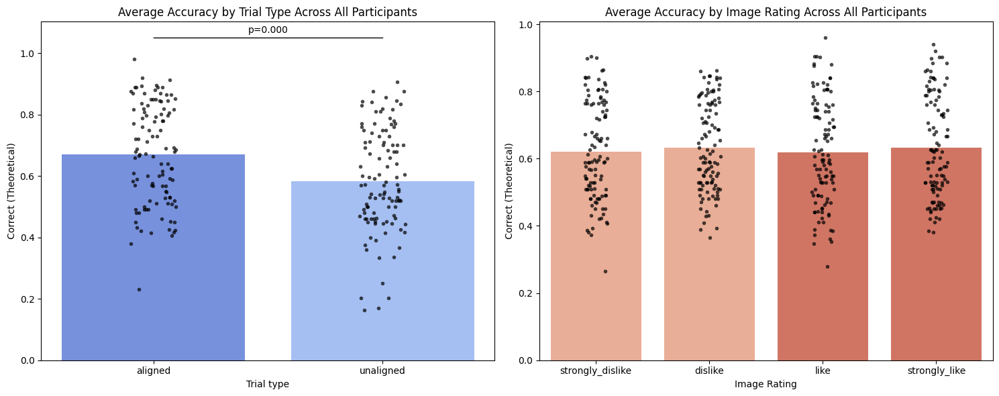

In [ ]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind, chi2_contingency
import numpy as np

# Assuming all_participants_df is the DataFrame that contains the concatenated data for all participants
# Replace the following line with the actual definition of all_participants_df
# all_participants_df = pd.concat(all_data, ignore_index=True)

# Ensure all required columns exist
required_columns = ['Subject ID', 'Trial type', 'Correct (Theoretical)', 'Image Rating']
if not all(col in all_participants_df.columns for col in required_columns):
    raise ValueError("Required columns are missing in the data.")

# Convert 'Correct (Theoretical)' to binary (1 for True, 0 for False)
all_participants_df['Correct (Binary)'] = all_participants_df['Correct (Theoretical)'].astype(int)

# Accuracy per 'Trial type' (aligned and unaligned)
trial_type_accuracy_all = all_participants_df.groupby('Trial type')['Correct (Theoretical)'].mean()
ttest_p_value_tt_all = ttest_ind(
    all_participants_df[all_participants_df['Trial type'] == 'aligned']['Correct (Theoretical)'],
    all_participants_df[all_participants_df['Trial type'] == 'unaligned']['Correct (Theoretical)'],
    nan_policy='omit'
).pvalue

# Calculate Cohen's d for aligned vs unaligned trial types
aligned_mean = all_participants_df[all_participants_df['Trial type'] == 'aligned']['Correct (Theoretical)'].mean()
unaligned_mean = all_participants_df[all_participants_df['Trial type'] == 'unaligned']['Correct (Theoretical)'].mean()
aligned_std = all_participants_df[all_participants_df['Trial type'] == 'aligned']['Correct (Theoretical)'].std(ddof=1)
unaligned_std = all_participants_df[all_participants_df['Trial type'] == 'unaligned']['Correct (Theoretical)'].std(ddof=1)
aligned_n = all_participants_df[all_participants_df['Trial type'] == 'aligned'].shape[0]
unaligned_n = all_participants_df[all_participants_df['Trial type'] == 'unaligned'].shape[0]

pooled_std = np.sqrt(((aligned_n - 1) * aligned_std**2 + (unaligned_n - 1) * unaligned_std**2) / (aligned_n + unaligned_n - 2))
cohens_d = (aligned_mean - unaligned_mean) / pooled_std

# Accuracy as a function of 'Image Rating'
# Create a contingency table
contingency_table_all = pd.crosstab(all_participants_df['Image Rating'], all_participants_df['Correct (Binary)'])

# Perform chi-squared test
chi2_all, p_all, _, _ = chi2_contingency(contingency_table_all)

# Output results
print("\nAccuracy per 'Trial type' (aligned and unaligned) (average across participants):")
print(trial_type_accuracy_all)
print(f"t-test p-value for 'Trial type' (average across participants): {ttest_p_value_tt_all}")
print(f"Cohen's d for 'Trial type' (aligned vs. unaligned): {cohens_d:.3f}")

print("\nAccuracy as a function of 'Image Rating' (average across participants):")
print(all_participants_df.groupby('Image Rating')['Correct (Binary)'].mean())
print(f"Chi-squared p-value for 'Image Rating' (average across participants): {p_all:.15f}")
print("Data for Chi-squared test (average across participants):")
print(contingency_table_all)

# Visualization
# First, calculate the average accuracy per participant for each Trial type and Image Rating
avg_accuracy_by_trial_type = all_participants_df.groupby(['Subject ID', 'Trial type'])['Correct (Theoretical)'].mean().reset_index()
avg_accuracy_by_image_rating = all_participants_df.groupby(['Subject ID', 'Image Rating'])['Correct (Theoretical)'].mean().reset_index()

# Accuracy by Trial Type and Image Rating
fig, axs = plt.subplots(1, 2, figsize=(15, 6))

# Define custom color palette
coolwarm_palette = sns.color_palette("coolwarm")  # You can choose any palette
# Assign specific colors from the coolwarm palette
palette = {'aligned': coolwarm_palette[0], 'unaligned': coolwarm_palette[1],
           'strongly_dislike': coolwarm_palette[4], 'dislike': coolwarm_palette[4],
           'like': coolwarm_palette[5], 'strongly_like': coolwarm_palette[5]}  # Switching colors

# Accuracy by Trial Type (with individual subject data points)
sns.barplot(x='Trial type', y='Correct (Theoretical)', data=all_participants_df,
            ax=axs[0], palette=palette, ci=None, order=['aligned', 'unaligned'])
sns.stripplot(x='Trial type', y='Correct (Theoretical)', data=avg_accuracy_by_trial_type,
              ax=axs[0], jitter=True, color='black', size=4, alpha=0.7)
axs[0].set_title('Average Accuracy by Trial Type Across All Participants')
if ttest_p_value_tt_all < 0.05:
    height = max(all_participants_df.groupby('Trial type')['Correct (Theoretical)'].max()) + 0.05
    axs[0].plot([0, 1], [height, height], linewidth=1, color='k')
    axs[0].text(0.5, height + 0.01, f'p={ttest_p_value_tt_all:.3f}', ha='center', va='bottom')

# Accuracy by Image Rating (with individual subject data points)
sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=all_participants_df,
            ax=axs[1], palette=palette, ci=None, order=['strongly_dislike', 'dislike', 'like', 'strongly_like'])
sns.stripplot(x='Image Rating', y='Correct (Theoretical)', data=avg_accuracy_by_image_rating,
              ax=axs[1], jitter=True, color='black', size=4, alpha=0.7)
axs[1].set_title('Average Accuracy by Image Rating Across All Participants')
if p_all < 0.05:
    height = max(all_participants_df.groupby('Image Rating')['Correct (Theoretical)'].max()) + 0.05
    axs[1].plot([0, 1, 2, 3], [height, height, height, height], linewidth=1, color='k')
    axs[1].text(1.5, height + 0.01, f'p={p_all:.3f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


Accuracy per 'Trial type' (aligned and unaligned) (average across participants) - Aligned Start:
Trial type
aligned      0.739504
unaligned    0.575882
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type' (average across participants) - Aligned Start: 5.179396026102149e-78
Cohen's d for 'Trial type' (aligned vs. unaligned) - Aligned Start: 0.354

Accuracy as a function of 'Image Rating' (average across participants) - Aligned Start:
Image Rating
dislike             0.650794
like                0.654674
strongly_dislike    0.649030
strongly_like       0.673016
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating' (average across participants) - Aligned Start: 0.205504264020141
Data for Chi-squared test (average across participants) - Aligned Start:
Correct (Binary)    0     1
Image Rating               
dislike           990  1845
like              979  1856
strongly_dislike  995  1840
strongly_like     927  1908


<ipython-input-16-9f3f56017db3>:91: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=mean_by_trial_type, ax=axs[0], palette=palette, ci=None, order=['aligned', 'unaligned'])
<ipython-input-16-9f3f56017db3>:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=mean_by_trial_type, ax=axs[0], palette=palette, ci=None, order=['aligned', 'unaligned'])
<ipython-input-16-9f3f56017db3>:101: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=mean_by_image_rating, ax=axs[1], palette=palette, ci=None, order=['strongly_dislike', 'dislike', 'like', 'strongly_like'])
<ipython-input-16-9f3f56017db3>:1

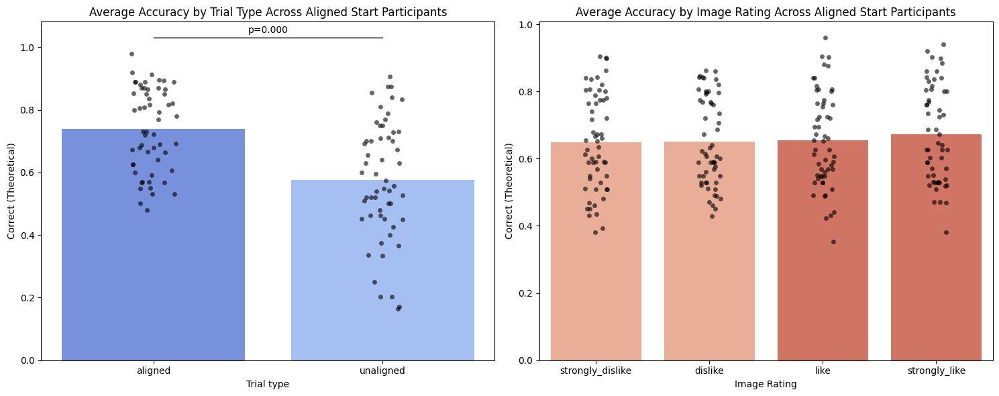


Accuracy per 'Trial type' (aligned and unaligned) (average across participants) - Unaligned Start:
Trial type
aligned      0.596541
unaligned    0.593725
Name: Correct (Theoretical), dtype: float64
t-test p-value for 'Trial type' (average across participants) - Unaligned Start: 0.7870098274384906
Cohen's d for 'Trial type' (aligned vs. unaligned) - Unaligned Start: 0.005

Accuracy as a function of 'Image Rating' (average across participants) - Unaligned Start:
Image Rating
dislike             0.612320
like                0.583180
strongly_dislike    0.592401
strongly_like       0.592770
Name: Correct (Binary), dtype: float64
Chi-squared p-value for 'Image Rating' (average across participants) - Unaligned Start: 0.166166596586467
Data for Chi-squared test (average across participants) - Unaligned Start:
Correct (Binary)     0     1
Image Rating                
dislike           1051  1660
like              1130  1581
strongly_dislike  1105  1606
strongly_like     1104  1607


<ipython-input-16-9f3f56017db3>:91: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=mean_by_trial_type, ax=axs[0], palette=palette, ci=None, order=['aligned', 'unaligned'])
<ipython-input-16-9f3f56017db3>:91: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Trial type', y='Correct (Theoretical)', data=mean_by_trial_type, ax=axs[0], palette=palette, ci=None, order=['aligned', 'unaligned'])
<ipython-input-16-9f3f56017db3>:101: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=mean_by_image_rating, ax=axs[1], palette=palette, ci=None, order=['strongly_dislike', 'dislike', 'like', 'strongly_like'])
<ipython-input-16-9f3f56017db3>:1

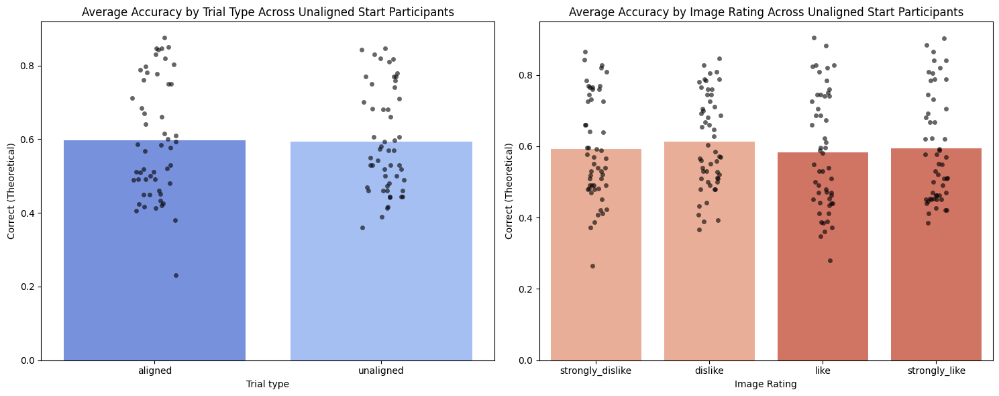

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind, chi2_contingency
import numpy as np

# Assuming all_participants_df is the DataFrame that contains the concatenated data for all participants

# Convert 'Correct (Theoretical)' to binary (1 for True, 0 for False)
all_participants_df['Correct (Binary)'] = all_participants_df['Correct (Theoretical)'].astype(int)

# Separate data based on the starting block type, handle exceptions for missing data
try:
    aligned_start_df = all_participants_df.groupby('Subject ID').filter(
        lambda x: x['Trial type'].iloc[0] == 'aligned'
    )
    if aligned_start_df.empty:
        print("No participants started with 'aligned'.")
except KeyError as e:
    print(f"Error filtering for 'aligned' participants: {e}")
    aligned_start_df = pd.DataFrame()  # Create an empty DataFrame for aligned participants

try:
    unaligned_start_df = all_participants_df.groupby('Subject ID').filter(
        lambda x: x['Trial type'].iloc[0] == 'unaligned'
    )
    if unaligned_start_df.empty:
        print("No participants started with 'unaligned'.")
except KeyError as e:
    print(f"Error filtering for 'unaligned' participants: {e}")
    unaligned_start_df = pd.DataFrame()  # Create an empty DataFrame for unaligned participants

# Function to perform analysis and plotting
def analyze_and_plot(data_df, title_suffix):
    if data_df.empty:
        print(f"No data available for {title_suffix} participants.")
        return

    # Calculate mean accuracy per participant for 'Trial type' and 'Image Rating'
    mean_by_trial_type = data_df.groupby(['Subject ID', 'Trial type'])['Correct (Theoretical)'].mean().reset_index()
    mean_by_image_rating = data_df.groupby(['Subject ID', 'Image Rating'])['Correct (Theoretical)'].mean().reset_index()

    # Accuracy per 'Trial type'
    trial_type_accuracy = mean_by_trial_type.groupby('Trial type')['Correct (Theoretical)'].mean()
    ttest_p_value_tt = ttest_ind(
        data_df[data_df['Trial type'] == 'aligned']['Correct (Theoretical)'],
        data_df[data_df['Trial type'] == 'unaligned']['Correct (Theoretical)'],
        nan_policy='omit'
    ).pvalue

    # Calculate Cohen's d for trial type comparison within the group
    aligned_mean = data_df[data_df['Trial type'] == 'aligned']['Correct (Theoretical)'].mean()
    unaligned_mean = data_df[data_df['Trial type'] == 'unaligned']['Correct (Theoretical)'].mean()
    aligned_std = data_df[data_df['Trial type'] == 'aligned']['Correct (Theoretical)'].std(ddof=1)
    unaligned_std = data_df[data_df['Trial type'] == 'unaligned']['Correct (Theoretical)'].std(ddof=1)
    aligned_n = data_df[data_df['Trial type'] == 'aligned'].shape[0]
    unaligned_n = data_df[data_df['Trial type'] == 'unaligned'].shape[0]

    pooled_std = np.sqrt(((aligned_n - 1) * aligned_std**2 + (unaligned_n - 1) * unaligned_std**2) / (aligned_n + unaligned_n - 2))
    cohens_d = (aligned_mean - unaligned_mean) / pooled_std

    # Accuracy as a function of 'Image Rating'
    contingency_table = pd.crosstab(data_df['Image Rating'], data_df['Correct (Binary)'])
    chi2, p, _, _ = chi2_contingency(contingency_table)

    # Output results
    print(f"\nAccuracy per 'Trial type' (aligned and unaligned) (average across participants) - {title_suffix}:")
    print(trial_type_accuracy)
    print(f"t-test p-value for 'Trial type' (average across participants) - {title_suffix}: {ttest_p_value_tt}")
    print(f"Cohen's d for 'Trial type' (aligned vs. unaligned) - {title_suffix}: {cohens_d:.3f}")

    print(f"\nAccuracy as a function of 'Image Rating' (average across participants) - {title_suffix}:")
    print(data_df.groupby('Image Rating')['Correct (Binary)'].mean())
    print(f"Chi-squared p-value for 'Image Rating' (average across participants) - {title_suffix}: {p:.15f}")
    print(f"Data for Chi-squared test (average across participants) - {title_suffix}:")
    print(contingency_table)

    # Visualization
    fig, axs = plt.subplots(1, 2, figsize=(15, 6))

    # Define custom color palette
    palette = sns.color_palette("coolwarm")  # You can choose any palette

    # Assign specific colors from the coolwarm palette
    # For example, let's say you want to switch the first and second colors
    palette = {'aligned': coolwarm_palette[0], 'unaligned': coolwarm_palette[1],
               'strongly_dislike': coolwarm_palette[4], 'dislike': coolwarm_palette[4],
               'like': coolwarm_palette[5], 'strongly_like': coolwarm_palette[5]}  # Switching colors

    # Accuracy by Trial Type (per-participant means)
    sns.barplot(x='Trial type', y='Correct (Theoretical)', data=mean_by_trial_type, ax=axs[0], palette=palette, ci=None, order=['aligned', 'unaligned'])
    sns.stripplot(x='Trial type', y='Correct (Theoretical)', data=mean_by_trial_type, ax=axs[0],
                  jitter=True, color='black', alpha=0.6)
    axs[0].set_title(f'Average Accuracy by Trial Type Across {title_suffix} Participants')
    if ttest_p_value_tt < 0.05:
        height = max(mean_by_trial_type.groupby('Trial type')['Correct (Theoretical)'].max()) + 0.05
        axs[0].plot([0, 1], [height, height], linewidth=1, color='k')
        axs[0].text(0.5, height + 0.01, f'p={ttest_p_value_tt:.3f}', ha='center', va='bottom')

    # Accuracy by Image Rating (per-participant means)
    sns.barplot(x='Image Rating', y='Correct (Theoretical)', data=mean_by_image_rating, ax=axs[1], palette=palette, ci=None, order=['strongly_dislike', 'dislike', 'like', 'strongly_like'])
    sns.stripplot(x='Image Rating', y='Correct (Theoretical)', data=mean_by_image_rating, ax=axs[1],
                  jitter=True, color='black', alpha=0.6)
    axs[1].set_title(f'Average Accuracy by Image Rating Across {title_suffix} Participants')
    if p < 0.05:
        height = max(mean_by_image_rating.groupby('Image Rating')['Correct (Theoretical)'].max()) + 0.05
        axs[1].plot([0, 1, 2, 3], [height, height, height, height], linewidth=1, color='k')
        axs[1].text(1.5, height + 0.01, f'p={p:.3f}', ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

# Analyze and plot for aligned-start participants
analyze_and_plot(aligned_start_df, 'Aligned Start')

# Analyze and plot for unaligned-start participants
analyze_and_plot(unaligned_start_df, 'Unaligned Start')

##Bar plots: Accuracy by block and image rating


<IPython.core.display.Javascript object>

<ipython-input-22-b8bcbed05b38>:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_means = data_df.groupby(['Subject ID', 'Block Type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in Aligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in Aligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in Aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in Aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in Unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in Unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'like' in Unaligned is significantly different from chance level (p = 0.001).
Accuracy for 'strongly_like' in Unaligned is significantly different from chance level (p = 0.034).


<ipython-input-22-b8bcbed05b38>:47: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(
<ipython-input-22-b8bcbed05b38>:59: FutureWarning: Use "auto" to set automatic grayscale colors. From v0.14.0, "gray" will default to matplotlib's definition.
  sns.stripplot(


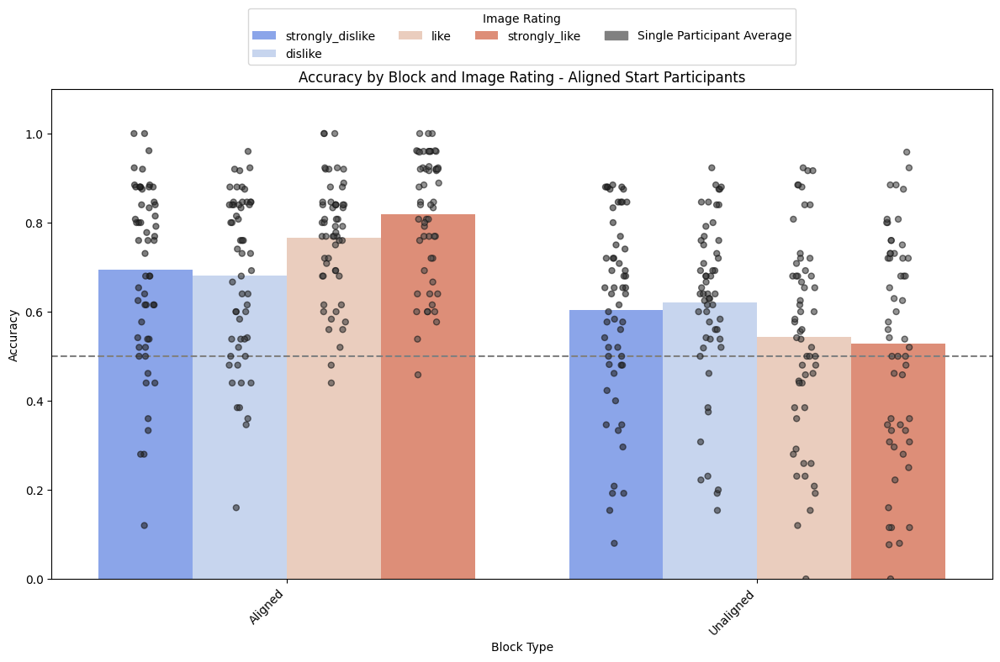

<ipython-input-22-b8bcbed05b38>:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  participant_means = data_df.groupby(['Subject ID', 'Block Type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()


Accuracy for 'strongly_dislike' in Aligned is significantly different from chance level (p = 0.003).
Accuracy for 'dislike' in Aligned is significantly different from chance level (p = 0.024).
Accuracy for 'like' in Aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_like' in Aligned is significantly different from chance level (p = 0.000).
Accuracy for 'strongly_dislike' in Unaligned is significantly different from chance level (p = 0.000).
Accuracy for 'dislike' in Unaligned is significantly different from chance level (p = 0.000).


<ipython-input-22-b8bcbed05b38>:47: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(
<ipython-input-22-b8bcbed05b38>:59: FutureWarning: Use "auto" to set automatic grayscale colors. From v0.14.0, "gray" will default to matplotlib's definition.
  sns.stripplot(


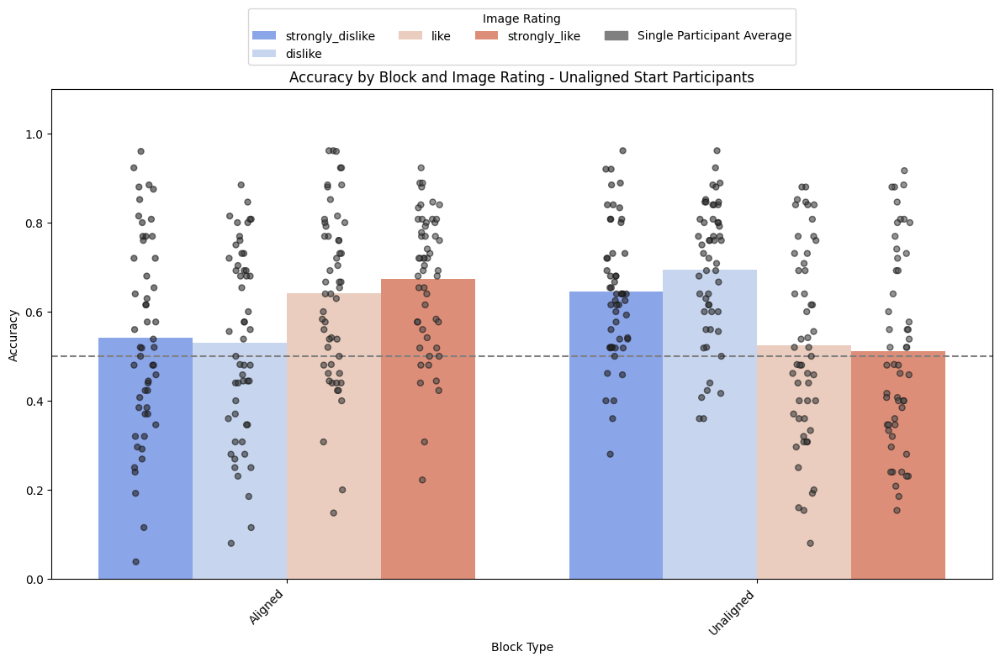

In [ ]:
import matplotlib.patches as mpatches
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

# Define a function to plot accuracy by block and image rating for each group with significance
def plot_accuracy_by_block_image_rating(data_df, title_suffix):
    if data_df.empty:
        print(f"No data to plot for {title_suffix}.")
        return

    # Ensure 'Image Rating' is in the specified order
    rating_order = ['strongly_dislike', 'dislike', 'like', 'strongly_like']
    data_df['Image Rating'] = pd.Categorical(data_df['Image Rating'], categories=rating_order, ordered=True)

    # Check if 'Block Type' is in the DataFrame
    if 'Block Type' not in data_df.columns:
        print(f"'Block Type' not found in {title_suffix} data.")
        return

    # Compute the average accuracy for each participant by Block Type and Image Rating
    participant_means = data_df.groupby(['Subject ID', 'Block Type', 'Image Rating'])['Correct (Binary)'].mean().reset_index()

    # Define custom color palette
    palette = sns.color_palette("coolwarm", len(rating_order))  # You can choose any palette

    # Create a DataFrame for significance testing
    results = []
    printed_results = set()  # Set to track printed results
    for _, row in participant_means.iterrows():
        t_stat, p_value = stats.ttest_1samp(data_df[(data_df['Block Type'] == row['Block Type']) &
                                                     (data_df['Image Rating'] == row['Image Rating'])]['Correct (Binary)'], 0.5)
        results.append({'Block Type': row['Block Type'], 'Image Rating': row['Image Rating'],
                        'p_value': p_value, 'mean_accuracy': row['Correct (Binary)']})

        # Only print if the result is significant and not already printed
        if p_value < 0.05 and (row['Block Type'], row['Image Rating']) not in printed_results:
            significance = 'significantly'
            print(f"Accuracy for '{row['Image Rating']}' in {row['Block Type']} is {significance} different from chance level (p = {p_value:.3f}).")
            printed_results.add((row['Block Type'], row['Image Rating']))  # Add to printed results set

    # Define fixed order for Block Types
    block_order = ['Aligned', 'Unaligned']

    # Plot Accuracy by Block and Image Rating with overlaid participant averages
    plt.figure(figsize=(12, 8))
    ax = sns.barplot(
        data=data_df,
        x='Block Type',
        y='Correct (Binary)',
        hue='Image Rating',
        hue_order=rating_order,  # Specify the order of the hue categories
        palette=palette,  # Apply custom color palette
        ci=None,  # Remove the confidence intervals for the bar plot
        order=block_order  # Set the order of the Block Type categories
    )

    # Overlay individual average accuracy points with different color intensity for contrast
    sns.stripplot(
        data=participant_means,
        x='Block Type',
        y='Correct (Binary)',
        hue='Image Rating',
        hue_order=rating_order,
        dodge=True,  # Separate the points by hue category
        marker='o',  # Use circles for the points
        palette='dark:.3',  # Use a darker version of the color palette for the points
        alpha=0.6,  # Set transparency of the points
        ax=ax,
        linewidth=1,  # Add a border around the points
        edgecolor='gray'  # Set the border color
    )

    plt.title(f'Accuracy by Block and Image Rating - {title_suffix} Participants')
    plt.axhline(y=0.5, color='gray', linestyle='--', label='Chance Level')  # Add a dotted line at y=0.5
    plt.ylim(0, 1.1)  # Set y-axis limits to 0-1.1
    plt.xlabel('Block Type')
    plt.ylabel('Accuracy')
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

    # Modify legend to show 'Single Participant Average' for points
    handles, labels = ax.get_legend_handles_labels()
    single_participant_patch = mpatches.Patch(color='gray', label='Single Participant Average')

    # Move the legend to the top of the plot
    plt.legend(handles=[*handles[:4], single_participant_patch], title='Image Rating',
               bbox_to_anchor=(0.5, 1.05), loc='lower center', borderaxespad=0., ncol=4)  # Adjusted here

    plt.tight_layout()
    plt.show()

# Plot for aligned-start participants
plot_accuracy_by_block_image_rating(aligned_start_df, 'Aligned Start')

# Plot for unaligned-start participants
plot_accuracy_by_block_image_rating(unaligned_start_df, 'Unaligned Start')


## Only last 15 trials of each block

<IPython.core.display.Javascript object>

/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


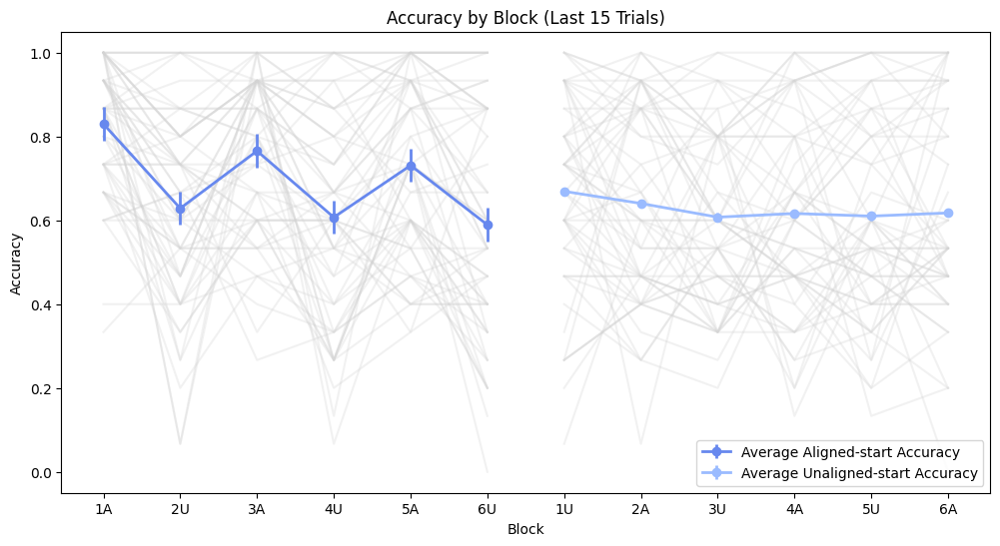

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_ind, chi2_contingency

# Initialize empty lists to store aggregated data
all_block_counts = []
all_block_accuracy = []
all_trial_type_accuracy = []
all_ttest_p_values_tt = []
all_overall_accuracy = []
all_image_rating_data = []
all_chi2_p_values = []

# Iterate over each participant's data in the combined DataFrame
for subject_id, df in all_participants_df.groupby('Subject ID'):

        # Define blocks based on switches in 'Trial type'
        df['Block Number'] = (df['Trial type'] != df['Trial type'].shift(1)).cumsum()
        df['Block'] = df['Block Number'].astype(str) + df['Trial type'].apply(lambda x: 'A' if x == 'aligned' else 'U')

        # Select only the last 15 trials of each block
        df_last_15 = df.groupby('Block Number').tail(15).reset_index(drop=True)

        # Number of trials in each 'Block'
        block_counts = df_last_15['Block'].value_counts()

        # Accuracy in each 'Block'
        block_accuracy = df_last_15.groupby('Block')['Correct (Theoretical)'].mean()

        # Accuracy per 'Trial type' (aligned and unaligned)
        trial_type_accuracy = df_last_15.groupby('Trial type')['Correct (Theoretical)'].mean()
        ttest_p_value_tt = ttest_ind(df_last_15[df_last_15['Trial type'] == 'aligned']['Correct (Theoretical)'],
                                     df_last_15[df_last_15['Trial type'] == 'unaligned']['Correct (Theoretical)'], nan_policy='omit').pvalue

        # Accuracy over the whole task (last 15 trials in each block)
        overall_accuracy = df_last_15.groupby('Block')['Correct (Theoretical)'].mean()

        # Accuracy as a function of 'Image Rating'
        # Convert 'Correct (Theoretical)' to binary (1 for True, 0 for False)
        df_last_15['Correct (Binary)'] = df_last_15['Correct (Theoretical)'].astype(int)

        # Create a contingency table
        contingency_table = pd.crosstab(df_last_15['Image Rating'], df_last_15['Correct (Binary)'])

        # Perform chi-squared test
        chi2, p, _, _ = chi2_contingency(contingency_table)

        # Append data to lists
        all_block_counts.append(block_counts)
        all_block_accuracy.append(block_accuracy)
        all_trial_type_accuracy.append(trial_type_accuracy)
        all_ttest_p_values_tt.append(ttest_p_value_tt)
        all_overall_accuracy.append(overall_accuracy)
        all_image_rating_data.append(df_last_15.groupby('Image Rating')['Correct (Theoretical)'].mean())
        all_chi2_p_values.append(p)

# Plotting across participants

# Accuracy by Block with Error 'Cloud' for Average Accuracy for Aligned and Unaligned Starts
plt.figure(figsize=(12, 6))

# Separate data for 'Aligned' and 'Unaligned' starts
aligned_data = [block_accuracy for block_accuracy in all_block_accuracy if 'A' in block_accuracy.index[0]]
unaligned_data = [block_accuracy for block_accuracy in all_block_accuracy if 'U' in block_accuracy.index[0]]

# Plot individual accuracies (faint grey lines) and average lines with error 'cloud'
for block_accuracy in aligned_data:
    plt.plot(block_accuracy.index, block_accuracy, color='LightGrey', alpha=0.3)  # Faint grey lines for individual accuracies
avg_aligned_accuracy = pd.concat(aligned_data, axis=1).mean(axis=1)
plt.errorbar(avg_aligned_accuracy.index, avg_aligned_accuracy, yerr=avg_aligned_accuracy.sem(), fmt='-o', color=coolwarm_palette[0], lw=2, label='Average Aligned-start Accuracy')

for block_accuracy in unaligned_data:
    plt.plot(block_accuracy.index, block_accuracy, color='LightGrey', alpha=0.3)  # Faint grey lines for individual accuracies
avg_unaligned_accuracy = pd.concat(unaligned_data, axis=1).mean(axis=1)
plt.errorbar(avg_unaligned_accuracy.index, avg_unaligned_accuracy, yerr=avg_unaligned_accuracy.sem(), fmt='-o', color=coolwarm_palette[1], lw=2, label='Average Unaligned-start Accuracy')

plt.xlabel('Block')
plt.ylabel('Accuracy')
plt.title('Accuracy by Block (Last 15 Trials)')
plt.legend()
plt.show()
